In [1]:
import random as rnd
import numpy as np
import matplotlib.pyplot as plt
import math as m
import gc
from IPython.display import clear_output

In [2]:
# Creation of the initial population
def Generate_population(population_size, number_of_variables, variable_upper_bound, variable_lower_bound):
    population = np.zeros((population_size, number_of_variables))
    for i in range(population_size):
        population[i, :] = np.random.uniform(variable_lower_bound, variable_upper_bound, size=number_of_variables)
    
    #print(population)

    return population  # [[X1, X2, X3, ..... , Xn]]

In [3]:
# Function calculation of population
def Function_values(population):
    values = []
    for i,x in enumerate(population):
        
        f1 = x[0]   # F1 = X1
        
        temp = 0
        for j in range(1,30):
            temp += x[j]
        
        g = (1  + (9/29)*temp)
        
        if g <= 0:
            g = 1e-10
        
        f1_over_g = f1 / g
        
        # Ensure valid range for square root computation
        #if f1_over_g > 1:
        #    f1_over_g = 1
        if f1_over_g < 0:
            f1_over_g = 0
        
        
        f2 = g*(1 - (m.sqrt(f1_over_g)))
        values.append([f1,f2])
    
    #print(values)

    return values   # [F1, F2]

In [4]:
# Fitness calculation of the Function Values
# Finding the Pareto Optimal solutions

def Non_dominated_sorting_fitness_calculation(function_values):
    
    pareto_optimal_fronts = [] # Contains the list of final function values all the fronts
    domination = {} # Contains the index as Key and the dominates Indexes and How many are dominating
                    # {"Index of the Function Value": [["dominating index"], No of solutions dominates by]}
    front = []      # Contains fronts Indexes
    front1 = [] # Contains the Index of the Solutions of the first front
    for i, x in enumerate(function_values):
        sp = []     # Contains the list of Solutions that the current value is Dominating
        np = 0      # Contains the number of solutions that are Dominating the current solution 
        for j, y in enumerate(function_values):
            if x[0] < y[0] and x[1] < y[1]: # Since Minimization Criteria of F1 and F2
                sp.append(j)
            elif x[0] > y[0] and x[1] > y[1]:
                np += 1
        
        domination[i] = [sp, np]
        
        if np == 0:
            front1.append(i)
    front.append(front1)
    
    
    i = 0
    while len(front[i]) > 0:
        temp = []
        for individual in front[i]:
            for other_individual in domination[individual][0]:
                domination[other_individual][1] -= 1
                if domination[other_individual][1] == 0:
                    temp.append(other_individual)
        i += 1
        front.append(temp) # Entering the Values in the Next
    
    for i  in range(len(front)):
        _ = []
        for individual in front[i]:
            _.append(function_values[individual]) # Converting Index Values to Function
        
        pareto_optimal_fronts.append(_)
    
    return pareto_optimal_fronts    # [[[F1, F2], [F1,F2],..]-> Front1, [[F1,F2], [F1,F2],....]-> Front2, ...]

In [5]:
# Function to Create a good Diversity between the solutions

def Crowding_distance_calculation(pareto_optimal_fronts):
    
    distances_values = []
    
    for front in pareto_optimal_fronts: 
                                        # front contains [[F1, F2], [F1, F2], [F1, F2],... ]
        dis = []
        sorted_front = sorted(front, key=lambda l:l[0]) # Sorting the Fronts based in function F1
        
        dis.append(999999999)   # Giving the Extreme point a Maximum Value
        
        if len(sorted_front) > 1:
            for i in range(1, len(sorted_front) - 1):
                
                val = (abs(sorted_front[i+1][0] - sorted_front[i-1][0]))/(max(sorted_front[0]) - min(sorted_front[0]))
                
                dis.append(val)
            
            dis.append(999999999)   # Giving the Extreme point a Maximum Value
            
        
            sorted_front = sorted(front, key=lambda l:l[1]) # Sorting the Fronts based in function F2
                
            dis[0] = 999999999
                        
            for i in range(1, len(sorted_front) - 1):
                    
                val = (abs(sorted_front[i+1][1] - sorted_front[i-1][1]))/(max(sorted_front[1]) - min(sorted_front[1]))
                    
                dis[i] += val
                
            dis[len(sorted_front)-1] = 999999999
        
        distances_values.append(dis)
        
    return distances_values  # [[D1, D2, D3,..]-> Front1, [D1, D2, D3,...]-> Front2, ...]

In [6]:
# Final Selection after all the calculations
def Selection(function_values, pareto_optimal_fronts, distance_values, population_size, population):
    
    selection_list = [] # ["function_value_index", "pareto_optimal_front_number", "crowding_distance_value"]
    selected_list = []  # ["New_function_value_index", "Population_Values", "Function_Values", "pareto_optimal_front_number", "crowding_distance_value"]
    final_selected_list = [] #["Population Values"] that is the new population after calculation and selection 
    
    for i, x in enumerate(function_values):
        _ = [] # ["Function_value_Index", "Pareto_optimal_Front_Position", "crowding_distance_value"]
        for j, y in enumerate(pareto_optimal_fronts):
            for k, z in enumerate(y):
                if x == z:
                    _.append(i)
                    _.append(j)
                    _.append(distance_values[j][k])

        selection_list.append(_)
        
        #print(selection_list)
    
    
    for i in range(population_size):
        
        random1 = rnd.choice(selection_list)
        random2 = rnd.choice(selection_list)
        
        #print(f"Random1 = {random1}")
        #print(f"Random2 = {random2}")
        
        if random1[0] == random2[0]:
            selected_list.append(random1) # If both are same chose any one
        elif random1[1] < random2[1]:
            selected_list.append(random1)   # If Random1 has better pareto_optimal front
        elif random1[1] > random2[1]:
            selected_list.append(random2)   # If Random2 has better pareto_optimal front
        elif random1[1] == random2[1]:
            if random1[2] > random2[2]:
                selected_list.append(random1)   # If Random1 has greater crowding distance
            else:
                selected_list.append(random2)   # If Random2 has greater crowding distance
    
    #print(selected_list)
    
    for i,x in enumerate(selected_list):
        population_value = population[x[0]]
        final_selected_list.append(population_value) # the final population values that is of X1, x2. ..
        
    
    return final_selected_list # [[X1,X2,..], [X1,X2,..], [X1,X2,..],..]

# Different Cross-Over Functions

In [7]:
# Cross - Over Function

def Crossover(population, eta_c=10, lows=None, highs=None): # Using SBX cross-over method
    
    offspring = []
    
    for i in range(0,len(population)):
        
        parent1 = population[i]
        
        if i+1 > len(population)-1:
            parent2 = population[0]
        else:
            parent2 = population[i+1]
        
        child1 = np.zeros_like(parent1)
        child2 = np.zeros_like(parent2)
        
        
        for j in range(len(parent1)):
            low = lows[j]
            high = highs[j]
            u = rnd.random()
            if u <= 0.5:
                beta = (2 * u) ** (1 / (eta_c + 1))
            else:
                beta = (1 / (2 * (1 - u))) ** (1 / (eta_c + 1))
            
            child1[j] = 0.5 * (((1 + beta) * parent1[j]) + ((1 - beta) * parent2[j]))
            child2[j] = 0.5 * (((1 - beta) * parent1[j]) + ((1 + beta) * parent2[j]))
            
            child1[j] = max(low, min(child1[j], high))
            child2[j] = max(low, min(child2[j], high))
        
        offspring.append(child1)
        offspring.append(child2)
        
        i += 2
    
    return offspring

In [8]:
# Cross - Over Function

def Crossover2(population, lows = None, highs=None): # Using single_point_crossover method
    
    offspring = []
    
    for i in range(0,len(population)):
        
        parent1 = population[i]
        
        if i+1 > len(population)-1:
            parent2 = population[0]
        else:
            parent2 = population[i+1]
        
        point = np.random.randint(1, len(parent1))
        child1 = np.concatenate((parent1[:point], parent2[point:]))
        child2 = np.concatenate((parent2[:point], parent1[point:]))
    
        
        offspring.append(child1)
        offspring.append(child2)
        
        i += 2
    
    return offspring

In [9]:
# Cross - Over Function

def Crossover3(population, lows = None, highs=None): # Using two_point_crossover method
    
    offspring = []
    
    for i in range(0,len(population)):
        
        parent1 = population[i]
        
        if i+1 > len(population)-1:
            parent2 = population[0]
        else:
            parent2 = population[i+1]
        
        
        point1, point2 = sorted(np.random.randint(1, len(parent1), 2))
        child1 = np.concatenate((parent1[:point1], parent2[point1:point2], parent1[point2:]))
        child2 = np.concatenate((parent2[:point1], parent1[point1:point2], parent2[point2:]))
        
        offspring.append(child1)
        offspring.append(child2)
        
        i += 2
    
    return offspring

In [10]:
# Cross - Over Function

def Crossover4(population,  lows = None, highs=None): # Using uniform_crossover method
    
    offspring = []
    
    for i in range(0,len(population)):
        
        parent1 = population[i]
        
        if i+1 > len(population)-1:
            parent2 = population[0]
        else:
            parent2 = population[i+1]
        
        
        mask = np.random.randint(0, 2, len(parent1))
        child1 = np.where(mask, parent1, parent2)
        child2 = np.where(mask, parent2, parent1)
        
        offspring.append(child1)
        offspring.append(child2)
        
        i += 2
    
    return offspring

In [11]:
# Cross - Over Function

def Crossover5(population, alpha=0.5,  lows = None, highs=None): # Using arithmetic_crossover method
    
    offspring = []
    
    for i in range(0,len(population)):
        
        parent1 = population[i]
        
        if i+1 > len(population)-1:
            parent2 = population[0]
        else:
            parent2 = population[i+1]
        
        child1 = alpha * parent1 + (1 - alpha) * parent2
        child2 = alpha * parent2 + (1 - alpha) * parent1
        
        offspring.append(child1)
        offspring.append(child2)
        
        i += 2
    
    return offspring

## Different Mutation Functions

In [12]:
# Mutation Function
def Mutation(population, pm=0.1, eta_m=20, lows= None, highs=None):  # Polynomial Mutation
    mutated_individual = np.copy(population)
    
    for i in range(len(population)):
        if rnd.random() < pm:
            for j in range(len(lows)):
                low = lows[j] if lows else None
                high = highs[j] if highs else None
                u = rnd.random()
                delta = min(mutated_individual[i][j] - low, high - mutated_individual[i][j])
                delta_q = (2 * u) ** (1 / (eta_m + 1)) - 1 if np.random.random() < 0.5 else 1 - (2 * (1 - u)) ** (1 / (eta_m + 1))
                mutated_individual[i][j] += delta * delta_q
                
                mutated_individual[i][j] = max(low, min(mutated_individual[i][j], high))
    
    return mutated_individual

In [13]:
# Mutation Function
def Mutation2(population, pm=0.1, lows= None, highs=None):  # bit_flip_mutation
    mutated_individual = np.copy(population)
    
    for i in range(len(population)):
        if rnd.random() < pm:
            m = np.random.uniform(low=lows, high=highs, size=len(lows))
            mutated_individual[i] = m - mutated_individual[i]
            
    return mutated_individual

In [14]:
# Mutation Function
def Mutation3(population, pm=0.1, lows= None, highs=None):  # swap_mutation
    mutated_individual = np.copy(population)
    
    for i in range(len(population)):
        if rnd.random() < pm:
            individual = mutated_individual[i]
            # Randomly choose two distinct indices to swap within the individual
            idx1, idx2 = np.random.choice(len(individual), 2, replace=False)
            
            # Swap the values at these indices
            individual[idx1], individual[idx2] = individual[idx2], individual[idx1]
            
            mutated_individual[i] = individual
            
    return mutated_individual

In [15]:
# Function to generate the new Generation of better solutions
def New_generations(Parent_population, Offspring_population):
    
    combination_of_generations = [] # List containing the combination of both parent and child population
    next_generation_values = [] # List containing the values of the next/new generations
    
    
    for i in range(len(Parent_population)):
        combination_of_generations.append(Parent_population[i])
        combination_of_generations.append(Offspring_population[i])
    
    # List containing the function values
    function_values = Function_values(combination_of_generations)
    # list containing pareto optimal fronts
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation(function_values)
    # List containing the Crowding distance
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    # List containing the final selected values
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                len(combination_of_generations), combination_of_generations)
    
    for i in range(len(Parent_population)):
        next_generation_values.append(final_selected_values[i])
    
    return next_generation_values

## Minimize f1(x) = x1,
## Minimize f2(x) = g(x)[1-sqrt(f1(x)/g(x))],

## where g(x) = 1 + 9/29(x(i)), 2 <= i<= 30
##              0 <= x1 = 1 
##              -1 <= xi <= 1, 2 <= i<= 30

Threshold = 800.0
GENERATION :- 1
[[0.5709648402723374, -0.09657153142743335], [0.5518985362193202, -7.428887388731524e-06], [0.1401363088055635, 0.6943193047371796], [0.8694144768729015, 0.13003990964100928], [0.8271280666314081, 1.122928729134235], [0.2486858825487217, 0.6163985027324587], [0.07714651627497493, 0.6439273133666212], [0.8574110682163011, 0.7374219022234176], [0.29524153914909024, 0.7730482531029624], [0.4124264839265015, 0.5516311663087777], [0.7347942422316321, 0.12702726407796489], [0.09733923064662564, 1.8258355747847974], [0.11902204280436068, 0.10645725238240816], [0.6353665616148433, -7.970888405554504e-06], [0.5059472139958433, 0.16638419632839366], [0.9319705289024826, -0.22554389098339797], [0.4030858031463692, -6.348803867175571e-06], [0.37673622928174455, 0.6300997324195053], [0.27420357782317417, 0.265324156921495], [0.8770129733699762, 0.42112561831463996], [0.16533051294167667, -4.065985500105435e-06], [0.8727679535362254, 0.26888190599062495], [0.7514760

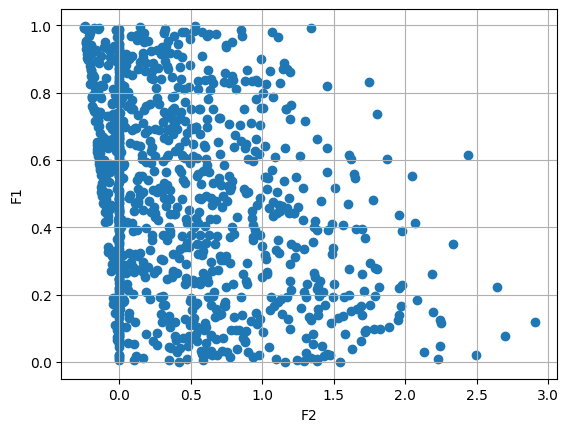

GENERATION :- 2
[[0.5439502774205776, 0.148699262478767], [0.07647472375863174, 0.4849220223391905], [0.5892378341941285, -0.06305446191660227], [0.038599574604130424, 1.6211016679565005], [0.08092849804245375, 0.7287763483342821], [0.7304504746636113, -0.05421152423926343], [0.41331892133485504, 0.08779436361549722], [0.47234019127477955, 0.1286766246615073], [0.10592748180739055, 0.5487586009552466], [0.28690363187564133, 0.10565566292101199], [0.17404310014872582, -4.1717473144247e-06], [0.5145357086178454, 0.45805790183358985], [0.1297494047353014, -3.6019744680711606e-06], [0.10510320638180772, 0.1389549056470983], [0.6629563435243011, -0.10250009321018978], [0.04628495229090057, 1.421435237954749], [0.0, 1.0017506588777567], [0.8794219436301405, -0.20347424999835634], [0.3726615209346659, 0.13649423791142415], [0.40525016922514023, -6.365826242308658e-06], [0.0859702322056719, -2.9319680791153523e-06], [0.8812753581926718, -0.1982834642150799], [0.9320879698459285, -0.23301922784

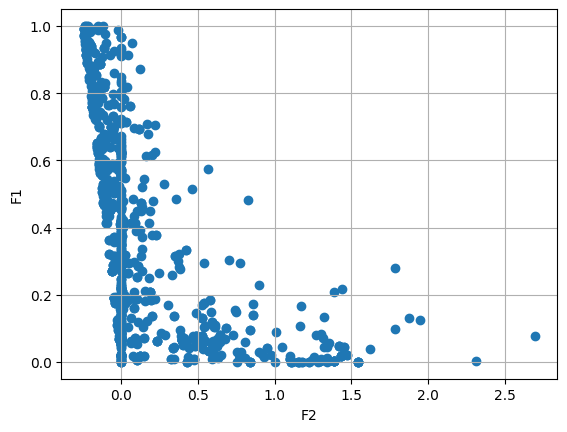

GENERATION :- 3
[[0.7452525870812748, -0.17551535957863165], [0.5587317676339479, -0.05130643762457112], [0.25818340953209684, -0.05281849052360276], [0.4994084966401734, -0.10824153714030983], [0.06934348152272063, 0.4913965763360455], [0.0073106840577190635, 0.5885610039112948], [0.05292442775785175, -2.3004309769236265e-06], [0.3170169875065639, -0.07610855737167563], [0.02063636199087826, -1.436436180918471e-06], [0.01975395814008498, 0.7303043440202631], [0.8495951494913832, -0.16444471518355333], [0.07019505798099397, 0.14712839548151982], [0.0, 1.149868071104539], [0.0, 0.5308456645296531], [0.8812753581926718, -0.1982834642150799], [0.0002830846660586179, -1.6815120090466453e-07], [0.5308470872299371, -0.1224702110787513], [0.11018504217456271, -0.027411039158275065], [0.05261856071215674, -2.2937735953002456e-06], [0.0008764481358037868, 1.5453414003354589], [0.8411460981870449, -0.17507739076158219], [0.6346411205608296, -0.14956196428799126], [0.0, 0.8406306325430886], [0.95

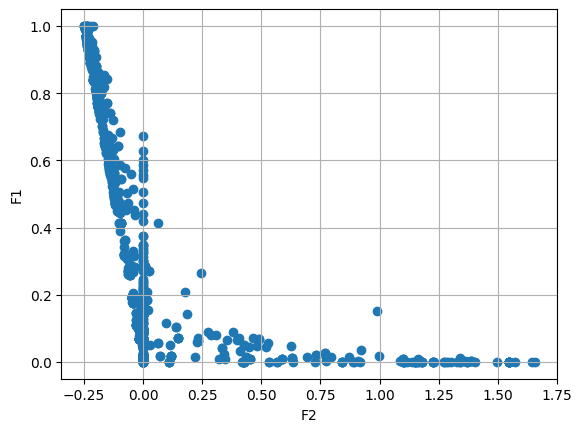

GENERATION :- 4
[[0.5997101574028125, -0.14966540523314295], [0.5887653315131887, -0.14446382491527907], [0.00952000044839026, -9.756048963897978e-07], [0.27068888056334095, -0.0612306453858773], [0.0, 1.2056083031853548], [0.938965846174341, -0.23466361757163953], [0.005347204450584786, -7.311458171220391e-07], [0.007865874074168165, 0.32092242869356274], [0.05969518495554982, -2.443159809261999e-06], [0.021411385037284566, -1.4631629646541514e-06], [0.7559246728701886, -0.18669780426439747], [0.01842038414171636, -1.3571171580744312e-06], [0.05556014579151729, -2.3570199755531597e-06], [0.496218983530306, -0.12402031285105707], [0.020194378302757228, 0.35920901047161174], [0.44603143453646144, -0.11082616350609292], [0.040301835490033605, -2.007431705603516e-06], [0.0, 1e-10], [0.5041126388631052, -0.11635128085147486], [0.990989305644043, -0.24460287383772417], [0.7593163397706506, -0.1896108765160136], [0.0, 1e-10], [0.0, 0.42563413406477335], [0.01655260218381893, -1.2864691657978

KeyboardInterrupt: 

In [16]:
#Main Function

population_size = 1000
number_of_variables = 30
variable_upper_bound = [1] 
variable_lower_bound = [0]
for i in range(29):
    variable_upper_bound.append(1)
    variable_lower_bound.append(-1)
    
#print(variable_lower_bound)
#print(variable_upper_bound)

threshold = population_size*0.8

print(f'Threshold = {threshold}')

population = Generate_population(population_size, number_of_variables, variable_upper_bound, variable_lower_bound)

for i in range(100):
    print(f"GENERATION :- {i+1}")
    counter = 0
    first_counter = 0
    function_values = Function_values(population)
    print(function_values)
    
    first_value = function_values[0] # Get the first element of the first sublist
    first_f1_point = first_value[0]
    
    for sublist in function_values:
        if sublist == first_value:
                first_counter += 1
        for value in sublist:
            if value == first_f1_point:
                counter += 1 # Found different value
    
    if counter >= threshold or first_counter >= threshold:
        print(f"Convergence reached after {i+1} generations as there are {threshold} same values")
        break
    
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation(function_values)
    #print(pareto_optimal_front_values)
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    #print(crowding_distance_calculation_values)
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                len(population), population)
    population = final_selected_values
    offspring_population = Crossover(population, lows=variable_lower_bound, highs=variable_upper_bound)
    offspring_population = Mutation(offspring_population,  lows=variable_lower_bound, highs=variable_upper_bound)
    population = New_generations(population, offspring_population)
    #print(population)
    x = []
    y = []
    for i in function_values:
        x.append(i[0])
        y.append(i[1])
    #plt.figure(figsize=(8, 6))
    # plt.xlim(-1, 3)  # Limit x-axis from 0 to 6
    # plt.ylim(-1, 3)  # Limit y-axis from 0 to 6

    plt.scatter(y,x)
    plt.ylabel("F1")
    plt.xlabel("F2")
    plt.grid()
    plt.show()

Threshold = 800.0
GENERATION :- 1
[[0.371650393197251, -6.096213584431587e-06], [0.7539371347300045, -0.11928071805121583], [0.851119930192641, 0.6985902655926796], [0.8722340202217297, -0.1063625261491588], [0.7114887384326993, -0.031065535732720778], [0.31976987500814824, 1.1285434320896965], [0.17942904328557818, 0.2893869384781091], [0.096097962625046, 1.9020786537807808], [0.8600072966768554, 1.0713668776825978], [0.9053368961607354, 0.3202024478078736], [0.9085500515813495, -9.531689189765737e-06], [0.8259006678520451, 0.2935089165818075], [0.7104195940083395, -8.428539237791231e-06], [0.014670804194684472, 0.007848054472788135], [0.960598954056584, 1.290590465917789], [0.8001521560992283, 0.20775065451981484], [0.9158410290877954, -0.02107096831112372], [0.266883960536604, 1.0514006048844535], [0.9425160762868376, -0.21292740946540462], [0.24186110674885952, 1.7930090149986564], [0.26121817002066205, 0.3485586139682717], [0.24085151175510577, 1.2608947262224743], [0.901944438097

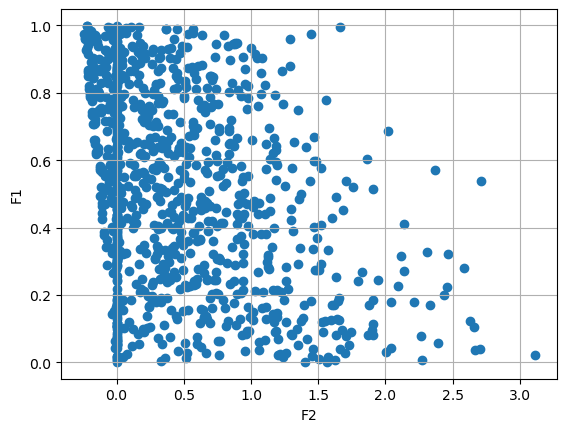

GENERATION :- 2
[[0.07366841603069729, 0.09310641553531379], [0.07478633161103909, -2.7346089719207617e-06], [0.9573846435130756, -0.15200359347086534], [0.8027376869017478, -0.0202651881038241], [0.9617281261658456, -0.22866527643532736], [0.11535344578813722, 0.3105554946717277], [0.546543577819608, 0.4227483551713524], [0.45782382570374214, 0.655391781262438], [0.06313195932085269, 0.042336061375855494], [0.9747875598242777, -0.24347240001756648], [0.3087491616771285, 0.28535986538081903], [0.1744160326904154, -4.176214555806536e-06], [0.0011158481788021701, 1.5666295393288752], [0.8632291228159754, -0.15380731894139102], [0.07478633161103909, -2.7346089719207617e-06], [0.061983875893524276, 1.130072199993669], [0.07209094568302366, 0.6776238969206015], [0.4027898914603877, -6.3464730237695025e-06], [0.8689118967694693, -0.19685131404793754], [0.3968496596967316, -6.299500461114432e-06], [0.6900470307188439, -8.306806949754787e-06], [0.15128371619004177, 0.19143628470266924], [0.108

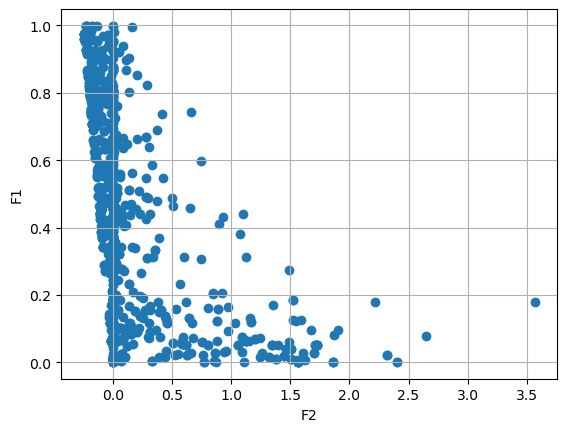

GENERATION :- 3
[[0.10798090862805143, -3.285944866219137e-06], [0.0011158481788021701, 1.2401848050482611], [0.5257051558094518, -7.250452777612558e-06], [0.5093875890622132, -7.1370394063883405e-06], [0.006927054065231419, -8.3218925652272e-07], [0.958114990269584, -0.2380804319124422], [0.259385171663019, -0.061773487117219326], [0.3863032675792094, -0.09617836711795728], [0.1027831880776181, 0.1968329827537722], [0.11784379403126366, 0.3160913793139661], [0.088823017725567, 0.017633972615345314], [0.958114990269584, -0.18101034164401889], [0.0011158481788021701, 1.5666295393288752], [0.37858310368035775, -0.09338728766560647], [0.0168513883166983, 1.2408041237296432], [0.2664146067554427, -0.023988257136819666], [0.20009938781253922, -4.473147006510363e-06], [0.06480985066272571, -2.5456778902081326e-06], [0.2980381389760774, -5.459186940398695e-06], [0.31176026733430284, -0.0724576382594262], [0.2851170935771501, -0.017529819256228908], [0.1685745762885803, -4.105683436672961e-06]

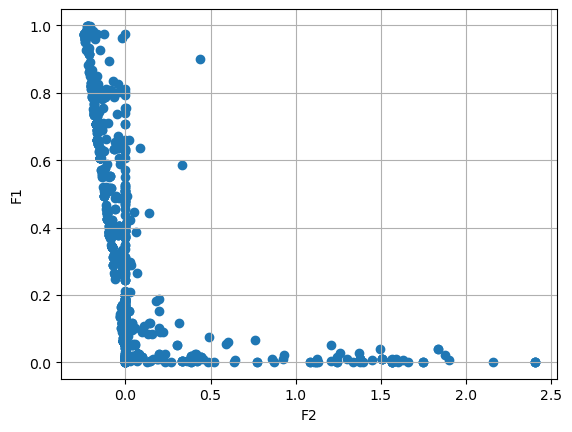

GENERATION :- 4
[[0.023470592878293117, 0.5433485990986846], [0.12712517877759905, -3.565361804277239e-06], [0.006927054065231419, -8.3218925652272e-07], [0.6265411431457618, -0.12351206292681716], [0.9499115611860236, -0.2374506663723419], [0.829980924356461, -0.2002787123776921], [0.07478633161103909, -2.7346089719207617e-06], [0.06313195932085269, -0.015733143642345605], [0.0537290536006253, -2.317852838187725e-06], [0.5161634660357977, -0.12281035751593705], [0.0020483663074908343, 1.5988418058265053], [0.010832415073032564, -1.040688887000268e-06], [0.0017552501265934994, -4.188570534784562e-07], [0.0151427471318906, 0.18737923547864346], [0.006927054065231419, -8.3218925652272e-07], [0.0011158481788021701, 1.1312696668998954], [0.8194219741753328, -0.20483103505750597], [0.010832415073032564, -1.040688887000268e-06], [0.05173098969517076, -2.2743447607091e-06], [0.0011158481788021701, 0.4650736420647206], [0.06313195932085269, -0.015733143642345605], [0.34254508088667557, -0.0808

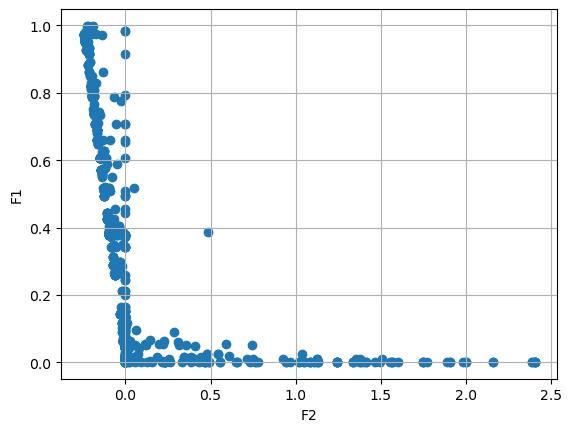

GENERATION :- 5
[[0.014670804194684472, -1.2111309521591856e-06], [0.575957241049712, -0.12192901823444158], [0.34254508088667557, -0.08081785496485058], [0.3863032675792094, -0.06712036476629887], [0.05158098412452872, -2.2710447361304105e-06], [0.8194219741753328, -0.20390759347492943], [0.0017552501265934994, -4.188570534784562e-07], [0.9499115611860236, -0.22230297817558628], [0.0017552501265934994, -4.188570534784562e-07], [0.6065480135490919, -0.15031338216642498], [0.0011158481788021701, -3.339431377535198e-07], [0.006927054065231419, -8.3218925652272e-07], [0.37858310368035775, -0.09420036990483394], [0.010832415073032564, -1.040688887000268e-06], [0.06313195932085269, -0.015733143642345605], [0.4936397269601923, -0.12327610672071013], [0.0011158481788021701, 1.0180555648265126], [0.0011158481788021701, 2.314133393235474], [0.9145084905885988, -0.21624785240398597], [0.010832415073032564, -1.040688887000268e-06], [0.8194219741753328, -0.20390759347492943], [0.059921771686654246

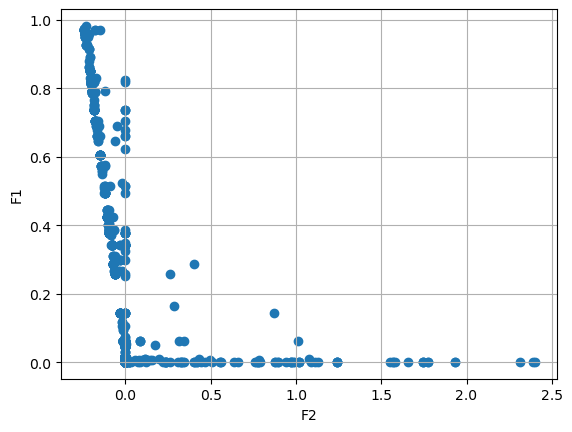

GENERATION :- 6
[[0.006488236228864695, 0.1628818920545743], [0.4258949466396009, -0.105616761559136], [0.0011158481788021701, 0.6255780077830483], [0.006927054065231419, -8.3218925652272e-07], [0.0532489038897932, -2.3074724016765583e-06], [0.0012179007515956913, -3.4888434801516404e-07], [0.7374377770256434, -0.18386748247674856], [0.0017552501265934994, -4.188570534784562e-07], [0.006927054065231419, 0.11064910892831747], [0.8194219741753328, -0.20390759347492943], [0.14433300222920087, -3.7990183481065826e-06], [0.958114990269584, -0.2380804319124422], [0.0017552501265934994, -4.188570534784562e-07], [0.010832415073032564, -1.040688887000268e-06], [0.010832415073032564, -1.040688887000268e-06], [0.006488236228864695, 0.42499672767096575], [0.6611085755055351, -0.16527251622725203], [0.37858310368035775, -0.09338728766560647], [0.28816743712056736, -5.368022922591913e-06], [0.34254508088667557, -0.08081785496485058], [0.371650393197251, -6.096213584431587e-06], [0.4258949466396009, 

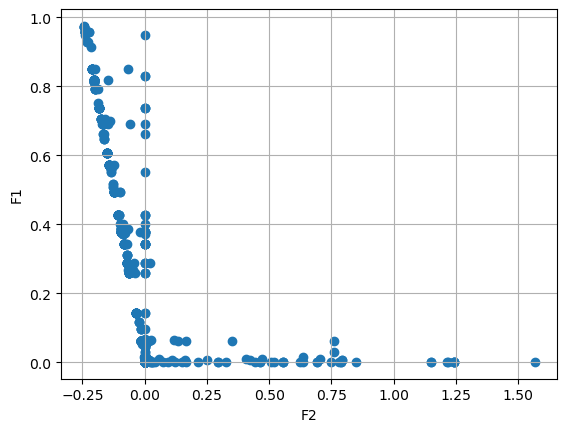

GENERATION :- 7
[[0.010832415073032564, -1.040688887000268e-06], [0.0011158481788021701, -3.339431377535198e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.4258949466396009, -0.10575875570360117], [0.0011158481788021701, -3.339431377535198e-07], [0.34254508088667557, -0.08081785496485058], [0.007048323226995235, -8.394429248701483e-07], [0.37858310368035775, -0.09420036990483394], [0.0011158481788021701, -3.339431377535198e-07], [0.0011158481788021701, -3.339431377535198e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.958114990269584, -0.23812693416759279], [0.0017552501265934994, -4.188570534784562e-07], [0.5720908846283238, -0.14301553338721668], [0.0017552501265934994, -4.188570534784562e-07], [0.006927054065231419, -8.3218925652272e-07], [0.8103611982319888, -9.001906433190263e-06], [0.4258949466396009, -6.525962722956322e-06], [0.4258949466396009, -0.105616761559136], [0.0017552501265934994, -4.188570534784562e-0

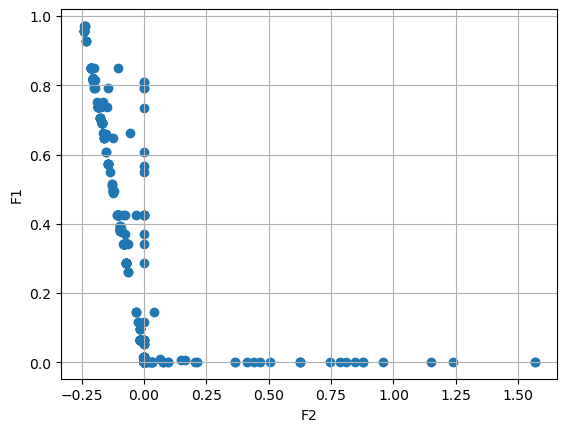

GENERATION :- 8
[[0.28816743712056736, -0.07038578441192289], [0.0017552501265934994, -4.188570534784562e-07], [0.006927054065231419, -8.3218925652272e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.06313195932085269, -0.015733143642345605], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.4258949466396009, -0.105616761559136], [0.06313195932085269, -0.015733143642345605], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.7059858852692411, -0.1760486816771077], [0.06313195932085269, -0.015733143642345605], [0.0017552501265934994, -4.188570534784562e-07], [0.006927054065231419, -8.3218925652272e-07], [0.37858310368035775, -6.152810723229761e-06], [0.006927054065231419, -8.3218925652272e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.37858310368035775, -0.090005968195537

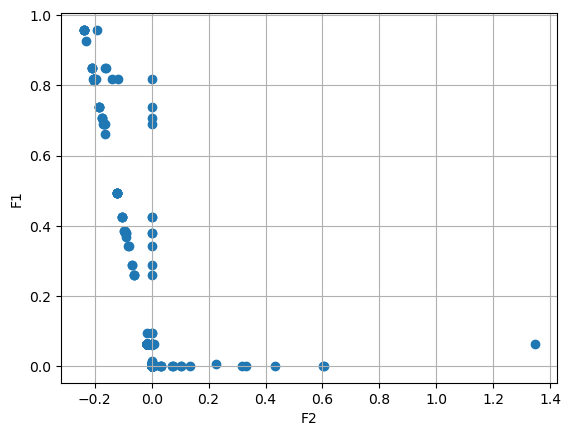

GENERATION :- 9
[[0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.06313195932085269, -0.015733143642345605], [0.0011158481788021701, 0.25185271918504076], [0.8497979033562, -0.2107925673976548], [0.0017552501265934994, -4.188570534784562e-07], [0.06565121136939144, -2.562149233962056e-06], [0.06313195932085269, -0.015733143642345605], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.8497979033562, -0.2107925673976548], [0.0017552501265934994, -4.188570534784562e-07], [0.06313195932085269, -0.015733143642345605], [0.0011158481788021701, -3.339431377535198e-07], [0.06313195932085269, -0.015733143642345605], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.7059858852692411, -0.1760486816771077], [0.06313195932085269, -0.015733143642345605], [0.06313195932085269, -0.015733143642345605], [

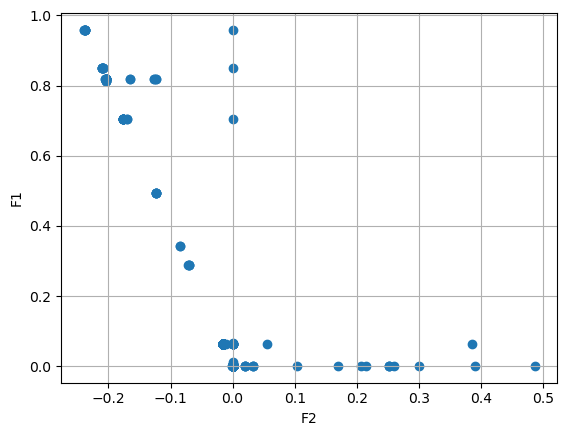

GENERATION :- 10
[[0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0011158481788021701, -3.339431377535198e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0011158481788021701, -3.339431377535198e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0011158481788021701, -3.339431377535198e-07], [0.0017552501265934994, -4.188570534784562e-07], [0.0017552501265934994, -4.188570534784562e-07], [0

In [98]:
#Main Function

population_size = 1000
number_of_variables = 30
variable_upper_bound = [1] 
variable_lower_bound = [0]
for i in range(29):
    variable_upper_bound.append(1)
    variable_lower_bound.append(-1)
    
#print(variable_lower_bound)
#print(variable_upper_bound)

threshold = population_size*0.8

print(f'Threshold = {threshold}')

population = Generate_population(population_size, number_of_variables, variable_upper_bound, variable_lower_bound)

for i in range(100):
    print(f"GENERATION :- {i+1}")
    counter = 0
    first_counter = 0
    function_values = Function_values(population)
    print(function_values)
    
    first_value = function_values[0] # Get the first element of the first sublist
    first_f1_point = first_value[0]
    
    for sublist in function_values:
        if sublist == first_value:
                first_counter += 1
        for value in sublist:
            if value == first_f1_point:
                counter += 1 # Found different value
    
    if counter >= threshold or first_counter >= threshold:
        print(f"Convergence reached after {i+1} generations as there are {threshold} same values")
        break
    
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation(function_values)
    #print(pareto_optimal_front_values)
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    #print(crowding_distance_calculation_values)
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                len(population), population)
    population = final_selected_values
    offspring_population = Crossover2(population)
    offspring_population = Mutation(offspring_population,  lows=variable_lower_bound, highs=variable_upper_bound)
    population = New_generations(population, offspring_population)
    #print(population)
    x = []
    y = []
    for i in function_values:
        x.append(i[0])
        y.append(i[1])
    #plt.figure(figsize=(8, 6))
    # plt.xlim(-1, 3)  # Limit x-axis from 0 to 6
    # plt.ylim(-1, 3)  # Limit y-axis from 0 to 6

    plt.scatter(y,x)
    plt.ylabel("F1")
    plt.xlabel("F2")
    plt.grid()
    plt.show()

In [99]:
# Global Variables  
r = []
w = [6,6,8,7]
v = [1,2,3,2]
alpha = [1, 2.3, 0.3, 2.3]
beta = [1.5, 1.5, 1.5, 1.5]
C = 400
V = 250
W = 500

In [100]:
# Creation of the initial population
def Generate_population_2(population_size, number_of_variables, variable_upper_bound, variable_lower_bound):
    global r
    pseudo_list = []
    rt = np.random.uniform(0.5, 1, size = number_of_variables)
    pseudo_list.append(rt)
    print(f"r: {rt}")
    population = np.zeros((population_size, number_of_variables))
    
    z, r_no, = 0,1
    #g11, g22, g33 = 99999999, 99999999, 99999999
    while True:
        g1, g2, g3 =0,0,0
        z += 1
        # z1 += 1
        x = np.random.randint(variable_lower_bound, variable_upper_bound, size=number_of_variables)
        for j in range(number_of_variables):
            g1 += ((alpha[j]*pow(10,-5))*(-1000/m.log(rt[j]))**beta[j])*(x[j] + m.exp(x[j]/4))
            g2 += v[j]*(x[j])**2
            g3 += w[j]*(x[j] + m.exp(x[j]/4))
        
        # if g1 < g11:
        #     g11 = g1
        # if g2 < g22:
        #     g22 = g2
        # if g3 < g33:
        #     g33 = g3
        
        
        #print(f"{r_no}-{z}:- g1= {g1}; g2= {g2}; g3= {g3}")
        
        
        if g1 <= C and g2 <= V and g3 <= W:
            
            r = rt
            
            #print(f"Done for {i+1} iteration")
            # print(f"looped for {z1} times")
            break
        elif z > 10000:
            r_no += 1
            #print(f"Changing Value of R for {r_no}th time")
            while True:
                rt = np.random.uniform(0.5, 1, size=number_of_variables)
                # Check if the array r is in pseudo_list
                if not any(np.array_equal(r, arr) for arr in pseudo_list):
                    break
            pseudo_list.append(r)
            if r_no > 10000:
                print("Unable to find a feasible solution after 20000 iterations")
                exit(0)
            #print(f"r: {r}")
            z = 0
        # clear_output(wait=True)
        # gc.collect()
        #print(f"Least value of G1 is = {g11}, G2 is = {g22}, G3 is = {g33}")
        
    for i in range(population_size):
        while True:
            g1, g2, g3 =0,0,0
            x = np.random.randint(variable_lower_bound, variable_upper_bound, size=number_of_variables)
            for j in range(number_of_variables):
                g1 += ((alpha[j]*pow(10,-5))*(-1000/m.log(r[j]))**beta[j])*(x[j] + m.exp(x[j]/4))
                g2 += v[j]*(x[j])**2
                g3 += w[j]*(x[j] + m.exp(x[j]/4))
            
            if g1 <= C and g2 <= V and g3 <= W:
                break
        population[i, :] = x
    
    # print(population)

    return population  # [[X1, X2, X3, ..... , Xn]]

In [101]:
# Function calculation of population
def Function_values_2(population):
    values = []
    #print(f"Value of r in Function_values_2: {r}")
    for i,x in enumerate(population):
        f1,f2 = 1,0
        for j in range(len(r)):
            
            f1 *= (1 - (1 - r[j])**x[j])
            f2 += ((alpha[j]*pow(10,-5))*(-1000/m.log(r[j]))**beta[j])*(x[j] + m.exp(x[j]/4))
            
        values.append([f1,f2])
    
    print(values)

    return values   # [F1, F2]

In [102]:
# Fitness calculation of the Function Values
# Finding the Pareto Optimal solutions

def Non_dominated_sorting_fitness_calculation_2(function_values):
    
    pareto_optimal_fronts = [] # Contains the list of final function values all the fronts
    domination = {} # Contains the index as Key and the dominates Indexes and How many are dominating
                    # {"Index of the Function Value": [["dominating index"], No of solutions dominates by]}
    front = []      # Contains fronts Indexes
    front1 = [] # Contains the Index of the Solutions of the first front
    for i, x in enumerate(function_values):
        sp = []     # Contains the list of Solutions that the current value is Dominating
        np = 0      # Contains the number of solutions that are Dominating the current solution 
        for j, y in enumerate(function_values):
            if x[0] > y[0] and x[1] < y[1]: # Since Maximization Criteria of F1 and Minimization Criteria of F2
                sp.append(j)
            elif x[0] < y[0] and x[1] > y[1]:
                np += 1
        
        domination[i] = [sp, np]
        
        if np == 0:
            front1.append(i)
    front.append(front1)
    
    
    i = 0
    while len(front[i]) > 0:
        temp = []
        for individual in front[i]:
            for other_individual in domination[individual][0]:
                domination[other_individual][1] -= 1
                if domination[other_individual][1] == 0:
                    temp.append(other_individual)
        i += 1
        front.append(temp) # Entering the Values in the Next
    
    for i  in range(len(front)):
        _ = []
        for individual in front[i]:
            _.append(function_values[individual]) # Converting Index Values to Function
        
        pareto_optimal_fronts.append(_)
    
    return pareto_optimal_fronts    # [[[F1, F2], [F1,F2],..]-> Front1, [[F1,F2], [F1,F2],....]-> Front2, ...]

In [103]:
# Function to generate the new Generation of better solutions
def New_generations_2(Parent_population, Offspring_population):
    
    combination_of_generations = [] # List containing the combination of both parent and child population
    next_generation_values = [] # List containing the values of the next/new generations
    
    
    for i in range(len(Parent_population)):
        combination_of_generations.append(Parent_population[i])
        combination_of_generations.append(Offspring_population[i])
    
    # List containing the function values
    function_values = Function_values_2(combination_of_generations)
    # list containing pareto optimal fronts
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation_2(function_values)
    # List containing the Crowding distance
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    # List containing the final selected values
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                len(combination_of_generations), combination_of_generations)
    
    for i in range(len(Parent_population)):
        next_generation_values.append(final_selected_values[i])
    
    return next_generation_values

## Maximize F1(x) = [1 - (1 - r1)**x1]*[1 - (1 - r2)**x2]*[1 - (1 - r3)**x3]*[1 - (1 - r4)**x4]
## Minimize F2(x) = C*r1*(x1 + exp(x1/4)) + C*r2*(x2 + exp(x2/4)) + C*r3*(x3 + exp(x3/4)) + C*r4*(x4 + exp(x4/4))

## subject to 

## g1(r,x) = r1*(x1 + exp(x1/4)) + r2*(x2 + exp(x2/4)) + r3*(x3 + exp(x3/4)) + r4*(x4 + exp(x4/4)) <= C
## g2(r,x) = v1*(x1)^2 + v2*(x2)^2 + v3*(x3)^2 + v4*(x4)^2 <= V
## g3(r,x) = w1*(x1 + exp(x1/4)) + w2*(x2 + exp(x2/4)) + w3*(x3 + exp(x3/4)) + w4*(x4 + exp(x4/4)) <= W

v = [1,2,3,2]
w = [6,6,8,7]
V = 250
C = 400
W = 500

Threshold = 800.0
r: [0.53380797 0.5147953  0.63426912 0.58400783]
GENERATION :- 1
[[0.4946825234875602, 28.761189563849282], [0.34721041866164426, 25.844799129286784], [0.5534896379795798, 28.50290408410317], [0.38733419599129526, 31.45614339818307], [0.7905930474463394, 34.37272326027805], [0.9130236490648751, 40.40465577635016], [0.6224388261948934, 48.0345741361834], [0.7977218995275998, 31.003026923333167], [0.6639270092483831, 20.686858638915837], [0.39576217530893226, 23.106472872658678], [0.4793767046755368, 46.15405171841545], [0.6973813411130316, 21.634858699493677], [0.36476919553325404, 28.79234259609713], [0.30741099472307815, 23.693048593667534], [0.8110737081248033, 33.003772692125786], [0.7239869653795485, 39.78892545679453], [0.2999029337708338, 19.875901864762206], [0.5198152538143022, 44.191494025708245], [0.49916474133598965, 24.245316787407244], [0.34888889056884315, 40.60748007256053], [0.5516957271147075, 19.282332558634103], [0.4755299927317154, 25.5278064370503

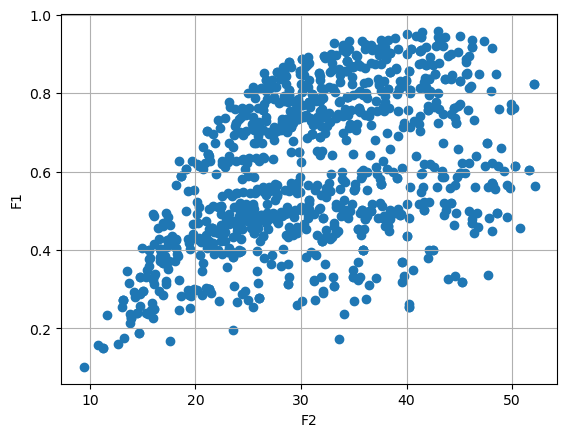

GENERATION :- 2
[[0.4083295481447317, 17.339655074497216], [0.626070784991338, 18.440544352571344], [0.3840127897003255, 17.133711032361173], [0.8902828229833176, 32.265223714896564], [0.7119987780375562, 22.34616312590924], [0.42943684270485843, 17.6232663978085], [0.9103228845481846, 41.320263209338364], [0.8894346482324734, 38.049046017975826], [0.4169268865018874, 18.323155927593497], [0.9356102205109765, 37.982288373771375], [0.4003170917978797, 15.607053439436552], [0.3323911333146299, 15.355340912497855], [0.5966026634353717, 18.74488078877897], [0.833816876611999, 30.545708647088965], [0.5073640570454023, 24.239169635422737], [0.9553757028704012, 40.97815518468036], [0.93330218341546, 34.53343311920419], [0.24154863964910922, 14.393653617364922], [0.48375187483653687, 25.143583280795355], [0.8137309439807148, 31.53579074800276], [0.8448604421073096, 28.553494755539916], [0.40390166062169797, 16.64723097148096], [0.9571279331393197, 41.472935472258996], [0.7119987780375562, 22.3

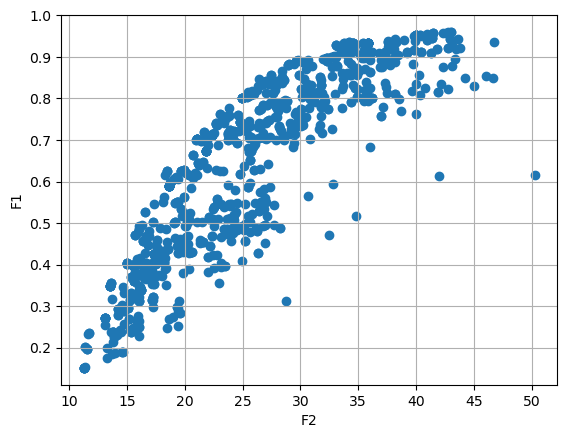

GENERATION :- 3
[[0.7119987780375562, 22.34616312590924], [0.9233965034812001, 34.23722486007226], [0.7420780688726297, 22.66249177106952], [0.4859994700907669, 16.027670727147203], [0.8948383046298358, 32.33458353718998], [0.5880948269857504, 18.611694373203374], [0.9580426896678963, 42.55684048266153], [0.7014899467764824, 21.1325866359916], [0.8454745294374402, 27.090754759714628], [0.31265968881484896, 14.333659209240498], [0.19641270078814865, 11.577833940030178], [0.9293034962828712, 35.03425883295926], [0.42864956040883095, 16.757807291730323], [0.9520891361128185, 38.978606836689394], [0.9518577279388617, 40.027712322972945], [0.8320469725235474, 26.581810075121098], [0.6171243661942049, 19.24853948572504], [0.7663718504010277, 26.185646150965624], [0.8869935407779233, 29.469604161831008], [0.34700585987260935, 14.641501136334636], [0.8085704944384043, 25.38988789651704], [0.8957829675002776, 32.47184826431127], [0.960246106679671, 42.771017655236925], [0.9518577279388617, 40.0

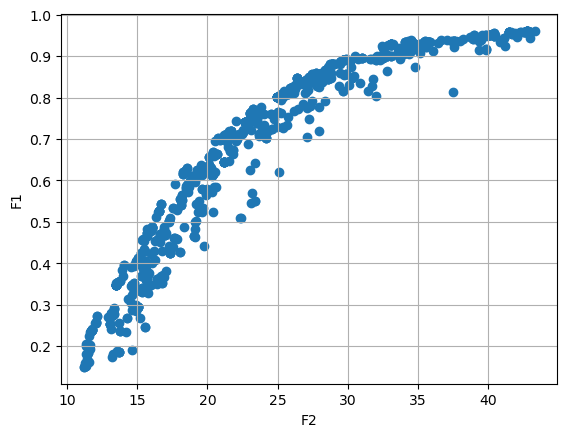

GENERATION :- 4
[[0.8837570867490251, 28.993102977715417], [0.8506115070417509, 27.571263118539086], [0.9348618405588077, 34.07769331173101], [0.4865328873474484, 16.06764733952426], [0.8403307123625725, 26.883124607940154], [0.7035426822750612, 21.079973556101937], [0.9233203762070822, 32.415638013696494], [0.35220862676947834, 13.463274098221628], [0.44145744486919924, 15.402395334199607], [0.26379879102941983, 12.171279589022447], [0.8413194874401038, 27.128775949333736], [0.9450128349025139, 38.693143860914276], [0.16117738453738967, 11.178966612412301], [0.7420780688726297, 22.66249177106952], [0.4046156807782851, 14.968517135349721], [0.8197544508935569, 25.756512612295683], [0.18425198585405742, 11.437018950751284], [0.8019823844735428, 24.949596121103248], [0.2602357289319292, 12.197692651108085], [0.5956079137312055, 18.779937849277704], [0.8400106482584607, 26.99146383628522], [0.659413616931707, 20.42411407665007], [0.5782009735809142, 18.229479001540646], [0.755566358275184

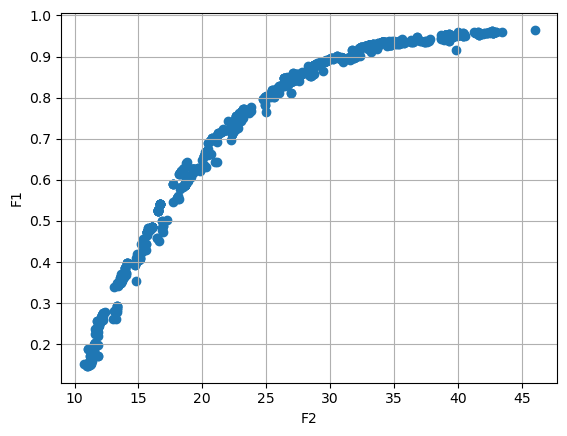

GENERATION :- 5
[[0.8599857058569411, 27.823622276497645], [0.6250327315414603, 18.482346987737895], [0.8473931446809226, 27.264787379861872], [0.7035426822750612, 21.079973556101937], [0.7631971451482675, 22.862613134137803], [0.9281631692352952, 33.08820996991814], [0.8885550872798677, 29.518007787246027], [0.927904775638616, 33.04863433972304], [0.8215371900389795, 25.903568748305386], [0.9290971667921164, 33.19894823019624], [0.5178372108333089, 16.517168266339638], [0.8877315726767631, 29.38289111928455], [0.23260490676094933, 11.426731704127558], [0.9225878546719739, 32.54302740106746], [0.3762157834968037, 13.913332260551087], [0.6159737001444415, 18.282202867594265], [0.8760158015073921, 28.25030676942164], [0.1591212037207337, 11.312987551848803], [0.5323778889557975, 16.494508680268694], [0.786157946517997, 24.6784373408128], [0.4046156807782851, 14.968517135349721], [0.8057010414637293, 25.008273137685386], [0.8057010414637293, 25.008273137685386], [0.8712694573545704, 27.81

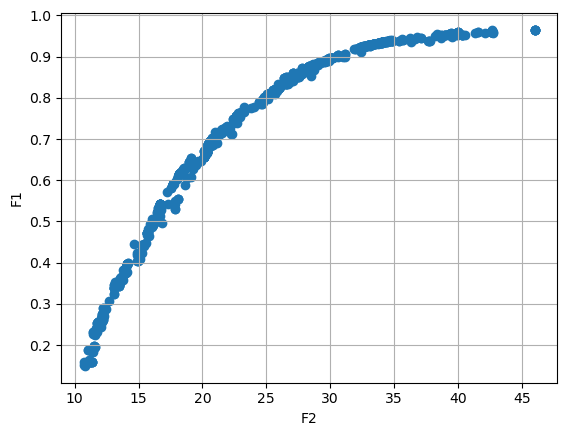

GENERATION :- 6
[[0.9352613384581636, 34.15304665377114], [0.9346420770247222, 34.05916234508654], [0.9433606356345049, 35.602966949330565], [0.6948984562450475, 20.57132988141214], [0.9285486387967817, 33.18412809620219], [0.4482251399140346, 15.564936582895498], [0.8603251073106919, 27.11851848225161], [0.7212361615898397, 21.495264172971584], [0.9280041710492382, 33.07359452764295], [0.7902949944531974, 24.455770125123685], [0.9437650358799511, 35.60410188704792], [0.6930596248542612, 20.844400383383338], [0.9254679976358063, 32.62580699782526], [0.5424360548577886, 16.704849981728394], [0.5424360548577886, 16.704849981728394], [0.8193575276692582, 25.494562004674236], [0.43970234511011036, 15.318783794448764], [0.8810145677879686, 28.61076913106224], [0.8971971857737681, 30.10184525883712], [0.6308303489758065, 18.497513383789535], [0.498569753891876, 16.009369200802183], [0.9596747193936422, 40.221973797968154], [0.9357828480369268, 34.23938201939875], [0.6954059729384463, 20.6061

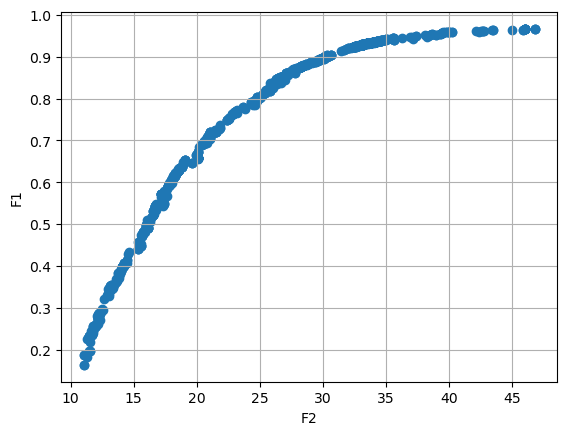

GENERATION :- 7
[[0.935157698797182, 33.9967816002828], [0.634123183227842, 18.628165133411127], [0.8474249008423145, 26.36480526514586], [0.7651780432359664, 22.75220375590766], [0.7194627598229438, 21.01718616574856], [0.6201551661433323, 18.28451142506214], [0.9360031895719902, 34.203920054068476], [0.9584910139907677, 39.839645864152075], [0.8837570867490251, 28.993102977715417], [0.9238222311293934, 32.503908626358296], [0.9362455197031442, 34.23610012539904], [0.9347795848056012, 34.0176067864358], [0.8603251073106919, 27.11851848225161], [0.8875687849032138, 29.374413316959306], [0.23260490676094933, 11.426731704127558], [0.8105874860335316, 25.247774047519094], [0.8617991742603106, 27.209757796441988], [0.9566556547204147, 39.48923533316696], [0.878497934680322, 28.364810471428967], [0.8500516969914022, 26.63034777688603], [0.8763645690451437, 27.999369623323915], [0.36517897110947023, 13.68381906055909], [0.23260490676094933, 11.426731704127558], [0.5323778889557975, 16.494508

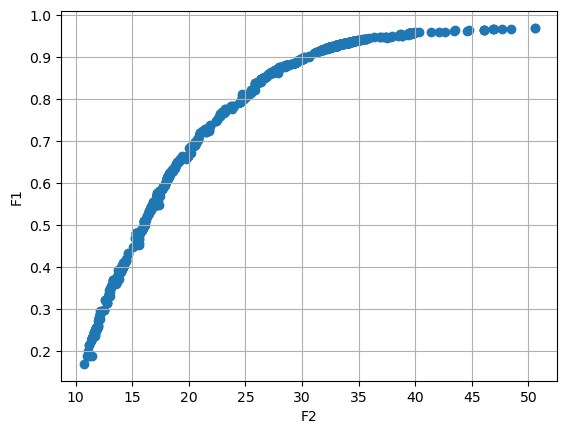

GENERATION :- 8
[[0.6964485095323755, 20.529157058818555], [0.7194627598229438, 21.01718616574856], [0.47723672283042134, 15.276005696378212], [0.9661811186967136, 46.83672246868366], [0.9316851616707036, 33.50419212417174], [0.9138278189798384, 31.31230830366772], [0.837907825210179, 25.874477154831535], [0.5086276928133708, 16.042028661397616], [0.8751003598990054, 28.03100337460951], [0.9320872431527153, 33.56710252755568], [0.6048190994337898, 17.97959331335705], [0.9328088242084794, 33.6752112694385], [0.7839486338430318, 23.74511079545644], [0.510429295982344, 16.25991026494821], [0.9298030494754952, 33.23276174261], [0.9259204241970037, 32.684256380410844], [0.9286344577574752, 33.0866954626142], [0.8902583164216195, 29.25946043139652], [0.9254679976358063, 32.62580699782526], [0.5859181610311704, 17.289198024936056], [0.8681876179641431, 27.600057487124964], [0.5950945062518187, 17.69026038688552], [0.9473996022732342, 36.992774700081185], [0.722013789905782, 21.52175655903605]

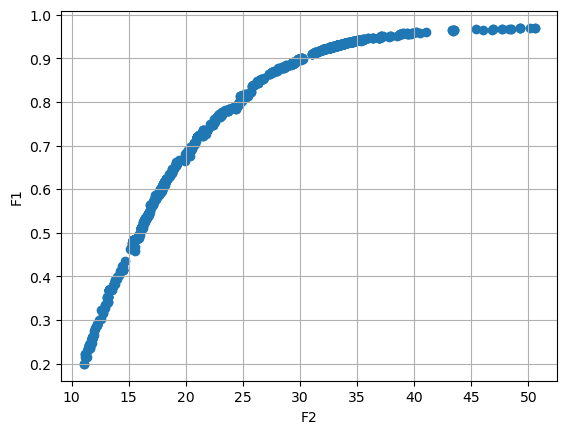

GENERATION :- 9
[[0.8977025023453892, 29.858040684338995], [0.9345998847874462, 33.92027467892669], [0.9509755480508673, 37.07823832174667], [0.6115712298043838, 17.965118462182165], [0.3312613645132906, 12.86066480948265], [0.9252784846028271, 32.60137406408805], [0.5361513036246537, 16.587946106046793], [0.9315664752221283, 33.48881058844562], [0.837907825210179, 25.874477154831535], [0.8904200620452097, 29.28238783486438], [0.9315206853257342, 33.493573094971964], [0.9488823759266319, 36.55960047393649], [0.6706864875598857, 19.987541601019785], [0.9218920649373747, 32.21211838419379], [0.9673571154237895, 48.04701897409395], [0.8994601197175326, 29.96728066743239], [0.9205387507990219, 32.02220505381918], [0.6157396959187241, 18.054618556029368], [0.7170581824292638, 20.86793359924875], [0.9405764632843102, 34.860174331190905], [0.6242404114427391, 18.322205796482177], [0.7934895909731636, 24.55180308354644], [0.7194627598229438, 21.01718616574856], [0.9568016554387888, 38.90910131

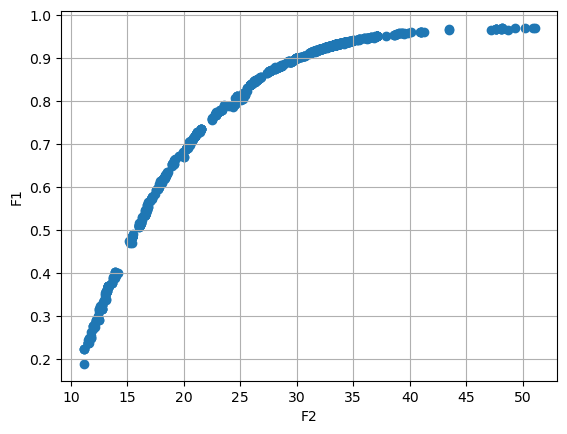

GENERATION :- 10
[[0.933557243972495, 33.76707736014011], [0.9172194931456051, 31.735740888862292], [0.8461891344093334, 26.193290036853043], [0.881301080392547, 28.419924333936216], [0.9332798083697902, 33.72975540682061], [0.9274674262030259, 32.91531079141611], [0.804757165530222, 24.373186562996025], [0.9293008988721709, 33.16268132952193], [0.8697700629550853, 27.521566354606968], [0.4822701577114056, 15.361100421373582], [0.6484665580800258, 18.96938985988681], [0.8066798481245342, 24.47884177230611], [0.3959417157829715, 13.960952193032508], [0.8739377633359048, 27.890305003652312], [0.9259204241970037, 32.684256380410844], [0.3344084461084106, 12.87386559954968], [0.9147114805031759, 31.442898046897888], [0.9304065188249523, 33.329379889769115], [0.6230358608599207, 18.294861162881844], [0.9676530498825594, 47.671036443910566], [0.9426125535118192, 35.33390849940464], [0.9311657558093656, 33.39123632108504], [0.8503676734459609, 26.555733825977747], [0.958061345852478, 39.04341

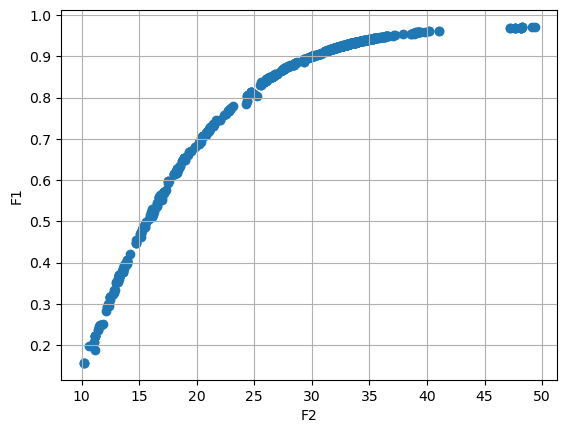

GENERATION :- 11
[[0.6157396959187241, 18.054618556029368], [0.8137163604360956, 24.714935097916886], [0.9488823759266319, 36.55960047393649], [0.48545222955914913, 15.45945135540681], [0.9405764632843102, 34.860174331190905], [0.9364079490761269, 34.203318074014895], [0.35871215517801996, 13.1119286246278], [0.9309654443619252, 33.36434829513211], [0.9179198445090161, 31.754002433497956], [0.7194627598229438, 21.01718616574856], [0.8371582507287915, 25.5857915133845], [0.7650787924310373, 22.618599603848764], [0.8724259716324497, 27.708108001407943], [0.9166371392651359, 31.681259112946364], [0.736255153556281, 21.52615403960739], [0.9378698085209939, 34.431098924394014], [0.5944970915619786, 17.512824015559517], [0.8977025023453892, 29.858040684338995], [0.5360653571859546, 16.362075036857707], [0.9345064629556834, 33.909585136643884], [0.9158001089254549, 31.493837620321283], [0.7075351426649235, 20.51197338286748], [0.7644746093819168, 22.563504304874407], [0.3221703433924385, 12.5

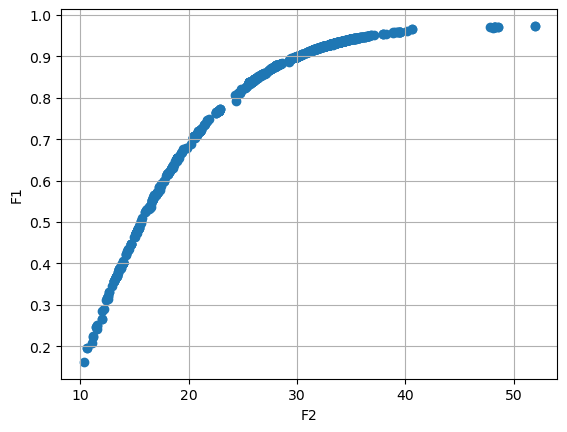

GENERATION :- 12
[[0.8127954635327914, 24.710562677384956], [0.9656929393209172, 40.80582284234576], [0.482718732436569, 15.376763523039946], [0.9208741230718536, 32.06143187472047], [0.9158001089254549, 31.493837620321283], [0.9082787835238071, 30.745120901773408], [0.8720579790030915, 27.685941502331964], [0.9405764632843102, 34.860174331190905], [0.9208741230718536, 32.06143187472047], [0.9253683537083268, 32.61289145615403], [0.9126945192643464, 31.13937010668518], [0.5031091442262051, 15.661732495919896], [0.9158001089254549, 31.493837620321283], [0.3673468352496478, 13.306354656173971], [0.8449787637980114, 26.08740178824378], [0.9433754986652553, 35.34797960884949], [0.8137163604360956, 24.714935097916886], [0.6689569758667187, 19.294688569335104], [0.5541184607419872, 16.623079317906324], [0.7682442458598239, 22.820096931583482], [0.9307146876110999, 33.330043579583574], [0.35871215517801996, 13.1119286246278], [0.9356948475036079, 34.07696285318674], [0.8815471716198651, 28.51

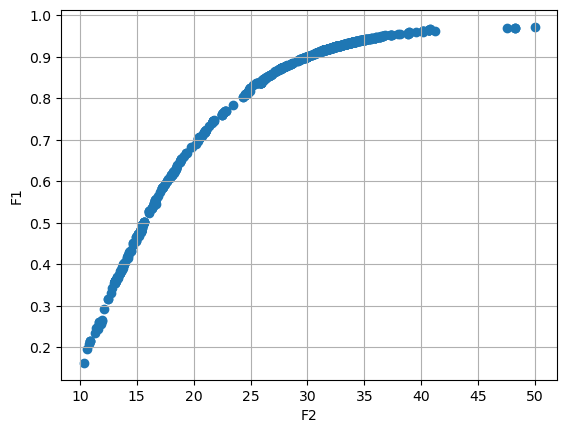

GENERATION :- 13
[[0.933557243972495, 33.76707736014011], [0.9252784846028271, 32.60137406408805], [0.9207616355737025, 32.048567513439444], [0.36853458566560005, 13.28153368027112], [0.8964259574162562, 29.686860370612774], [0.8781369759292795, 28.113155829274643], [0.9285728728146575, 33.05111387934074], [0.9252784846028271, 32.60137406408805], [0.8772818984825013, 28.079554912818516], [0.5031091442262051, 15.661732495919896], [0.9431236638959084, 35.37790106951863], [0.8184841498333951, 25.106100567824086], [0.5102102004120734, 15.783344406584266], [0.39314512979999705, 13.73426586578485], [0.9709592465765415, 50.609384053622506], [0.8498771535145572, 26.310699290478325], [0.9268868878082082, 32.86755761686298], [0.9252328096491321, 32.595906498932685], [0.9405764632843102, 34.860174331190905], [0.9346005050459155, 33.948008857663325], [0.35871215517801996, 13.1119286246278], [0.7466268153632631, 21.738612406607835], [0.8685304152474561, 27.449212580292624], [0.9656929393209172, 40.

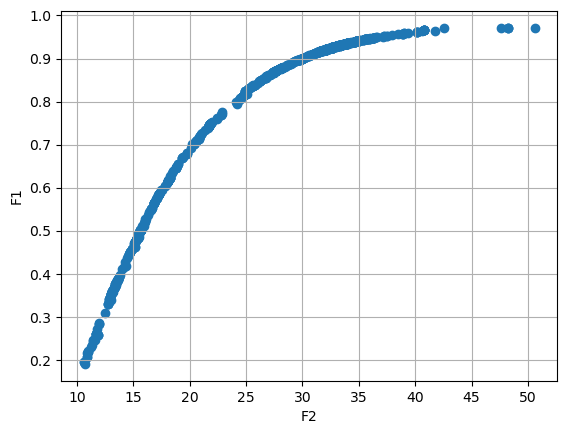

GENERATION :- 14
[[0.9259618856059832, 32.688803851961936], [0.9252784846028271, 32.60137406408805], [0.7445057236768412, 21.706539327452422], [0.23573290174229442, 11.325313167427684], [0.9345998847874462, 33.92027467892669], [0.9268376246007929, 32.81766148888457], [0.925709690354901, 32.65703614561887], [0.9252908682620303, 32.6029521188879], [0.5031091442262051, 15.661732495919896], [0.8127954635327914, 24.710562677384956], [0.9664518629282535, 41.04887640627365], [0.9156415005434392, 31.465648075970865], [0.9334468514300697, 33.752329848920205], [0.9188070510630709, 31.823094788336366], [0.1963824773297006, 10.628792160883698], [0.7073009415780402, 20.49199160425939], [0.9248822103194526, 32.559039013333376], [0.8468374883065402, 26.159958588797792], [0.933557243972495, 33.76707736014011], [0.9412230909975986, 34.98672560432759], [0.9664518629282535, 41.04887640627365], [0.8550671949548005, 26.709219292545946], [0.9222820544231072, 32.23082184893548], [0.926138545137443, 32.723244

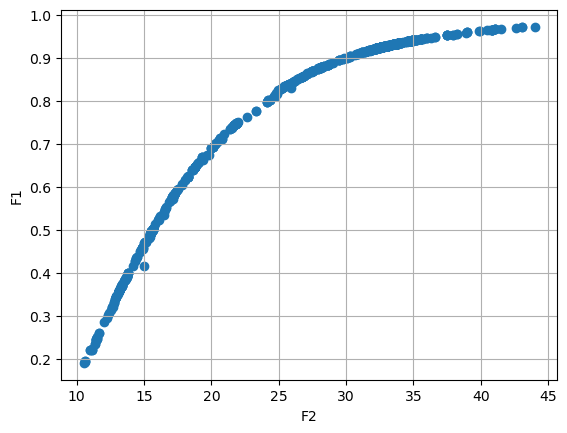

GENERATION :- 15
[[0.553851098650251, 16.640755564957963], [0.9345998847874462, 33.92027467892669], [0.9294161659279234, 33.220828890778634], [0.8627718559285152, 27.10340821310993], [0.1963824773297006, 10.628792160883698], [0.9252784846028271, 32.60137406408805], [0.3457519570759224, 12.910765028929553], [0.8290569782690166, 25.15297605993391], [0.933557243972495, 33.76707736014011], [0.5743194204949449, 17.02483755033168], [0.9252784846028271, 32.60137406408805], [0.939318865816166, 34.6405974546453], [0.6408119028408134, 18.605655986439825], [0.9253104850661542, 32.60551961170687], [0.6414242740923701, 18.632742951779925], [0.9110190710006746, 31.010288174615383], [0.925709690354901, 32.65703614561887], [0.8765324129974211, 27.97530861593342], [0.9293569892265329, 33.169711758315216], [0.8944327735929647, 29.448203649377458], [0.8125748700129644, 24.675267381706334], [0.6848393692036097, 19.849260824987585], [0.7133363239707655, 20.648743565051063], [0.9590817441049354, 38.81393227

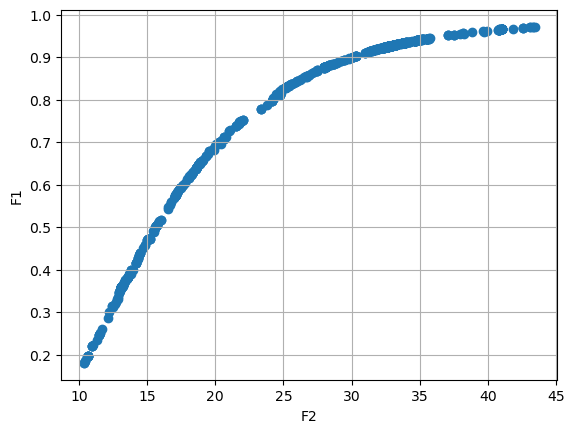

GENERATION :- 16
[[0.6408119028408134, 18.605655986439825], [0.9018923057641101, 30.134856419495357], [0.9256631389298775, 32.65147484970846], [0.924011472416736, 32.442254410535526], [0.7084364042925799, 20.62525332352158], [0.9344593689806995, 33.89792259754502], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9023141870529096, 30.11406535932086], [0.2929495009019338, 12.086198274714391], [0.9299835470709895, 33.33597517280683], [0.9023141870529096, 30.11406535932086], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252324583908341, 32.59558559492681], [0.33811422163668753, 12.825767900204106], [0.5948472281100391, 17.47481483391001], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.952529317943852, 37.479856343543446], [0.7409794969642322, 21.660772032415892], [0.9261477704856211, 32.743806742205294], [0.9252784846028271, 32.60137406408805], [0.9407834664491345, 34.89252586

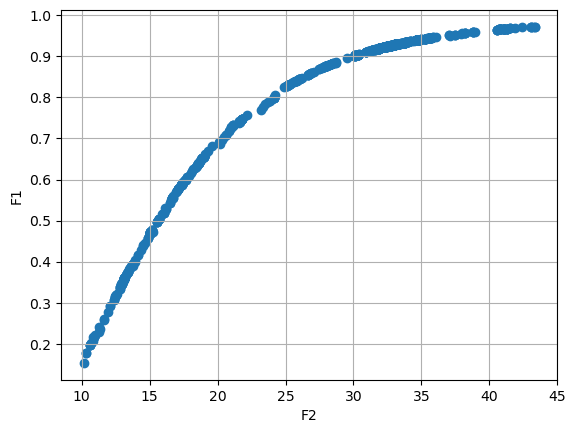

GENERATION :- 17
[[0.5859957782998046, 17.28402910676143], [0.8765324129974211, 27.97530861593342], [0.9159743789680752, 31.5055693015062], [0.9252265913053982, 32.59485131694726], [0.9241585864668969, 32.465929722212756], [0.881296654812622, 28.36112672413373], [0.6557461965391481, 18.99866445524414], [0.3722877521071558, 13.346975992563861], [0.9337122829388599, 33.78302661462338], [0.9252908477512045, 32.602941111433665], [0.35871215517801996, 13.1119286246278], [0.9299099597264421, 33.219660546534634], [0.9194991052744408, 31.89972314534092], [0.39836793349940647, 13.774383487795415], [0.9252784846028271, 32.60137406408805], [0.6408119028408134, 18.605655986439825], [0.473411395719532, 15.09088854645696], [0.9255325835301528, 32.63298960734659], [0.8743709822276668, 27.80061277572279], [0.33376441564489384, 12.799719210205598], [0.8313299326647071, 25.282968553605222], [0.9039388196440415, 30.301461873339562], [0.9393279674442148, 34.64214892708536], [0.9252784846028271, 32.6013740

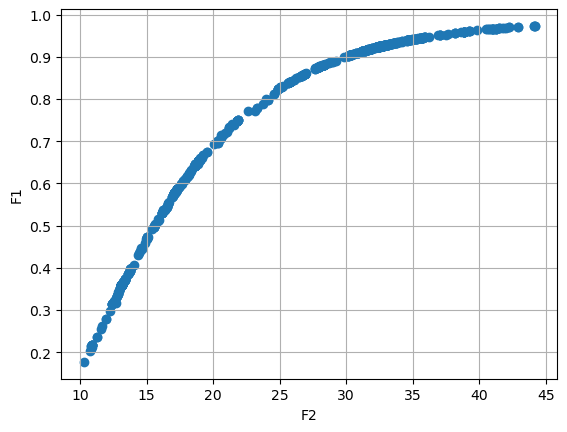

GENERATION :- 18
[[0.9252784846028271, 32.60137406408805], [0.584552097124478, 17.254645694816265], [0.8765324129974211, 27.97530861593342], [0.2176771370261253, 10.92940439867619], [0.3679978046966111, 13.270900073918892], [0.5108154079738472, 15.759268591807327], [0.4074491192543539, 13.989696453713375], [0.9252784846028271, 32.60137406408805], [0.9335805692328956, 33.754908065065706], [0.9336776474428862, 33.78557921453668], [0.9237178649534549, 32.40517198715372], [0.7509199732891303, 21.878089614521098], [0.9245439041193364, 32.5089139972547], [0.9251736909867805, 32.58722706079454], [0.9249809328082508, 32.562461735696246], [0.9252784846028271, 32.60137406408805], [0.5859957782998046, 17.28402910676143], [0.9247528342931712, 32.53391350339292], [0.9252784846028271, 32.60137406408805], [0.9124059768630841, 31.112506011251455], [0.9252784846028271, 32.60137406408805], [0.5776143574400788, 17.102460804175106], [0.9256167104190665, 32.64419367323557], [0.5859957782998046, 17.28402910

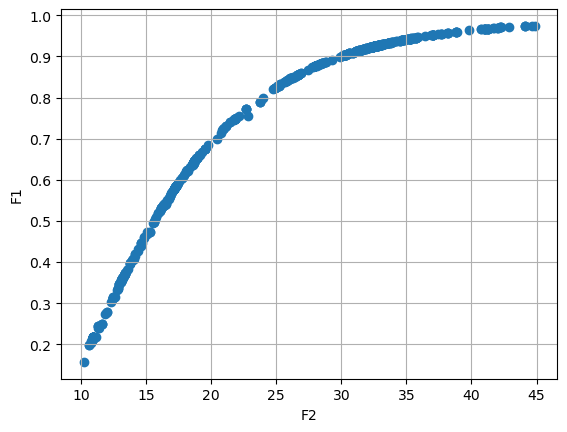

GENERATION :- 19
[[0.83494820390946, 25.460424629366724], [0.35871215517801996, 13.1119286246278], [0.6398513424836355, 18.531474039032094], [0.9262044000393451, 32.720255958187764], [0.9252784846028271, 32.60137406408805], [0.5294916968433272, 16.259689877777337], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9235665993726281, 32.38937998065074], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9263335188175623, 32.738412765897735], [0.9252784846028271, 32.60137406408805], [0.9235665993726281, 32.38937998065074], [0.2176771370261253, 10.92940439867619], [0.2554852073017995, 11.475552703026956], [0.9252784846028271, 32.60137406408805], [0.8767642266370834, 27.9853056885371], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.313230975272804, 12.418885056793304], [0.9252784846028271, 32.601374064088

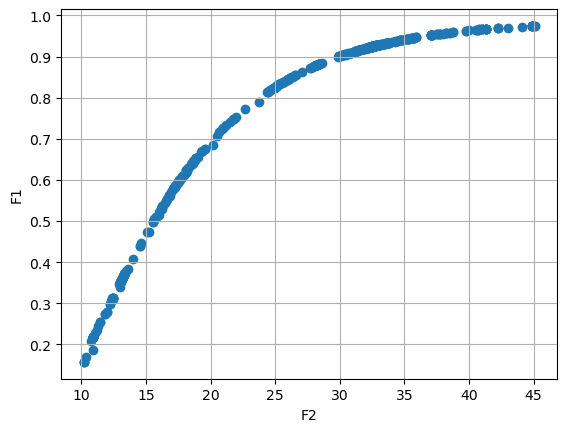

GENERATION :- 20
[[0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028272, 32.601374064088056], [0.9252784846028271, 32.60137406408805], [0.9392157841032289, 34.62459215508547], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9109403392222387, 31.026986502815603], [0.9263660019057107, 32.741470901150585], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.601374064088056], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252701795708541, 32.5996008034454], [0.9252784846028271, 32.60137406408805], [0.9206033401562603, 32.09691924190511], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.22499863490467267, 11.017602501359786], [0.6268855708317216, 18.3576020586

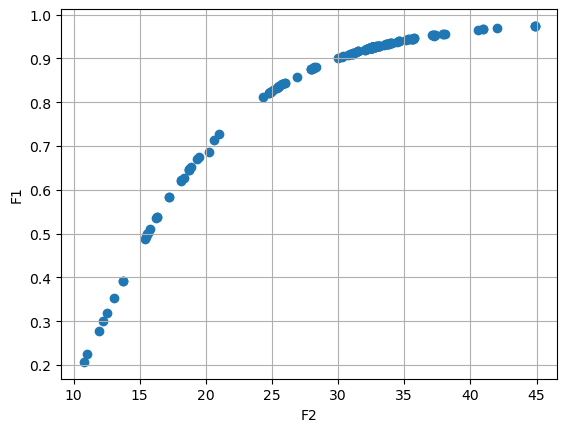

GENERATION :- 21
[[0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9236010442087015, 32.394378578326226], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805], [0.9252784846028271, 32.60137406408805

In [104]:
#Main Function

population_size = 1000
number_of_variables = 4
variable_upper_bound = [] 
variable_lower_bound = []
for i in range(number_of_variables):
    variable_upper_bound.append(10)
    variable_lower_bound.append(1)
    
# print(variable_lower_bound)
# print(variable_upper_bound)

threshold = population_size*0.8

print(f'Threshold = {threshold}')

population = Generate_population_2(population_size, number_of_variables, variable_upper_bound, variable_lower_bound)

for i in range(100):
    print(f"GENERATION :- {i+1}")
    counter = 0
    first_counter = 0
    function_values = Function_values_2(population)
    print(function_values)
    
    first_value = function_values[0] # Get the first element of the first sublist
    first_f1_point = first_value[0]
    
    for sublist in function_values:
        if sublist == first_value:
                first_counter += 1
        for value in sublist:
            if value == first_f1_point:
                counter += 1 # Found different value
    
    if counter >= threshold or first_counter >= threshold:
        print(f"Convergence reached after {i+1} generations as there are {threshold} same values")
        break
    
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation_2(function_values)
    #print(pareto_optimal_front_values)
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    #print(crowding_distance_calculation_values)
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                population_size, population)
    population = final_selected_values
    offspring_population = Crossover(population, lows=variable_lower_bound, highs=variable_upper_bound)
    offspring_population = Mutation(offspring_population,  lows=variable_lower_bound, highs=variable_upper_bound)
    population = New_generations_2(population, offspring_population)
    #print(population)
    x = []
    y = []
    for i in function_values:
        x.append(i[0])
        y.append(i[1])
    #plt.figure(figsize=(8, 6))
    #plt.xlim(50, 300)  # Limit x-axis from 0 to 6
    #plt.ylim(0.9, 0.99)  # Limit y-axis from 0 to 6

    plt.scatter(y,x)
    plt.ylabel("F1")
    plt.xlabel("F2")
    plt.grid()
    plt.show()

Threshold = 800.0
r: [0.78932235 0.59922155 0.92775135 0.54699864]
GENERATION :- 1
[[0.7742164843646664, 96.22175413753374], [0.5279030850498533, 79.36094644825691], [0.8962069866051363, 94.85514165370786], [0.9181895882345563, 87.18300804671787], [0.7048451236511449, 47.92400064403062], [0.9866933085495369, 86.25818911015752], [0.6567954047377852, 60.822090817648004], [0.5982659623430249, 80.19819160412594], [0.9283007045540442, 82.90642965019236], [0.897557721753198, 84.63204996340409], [0.5413404793693608, 111.10629403644405], [0.533481279620797, 51.31223722840144], [0.5434700785149298, 112.37059418634963], [0.39022979574966526, 33.705856829893605], [0.5448088000661131, 70.95824950772295], [0.5436586977620202, 101.73006410656095], [0.5091140681689819, 81.36166068942721], [0.9479786162633035, 108.78948543646968], [0.6671092356802227, 94.74600096498739], [0.4591360288457803, 101.49778201610407], [0.7106197784372338, 84.76618650236425], [0.767043900543476, 81.47908342638267], [0.947353

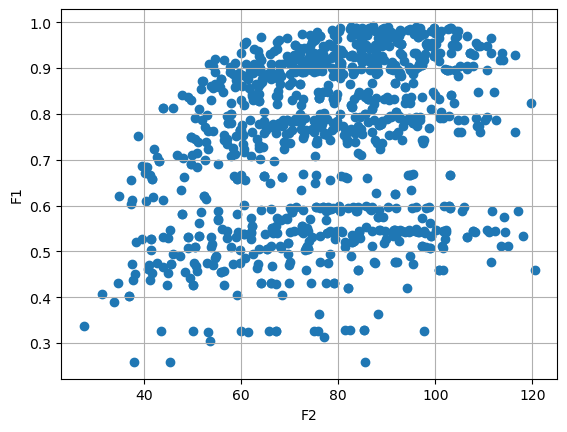

GENERATION :- 2
[[0.9626086036748385, 68.21597661684581], [0.9034082678165154, 75.35529390450147], [0.7800020041944125, 57.38232962562687], [0.9853032363108934, 94.75450045187073], [0.9180976561768069, 56.48404777397231], [0.849921367806698, 83.19430643751105], [0.7508871664177507, 58.87204117045757], [0.9461147373744466, 84.96138121642824], [0.9873895649939675, 83.68179847138576], [0.7002920158320417, 52.56771190995717], [0.96116061469744, 66.85158357371054], [0.7237575312078346, 42.06580134360613], [0.9090823119104903, 62.622353890373056], [0.683448504280475, 40.43142725532545], [0.9764511840080189, 96.53353388814791], [0.8052558685812802, 74.61294805136387], [0.9876851801546478, 89.50425872867453], [0.921781058068664, 70.07309908705668], [0.407059263181344, 31.36442768632722], [0.8563356840751348, 48.590677789718534], [0.5760449480264761, 55.18224562934231], [0.545639129984922, 45.26783594246848], [0.9848863923407649, 82.10378976390705], [0.9091847681587355, 63.37811899866263], [0.9

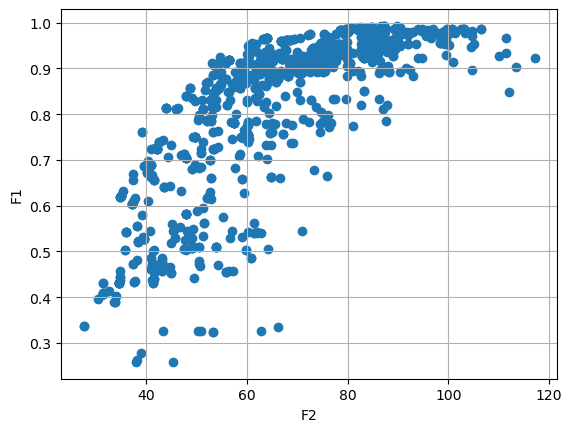

GENERATION :- 3
[[0.7579872448969225, 50.051989724019954], [0.9826548055419032, 77.49280386853214], [0.8801274494227199, 58.08598869520361], [0.4473380508740647, 33.885257354893355], [0.9240317159013656, 64.97378215188769], [0.9928665437906136, 89.89804790373834], [0.9896253819386397, 84.78896878395105], [0.6366304927877574, 35.78043414611902], [0.6860585651968828, 40.660435263920526], [0.7503516618104006, 49.64297763325218], [0.9873949920649338, 80.42792732461858], [0.8391816472701299, 47.91239613606068], [0.4537308248086569, 38.435694076106216], [0.8298361653559202, 49.59614863580728], [0.9287383682721062, 63.34095437548034], [0.9359284635388198, 69.95662309958352], [0.754690203488914, 38.90058948066128], [0.5160241492021261, 35.34031337546655], [0.9150535344337435, 59.521864088205895], [0.6052170793481305, 37.41257248134313], [0.8341243266920112, 47.39761102493873], [0.7080093063910797, 47.867251169800866], [0.8708057979154609, 52.19251146832184], [0.6214615900564499, 34.92505369282

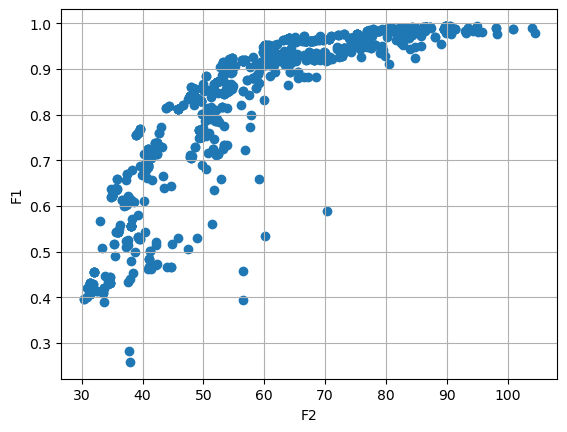

GENERATION :- 4
[[0.9814168561175024, 81.30225818297527], [0.986813768174976, 77.89302389687509], [0.9727783957154568, 70.93173232477605], [0.9930291045317821, 90.45264622882812], [0.9094149849004987, 53.48816061365507], [0.9886650849795419, 82.13705169200873], [0.7237575312078346, 42.06580134360613], [0.754690203488914, 38.90058948066128], [0.9912320849459891, 86.50770953402588], [0.5426970414856578, 35.929579607223175], [0.9920976158915635, 87.20957525922829], [0.9858737901383778, 81.68043437271979], [0.9744463228403343, 72.212104539194], [0.5158108719741306, 37.84237382622], [0.760138736482299, 39.24136662953607], [0.4353794586182824, 31.093021739319596], [0.9086706563571563, 53.322417945034225], [0.9531472944896271, 61.827305473654555], [0.9503091401905743, 59.78615206750898], [0.9147726517914473, 53.263665597693056], [0.431146374856313, 31.995688946729167], [0.991596801041865, 88.21949605412979], [0.9873254914740829, 79.61355791613005], [0.9920709379230676, 86.6166634896404], [0.8

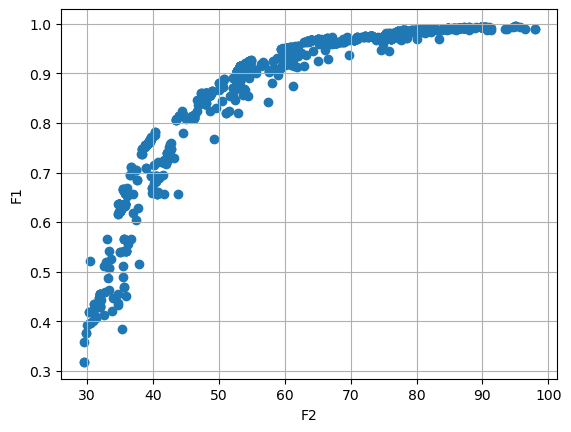

GENERATION :- 5
[[0.986813768174976, 77.89302389687509], [0.8100877477794789, 46.26398389201441], [0.4350004033593427, 31.719399252969037], [0.4197883818764307, 30.134278974995702], [0.9336946309854642, 59.38549964548773], [0.966582858258731, 63.99780537668277], [0.9882982115686741, 81.10182558472675], [0.9880375090243576, 80.90081450108579], [0.9921642415067309, 85.8392591740316], [0.9097406863634966, 52.58101082349576], [0.446168930408194, 31.72570977603047], [0.988813632787946, 81.51039392442016], [0.9802800846166508, 74.5754116629402], [0.6375580477861792, 34.11798362943699], [0.9758450385481486, 72.55736255365122], [0.966582858258731, 63.99780537668277], [0.7644191976754939, 39.60748576832681], [0.625292104361322, 34.735521004176256], [0.8078696945749276, 43.50325446301569], [0.977739960200331, 73.77999248779446], [0.966582858258731, 63.99780537668277], [0.9870384436273507, 78.37820906242601], [0.8669886771115045, 49.00342578216014], [0.760138736482299, 39.24136662953607], [0.9875

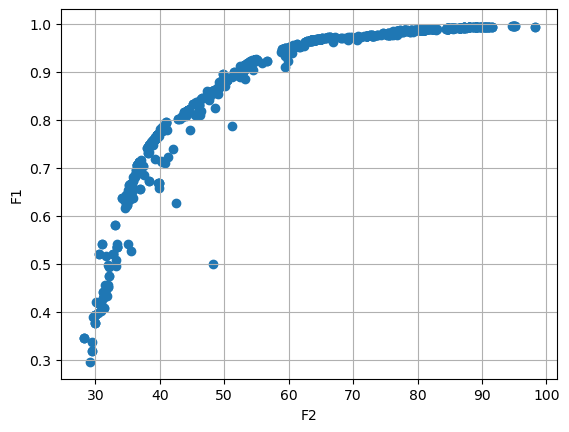

GENERATION :- 6
[[0.830950015468701, 45.28081449834514], [0.8014975660697382, 43.23585268417952], [0.8078696945749276, 43.50325446301569], [0.9544732311220583, 62.38603094266054], [0.7641755914729244, 39.29698868445626], [0.9934310471126796, 89.74238174452178], [0.760138736482299, 39.24136662953607], [0.9924046889023027, 86.43820315340795], [0.9227356011580644, 54.299888167133275], [0.7600898582102039, 39.22862583950328], [0.760138736482299, 39.24136662953607], [0.8418618594615269, 47.5995371831092], [0.9681998400980645, 64.50254408086838], [0.7765304572899749, 40.03642398557356], [0.9493746845567302, 59.83197383091574], [0.9649804263934803, 63.534654635743664], [0.8995751057403438, 50.22457151839966], [0.9669844477984489, 64.05957270923852], [0.879354609784499, 50.00870817878792], [0.977739960200331, 73.77999248779446], [0.9567894299868351, 63.848619106995955], [0.9693165982725289, 64.9928391505206], [0.968552958028787, 64.8921901741563], [0.9930846363989846, 89.76342009024927], [0.99

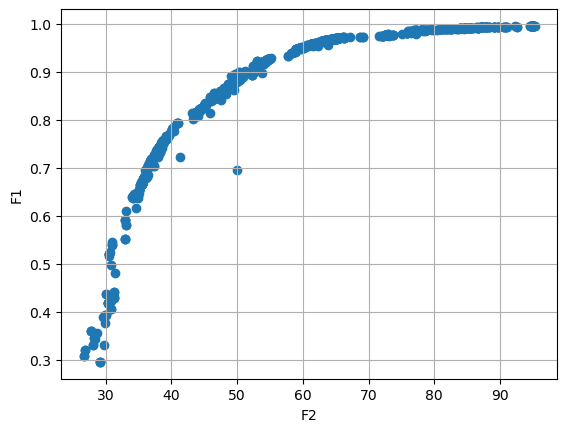

GENERATION :- 7
[[0.7772454800615852, 39.76282536810689], [0.711342593381861, 36.70145853878239], [0.9956359628973365, 95.05278928748614], [0.9498175415833355, 59.371875830393506], [0.9689900478791393, 64.87082813947195], [0.9730296352455132, 66.9459244154367], [0.9697992109838798, 65.17504332282188], [0.42206884752592516, 30.780978245298325], [0.8158174420840613, 43.726705951280216], [0.70885872594422, 36.77326103467861], [0.6431347398888131, 34.823498862912764], [0.9577996639194054, 61.21234262689072], [0.8466903192821017, 45.8287979212006], [0.8585505346413922, 46.5188278982931], [0.9693165982725289, 64.9928391505206], [0.7539997076993546, 38.610942810846154], [0.9873392803283597, 78.50072785843773], [0.7234391969278313, 37.04504670705771], [0.9515893318775107, 60.16031356222893], [0.9693165982725289, 64.9928391505206], [0.9739995278208817, 67.33295120508726], [0.9661829247642277, 63.71093402130946], [0.9586328371036147, 61.28580869799029], [0.7339640396244487, 37.60577878323054], [

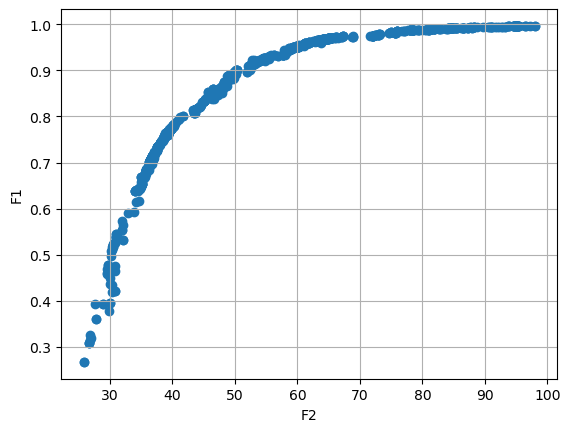

GENERATION :- 8
[[0.9690874414166942, 64.85727150319674], [0.7145237693156754, 36.819595498475294], [0.9718310561665534, 66.19099560359777], [0.7425764107827317, 38.06901079719136], [0.9909684612645153, 83.9790650376915], [0.92138184535195, 52.75203458224792], [0.9957116217200521, 95.32471130213438], [0.9901097639234836, 81.90012202198128], [0.712016677159107, 36.70635383410003], [0.6942093087276661, 36.1203674090794], [0.9889725482658855, 80.75243219257953], [0.9668171635375773, 63.908316183442125], [0.9691773776050722, 64.9051282049762], [0.9661787105544379, 63.570087640503594], [0.963239582372275, 62.92764293616189], [0.9240679214984426, 54.60711520858948], [0.9686555829301278, 64.5819436907661], [0.7494742682231663, 38.43992554664991], [0.7425764107827317, 38.06901079719136], [0.8543024231862534, 45.94718562626349], [0.6824664525783523, 35.775895216468115], [0.7530850910430253, 38.58673334395163], [0.7076087898060944, 36.50178486233129], [0.9666689284060512, 63.806777966560844], [0

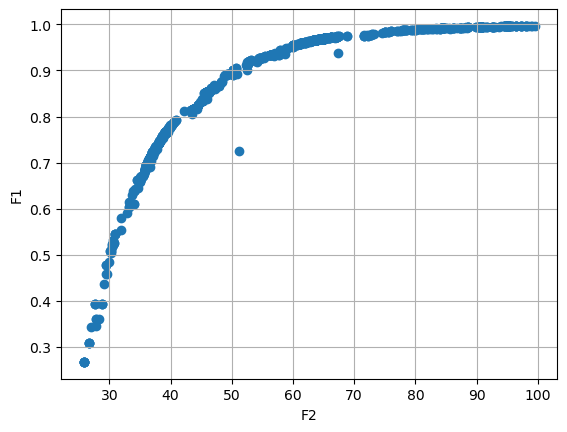

GENERATION :- 9
[[0.7425764107827317, 38.06901079719137], [0.9692345833324404, 64.87715506275504], [0.9011150733522963, 50.170547422655275], [0.9653443384954005, 63.24382693694921], [0.9663989120888121, 63.654820334915314], [0.8912704263868859, 49.145591055209685], [0.7442699660812068, 38.14764779184044], [0.9387044342005915, 57.04404875411456], [0.988326610716598, 79.29163901699428], [0.9723573212278507, 66.30035258884804], [0.986206479742862, 77.12822293558537], [0.9714758895077158, 65.87315466908152], [0.9661787105544379, 63.570087640503594], [0.9065000895183307, 50.861981963338444], [0.7234391969278313, 37.04504670705771], [0.9647283394486129, 63.09490025865486], [0.7425764107827317, 38.06901079719137], [0.7337198084616797, 37.428289923371494], [0.9904151035679374, 82.28307435938977], [0.867394147931853, 47.173018751102816], [0.7515473107393215, 38.51858048119429], [0.6657069612049547, 34.96687331281572], [0.7425764107827317, 38.06901079719137], [0.9913518456006106, 84.507004169167

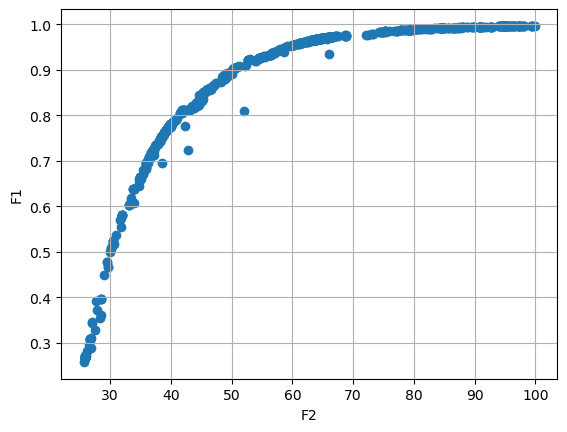

GENERATION :- 10
[[0.7425764107827317, 38.06901079719137], [0.9944512386963584, 91.55891013047687], [0.85316291849728, 45.69686445947499], [0.5083625151839439, 30.158508550323074], [0.9956271139528511, 94.7278687031443], [0.9679517319528709, 64.30096209147632], [0.7270730144714465, 37.253952827630194], [0.9598188005541304, 61.734719873256424], [0.9942521746000618, 90.79050511814515], [0.8588215934790381, 46.30062448763367], [0.6657069612049547, 34.96687331281572], [0.9679403041101914, 64.29504870703967], [0.9381587507469725, 57.62432684755595], [0.92138184535195, 52.75203458224792], [0.7022396032103466, 36.15233189626749], [0.9666689284060512, 63.806777966560844], [0.9928360482598112, 86.90022523971598], [0.9690425319972216, 64.76967362499059], [0.9847061774308236, 75.21283542663615], [0.9676544760729238, 64.14778670332966], [0.7639967686751586, 38.98594573310981], [0.9669450349416022, 63.837866967889035], [0.9846258661166918, 75.18592831405594], [0.8213260527524223, 43.18023456479825]

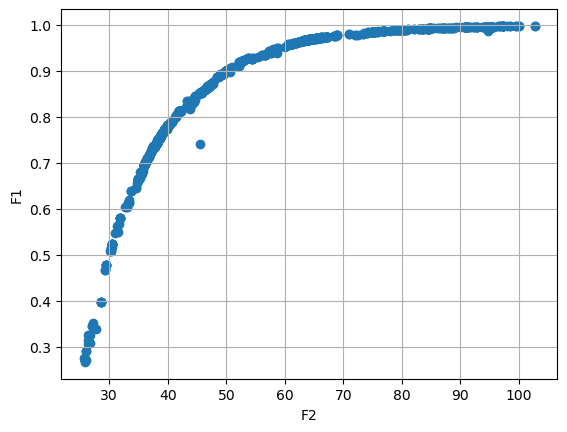

GENERATION :- 11
[[0.7538640721695669, 38.5883980865724], [0.8201206752716506, 42.49735818367139], [0.5676668361068606, 31.71653635892066], [0.8522950278487524, 45.4338074345722], [0.9954765403151026, 94.15453214759312], [0.9911377301136884, 83.44985907818587], [0.9815322350766773, 72.73863411581937], [0.9903162984535425, 81.78095711130958], [0.7868054660106972, 40.32818569341428], [0.7890901814308794, 40.606092497503084], [0.9682348941268817, 64.41336498507457], [0.6946185819966827, 35.976587361558735], [0.9729636849445582, 66.66946209476599], [0.9908569325238037, 82.87791437779616], [0.8522950278487524, 45.4338074345722], [0.9908306146288162, 82.73800381913878], [0.8324173854034485, 43.24067480598683], [0.9843925674906835, 74.97082687062523], [0.9968173837518919, 102.05509751022684], [0.9714758895077158, 65.87315466908152], [0.9691487988440206, 64.85987958307736], [0.9410957196011533, 57.44631510360884], [0.958461688319249, 61.18710665478808], [0.8281755926767495, 43.70174264987325],

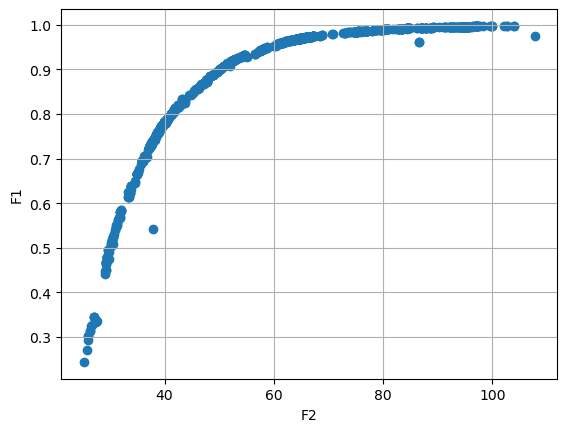

GENERATION :- 12
[[0.27129591535330194, 25.8257692736816], [0.9959456871661214, 96.128079518085], [0.958461688319249, 61.18710665478808], [0.9796033381444902, 70.66060342572986], [0.9928360482598112, 86.90022523971598], [0.995135774417555, 93.48453524945516], [0.9220296141704605, 52.87279949955429], [0.9065000895183307, 50.861981963338444], [0.7848726944121318, 40.15734176652265], [0.9958361749983484, 95.68135480870262], [0.8201206752716506, 42.49735818367139], [0.9846087409196768, 75.16849077312388], [0.7522016226709521, 38.42156085477449], [0.7951265026344259, 40.769703331604056], [0.9815322350766773, 72.73863411581937], [0.7441491321243973, 38.10692188001902], [0.7234391969278313, 37.04504670705771], [0.8100636133052179, 41.70789049904808], [0.7885152591841714, 40.55010328262841], [0.9702823152008546, 65.31266952467531], [0.9643952425073541, 62.92994388806491], [0.9464532350056214, 57.928696114026245], [0.9846258661166918, 75.18592831405594], [0.9690174127288644, 64.7414189340771], 

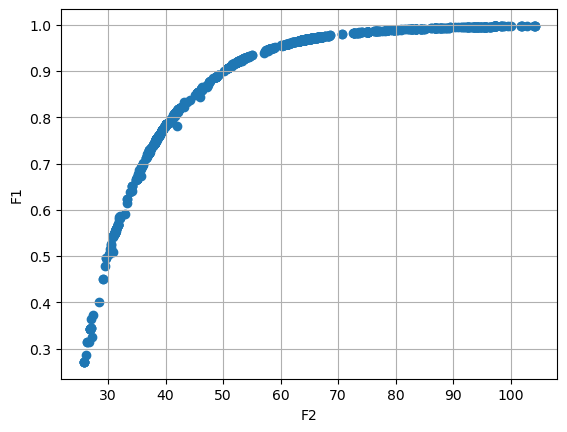

GENERATION :- 13
[[0.8795868229087498, 48.37036703800891], [0.9858680640154336, 76.54305042220327], [0.9858214778558145, 76.49858926313865], [0.7325939500369312, 37.45991031535465], [0.7803942054978102, 39.86910906219696], [0.694254161501575, 35.904738917534424], [0.9271681718887658, 53.714730076993355], [0.9681966058105075, 64.38024317995617], [0.34255801986985, 26.888636826574455], [0.9491175205434158, 58.47340130215077], [0.8631635924637607, 46.46695713114193], [0.9676100466148697, 64.18586388647927], [0.868423897990399, 46.6225818058342], [0.9861841349624796, 76.69925951433869], [0.9677097103843473, 64.18217064814128], [0.9202269954185074, 52.58313140590976], [0.9811324502740126, 72.35327760774835], [0.9296002653904936, 54.153977331152035], [0.9730355184554356, 66.70293552424691], [0.7951265026344259, 40.769703331604056], [0.9956242554722022, 94.54009584175738], [0.712297014067842, 36.59694809057946], [0.9226228837919613, 52.86112499516011], [0.9966180216046149, 99.50660546831625],

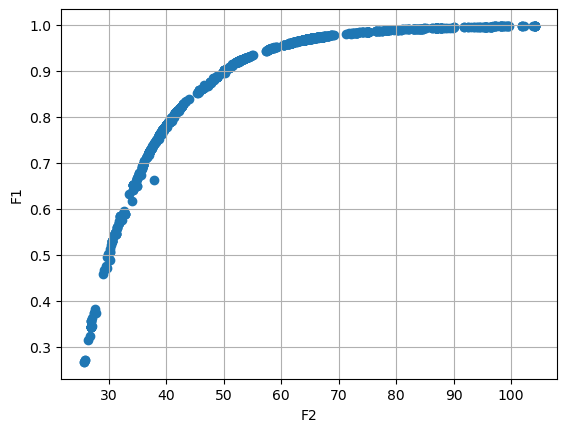

GENERATION :- 14
[[0.9187986097980608, 52.270217255364216], [0.9689781941519775, 64.72549535384127], [0.9971066582629933, 104.29539338554882], [0.5953046393623271, 32.64868041716096], [0.9201332140697309, 52.48025978431292], [0.5358250179801296, 30.74114001022301], [0.9686157498923065, 64.55994974907495], [0.7553801452171249, 38.570520918321954], [0.9702823152008546, 65.31266952467531], [0.9870447007172246, 77.47612162912667], [0.9309250333487614, 54.41448596136865], [0.8117553825108526, 41.87150723477326], [0.7913320116333767, 40.474415210324636], [0.9671054404730671, 63.953515613634416], [0.8522950278487524, 45.4338074345722], [0.9309763446044292, 54.30770180116941], [0.9190365068403092, 52.50901795552844], [0.7730465059221924, 39.44805254897961], [0.9748145846578719, 67.63718147159561], [0.9665219373102167, 63.70554619986409], [0.8155292581201244, 42.07787015124781], [0.9474713989230031, 58.481686634409186], [0.740638115151847, 37.787967367480654], [0.7951265026344259, 40.7697033316

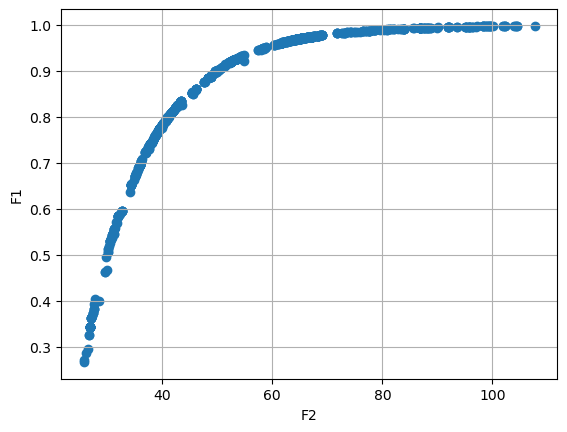

GENERATION :- 15
[[0.7646012392842626, 39.01834650856965], [0.6545897824575814, 34.37672805678492], [0.9254024085038377, 53.34128089335745], [0.9561801022826355, 60.22576882029641], [0.9618796959941007, 62.00014057932865], [0.6367773375316255, 34.14265336876525], [0.9933887216662843, 87.75955897265698], [0.9707726084629247, 65.53062779887188], [0.6534073334575299, 34.4216708558328], [0.9878394570919186, 78.4179159673624], [0.9758091970614551, 68.19106374946722], [0.5448071061453186, 31.009068085424026], [0.25563423125129925, 25.20338910973666], [0.9958361749983484, 95.68135480870262], [0.7898346296302855, 40.39946035327013], [0.898168994450772, 49.5171339258526], [0.9740806753636311, 67.17301053231408], [0.9702394304202818, 65.29276845329797], [0.9485911372917203, 58.1615539731966], [0.7299858943746991, 37.26418351929715], [0.9634900223720365, 62.65067246603492], [0.5953046393623271, 32.64868041716096], [0.6930669305180637, 35.80866562054789], [0.9225871655536202, 52.88314379002694], [

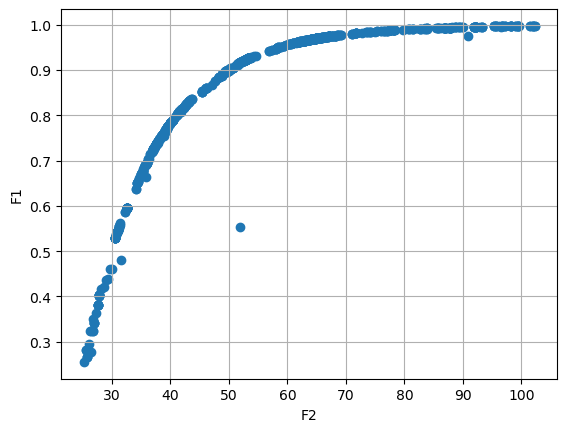

GENERATION :- 16
[[0.9210667121644371, 52.51333106910026], [0.966602835233116, 63.73384169379591], [0.9711712252308099, 65.71282024288712], [0.42341078722211783, 28.418357583284035], [0.9613045654815763, 61.80424861633915], [0.5641870498766745, 31.440169322179813], [0.9546709118498529, 59.799597442023384], [0.9946762544520762, 91.19915217703988], [0.9681966058105075, 64.38024317995617], [0.992466711410079, 85.67222003565018], [0.9929643268946866, 86.91671515596732], [0.9961853268519165, 97.14146834655806], [0.7904044548048405, 40.439235723453066], [0.9966180216046149, 99.50660546831625], [0.9737115289993696, 67.01609158092279], [0.7614595794822421, 38.81915685769639], [0.9833317779875043, 73.76306034287641], [0.5561184686490854, 31.220833639771413], [0.7299858943746991, 37.26418351929715], [0.9613045654815763, 61.80424861633915], [0.9596900217685599, 61.228787044142884], [0.9751247276986021, 67.81868537551115], [0.7591025487418551, 38.7026148509137], [0.9549016760601302, 59.90422987316

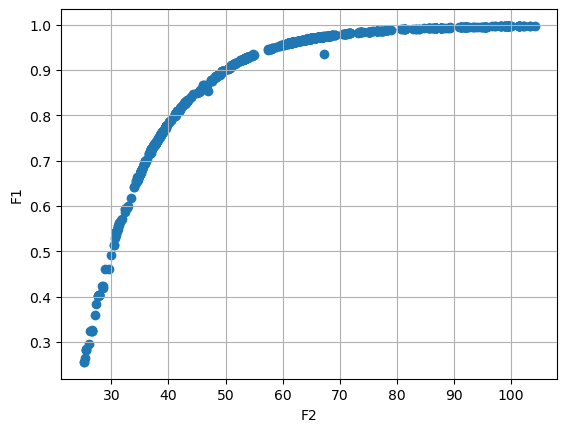

GENERATION :- 17
[[0.9666143590425165, 63.74027902199401], [0.6770935362711239, 35.192454307355945], [0.9896714993370583, 80.7936190649621], [0.9896714993370583, 80.7936190649621], [0.9694329873963127, 64.94527918480098], [0.96987929216745, 65.13449353277426], [0.8149489060323918, 41.99298983268112], [0.8295918911350515, 43.11324038166707], [0.9723089958791944, 66.32323396378655], [0.9866899605406951, 77.14446962388766], [0.7554547403031024, 38.483244254994666], [0.7994598242084733, 41.06829118077836], [0.7164841825257211, 36.69227522260631], [0.9683623921531658, 64.46014567614634], [0.9139015217557372, 51.52432627627795], [0.9756087783139514, 68.05736394469648], [0.6962466682545388, 36.03966444864736], [0.9901714185528082, 81.50413006960642], [0.9683565664113297, 64.43174279624036], [0.9831051091600195, 73.57726791268051], [0.6537335642784807, 34.33389831759052], [0.9784449408640589, 70.18890024828546], [0.9716142753911886, 65.95982033578741], [0.5312653583166038, 30.595855002590152],

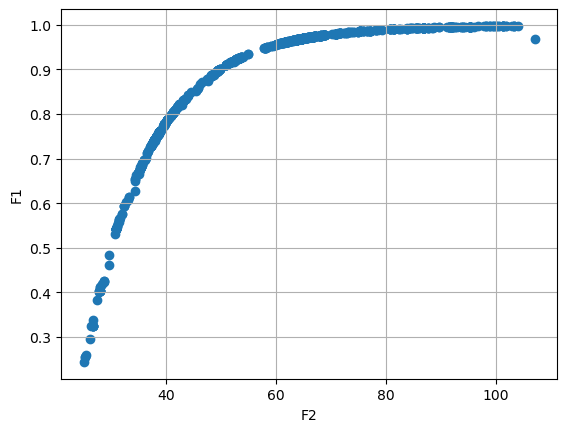

GENERATION :- 18
[[0.9769562680432738, 68.78219943476478], [0.9759513821114996, 68.22949467974826], [0.7591025487418551, 38.7026148509137], [0.7605170974707445, 38.76208727285097], [0.9730024533807173, 66.65933992184134], [0.8046482980676785, 41.31510134759339], [0.9563181718416714, 60.360640254138175], [0.9811292777456962, 71.6684340075007], [0.9866899605406951, 77.14446962388766], [0.8492516030116497, 44.50888691226059], [0.9741774445566103, 67.23573776045515], [0.8247186753784506, 42.684067905787245], [0.8965123840348136, 49.30664796020887], [0.9949277179622346, 92.05127721163679], [0.9126649375616598, 51.37035638843797], [0.7482720423529069, 38.16283336909495], [0.737487955991404, 37.613913830221875], [0.9681256747101927, 64.34757495497847], [0.9737389406913648, 67.02905641277549], [0.9690174127288644, 64.7414189340771], [0.8983267242568055, 49.50971856135117], [0.9726769511313923, 66.45776749036456], [0.9623221464257051, 62.09087957609738], [0.9935049756763673, 88.79251961832844],

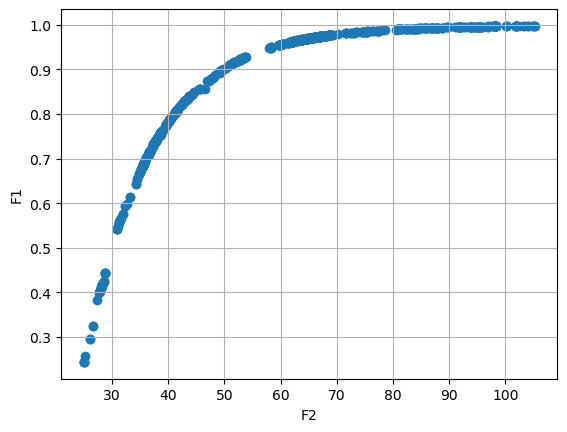

GENERATION :- 19
[[0.7953120397278827, 40.880072025240665], [0.9767133304167694, 68.65448192737512], [0.996540886341991, 100.98494679156971], [0.9707726084629247, 65.53062779887188], [0.9603948140447002, 61.52754016055119], [0.9970060420284091, 101.97291424257457], [0.991474051542523, 83.89176917968614], [0.7754990497316228, 39.60129004460093], [0.9656711530747191, 63.48640171933144], [0.832819986613562, 43.26378766536543], [0.9231918696773495, 52.86600592006692], [0.9915790955092765, 84.3356183632521], [0.9542819391127478, 59.75043919325953], [0.9740152643593235, 67.14032350838842], [0.4437369118472912, 28.71227686511976], [0.9721592084684506, 66.20582746907449], [0.975030627551065, 67.6977141533222], [0.9681966058105075, 64.38024317995617], [0.9161697421037159, 51.85029305382854], [0.8094025395355177, 41.63328559805649], [0.24008255239931658, 24.91273016415653], [0.9721353424888355, 66.19344582027375], [0.9670398875184864, 63.893431308773046], [0.8565479286438732, 45.640026745867935]

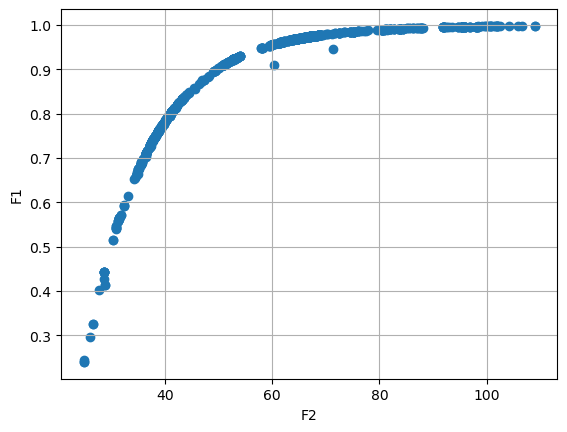

GENERATION :- 20
[[0.8314779179375578, 43.141604336121105], [0.9974508485604864, 104.09245550819732], [0.7264819008390581, 37.61698301197451], [0.7423434866672978, 37.865395600650025], [0.9533398000468392, 59.48697173780921], [0.9968802224226667, 100.56272517199194], [0.9707726084629247, 65.53062779887188], [0.8038908870127002, 41.233151715300615], [0.9949277179622346, 92.05127721163679], [0.9686958492536357, 64.59889382262608], [0.6982434450704511, 35.888181703458685], [0.5456566364625106, 31.012098228575944], [0.9767133304167694, 68.65448192737512], [0.9683623921531658, 64.46014567614634], [0.9840944313558341, 74.62483458131615], [0.8038908870127002, 41.233151715300615], [0.9673108611699232, 63.99671226319584], [0.9683623921531658, 64.46014567614634], [0.8122586569104748, 41.84864268441028], [0.7615496785125314, 38.8240880678698], [0.9682924038912325, 64.44923790358659], [0.9534895748493235, 59.530652596615525], [0.9915305670095897, 84.04300132710459], [0.9897735928801163, 80.6913471

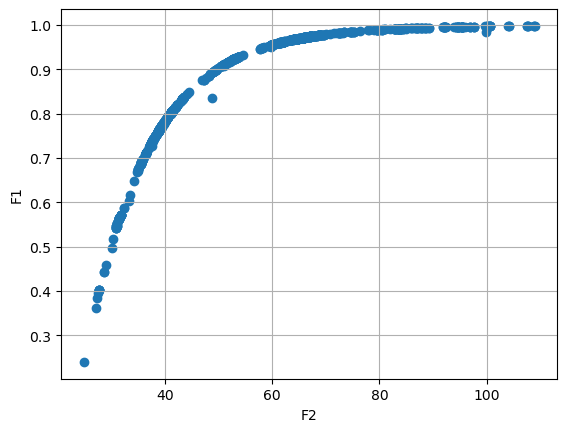

GENERATION :- 21
[[0.6856892994178142, 35.49245724104964], [0.9592652453962431, 61.07934309633766], [0.9192442395684417, 52.2250995057139], [0.9619196114391088, 61.966763900558455], [0.9754683758872444, 67.99001852505677], [0.9722336687550726, 66.25745991582036], [0.9711244688840042, 65.70640533759023], [0.954225700229608, 59.73315668524023], [0.9950077421725247, 92.2041886076567], [0.9590176757651778, 61.005691771804635], [0.7502837663490919, 38.27067537099774], [0.9767133304167694, 68.65448192737512], [0.7621553677704038, 38.838717442718675], [0.9692910402623803, 64.82899770731515], [0.9585483919379616, 60.848716398724264], [0.9102804496545222, 50.994644618772554], [0.9677284726468157, 64.17546141986864], [0.9169635852014084, 51.90583395775513], [0.9909777176393622, 82.95841201126431], [0.9693676033591552, 64.86535851119372], [0.5533167512605458, 31.163654257151915], [0.9268911194549677, 53.57515973756392], [0.9953462773663724, 93.63834933025838], [0.8153930012061275, 42.133266826065

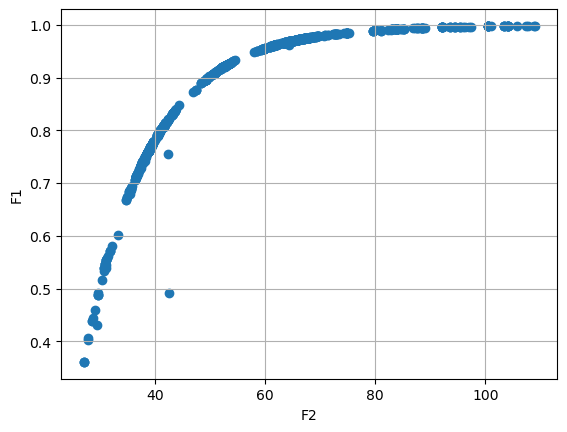

GENERATION :- 22
[[0.994991333195028, 92.13552848076529], [0.8450078136562976, 44.22194710383922], [0.8038989569251866, 41.23566413358668], [0.9778014793859333, 69.31488724419091], [0.9892399821719013, 79.9240244845387], [0.9268911194549677, 53.57515973756392], [0.6897385828402225, 35.525784078454], [0.7774539310505102, 39.66775169102071], [0.8196423095687773, 42.33354793031559], [0.9686591933006868, 64.55665190412554], [0.9913479867743674, 83.50653614994377], [0.9711244688840042, 65.70640533759023], [0.9751082956541638, 67.72045378554282], [0.923950675408978, 53.04794256894583], [0.9663787146866308, 63.65149102481631], [0.7116269147049988, 36.51008375909107], [0.9817844278131187, 72.39022162795685], [0.9782432695891876, 69.64299476710136], [0.9766709129520074, 68.63113886478455], [0.7589661040694827, 38.684984403446286], [0.9270149374315534, 53.57307473046855], [0.971619113294456, 65.93965149623756], [0.7774539310505102, 39.66775169102071], [0.712754038100696, 36.54838337767094], [0.9

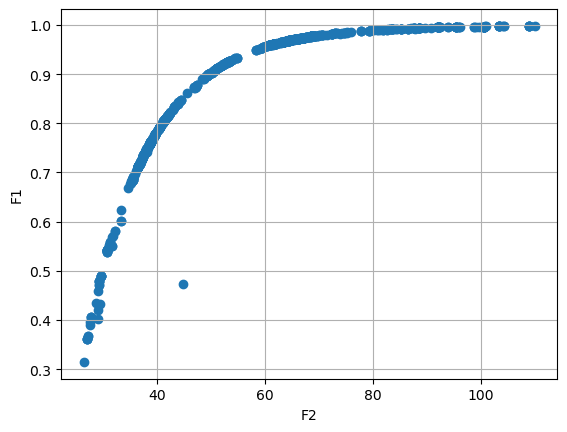

GENERATION :- 23
[[0.9617148167161585, 61.91315608684995], [0.7463393115667797, 38.03273442201443], [0.902329075870122, 49.855052822808304], [0.971512978598015, 65.87173351917042], [0.9684977833077822, 64.48475779739023], [0.9774487071547506, 69.09776690612205], [0.9968802224226667, 100.56272517199194], [0.8471063046067273, 44.41192648864187], [0.9959455683603453, 96.01439173332159], [0.749537239516032, 38.234526015006395], [0.7603617544484955, 38.74782689271794], [0.9969130545603127, 100.7740716707254], [0.797789739998737, 40.90750005600183], [0.9668479892423401, 63.88590843385094], [0.7211317446840766, 36.878088175944896], [0.9923452084173797, 85.23936918125469], [0.8097579356436871, 41.61538947002805], [0.9619196114391088, 61.966763900558455], [0.9699067504577811, 65.10718930816063], [0.7940425034486666, 40.6280953528275], [0.7561516547604956, 38.56663603992219], [0.9908511522571883, 82.81216994746728], [0.9931312626449992, 87.13435281038369], [0.9849863108708957, 75.21217866019609]

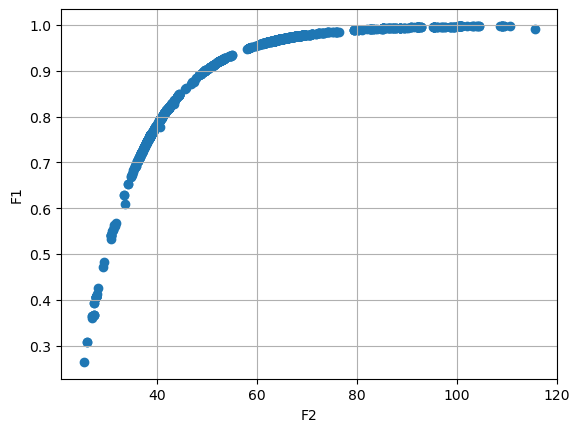

GENERATION :- 24
[[0.9693406141102162, 64.86734260917841], [0.36471378721988035, 27.003015440482947], [0.9687302308001365, 64.58219439115199], [0.971093775263364, 65.69341347225081], [0.9677799257569487, 64.23379953006945], [0.9763932667142102, 68.47408699162777], [0.9317627801273576, 54.49236038300889], [0.8041308505485479, 41.234089337731056], [0.9693663571090796, 64.8837126811228], [0.9924592335192584, 85.59367934076776], [0.921433555473881, 52.63026804742994], [0.8128797573860854, 41.8313495643594], [0.969681957493236, 64.99880111968005], [0.9968802224226667, 100.56272517199194], [0.9276397352184851, 53.759279275783], [0.9703756342919083, 65.33013245510436], [0.9687480919080729, 64.61356863104666], [0.8106145678140195, 41.67690665173661], [0.9775272890936245, 69.17327259659567], [0.8993902599530867, 49.53706924753688], [0.8423034379873351, 43.94375755544488], [0.9673108611699232, 63.99671226319584], [0.7281974292280894, 37.17280477832558], [0.902329075870122, 49.855052822808304], [

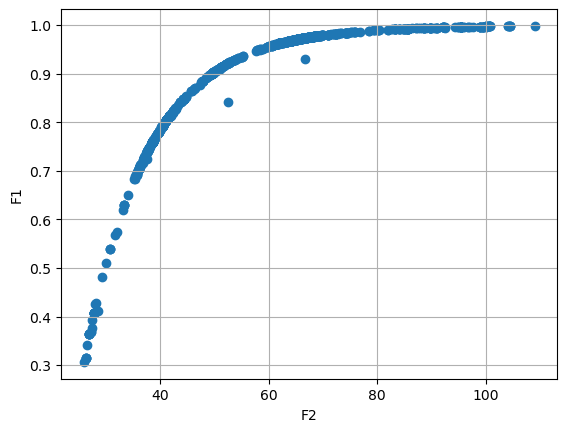

GENERATION :- 25
[[0.9931312626449992, 87.13435281038369], [0.9734013710917591, 66.79982616116074], [0.8251395469211429, 42.709816872420525], [0.9772095522901282, 68.97930683867779], [0.843270518436332, 44.18533232795667], [0.9958523588626945, 95.41910616685307], [0.981328006025495, 72.05259505644057], [0.9601635152817913, 61.377349279891476], [0.9963229470476762, 97.5379907617881], [0.8407690406986981, 43.77436473382412], [0.739324384572856, 37.699537727803346], [0.9619196114391088, 61.966763900558455], [0.9693812601512031, 64.88344087980724], [0.9546482131137877, 59.84650052080786], [0.9695921211728233, 64.98461832700559], [0.7495196391731097, 38.305893136551674], [0.9670817709068387, 63.90199562365359], [0.789137584453938, 40.324687113910066], [0.9624726138444353, 62.14770066868593], [0.7048951404408851, 36.185841959421275], [0.9661030265485943, 63.52371725720987], [0.8471626070114577, 44.417749691384635], [0.8025940066341906, 41.131465846353116], [0.975513582882791, 67.958786183314

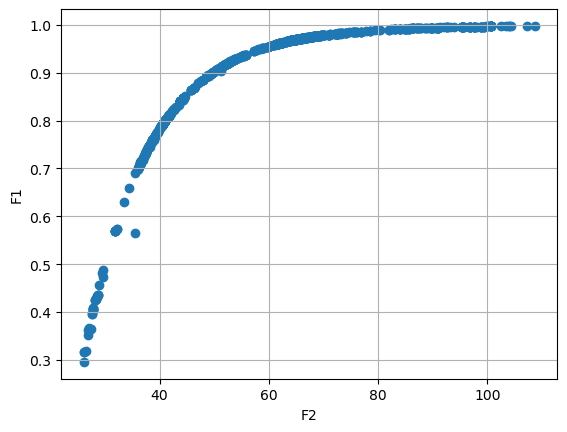

GENERATION :- 26
[[0.959931529659481, 61.379627903843065], [0.9677536523761687, 64.17425551260666], [0.9926142909623642, 86.01003660570302], [0.9948909163110419, 91.96096898106991], [0.9797704269239551, 70.89282212078689], [0.7944435275252927, 40.67503631354602], [0.9038252427585727, 50.0636447861896], [0.8386641784983363, 43.666147479179514], [0.7681671466605638, 39.14085141692034], [0.9818209588950133, 72.41519499745647], [0.42520739430698923, 28.147353313650438], [0.987955792714081, 78.45200319812781], [0.9695508931946175, 64.96429666916681], [0.7175354462364655, 36.8327101387496], [0.8196388036041082, 42.296469162920786], [0.9676171366864152, 64.10820911743073], [0.9685621222663081, 64.52075368161803], [0.9215217758365093, 52.592577082648546], [0.9712655969641021, 65.76799195392206], [0.9911439018360046, 83.0932839290262], [0.9656947453857773, 63.32962127581801], [0.9691444052636331, 64.76963945902283], [0.9675159988548707, 64.08892035223107], [0.9738392328665474, 67.11098775855704

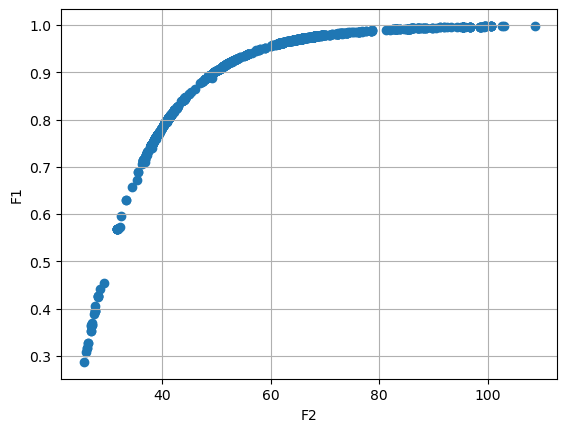

GENERATION :- 27
[[0.8422804602583356, 43.89621306180263], [0.9717342808368458, 65.98901347514064], [0.8125427496943278, 41.804004171513256], [0.9711781303898551, 65.73353121577388], [0.792892496602779, 40.57209278421162], [0.9687038574027416, 64.57531478613875], [0.8860334078139797, 48.03446726391159], [0.9711781303898551, 65.73353121577388], [0.7575610504767748, 38.6187927379996], [0.7462246279000542, 38.02695466643304], [0.8986774554858354, 49.419194472841966], [0.8863731289075614, 48.07210975115332], [0.9927193836189959, 86.03531216792896], [0.812243523632558, 41.77929145381431], [0.9758295834161896, 68.22184730947673], [0.28747701601567915, 25.619578508933937], [0.8937594743706471, 48.80186077383483], [0.7610730210429504, 38.794615965709504], [0.9147379347368619, 51.52362379905807], [0.9711781303898551, 65.73353121577388], [0.7886655879032585, 40.48257178785692], [0.9516597222985685, 59.021891021848674], [0.9675159988548707, 64.08892035223107], [0.9677536523761687, 64.174255512606

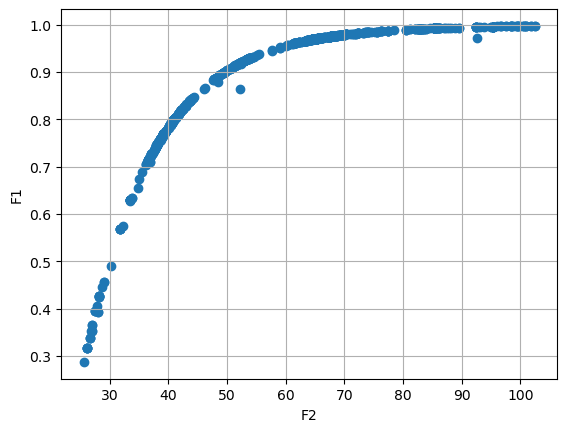

GENERATION :- 28
[[0.9956654114377105, 94.5646640135386], [0.9839194033167389, 74.13327822820118], [0.675563310812169, 35.14001459146909], [0.9670450832163857, 63.87372375393322], [0.978042057437871, 69.51813798319625], [0.898288201629534, 49.39206669262116], [0.898288201629534, 49.39206669262116], [0.9776120747546292, 69.21483996031827], [0.7951694655564117, 40.71071495120988], [0.7674070510357299, 39.09818744819325], [0.9596430955129119, 61.17129719924614], [0.7456284566558081, 38.0029638621949], [0.6093635456307314, 32.92829283874003], [0.776038758958945, 39.68148486330074], [0.8370590939502693, 43.49168842321002], [0.7463393115667797, 38.03273442201443], [0.7423434866672978, 37.865395600650025], [0.9965836507186961, 98.80259715824346], [0.9709673104804993, 65.60004780061199], [0.911441716541071, 51.07873084006229], [0.9927193836189959, 86.03531216792896], [0.8386641784983363, 43.666147479179514], [0.7710804286896306, 39.38723148509091], [0.8226534100500921, 42.519313047579786], [0.

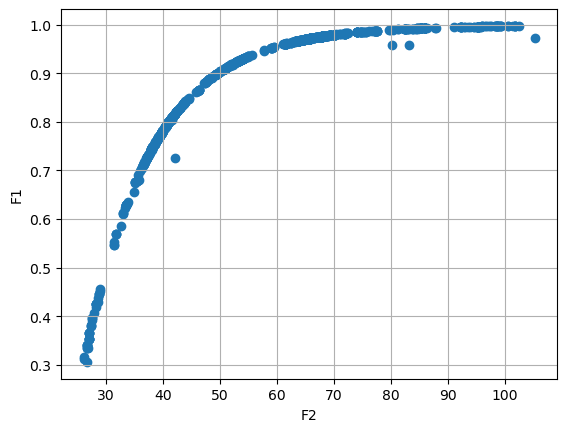

GENERATION :- 29
[[0.7387481238837135, 37.67823867017205], [0.9657488928721003, 63.37090555295249], [0.7508441348552591, 38.296967985757476], [0.9688734323128168, 64.64917396751986], [0.9669005930833509, 63.82278294779766], [0.9918276067885683, 84.25003403506362], [0.9286798667178279, 53.79290440471853], [0.8518140864481342, 44.70432984033281], [0.9860367806008378, 76.7825149181605], [0.9729536443384641, 66.69603555612596], [0.9777976137197134, 69.34153098240579], [0.9715786825261585, 65.88799121160818], [0.9805126127733315, 71.33541535110044], [0.880464886215332, 47.37179308898565], [0.773241674216696, 39.42375628544676], [0.6093635456307314, 32.92829283874003], [0.9711922493383482, 65.74073664655816], [0.968637988349791, 64.55100766817114], [0.9927027634116813, 85.9470282936742], [0.8046701449304632, 41.27950722245758], [0.9792205005431767, 70.25091595539458], [0.981715909196245, 72.37594884669511], [0.8232645540157241, 42.55250754234567], [0.9777685341949214, 69.32169121826776], [0.

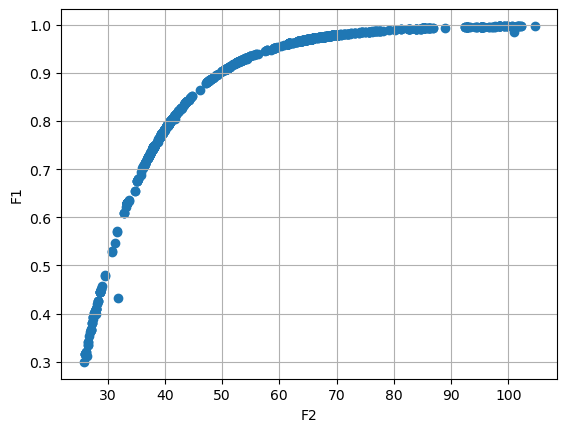

GENERATION :- 30
[[0.7277663509416965, 37.34107859521808], [0.7172432281034873, 36.69915117725039], [0.9687739675965004, 64.61103383031266], [0.9557786840851651, 60.23675108836308], [0.3625743942666672, 26.970378954769586], [0.9970442723700288, 101.69795177094407], [0.9771197416720254, 68.93375546844491], [0.9970121487535869, 101.47940615999472], [0.804873685756864, 41.30259120460764], [0.6611124938401404, 34.878706388139776], [0.9778529599505923, 69.36586601080724], [0.9706706320963177, 65.45454300057956], [0.38933987934180586, 27.44982296030816], [0.7938837167876841, 40.65211684661292], [0.7595715538443993, 38.7037379812034], [0.9286798667178279, 53.79290440471853], [0.8088193356149164, 41.552317891355266], [0.7456619950931226, 38.003187104193685], [0.9962567487475533, 97.31648531542085], [0.9082648135997925, 50.73275372886328], [0.9718782650598518, 66.05679025468376], [0.9767867866803045, 68.70177795951696], [0.7768950373716083, 39.69853226287746], [0.9061924272126877, 50.4634716485

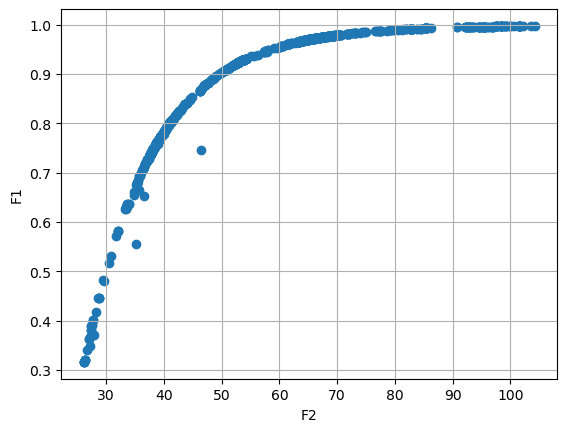

GENERATION :- 31
[[0.9210541791796943, 52.50862481765477], [0.8097190726387834, 41.61896819891014], [0.9693182799933417, 64.84392656651642], [0.9125475548595512, 51.273965272481014], [0.6316099496245857, 33.52246691172625], [0.9210541791796943, 52.50862481765477], [0.725421840826433, 37.14736156155658], [0.8654114339407615, 46.222707809233], [0.9670961841756052, 63.89465528268097], [0.9694612274640969, 65.04544210420809], [0.9671201648881504, 63.90467897772343], [0.7172432281034873, 36.69915117725039], [0.9970442723700288, 101.69795177094407], [0.9768398989450335, 68.75072825764875], [0.9724380259444441, 66.31625066658334], [0.804873685756864, 41.30259120460764], [0.7523311492724823, 38.33428700457525], [0.8903136805721161, 48.4177307543231], [0.4013081402910123, 27.668096131243217], [0.7744950945404139, 39.48214706374766], [0.882504179417849, 47.58331332650701], [0.9173459544694001, 51.95952790292972], [0.9104038048330473, 51.09992832856786], [0.987351622027985, 77.72034251881787], [0

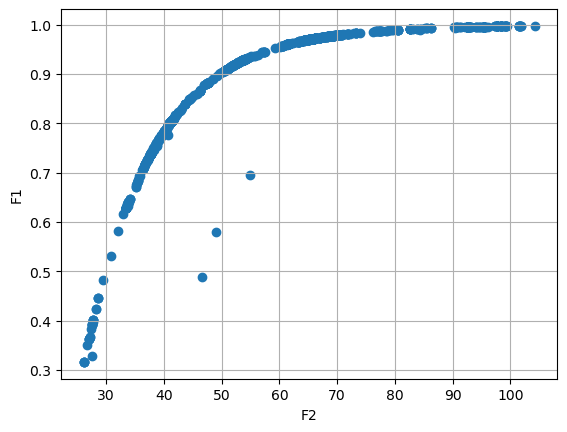

GENERATION :- 32
[[0.9956991353707703, 94.64648850257235], [0.9308056818820907, 54.1848969881755], [0.6292943960838004, 33.44299539572031], [0.9920197010602549, 84.65106739381953], [0.921149810317123, 52.52979296441236], [0.36719706125672646, 27.130667539146945], [0.9703756342919083, 65.33013245510436], [0.6408055172500764, 33.9455460150989], [0.8076272341324199, 41.47751505196796], [0.9208191886604556, 52.470580641026885], [0.9250597757323, 53.14055146318143], [0.9830777316124513, 73.25568179911821], [0.7409943632265289, 37.788917241086416], [0.9696767238854593, 65.00777180695104], [0.9682325152049915, 64.37488668168956], [0.9778308383125818, 69.34972318936144], [0.9308056818820907, 54.1848969881755], [0.9727896205362047, 66.51609842823046], [0.7442457228025665, 37.9354879801011], [0.9671139790426346, 63.90994077713245], [0.9712009542679082, 65.7416476539358], [0.9856742327862329, 76.20911266175244], [0.967615780643633, 64.12395743498213], [0.9694612274640969, 65.04544210420809], [0.9

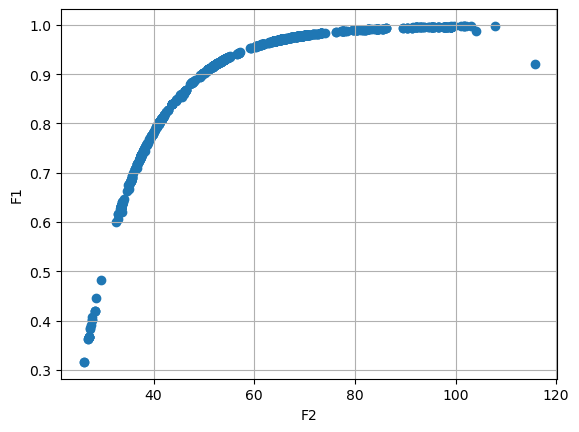

GENERATION :- 33
[[0.7351687882466569, 37.55353902157979], [0.970997656999282, 65.62332271087894], [0.9305650500936821, 54.14694350007146], [0.9791275105353179, 70.20482282448135], [0.9342808419441802, 54.865520916442414], [0.9872333405829216, 77.5971497469674], [0.9890134236987396, 79.73116521045519], [0.927414356990948, 53.55717365286742], [0.882504179417849, 47.58331332650701], [0.4894482138806114, 30.95584573691043], [0.9796684444583982, 70.57464988428053], [0.9958260001895333, 95.28907931860363], [0.9789254667355419, 70.06768519770405], [0.6912335858875452, 35.76482279752147], [0.9342808419441802, 54.865520916442414], [0.9741852848438944, 67.22817842616693], [0.9738268318085254, 67.04180165698004], [0.9572627112682355, 60.57204045465518], [0.9326309894859901, 54.52844890086966], [0.7889684847030038, 40.34295508674492], [0.9308056818820907, 54.1848969881755], [0.926017196566157, 53.31099937937527], [0.9685682435427685, 64.52160736250579], [0.9717337481083791, 65.97880070048413], [0

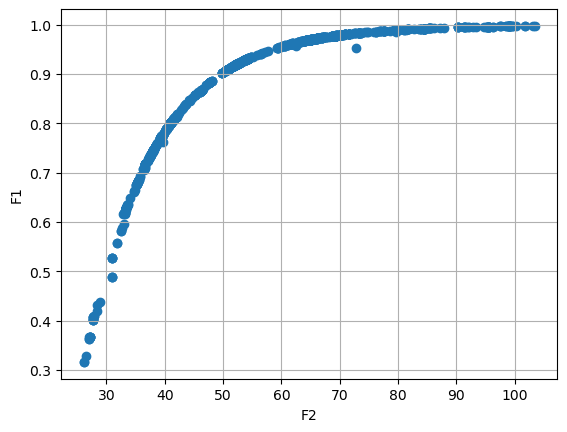

GENERATION :- 34
[[0.9668366679768046, 63.79004327713246], [0.9270952827835878, 53.49984256435377], [0.9795843053142351, 70.55756236773355], [0.6292943960838004, 33.44299539572031], [0.9667607596264964, 63.762088821437146], [0.5454667782478975, 31.269507988444634], [0.9104907453824215, 50.99038229525606], [0.9769903845094234, 68.84432590478838], [0.9714178239332297, 65.82034514967617], [0.9738268318085254, 67.04180165698004], [0.6292943960838004, 33.44299539572031], [0.9672085714862092, 63.94200319605887], [0.9719690879360834, 66.11521864761892], [0.9925435537239258, 85.62807269860221], [0.7935853962266941, 40.6288047975107], [0.9276827333089442, 53.61949569945128], [0.5454667782478975, 31.269507988444634], [0.6292943960838004, 33.44299539572031], [0.9619968954433125, 61.97652064687502], [0.9789276654921824, 70.1087906513163], [0.9715786825261585, 65.88799121160818], [0.4175870175850463, 28.328675415326646], [0.9744961251877792, 67.37442843426034], [0.7760337307110649, 39.5687495569898

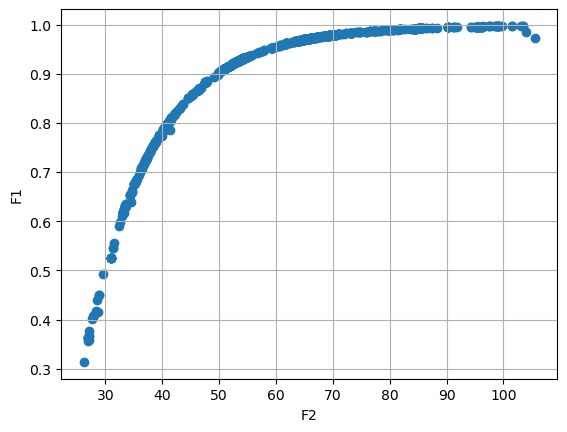

GENERATION :- 35
[[0.9741852848438944, 67.22817842616693], [0.9966284378201251, 99.09082076442274], [0.9797249880447458, 70.63547883373757], [0.9327951631809295, 54.58679681600516], [0.9946002348109607, 91.34957664558655], [0.9695279476509591, 64.95175927744268], [0.7934242646102834, 40.601989321837046], [0.7990190565393699, 40.91857490001115], [0.9240539463667228, 53.02018481747635], [0.35440960339283534, 27.079649415687374], [0.6740111084610401, 35.00447983910333], [0.9920164366375283, 84.61056729149522], [0.9917023707288741, 84.01545914549516], [0.9308056818820907, 54.1848969881755], [0.9704187292095805, 65.3333110837062], [0.9280487078849714, 53.67641063119414], [0.629777236023974, 33.47297490129767], [0.36336910292618285, 26.99927910084094], [0.9203347987433947, 52.374684468482904], [0.8578504860964795, 45.297446029945455], [0.9208822980338991, 52.46109227071961], [0.976111444109599, 68.29897852251844], [0.9832330296878731, 73.44289954948798], [0.9551509088717342, 59.8567431198001

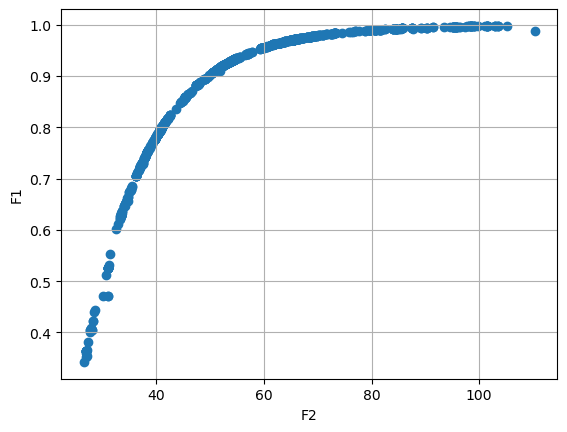

GENERATION :- 36
[[0.9651396670406331, 63.171108082266585], [0.8624613000398051, 45.60313775294138], [0.42241830135728575, 28.173107373483766], [0.9701929280528871, 65.23946230156453], [0.9182666474885722, 52.073629996323184], [0.9805311240208153, 71.1843214565146], [0.8836866340619549, 47.70846966558132], [0.9720948348263112, 66.13363540594273], [0.9137598080356875, 51.38349700899836], [0.9718998027195036, 66.05402679456911], [0.5267956406558412, 31.064585617241587], [0.9920168286921436, 84.64873676602699], [0.9183148588992137, 52.07124475473767], [0.8881150598455574, 48.64371120819961], [0.9858939400427853, 75.85378603590075], [0.9748283957140921, 67.5753025710479], [0.9536789446384057, 59.443848957512756], [0.9290444080072628, 53.86307649305037], [0.5123015364832328, 30.60275768786396], [0.9245827233338065, 53.08341436629064], [0.9273425930384201, 53.54381029756114], [0.9061695704666132, 50.409653348194475], [0.9230965374316348, 52.871657926425684], [0.6292943960838004, 33.442995395

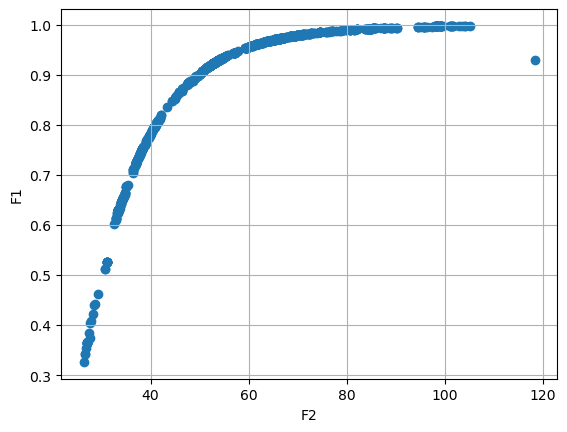

GENERATION :- 37
[[0.8102515245696129, 41.67489063266792], [0.9740896292273595, 67.17973663293489], [0.6292943960838004, 33.44299539572031], [0.9442630072407052, 57.25594342718442], [0.9972726453946272, 103.46021283928003], [0.979681994013385, 70.60147518972659], [0.7523311492724823, 38.33428700457525], [0.9567439290358423, 60.455628173025325], [0.7799395058366592, 39.827865037234176], [0.9536789446384057, 59.443848957512756], [0.6108256542814801, 32.82368334686747], [0.9341022937115971, 54.8416690612974], [0.968180393514827, 64.61630410344569], [0.6010825678604745, 32.52735610998701], [0.9647205788387662, 63.01798722888883], [0.6143169462121328, 32.92846554855199], [0.7988323600374557, 40.902745952905235], [0.9925435537239258, 85.62807269860221], [0.8058424677319443, 41.3747213283311], [0.9725052346153398, 66.34409836891813], [0.9883096238815565, 78.89877382909381], [0.9717038983173182, 65.95017126410818], [0.9354270879407218, 55.05211246639948], [0.9536789446384057, 59.44384895751275

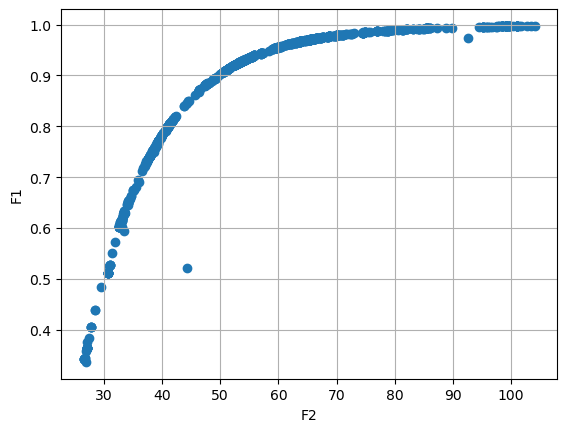

GENERATION :- 38
[[0.9225406340869171, 52.741429746847956], [0.997098877742811, 101.6399287760191], [0.818859890242165, 42.184300534326375], [0.9292206877496919, 53.8683440850475], [0.7899742015536442, 40.47342168599667], [0.9248540862868807, 53.13065527984205], [0.9208270478652353, 52.46933846090265], [0.9722251334716223, 66.19735842365588], [0.7399390706095484, 37.81048195049378], [0.7372183692941923, 37.6781450416522], [0.9126193449843812, 51.22853050023299], [0.9700904242181996, 65.1916785384822], [0.9742842787141945, 67.35570183454546], [0.9925435537239258, 85.62807269860221], [0.972022672663551, 66.09791614739171], [0.9791640699145512, 70.24078159696771], [0.9700904242181996, 65.1916785384822], [0.9763184749662646, 68.42670054633356], [0.9727714734541623, 66.51134971328467], [0.9839278253045645, 74.03036005310321], [0.799781889882743, 40.9529586593204], [0.9542212042008756, 59.557615078001035], [0.7538876211631904, 38.43522065199884], [0.9348545584782993, 55.00806249915502], [0.9

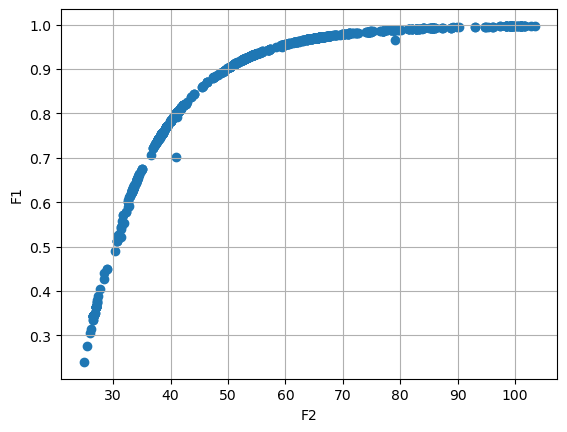

GENERATION :- 39
[[0.9244488012147859, 53.054617351505016], [0.9909257597992984, 82.66727216055203], [0.9938736552881007, 89.2562152366932], [0.8086150538306023, 41.51694942605193], [0.9866285918591667, 76.78973563567948], [0.3447370260411977, 26.73397470265766], [0.7702412473160881, 39.28010705422943], [0.9803406300623505, 71.03626914164202], [0.9665901966475327, 63.70122048763888], [0.9709438631577567, 65.57962404468046], [0.9335415038117446, 54.69465455983482], [0.9248540862868807, 53.13065527984205], [0.9973837739271941, 104.27149933788597], [0.9779572853039172, 69.45150038338636], [0.3457130063224602, 27.03588730613807], [0.9672457814225007, 63.95898633567058], [0.805130555556109, 41.29402456911048], [0.923543790431093, 52.90241011409702], [0.9748283957140921, 67.5753025710479], [0.31438302325509176, 26.14347153459905], [0.9232069645900981, 52.87082396544723], [0.9196261960069777, 52.313247319134604], [0.7724846800057312, 39.40327838754558], [0.9706902916645054, 65.45981100202373]

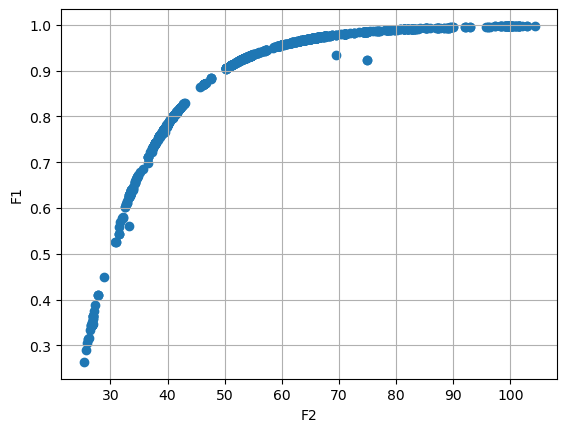

GENERATION :- 40
[[0.8142822915888559, 41.91010300229081], [0.923543790431093, 52.90241011409702], [0.9236489881643555, 52.92035646956754], [0.9680609421239968, 64.34003782128843], [0.9683048244134237, 64.44012603964056], [0.9932206018669653, 87.19087739717135], [0.9748283957140921, 67.5753025710479], [0.7563860805075134, 38.58927185633109], [0.9550815853373459, 59.81731609015591], [0.9768568380282917, 68.7378902295046], [0.8077986459091702, 41.46685725581369], [0.7915721061680953, 40.486159824641504], [0.8130463649956907, 41.79883491264185], [0.6108256542814801, 32.82368334686747], [0.9960211424092303, 96.10947930623755], [0.9907031988599727, 82.43955607664428], [0.8027262947708623, 41.132282156757654], [0.8706307701840503, 46.398957725052696], [0.9866285918591667, 76.78973563567948], [0.9841178395571967, 74.16714689412605], [0.9849658855410386, 74.95554829042514], [0.9225406340869171, 52.741429746847956], [0.9411424413494712, 56.390917936885884], [0.9645678887697586, 62.9335330619917

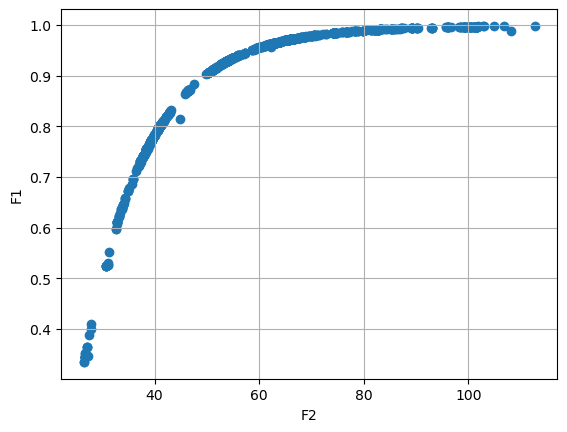

GENERATION :- 41
[[0.9248540862868807, 53.13065527984205], [0.9608209278359606, 61.55360755920345], [0.765919045963015, 39.05321458098357], [0.9950833311807762, 92.96697075937892], [0.9307975208512844, 54.17196077273581], [0.9645678887697586, 62.93353306199171], [0.9264428646743106, 53.42077178451643], [0.8758811750495012, 47.036440605148], [0.9970625392524031, 101.5732071720324], [0.9844432506136761, 74.50239516802618], [0.8758811750495012, 47.036440605148], [0.9260253372933512, 53.319217469811804], [0.9637193519548385, 62.74275954074098], [0.9709630038185538, 65.60422084557578], [0.5435288809114329, 31.297036323274828], [0.9949641902667433, 92.46600649451668], [0.9881127923210122, 78.44449667178881], [0.9109782293505931, 51.022494358109086], [0.9305938450610387, 54.11746487094028], [0.9748283957140921, 67.5753025710479], [0.9244488012147859, 53.054617351505016], [0.92477704278899, 53.1188952108224], [0.7310984739408964, 37.29826379533306], [0.9449468863879203, 57.27332006056318], [0.

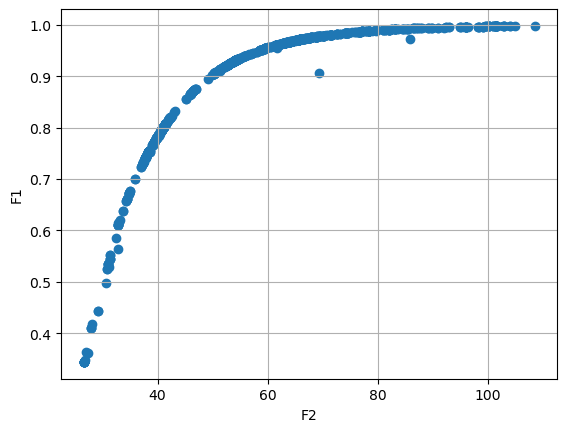

GENERATION :- 42
[[0.9685015714044641, 64.54012416604525], [0.9876030438447345, 77.87512014441145], [0.9298193087583255, 53.979544701075596], [0.9671102410689463, 63.89500218165874], [0.9705646755313415, 65.40181323461664], [0.8006577502020017, 41.013712383899325], [0.9770189785512877, 68.87947903283568], [0.9303354543723501, 54.071252725930556], [0.9768910790865156, 68.79908393469256], [0.8064349560878507, 41.40348846061177], [0.9749879008167924, 67.6656599726792], [0.727435891377653, 37.19415166036048], [0.8032952700743894, 41.16924819879736], [0.8015696271346976, 41.08823100440272], [0.9624425610086713, 62.20156137614909], [0.9608209278359606, 61.55360755920345], [0.9852968888117727, 75.31997510897097], [0.9957594513863096, 94.91505974302139], [0.9748283957140921, 67.5753025710479], [0.9304043584346539, 54.09493597625565], [0.7962643276479308, 40.739448171761964], [0.9402945570112154, 56.041738861956944], [0.966660844366349, 63.712628083666566], [0.7831109684572852, 40.0035278501778

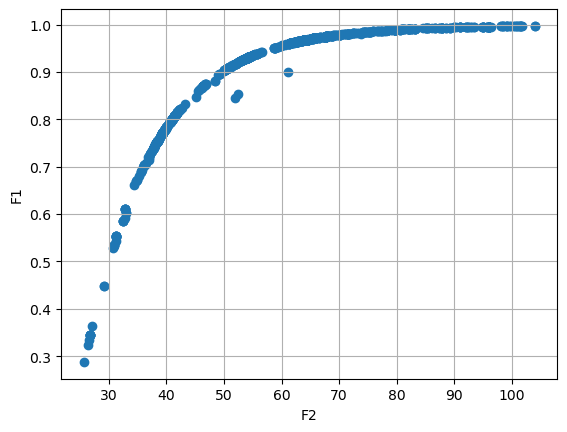

GENERATION :- 43
[[0.9950833311807762, 92.96697075937892], [0.9234694338340157, 52.89244668407468], [0.971471039754359, 65.84507526753411], [0.92477704278899, 53.1188952108224], [0.9671102410689463, 63.89500218165874], [0.9719669820742874, 66.11355524401655], [0.9670835043523278, 63.88389830905125], [0.9672793059408771, 63.994813976410754], [0.6959374009038956, 35.85292119508305], [0.9695709278720003, 65.04396383728431], [0.9743917203707607, 67.35768918642688], [0.9306952675080041, 54.139837226054695], [0.9898782933005821, 80.82885541356404], [0.9870493962100277, 77.20606879940736], [0.9811865163377903, 71.68043086161438], [0.7001267079461256, 35.93553090975691], [0.7849828002814575, 40.09437357879801], [0.679571853088091, 35.198712506289624], [0.957674774504823, 60.622064288118665], [0.930831496369483, 54.16294698915805], [0.9896586669378215, 80.54857441262104], [0.991268045449738, 83.17185902398855], [0.9709961438495245, 65.60514528417814], [0.9412170234117995, 56.261355142830745], [

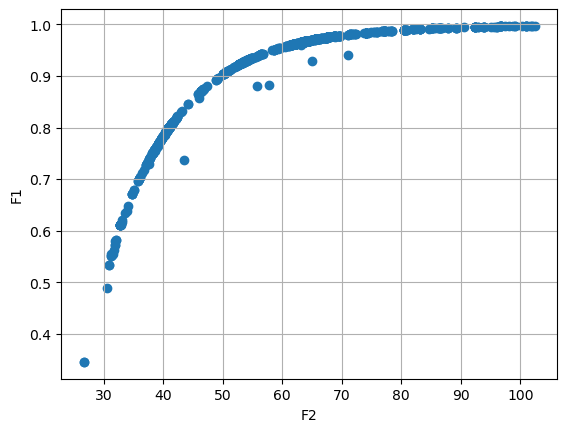

GENERATION :- 44
[[0.9898995778837129, 80.85895314093065], [0.9695113335945053, 64.94192918860628], [0.9598713984737879, 61.26624047543372], [0.9718782160502794, 66.05018555374528], [0.8945583862940671, 49.059546382855956], [0.9042609067167302, 50.13332670143796], [0.99288707844709, 86.57441388415798], [0.9743917203707607, 67.35768918642688], [0.7962643276479308, 40.739448171761964], [0.9608209278359606, 61.55360755920345], [0.8209853032898524, 42.391106211749204], [0.9728611992228406, 66.56372010566147], [0.9673944956623214, 64.0227496664584], [0.9714791814600061, 65.84824456362433], [0.9334273889285424, 54.67009740950617], [0.9629992338902205, 62.388286968240365], [0.971471039754359, 65.84507526753411], [0.9968664831145887, 100.26455123731351], [0.9719874398016152, 66.09247042388922], [0.993518039932392, 87.83723703398638], [0.9194851764214617, 52.265336461922416], [0.971472196958276, 65.84556666222319], [0.971471039754359, 65.84507526753411], [0.7962643276479308, 40.739448171761964]

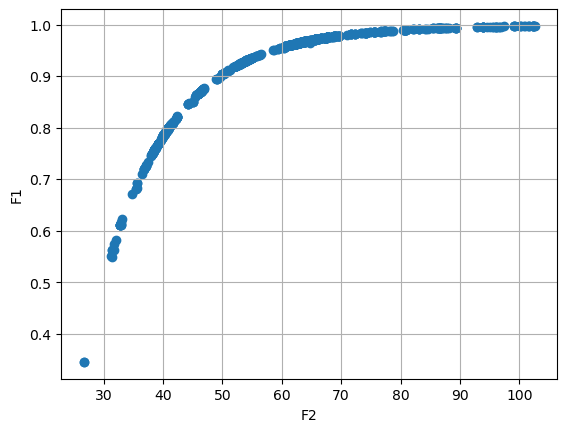

GENERATION :- 45
[[0.7929704670956789, 40.53992008378071], [0.9619744795256497, 61.992741823469096], [0.7962643276479308, 40.739448171761964], [0.8945583862940671, 49.059546382855956], [0.9903556815334263, 81.66068356279078], [0.9753108310601896, 67.83440820179638], [0.7479408742773309, 38.110652527283904], [0.9048089723003705, 50.20120511582235], [0.9894742721946191, 80.27487779579675], [0.983607374656162, 73.6715061100176], [0.9903556815334263, 81.66068356279078], [0.9684204090851184, 64.44696367816005], [0.9753108310601896, 67.83440820179638], [0.9744337324204331, 67.53295032011691], [0.8456894923039587, 44.1538496551076], [0.721285417971882, 37.193079872209736], [0.9753108310601896, 67.83440820179638], [0.9896958783058388, 80.56266619732754], [0.7962643276479308, 40.739448171761964], [0.9629992338902205, 62.388286968240365], [0.971706694593333, 65.95144289154645], [0.9843546912412656, 74.40433396027292], [0.9699175002436015, 65.11834349476356], [0.9629393762628131, 62.368839163305]

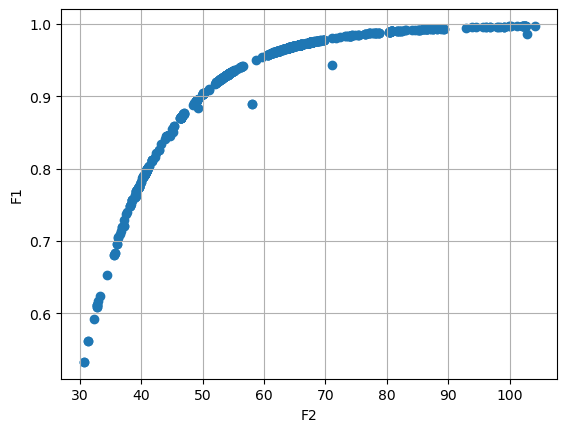

GENERATION :- 46
[[0.9673849196414623, 64.00905400091276], [0.9747096860199714, 67.51471123129741], [0.9510553434709315, 58.69886018531037], [0.9309684799493999, 54.1902117905769], [0.9744231890962013, 67.33985190874503], [0.8456894923039587, 44.1538496551076], [0.9934698096626073, 88.58836868503857], [0.9874688898595557, 77.60382175176143], [0.9861569375657382, 76.46400157770508], [0.8542133751915167, 44.95881320332976], [0.9598449504363717, 61.22434709352979], [0.974827138945451, 67.58533262791588], [0.799967466858653, 40.967865923240645], [0.9753017417822558, 67.82900737852174], [0.8126350908256991, 41.81416177261006], [0.9671102410689463, 63.89500218165874], [0.9671102410689463, 63.89500218165874], [0.9684204090851184, 64.44696367816005], [0.9614374669326323, 61.77253205677822], [0.9600199167635655, 61.28708519369753], [0.893758209375813, 48.96800225893979], [0.9752356986132302, 67.79062999236797], [0.9753108310601896, 67.83440820179638], [0.5615020702852938, 31.35690887198085], [0

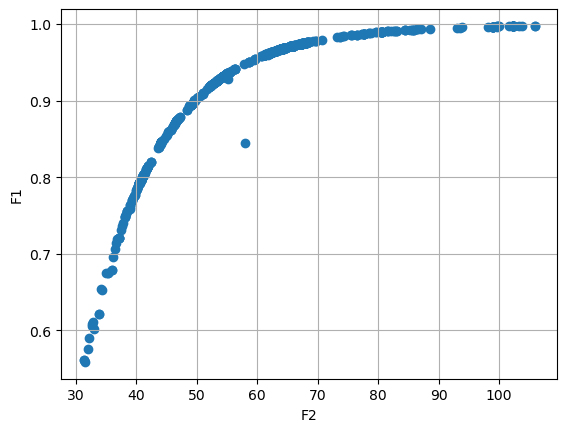

GENERATION :- 47
[[0.8387572759640579, 43.64887805314722], [0.6543096780652528, 34.25097531619391], [0.9037495198051176, 50.02837345499946], [0.7962643276479308, 40.739448171761964], [0.9648748451643531, 63.011336011848435], [0.7569400774232722, 38.605263126765195], [0.8041143226993341, 41.2314731751039], [0.9348878282064793, 54.93486221175469], [0.9972195940828058, 102.44553250930134], [0.6779890264858714, 35.62867495568497], [0.7962643276479308, 40.739448171761964], [0.9305803995379187, 54.12175529889272], [0.9131938150156877, 51.51589652069737], [0.9677295899426535, 64.16240822254352], [0.8996244960824902, 49.51910417579563], [0.9234322413333576, 52.88713734598541], [0.9678909679659607, 64.23317756898969], [0.9753108310601896, 67.83440820179638], [0.8617175359432776, 45.69805284039531], [0.9371586507320966, 55.4560641594186], [0.9534147474549908, 59.51209019201394], [0.9759569559965127, 68.19657009403119], [0.9700131478891717, 65.17979527115402], [0.9689910328797653, 64.708163330248

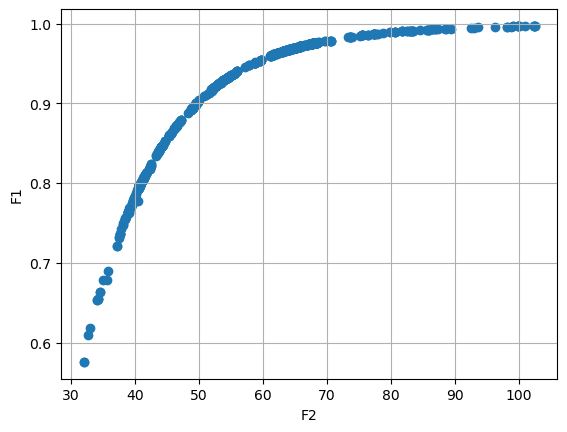

GENERATION :- 48
[[0.9129017059894428, 51.46143431162351], [0.9201218550364102, 52.35626681661511], [0.9709587666773597, 65.59277167883083], [0.7962643276479308, 40.739448171761964], [0.9753108310601896, 67.83440820179638], [0.8460698414194038, 44.18420010610643], [0.8198222697519372, 42.40785018289247], [0.9025640986441789, 49.854715461075], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.9753108310601896, 67.83440820179638], [0.9753108310601896, 67.83440820179638], [0.8387572759640579, 43.64887805314722], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.9753108310601896, 67.83440820179638], [0.9965923554125286, 99.03944083119187], [0.7962643276479308, 40.739448171761964], [0.9740217910360875, 67.13685441328923], [0.7962643276479308, 40.739448171761964], [0.7527444139247945, 38.378924083960584], [0.7962643276479308, 40.739448171761964], [0.9781432985506445, 69.8913111

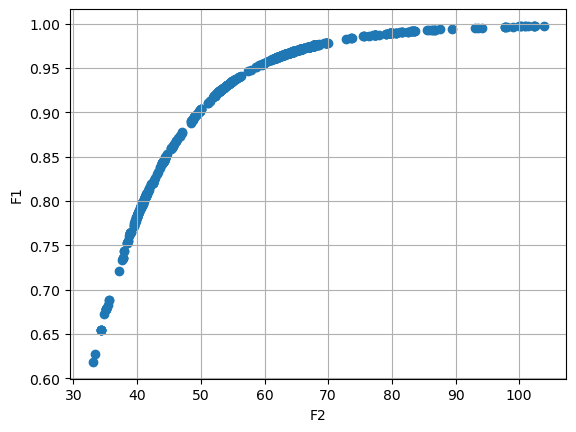

GENERATION :- 49
[[0.9683657822741367, 64.42371354542017], [0.7934684804644023, 40.57094467230135], [0.9701092732248443, 65.21973913552664], [0.8731380794388102, 46.64995166329188], [0.9251832355235337, 53.18937520301156], [0.9752356986132302, 67.79062999236797], [0.9742689244065467, 67.3030773588641], [0.9671762905344555, 63.92377134865144], [0.9753108310601896, 67.83440820179638], [0.9541118735689492, 59.68984345651195], [0.9941408245951079, 91.52025299786166], [0.8457521475300187, 44.158813533200146], [0.7962643276479308, 40.739448171761964], [0.7986181953352984, 40.88345806284665], [0.6232529237953648, 33.22809932138472], [0.9677402099487679, 64.16324863852486], [0.8458439482648954, 44.17354108244645], [0.9750695581016131, 67.69312198345686], [0.9709587666773597, 65.59277167883083], [0.7962643276479308, 40.739448171761964], [0.9032352385020904, 49.957328530504434], [0.8120451957517977, 41.8130502281822], [0.9753108310601896, 67.83440820179638], [0.7962643276479308, 40.7394481717619

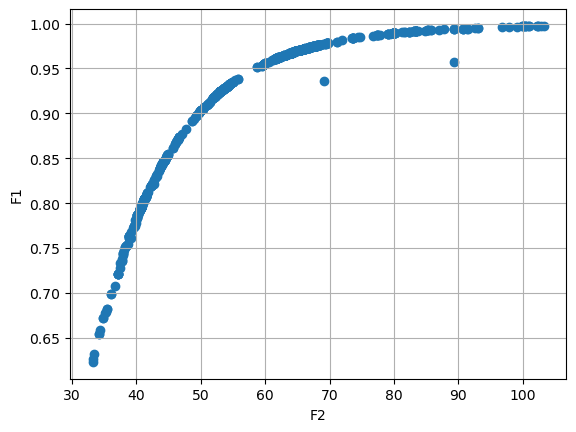

GENERATION :- 50
[[0.9850915525956532, 75.56558691607064], [0.9540802143617102, 59.676754901591295], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.9753108310601896, 67.83440820179638], [0.9050537741095864, 50.272697537030666], [0.9923097147610229, 85.28043525901], [0.9018275785248453, 49.78476568065669], [0.7931159038284319, 40.55131319076622], [0.7962643276479308, 40.739448171761964], [0.7475128916057361, 38.14221637331314], [0.8421098339644114, 43.88948594226726], [0.8253312204545963, 42.727036151162274], [0.9894753890387656, 80.32239219100238], [0.7961949527066159, 40.736048968974984], [0.7962643276479308, 40.739448171761964], [0.9915947119119315, 83.74811524563377], [0.9714015447104727, 65.80679227031956], [0.7992764100735862, 40.91453348758894], [0.9253727744728292, 53.208217750754585], [0.7962643276479308, 40.739448171761964], [0.7925141814925393, 40.525063073235316], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448

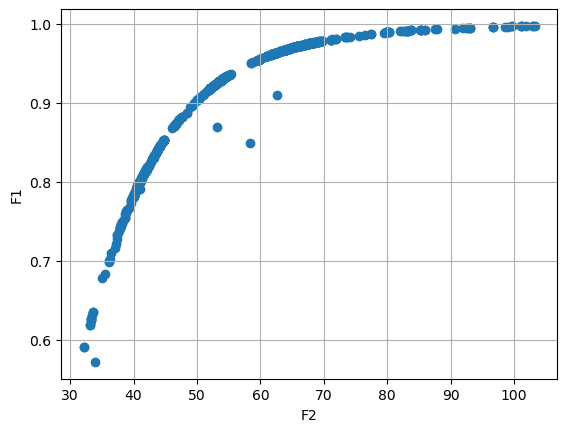

GENERATION :- 51
[[0.7962643276479308, 40.739448171761964], [0.9907252849539668, 84.18430863449305], [0.9894447181974582, 80.27732282177973], [0.7962643276479308, 40.739448171761964], [0.7971665134425303, 40.79530008855459], [0.786658760095733, 40.16993790967984], [0.9753108310601896, 67.83440820179638], [0.9642688219881294, 62.7937602117967], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7972525156742377, 40.80170547072521], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.9755917859419474, 67.99872395452446], [0.9301508268193256, 54.053460966092004], [0.7962643276479308, 40.739448171761964], [0.9701980491193094, 65.26

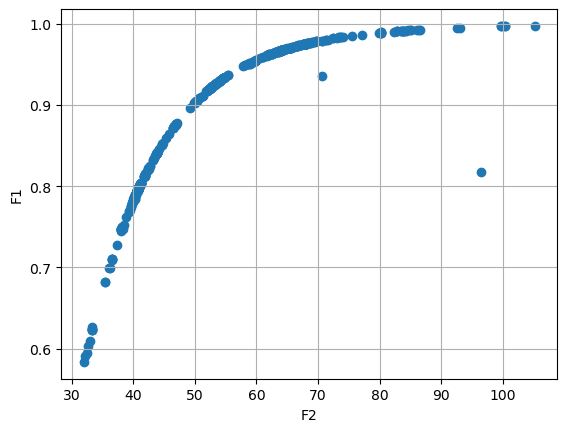

GENERATION :- 52
[[0.7962643276479308, 40.739448171761964], [0.8031838721343681, 41.161870406593685], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.9810451055987248, 72.03377755894088], [0.7962643276479308, 40.739448171761964], [0.7957483747835926, 40.70609669189544], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479306, 40.73944817176196], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479306, 40.739448171761964], [0.9331928216783283, 54.60363474831803], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.7962643276479308, 40.739448171761964], [0.9652631946626798,

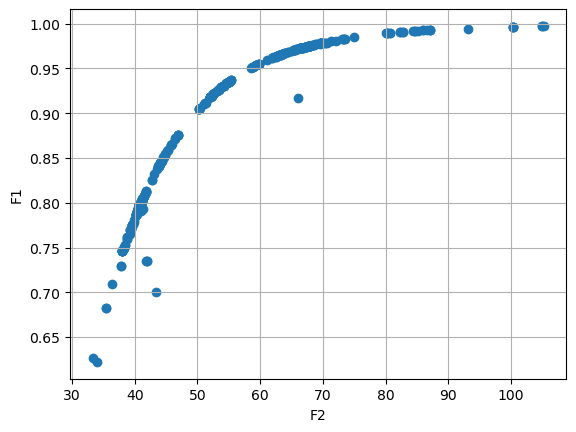

GENERATION :- 53
[[0.9534485644278381, 59.41785551908879], [0.9673458863673877, 63.99130931005794], [0.850734181697543, 44.586363415204346], [0.9354286156710396, 55.059251937528224], [0.9811890023964952, 71.99894397221291], [0.7527320481334878, 38.47899762733772], [0.7942577419446856, 40.61238053007617], [0.7962643276479308, 40.739448171761964], [0.7950871782040605, 40.66562460245176], [0.6887672725753434, 35.608818546685164], [0.7962643276479308, 40.739448171761964], [0.7655020036280671, 39.207259023594965], [0.8144797170807871, 41.91329012717404], [0.9753108310601896, 67.83440820179638], [0.6222652482875909, 34.02880378913445], [0.8430544239792522, 43.97782939721281], [0.7962643276479308, 40.739448171761964], [0.9791101428146944, 70.26957970906997], [0.7962643276479308, 40.739448171761964], [0.9086225832534502, 50.87512825253109], [0.850499011417654, 44.61449662724398], [0.796352584949906, 40.744946155748515], [0.7096659572123933, 36.42831368600486], [0.9737224255739062, 67.115816629

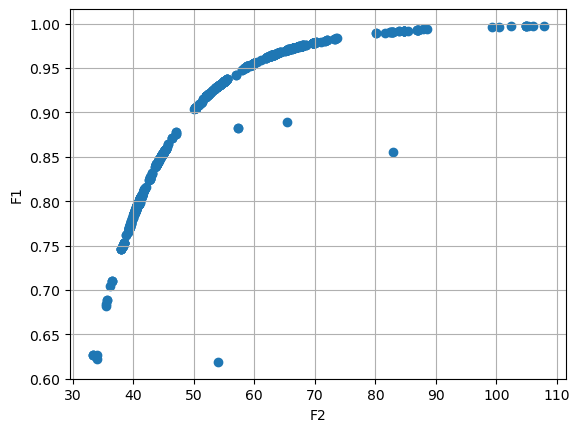

GENERATION :- 54
[[0.9019976522032009, 49.95858115819901], [0.9290269051132964, 53.834951017665134], [0.9749734837045051, 67.6702783770247], [0.7868963087512272, 40.200139289110965], [0.7861129725385979, 40.14013798634116], [0.7962427130338027, 40.738043098118446], [0.8006339704449233, 41.004465844237615], [0.7834700947571375, 39.996881032423005], [0.9673040466450904, 64.12190274686594], [0.9899732801884337, 81.61761266097938], [0.7767375290146717, 39.67171985967888], [0.7963327939020058, 40.74373166539813], [0.9121604932995615, 51.20843005981588], [0.7126890995172778, 36.540229388704184], [0.9730377476229067, 66.69821390179276], [0.9559905423004588, 60.267674842071976], [0.9905947980015972, 82.49122407773066], [0.9730377476229067, 66.69821390179276], [0.9182269846700345, 52.0714873192006], [0.9922972384286749, 85.44069543532514], [0.9754201526663971, 67.8992618167318], [0.9753225844647622, 67.8416711152694], [0.7957362606590904, 40.70509531700286], [0.7946730174193607, 40.636357585919

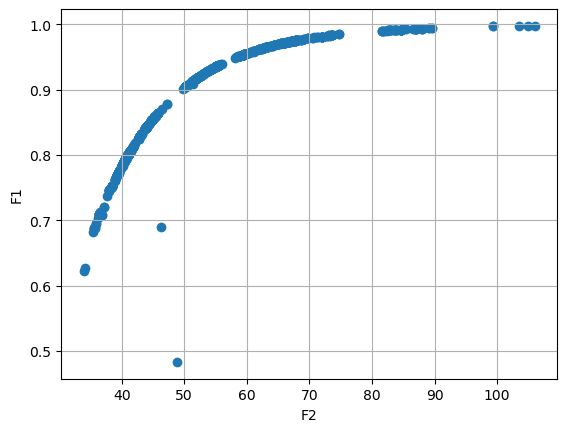

GENERATION :- 55
[[0.930980267204777, 54.19734100032404], [0.9137762536191534, 51.37553819617115], [0.7924839508709601, 40.51821970930549], [0.9373098327941941, 55.465767885151486], [0.7962427130338027, 40.738043098118446], [0.7940821747532479, 40.60784425239673], [0.9753652617074258, 67.86661708047009], [0.9651600117524948, 63.155900282018386], [0.7901188993613777, 40.38437634892237], [0.9193652155381418, 52.2411127442103], [0.9909131737233455, 82.76728273688411], [0.9698656465616208, 65.10000345930544], [0.963181511737012, 62.39871722649608], [0.9049619685877722, 50.26651571729729], [0.9314720450380046, 54.30562981715447], [0.801408949991306, 41.05671314977637], [0.9049634724160361, 50.23123537362159], [0.8382495134721191, 43.58343775037853], [0.7936152145175743, 40.57562414611267], [0.8004723132466454, 40.994527829091055], [0.9652631946626798, 63.16470068119801], [0.935707184674924, 55.131629778474824], [0.955240014287681, 59.87014014798708], [0.9246161335021256, 53.09639186690742],

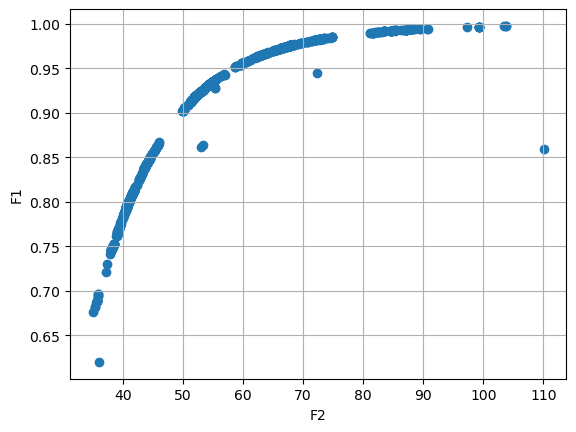

GENERATION :- 56
[[0.8045157476377522, 41.26329244623307], [0.991824894661323, 84.13929503032142], [0.9045526165679089, 50.14698587131733], [0.8540409872200372, 44.86050860108409], [0.843411069724984, 44.04806241595071], [0.9182269846700345, 52.0714873192006], [0.9316719914795355, 54.32496555129177], [0.9290269051132964, 53.834951017665134], [0.8402002797450152, 43.737637611455355], [0.9732363784851225, 66.77488172619846], [0.7954865174773846, 40.68205514367105], [0.7646678306615003, 39.012933062230125], [0.7698930117801144, 39.313581245358975], [0.9966634940866788, 99.33999243420226], [0.8068647916593406, 41.40725954807326], [0.9716226546766138, 65.92529257426352], [0.9238655992005579, 52.964784641256], [0.935707184674924, 55.131629778474824], [0.9399395865900928, 55.97599093577121], [0.8007007337361838, 41.00836866836651], [0.9923336772315823, 85.2710272536563], [0.7847983720299903, 40.06093589361727], [0.9816674648820997, 72.10804487137611], [0.9285399682722002, 53.74472033686459], 

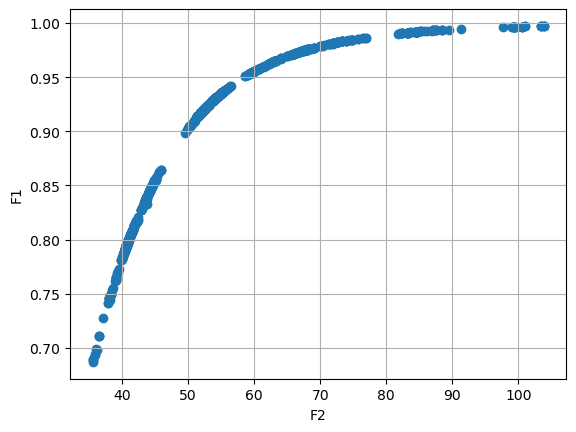

GENERATION :- 57
[[0.7936152145175743, 40.57562414611267], [0.7942036866828364, 40.60932561131032], [0.974914749558017, 67.606515771391], [0.9231551950147124, 52.827835321261716], [0.9960303870164277, 96.44720795962574], [0.9190254918736057, 52.18767289153955], [0.7412653748231732, 37.816939103502065], [0.9179368425183929, 52.014672627248245], [0.8518198868370144, 44.68799828160193], [0.958298301862758, 60.80327839560476], [0.9754201526663971, 67.8992618167318], [0.9384204554247564, 55.68244628894558], [0.8167973940318893, 42.046899098130545], [0.9719307183318691, 66.17777195726217], [0.7944280614446638, 40.624038730547944], [0.9772228703653444, 68.97244213901988], [0.9731830206197561, 66.70938245110457], [0.7726476819375588, 39.45010885821387], [0.7412653748231732, 37.816939103502065], [0.9139199486994681, 51.396602081636004], [0.782462690186083, 39.97423890374769], [0.9125913299194606, 51.22596557621758], [0.9250846933814256, 53.172207875991454], [0.9130299284430716, 51.2633965161511

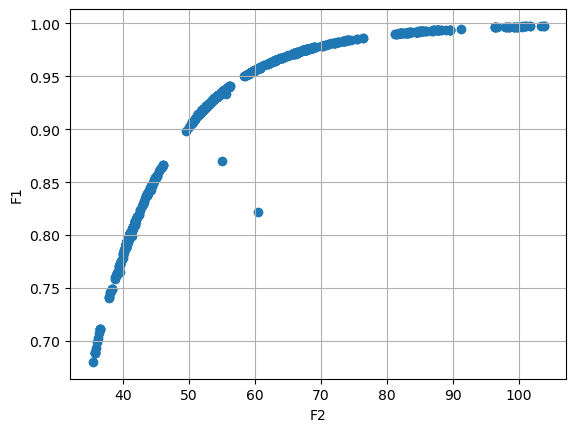

GENERATION :- 58
[[0.9678349746742673, 64.23955657929717], [0.8276919014604965, 42.823855108757535], [0.9368793558417422, 55.34990992004802], [0.7646678306615003, 39.012933062230125], [0.9723450979445942, 66.44353658712444], [0.8185430107723903, 42.234391742423504], [0.7963327939020058, 40.74373166539813], [0.7930779515029974, 40.54848069257552], [0.7936152145175743, 40.57562414611267], [0.9973258746201784, 103.27606731792049], [0.7936152145175743, 40.57562414611267], [0.932308635670063, 54.48048984041834], [0.9652631946626798, 63.16470068119801], [0.9507046950111924, 58.59193128126862], [0.9282220289707858, 53.689986300032544], [0.9409354528750359, 56.236247900898945], [0.7646678306615003, 39.012933062230125], [0.9731830206197561, 66.70938245110457], [0.9134956838313358, 51.33247690853202], [0.9652631946626798, 63.16470068119801], [0.9965912098650016, 98.91542415878034], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.8349510

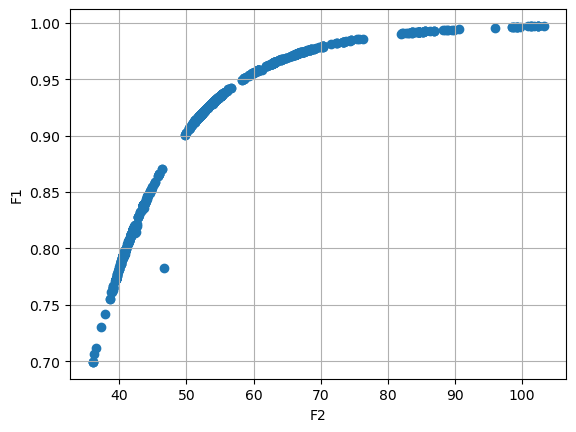

GENERATION :- 59
[[0.7936152145175743, 40.57562414611267], [0.8449007745946119, 44.107561798377255], [0.9515016068183811, 58.79409922350018], [0.934411447219765, 54.845203094105635], [0.8329455616669675, 43.20521668338512], [0.7936902531537617, 40.575797471553734], [0.7942935532137272, 40.61737870660524], [0.9342475839784589, 54.81028271865483], [0.913895252817259, 51.4099751320304], [0.8382495134721191, 43.58343775037853], [0.9692455699316642, 64.83695935127697], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.7729030905462255, 39.46163165426198], [0.7936152145175743, 40.57562414611267], [0.7936152145175743, 40.57562414611267], [0.7936152145175743, 40.57562414611267], [0.7936152145175743, 40.57562414611267], [0.9652631946626798, 63.16470068119801], [0.9134956838313358, 51.33247690853202], [0.8588593773177476, 45.29120199568973], [0.9199903626207215, 52.35067643733415], [0.7936152145175743, 40.57562414611267], [0.9387483641035009, 55.7651942555119

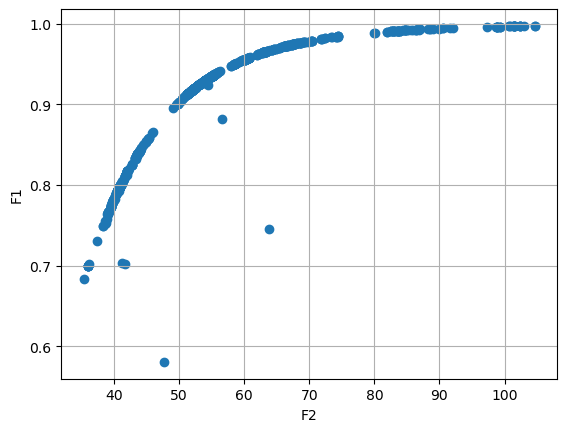

GENERATION :- 60
[[0.9289645689402526, 53.8337068747568], [0.9812087786558689, 71.76378396965751], [0.9196501333453561, 52.27422787064356], [0.9281883374985428, 53.683998253466385], [0.9913833566741972, 83.42017921550726], [0.7901995361595218, 40.441171289051695], [0.8458245843948561, 44.18418481761122], [0.8547788725235902, 44.907559779654534], [0.9930443633097344, 86.77509462224029], [0.9178957829218627, 52.008857403498844], [0.8000035325599231, 40.96781702286608], [0.9290269051132964, 53.834951017665134], [0.7959542436436117, 40.70999922571703], [0.9290269051132964, 53.834951017665134], [0.8253873529450445, 42.73217906685383], [0.7936152145175743, 40.57562414611267], [0.7936152145175743, 40.57562414611267], [0.9579763531249718, 60.699364651853415], [0.9312230508111159, 54.25310637405636], [0.8189551392273083, 42.267433136460674], [0.9970857027986454, 101.50204544947964], [0.8081743057225929, 41.58622632469112], [0.992736830988376, 86.36335489406741], [0.7936152145175743, 40.57562414

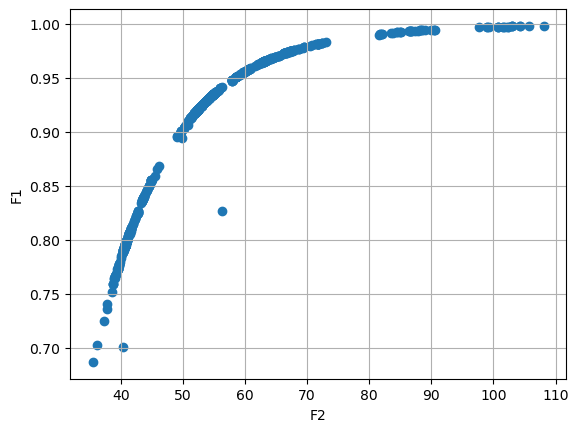

GENERATION :- 61
[[0.9568337070537923, 60.3100038834547], [0.9298285992777316, 53.98057473462268], [0.9294176593152936, 53.90658238400481], [0.8589974970483697, 45.26156476520663], [0.7986666086494786, 40.87806283165457], [0.9496682003361562, 58.2859853791815], [0.7938267128142411, 40.5887372371643], [0.8189551392273083, 42.267433136460674], [0.9566487081929439, 60.28351326979991], [0.8981837769220331, 49.44501317087481], [0.7936152145175744, 40.57562414611267], [0.9359079830000406, 55.171559518195664], [0.9619612418193875, 61.99182094396767], [0.9270040403694466, 53.47353142962052], [0.9288542220653073, 53.804138518971854], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9242506451951866, 53.02231440092723], [0.9290269051132964, 53.83495101766515], [0.9352080785497194, 55.00953503642873], [0.9902524754063303, 81.71977708956072], [0.7913373647200082, 40.44302327107781], [0.9258400687017267, 53.27354444101292], [0.9409445953429487, 56.2258357100520

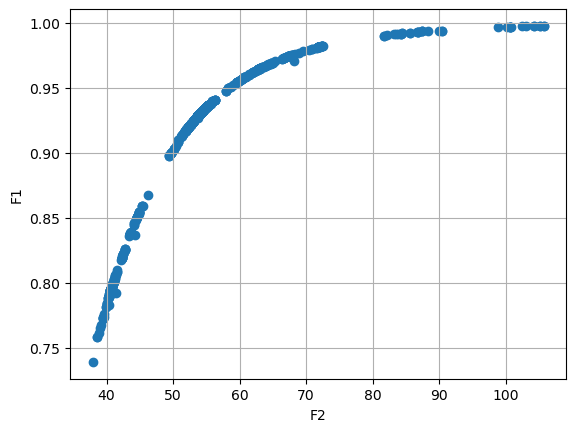

GENERATION :- 62
[[0.9650345144520294, 63.07270959340076], [0.9288296950140408, 53.80055552344087], [0.9261056576089461, 53.33090541263316], [0.9290269051132964, 53.834951017665134], [0.9261135463617408, 53.33200325011134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9269994406365872, 53.472666388743704], [0.9745725095980773, 67.44858358624461], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.7717207711055192, 39.404872723746216], [0.928976278300629, 53.82620992908892], [0.8390673144605321, 43.70449088814823], [0.8189551392273083, 42.267433136460674], [0.9025458203685057, 49.99910801520248], [0.9290269051132964, 53.83495101766515], [0.9732934219290097, 66.74962161668927], [0.8056984919633154, 41.318111753161915], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834

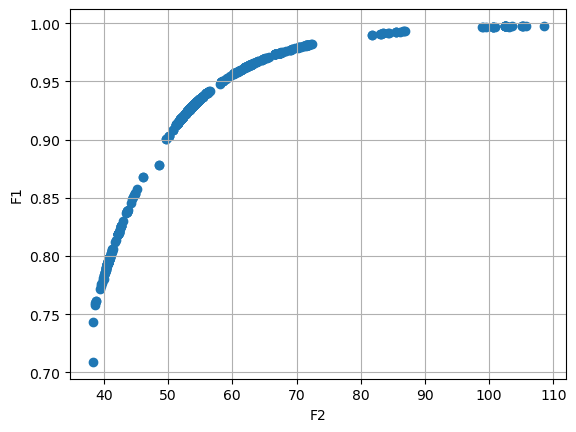

GENERATION :- 63
[[0.9290269051132964, 53.834951017665134], [0.7985439825773525, 40.87057336742764], [0.9396105570265014, 55.907751620891005], [0.8132181948696275, 41.83247134675611], [0.9663673268003471, 63.61827859339645], [0.9702560431823722, 65.3550166231316], [0.9366597737084414, 55.29843978724675], [0.9301831424193923, 54.0427911130406], [0.9641733157395831, 62.75050822611139], [0.9290269051132964, 53.834951017665134], [0.9289723890620113, 53.82457269616359], [0.7985439825773525, 40.87057336742764], [0.9290269051132964, 53.834951017665134], [0.9641733157395831, 62.75050822611139], [0.9597335622528275, 61.2871462748779], [0.9767763917534723, 68.72405042578363], [0.9290269051132964, 53.834951017665134], [0.9409445953429487, 56.22583571005203], [0.9290269051132964, 53.834951017665134], [0.9261767765432687, 53.34219020267899], [0.9196501333453561, 52.27422787064356], [0.9161986557779028, 51.7407522235684], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665

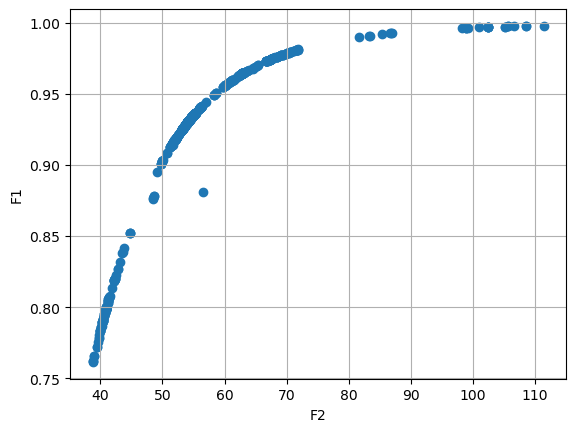

GENERATION :- 64
[[0.9290269051132964, 53.834951017665134], [0.8785117922465949, 55.824280109825466], [0.9409445953429487, 56.22583571005203], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.808101514851913, 41.47078003359535], [0.9283472019774268, 53.72207846763662], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.83495101766515], [0.9290269051132964, 53.834951017665134], [0.9361396296822903, 55.18482827648406], [0.9290269051132964, 53.834951017665134], [0.9198560813364889, 52.3085920278229], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9338257352198218, 54.73116642671026], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.8

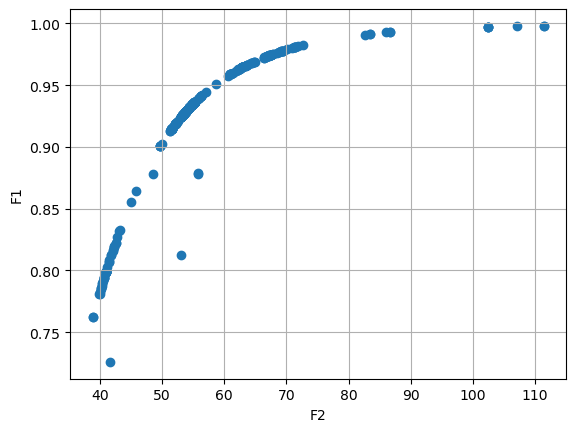

GENERATION :- 65
[[0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132964, 53.834951017665134], [0.9290269051132

In [108]:
#Main Function

population_size = 1000
number_of_variables = 4
variable_upper_bound = [] 
variable_lower_bound = []
for i in range(number_of_variables):
    variable_upper_bound.append(10)
    variable_lower_bound.append(1)
    
# print(variable_lower_bound)
# print(variable_upper_bound)

threshold = population_size*0.8

print(f'Threshold = {threshold}')

population = Generate_population_2(population_size, number_of_variables, variable_upper_bound, variable_lower_bound)

for i in range(100):
    print(f"GENERATION :- {i+1}")
    counter = 0
    first_counter = 0
    function_values = Function_values_2(population)
    print(function_values)
    
    first_value = function_values[0] # Get the first element of the first sublist
    first_f1_point = first_value[0]
    
    for sublist in function_values:
        if sublist == first_value:
                first_counter += 1
        for value in sublist:
            if value == first_f1_point:
                counter += 1 # Found different value
    
    if counter >= threshold or first_counter >= threshold:
        print(f"Convergence reached after {i+1} generations as there are {threshold} same values")
        break
    
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation_2(function_values)
    #print(pareto_optimal_front_values)
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    #print(crowding_distance_calculation_values)
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                population_size, population)
    population = final_selected_values
    offspring_population = Crossover(population, lows=variable_lower_bound, highs=variable_upper_bound)
    offspring_population = Mutation3(offspring_population,  lows=variable_lower_bound, highs=variable_upper_bound)
    population = New_generations_2(population, offspring_population)
    #print(population)
    x = []
    y = []
    for i in function_values:
        x.append(i[0])
        y.append(i[1])
    #plt.figure(figsize=(8, 6))
    #plt.xlim(50, 300)  # Limit x-axis from 0 to 6
    #plt.ylim(0.9, 0.99)  # Limit y-axis from 0 to 6

    plt.scatter(y,x)
    plt.ylabel("F1")
    plt.xlabel("F2")
    plt.grid()
    plt.show()

Threshold = 800.0
r: [0.59359932 0.63597328 0.8436944  0.59529435]
GENERATION :- 1
[[0.9228287907536429, 59.17508895417518], [0.7234072567751352, 41.258329542636176], [0.8236927520763343, 65.32118718691868], [0.9708998968402099, 57.195552996764405], [0.8441571837684915, 51.40826466883985], [0.8438793091289802, 48.812416114587194], [0.5173022832367711, 39.03515467409413], [0.8689340417208061, 50.7909490005734], [0.915092137483843, 45.81448265389022], [0.5691481212892395, 43.66850808668843], [0.9427468188839112, 50.52604219059077], [0.5788231440898602, 58.34180338568939], [0.7943437599001235, 41.530041259278605], [0.7628881221696153, 36.00153498095097], [0.8435064536546374, 46.2108681076071], [0.5279669583940835, 40.279533750659084], [0.7938610261811815, 60.376667265213655], [0.9036847387681106, 40.06639883170887], [0.6858438968527799, 47.05007048535619], [0.9026706315801505, 47.5682083257133], [0.9802598157063077, 61.33725339183287], [0.5933750906522689, 54.10174840351479], [0.529769993

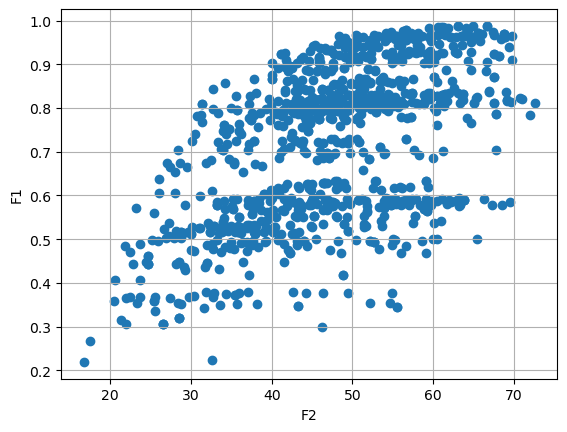

GENERATION :- 2
[[0.4987433621733678, 27.310724178455033], [0.4305580431817949, 29.2320473360342], [0.854188229558559, 48.23697408433054], [0.8087694632892635, 31.421421376277344], [0.8541987393070467, 51.31424108447449], [0.9310183392797801, 44.77625851101594], [0.992290077418543, 73.19506982635735], [0.4857968766093061, 31.997119581083716], [0.5163843314520317, 28.75646889080645], [0.9193181253202243, 51.911908976767634], [0.9697372566540774, 68.73405017100632], [0.6998342393064909, 27.887658101601403], [0.8883913009435029, 51.898107287714545], [0.7906989541004859, 40.645515088222], [0.854531306176653, 47.69540355766888], [0.9015109691290673, 46.752704630866496], [0.9044062551117139, 48.10333088304836], [0.8168934571462507, 40.787866514976514], [0.7552509941640114, 29.90714175654955], [0.9094537598208328, 58.28927963515758], [0.8653740549511806, 37.833697461686235], [0.8343561325346615, 38.019769377741845], [0.684666468525817, 40.874019973927886], [0.9741418412458015, 67.345820742885

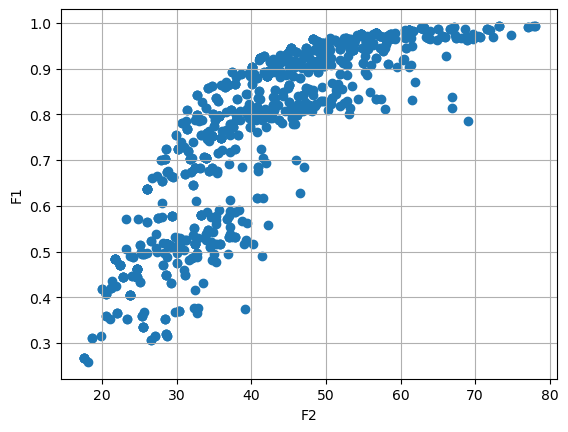

GENERATION :- 3
[[0.9783127862617639, 60.68449775121481], [0.9668180438966266, 50.47394354601853], [0.9573307820358165, 46.63412206842236], [0.9400146927374432, 48.097087354871505], [0.4466630864679916, 24.452061834722237], [0.8935824808404651, 37.371179829452494], [0.9416555282886756, 45.146358734018904], [0.9783386060818019, 56.6589368622219], [0.929449153296901, 43.86420168725301], [0.9124628767368405, 39.359062571912546], [0.9512090697928992, 47.02383270407174], [0.8630554874126578, 35.925435117101074], [0.9745394229110096, 54.7440550351761], [0.9746561166048976, 52.538875418456115], [0.8704952913547761, 36.59075275484536], [0.94492121381724, 45.35196502165647], [0.9223859949457622, 41.1961284840155], [0.9543745585748448, 52.756172292716045], [0.9223859949457622, 41.1961284840155], [0.9523598240408936, 49.37924440163739], [0.8573503603525944, 34.253567434685806], [0.5163843314520317, 28.75646889080645], [0.9369842733623275, 45.9291335596906], [0.3148556144131213, 19.893864468390465

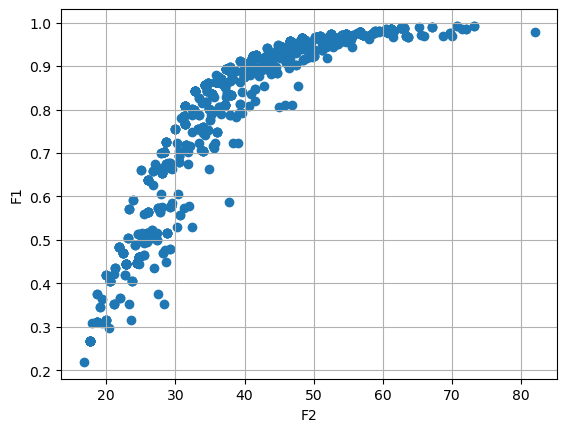

GENERATION :- 4
[[0.9879157625674283, 62.703937956538056], [0.9223859949457622, 41.1961284840155], [0.9223859949457622, 41.1961284840155], [0.9437606123250688, 46.31810700837757], [0.8180487005678413, 34.36405224815748], [0.8087694632892635, 31.421421376277344], [0.9416555282886756, 45.146358734018904], [0.504664022908772, 23.140074083496074], [0.31070224106625993, 18.635438976692285], [0.8935824808404651, 37.371179829452494], [0.8789510364181027, 35.88341649504903], [0.9783386060818019, 56.6589368622219], [0.5130649045247112, 24.627837417899528], [0.26633884701111804, 17.569577245414607], [0.8849859773516774, 38.078516089248815], [0.9239235670570674, 52.69276163248851], [0.992290077418543, 73.19506982635735], [0.31070224106625993, 18.635438976692285], [0.9635858337930091, 50.511169367557606], [0.9812730850976035, 59.20382492383067], [0.7146209520982608, 29.875540844061454], [0.9573307820358165, 46.63412206842236], [0.31070224106625993, 18.635438976692285], [0.93752199350377, 44.646239

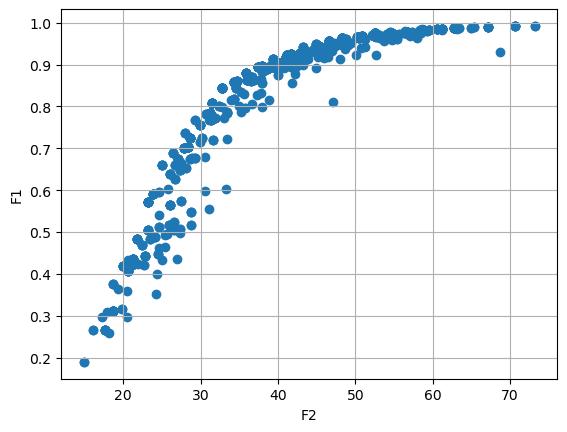

GENERATION :- 5
[[0.4364451945533313, 21.292430817903508], [0.8573503603525944, 34.253567434685806], [0.9746561166048976, 52.538875418456115], [0.8573503603525944, 34.253567434685806], [0.7848792509429534, 31.24643985339079], [0.8975222862992492, 37.871299237509085], [0.7848792509429534, 31.24643985339079], [0.9416555282886756, 45.146358734018904], [0.888887880823686, 38.57863549730541], [0.8611304183799526, 34.7536868427424], [0.8573503603525944, 34.253567434685806], [0.9694153658126914, 52.3822058906037], [0.9264527951079312, 41.6962478920721], [0.9573307820358165, 46.63412206842236], [0.767823267804051, 31.39490509095301], [0.9923488104612116, 70.67808760946666], [0.9772744952215001, 54.44713776304128], [0.40644673334938697, 20.550876936389155], [0.9082458248369853, 40.82129067139929], [0.6883752123035797, 26.399894767197942], [0.8975222862992492, 37.871299237509085], [0.9879157625674283, 62.703937956538056], [0.9416555282886756, 45.146358734018904], [0.7814339085770254, 30.74632044

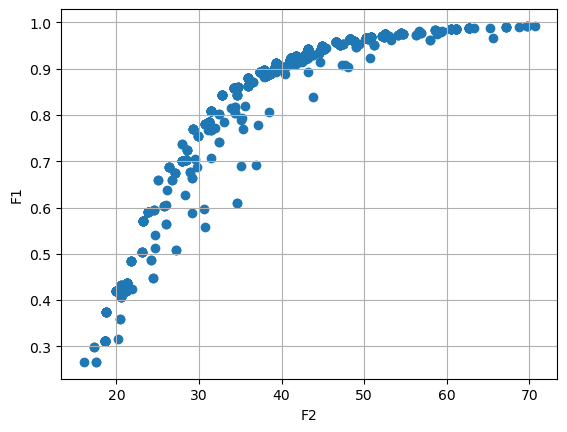

GENERATION :- 6
[[0.9124628767368405, 39.359062571912546], [0.9124628767368405, 39.359062571912546], [0.504664022908772, 23.140074083496074], [0.9637012158777969, 48.305989750837625], [0.93752199350377, 44.6462393259623], [0.7848792509429534, 31.24643985339079], [0.37457913656580366, 18.71533030154907], [0.8975222862992492, 37.871299237509085], [0.985038302187382, 61.172609878380754], [0.9682132666767094, 50.86700773604085], [0.8789510364181027, 35.88341649504903], [0.9802598157063077, 61.33725339183287], [0.37457913656580366, 18.71533030154907], [0.8975222862992492, 37.871299237509085], [0.8748838090004236, 39.97702735545088], [0.948142561984929, 44.85587890889082], [0.31070224106625993, 18.635438976692285], [0.8087694632892635, 31.421421376277344], [0.35926674152923826, 20.48308224228485], [0.7848792509429534, 31.24643985339079], [0.7371547410045475, 27.914174386925737], [0.93752199350377, 44.6462393259623], [0.4364451945533313, 21.292430817903508], [0.8975222862992492, 37.8712992375

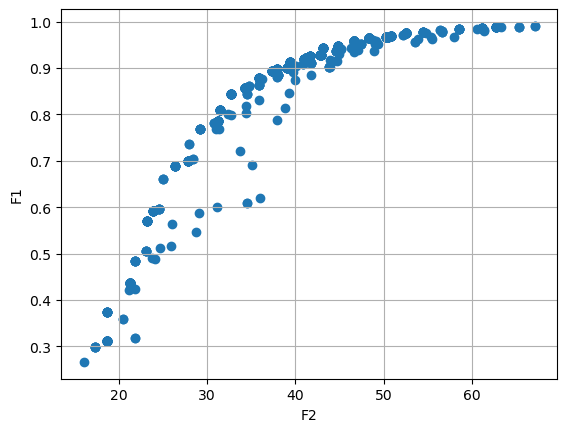

GENERATION :- 7
[[0.923803619325527, 50.72783934253202], [0.4364451945533313, 21.292430817903508], [0.9746561166048976, 52.538875418456115], [0.4839925970222428, 21.795691359491066], [0.5130649045247112, 24.627837417899528], [0.9124628767368405, 39.359062571912546], [0.8995287098590719, 39.04304751186776], [0.8849859773516774, 38.078516089248815], [0.9285238932227566, 42.86799616643077], [0.9285238932227566, 42.86799616643077], [0.6883752123035797, 26.399894767197942], [0.9223859949457622, 41.1961284840155], [0.8573503603525944, 34.253567434685806], [0.9682132666767094, 50.86700773604085], [0.9082458248369853, 40.82129067139929], [0.9416555282886756, 45.146358734018904], [0.8573503603525944, 34.253567434685806], [0.37457913656580366, 18.71533030154907], [0.8975222862992492, 37.871299237509085], [0.9841972244487165, 58.58387651277228], [0.504664022908772, 23.140074083496074], [0.6883752123035797, 26.399894767197942], [0.31070224106625993, 18.635438976692285], [0.5635071246737006, 25.998

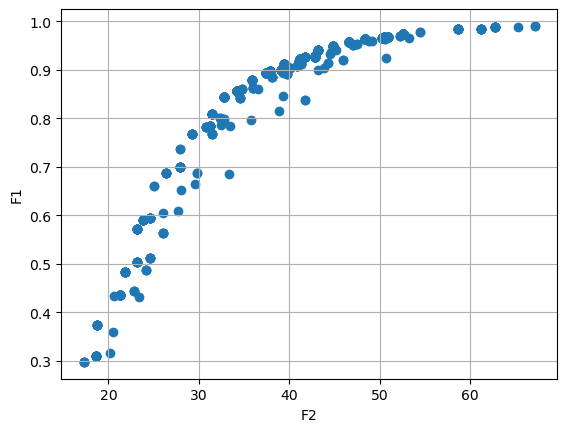

GENERATION :- 8
[[0.4364451945533313, 21.292430817903508], [0.9223859949457622, 41.1961284840155], [0.8789510364181027, 35.88341649504903], [0.8789510364181027, 35.88341649504903], [0.9573307820358165, 46.63412206842236], [0.31070224106625993, 18.635438976692285], [0.8573503603525944, 34.253567434685806], [0.9682132666767094, 50.86700773604085], [0.9573307820358165, 46.63412206842236], [0.8573503603525944, 34.253567434685806], [0.8789510364181027, 35.88341649504903], [0.9573307820358165, 46.63412206842236], [0.8975222862992492, 37.871299237509085], [0.8975222862992492, 37.871299237509085], [0.9573307820358165, 46.63412206842236], [0.9223859949457622, 41.1961284840155], [0.8935824808404651, 37.371179829452494], [0.9637012158777969, 48.305989750837625], [0.8935824808404651, 37.371179829452494], [0.9746561166048976, 52.538875418456115], [0.4364451945533313, 21.292430817903508], [0.31070224106625993, 18.635438976692285], [0.9637012158777969, 48.305989750837625], [0.8573503603525944, 34.253

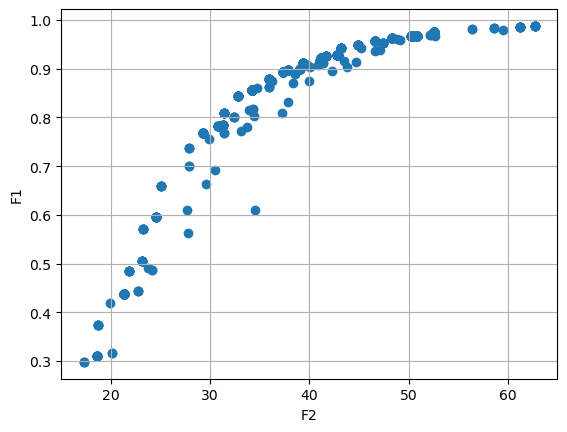

GENERATION :- 9
[[0.8433121776252508, 32.765804100282345], [0.9264527951079312, 41.6962478920721], [0.8789510364181027, 35.88341649504903], [0.8975222862992492, 37.871299237509085], [0.9682132666767094, 50.86700773604085], [0.4364451945533313, 21.292430817903508], [0.8975222862992492, 37.871299237509085], [0.8573503603525944, 34.253567434685806], [0.985038302187382, 61.172609878380754], [0.8573503603525944, 34.253567434685806], [0.9223859949457622, 41.1961284840155], [0.9746561166048976, 52.538875418456115], [0.9746561166048976, 52.538875418456115], [0.5079290978186317, 27.268705556402992], [0.9746561166048976, 52.538875418456115], [0.8849859773516774, 38.078516089248815], [0.8573503603525944, 34.253567434685806], [0.9637012158777969, 48.305989750837625], [0.8433121776252508, 32.765804100282345], [0.9264527951079312, 41.6962478920721], [0.8789510364181027, 35.88341649504903], [0.5376578305425818, 27.250149915338326], [0.8433121776252508, 32.765804100282345], [0.8849859773516774, 38.078

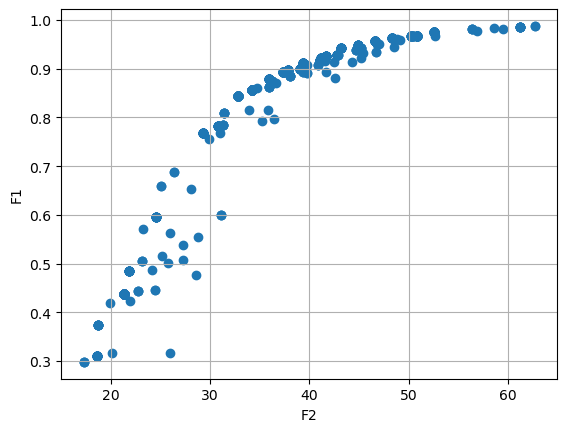

GENERATION :- 10
[[0.8935824808404651, 37.371179829452494], [0.9573307820358165, 46.63412206842236], [0.8433121776252508, 32.765804100282345], [0.8573503603525944, 34.253567434685806], [0.4364451945533313, 21.292430817903508], [0.8995287098590719, 39.04304751186776], [0.8573503603525944, 34.253567434685806], [0.8573503603525944, 34.253567434685806], [0.8975222862992492, 37.871299237509085], [0.8789510364181027, 35.88341649504903], [0.8573503603525944, 34.253567434685806], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.9573307820358165, 46.63412206842236], [0.941874976799422, 43.184011226475555], [0.4364451945533313, 21.292430817903508], [0.8995287098590719, 39.04304751186776], [0.8573503603525944, 34.253567434685806], [0.8433121776252508, 32.765804100282345], [0.4364451945533313, 21.292430817903508], [0.8789510364181027, 35.88341649504903], [0.9682132666767094, 50.86700773604085], [0.8433121776252508, 32.

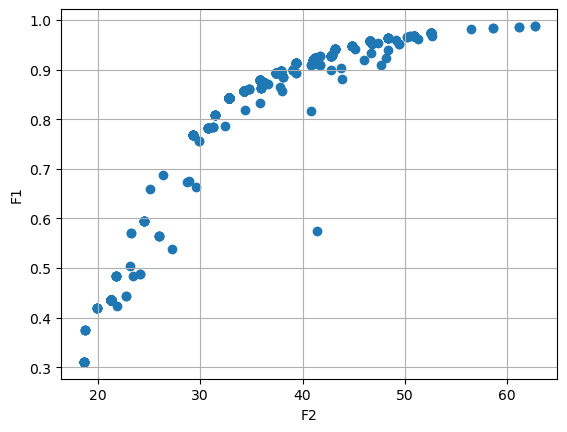

GENERATION :- 11
[[0.8433121776252508, 32.765804100282345], [0.9682132666767094, 50.86700773604085], [0.8087694632892635, 31.421421376277344], [0.8573503603525944, 34.253567434685806], [0.9274360407508242, 42.80917341385934], [0.9746561166048976, 52.538875418456115], [0.4364451945533313, 21.292430817903508], [0.8789510364181027, 35.88341649504903], [0.8573503603525944, 34.253567434685806], [0.4873340787061814, 24.151093161636304], [0.8573503603525944, 34.253567434685806], [0.8433121776252508, 32.765804100282345], [0.948142561984929, 44.85587890889082], [0.4364451945533313, 21.292430817903508], [0.9122502809843854, 41.32141007945589], [0.8433121776252508, 32.765804100282345], [0.8935824808404651, 37.371179829452494], [0.8935824808404651, 37.371179829452494], [0.8975222862992492, 37.871299237509085], [0.8975222862992492, 37.871299237509085], [0.9573307820358165, 46.63412206842236], [0.9274360407508242, 42.80917341385934], [0.8935824808404651, 37.371179829452494], [0.4364451945533313, 21.

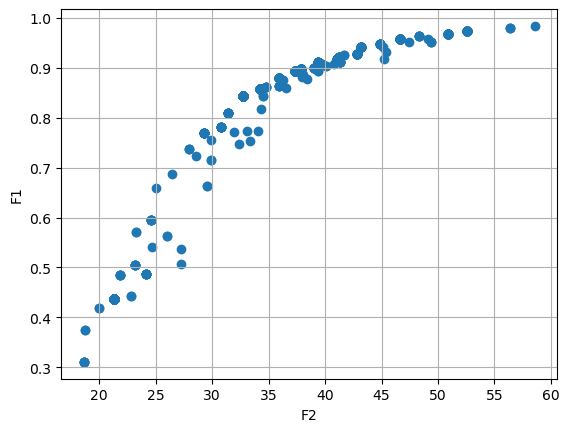

GENERATION :- 12
[[0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.9746561166048976, 52.538875418456115], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.9274360407508242, 42.80917341385934], [0.4364451945533313, 21.292430817903508], [0.4364451945533313, 21.292430817903508], [0.8433121776252508, 32.765804100282345], [0.9810243694274626, 56.41592271759137], [0.8573503603525944, 34.253567434685806], [0.9223859949457622, 41.1961284840155], [0.4364451945533313, 21.292430817903508], [0.8789510364181027, 35.88341649504903], [0.8433121776252508, 32.765804100282345], [0.4364451945533313, 21.292430817903508], [0.4364451945533313, 21.292430817903508], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.9746561166048976, 52.538875418456115], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 

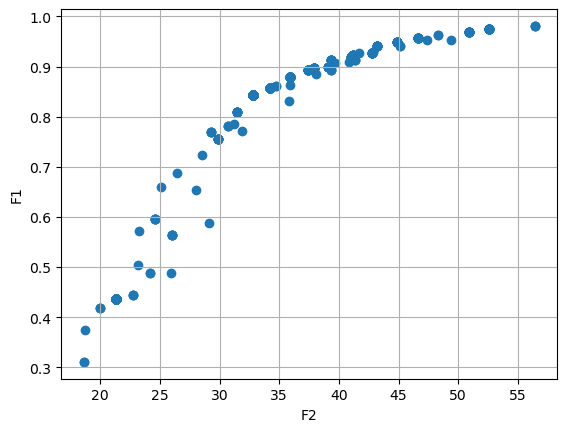

GENERATION :- 13
[[0.4364451945533313, 21.292430817903508], [0.9523598240408936, 49.37924440163739], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.4364451945533313, 21.292430817903508], [0.8935824808404651, 37.371179829452494], [0.8789510364181027, 35.88341649504903], [0.4364451945533313, 21.292430817903508], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.9122502809843854, 41.32141007945589], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.4364451945533313, 21.292430817903508], [0.8433121776252508, 32.765804100282345], [0.8573503603525944, 34.253567434685806], [0.8433121776252508

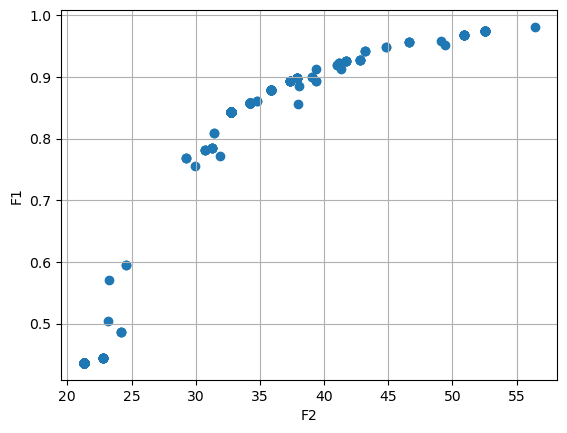

GENERATION :- 14
[[0.8433121776252508, 32.765804100282345], [0.8975222862992492, 37.871299237509085], [0.4364451945533313, 21.292430817903508], [0.8433121776252508, 32.765804100282345], [0.8789510364181027, 35.88341649504903], [0.4364451945533313, 21.292430817903508], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.7848792509429534, 31.24643985339079], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.4364451945533313, 21.292430817903508], [0.843312177625250

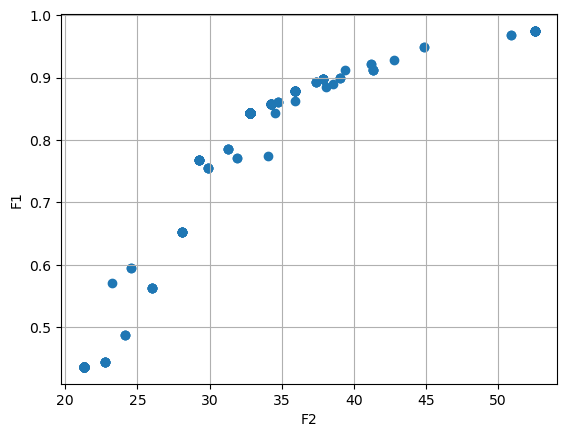

GENERATION :- 15
[[0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252508, 32.765804100282345], [0.8433121776252

In [111]:
#Main Function

population_size = 1000
number_of_variables = 4
variable_upper_bound = [] 
variable_lower_bound = []
for i in range(number_of_variables):
    variable_upper_bound.append(10)
    variable_lower_bound.append(1)
    
# print(variable_lower_bound)
# print(variable_upper_bound)

threshold = population_size*0.8

print(f'Threshold = {threshold}')

population = Generate_population_2(population_size, number_of_variables, variable_upper_bound, variable_lower_bound)

for i in range(100):
    print(f"GENERATION :- {i+1}")
    counter = 0
    first_counter = 0
    function_values = Function_values_2(population)
    print(function_values)
    
    first_value = function_values[0] # Get the first element of the first sublist
    first_f1_point = first_value[0]
    
    for sublist in function_values:
        if sublist == first_value:
                first_counter += 1
        for value in sublist:
            if value == first_f1_point:
                counter += 1 # Found different value
    
    if counter >= threshold or first_counter >= threshold:
        print(f"Convergence reached after {i+1} generations as there are {threshold} same values")
        break
    
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation_2(function_values)
    #print(pareto_optimal_front_values)
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    #print(crowding_distance_calculation_values)
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                population_size, population)
    population = final_selected_values
    offspring_population = Crossover2(population, lows=variable_lower_bound, highs=variable_upper_bound)
    offspring_population = Mutation3(offspring_population,  lows=variable_lower_bound, highs=variable_upper_bound)
    population = New_generations_2(population, offspring_population)
    #print(population)
    x = []
    y = []
    for i in function_values:
        x.append(i[0])
        y.append(i[1])
    #plt.figure(figsize=(8, 6))
    #plt.xlim(50, 300)  # Limit x-axis from 0 to 6
    #plt.ylim(0.9, 0.99)  # Limit y-axis from 0 to 6

    plt.scatter(y,x)
    plt.ylabel("F1")
    plt.xlabel("F2")
    plt.grid()
    plt.show()

Threshold = 800.0
r: [0.5203732  0.59964365 0.9203262  0.77667555]
GENERATION :- 1
[[0.764058756528164, 73.8658272723589], [0.4893150315966425, 65.78053538008503], [0.9640793106942573, 115.27471912959504], [0.548095752402857, 45.1621488487059], [0.8663273116678163, 106.59275941418986], [0.8182195959664176, 115.7393499065196], [0.9331291636031522, 63.314286278690915], [0.5957670265005838, 92.47544691664184], [0.7166763747250473, 72.02397949797087], [0.943086584673344, 71.24069036357496], [0.46300778107432805, 58.92487925196188], [0.8855097636170968, 114.07691590471353], [0.6464389770866109, 96.0847976276084], [0.9204536973613949, 106.42089079742536], [0.512456615033923, 85.17278892519022], [0.5472808146899395, 59.697909648981955], [0.9709682943207224, 102.87171678597255], [0.5915573944926749, 52.43601872200798], [0.5331464599437216, 87.90057663450062], [0.9268618817765999, 76.841755114824], [0.766146554126392, 59.468396721144124], [0.47806421409682986, 95.79212561971937], [0.76859091540

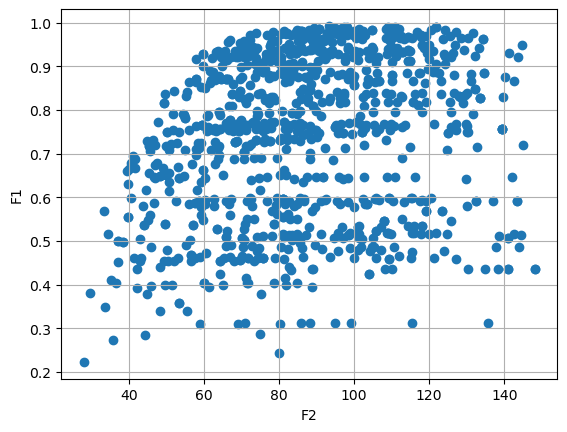

GENERATION :- 2
[[0.40384998478615675, 71.50004141736483], [0.5549955221951928, 50.80600242038119], [0.9402131024113464, 69.66267128982777], [0.9342220229948772, 68.30121202411758], [0.6173603589943352, 44.64630002482838], [0.9949285673774395, 114.87593714972297], [0.7285155173617952, 70.55809903765042], [0.8254804303562419, 70.82910496772072], [0.9873362969880383, 96.85242055327137], [0.8702673420525551, 69.53281189720383], [0.5952438913246114, 56.396139160135355], [0.7285446884661277, 85.4816640051417], [0.7487975771113805, 55.33611606405756], [0.9223472273006086, 68.97725200939219], [0.9202740074100135, 68.5283014725157], [0.24223009069362506, 39.27628865459013], [0.7303218779173692, 75.07816291087717], [0.9705390798050217, 125.58462624093401], [0.5615629096757262, 64.49946826684416], [0.9342220229948772, 68.30121202411758], [0.874439472463298, 83.02107280762692], [0.7597426131033744, 77.1335075653102], [0.6480500407788728, 48.26201376256102], [0.6704989331488033, 52.97432205300935]

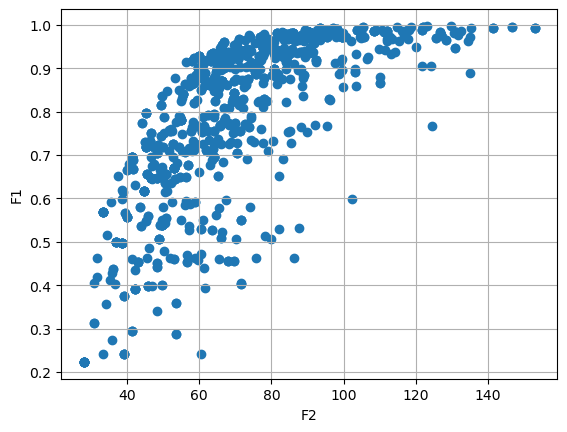

GENERATION :- 3
[[0.687952712715589, 41.77089201786099], [0.8897498236806406, 61.512232602205394], [0.694480496372611, 44.71037035731836], [0.9402131024113464, 69.66267128982777], [0.9538117541983571, 77.90320726921726], [0.9402131024113464, 69.66267128982777], [0.9139843364075976, 60.8170555335939], [0.8312896240869477, 55.30530955130281], [0.9014611699789202, 64.84497135230563], [0.9342220229948772, 68.30121202411758], [0.9867752002785724, 87.51001917523618], [0.9833858257458615, 106.79510256056926], [0.9319862350040454, 72.23795035488973], [0.9940225043527398, 104.92122234250593], [0.8312896240869477, 55.30530955130281], [0.6741807238676423, 47.000794036362215], [0.687952712715589, 41.77089201786099], [0.7975430476584003, 45.20584971323153], [0.8897498236806406, 61.512232602205394], [0.40593982975145454, 30.698386750255004], [0.8778620001590554, 78.01299620855795], [0.9891131016888646, 109.05356613146662], [0.9752371505458277, 76.76549547244281], [0.5661240869264007, 53.360264003720

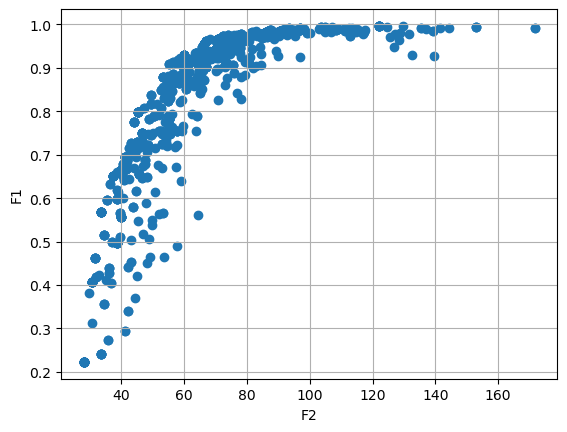

GENERATION :- 4
[[0.9406509615814448, 76.01245796303938], [0.22304350493692385, 28.042298343160674], [0.9141621422041201, 61.57686191738865], [0.9668000696267185, 68.28531116108869], [0.9402131024113464, 69.66267128982777], [0.9905325328507502, 96.99341659554713], [0.5951202111482938, 35.37306781012622], [0.8810369444083525, 54.74974966349118], [0.9230093380997091, 58.518720567733844], [0.9198456334120003, 62.17851479930409], [0.9230093380997091, 58.518720567733844], [0.7975430476584003, 45.20584971323153], [0.5653559786016776, 39.385837730046056], [0.9728250224495151, 72.24543159921606], [0.9806172898404365, 85.43864739349144], [0.9606395768808434, 66.92385189537849], [0.8783525206522887, 53.171730589744], [0.9289285116051367, 59.88017983344404], [0.22304350493692385, 28.042298343160674], [0.9666261384381394, 70.88397233350587], [0.8783525206522887, 53.171730589744], [0.9347174545665624, 63.840300271571415], [0.8961920313940128, 59.02260033404927], [0.687952712715589, 41.7708920178609

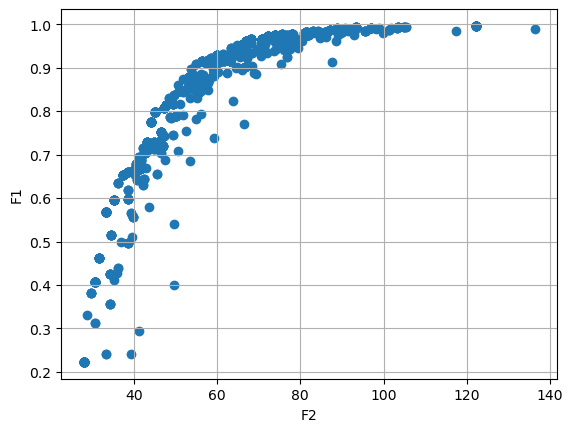

GENERATION :- 5
[[0.22304350493692385, 28.042298343160674], [0.5929169057087734, 35.66656418542137], [0.22304350493692385, 28.042298343160674], [0.8135350855701402, 47.760111296570905], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.9037898017051522, 68.41183137979014], [0.9920306152579637, 97.0182003649771], [0.7975430476584003, 45.20584971323153], [0.9785447227844742, 78.06780261747241], [0.8135350855701402, 47.760111296570905], [0.46214720881348664, 31.5736645257426], [0.9871051107025479, 87.23430724651863], [0.3123403875486432, 30.75622130630459], [0.9347174545665624, 63.840300271571415], [0.9925769203344067, 93.33239019349256], [0.7280251031336793, 43.18524101442968], [0.750817606399041, 46.63610221087547], [0.9871051107025479, 87.23430724651863], [0.8068757026669492, 47.32881075014198], [0.22304350493692385, 28.042298343160674], [0.9546598388801856, 66.33929418243956], [0.40593982975145454, 30.698386750255004], [0.7877238574580877, 54.71272770115

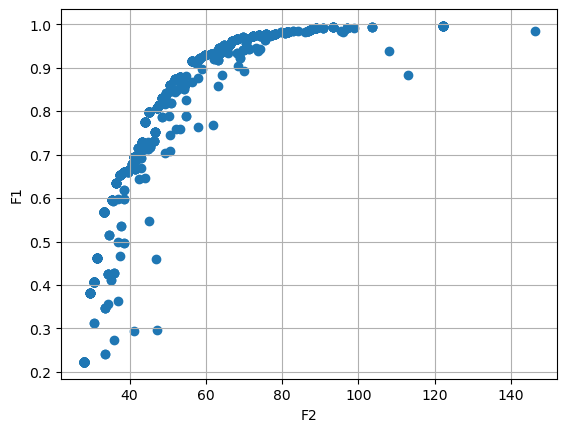

GENERATION :- 6
[[0.8783525206522887, 53.171730589744], [0.5684604166431829, 33.41230971339892], [0.7280251031336793, 43.18524101442968], [0.22304350493692385, 28.042298343160674], [0.9144690356387617, 56.35614378104773], [0.22304350493692385, 28.042298343160674], [0.46214720881348664, 31.5736645257426], [0.9331291636031522, 63.314286278690915], [0.22304350493692385, 28.042298343160674], [0.22304350493692385, 28.042298343160674], [0.861086336243906, 50.61746900640462], [0.22304350493692385, 28.042298343160674], [0.40593982975145454, 30.698386750255004], [0.8367564128562501, 49.55601685201135], [0.8172139238660506, 51.19421774181778], [0.8415893717665365, 49.58306522216444], [0.40593982975145454, 30.698386750255004], [0.6607823510188456, 38.586478826557254], [0.8367564128562501, 49.55601685201135], [0.7280251031336793, 43.18524101442968], [0.9546598388801856, 66.33929418243956], [0.651947281596922, 37.393676508928074], [0.8303368004579266, 48.390262904535255], [0.6650198871125296, 39.94

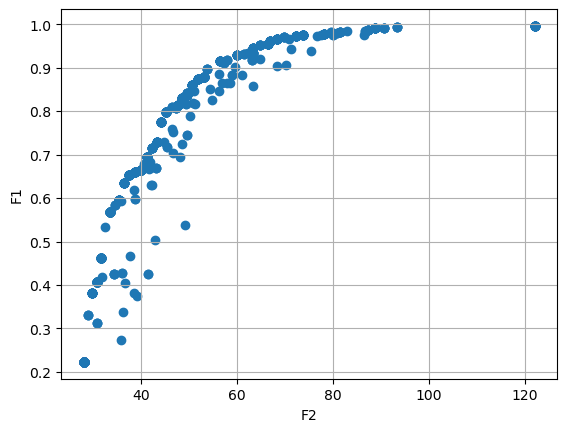

GENERATION :- 7
[[0.8783525206522887, 53.171730589744], [0.7975430476584003, 45.20584971323153], [0.7975430476584003, 45.20584971323153], [0.3813304927737578, 29.739230205846425], [0.9757981733648413, 73.82345067296325], [0.6650198871125296, 39.94793809226745], [0.22304350493692385, 28.042298343160674], [0.7427645224174168, 47.182511311034084], [0.8303368004579266, 48.390262904535255], [0.9901219044688296, 88.81232632026581], [0.6607823510188456, 38.586478826557254], [0.46214720881348664, 31.5736645257426], [0.8505309812575385, 59.59934906946243], [0.22304350493692385, 28.042298343160674], [0.40593982975145454, 30.698386750255004], [0.9668000696267185, 68.28531116108869], [0.46214720881348664, 31.5736645257426], [0.9606395768808434, 66.92385189537849], [0.22304350493692385, 28.042298343160674], [0.8367564128562501, 49.55601685201135], [0.5684604166431829, 33.41230971339892], [0.9546598388801856, 66.33929418243956], [0.22304350493692385, 28.042298343160674], [0.22304350493692385, 28.042

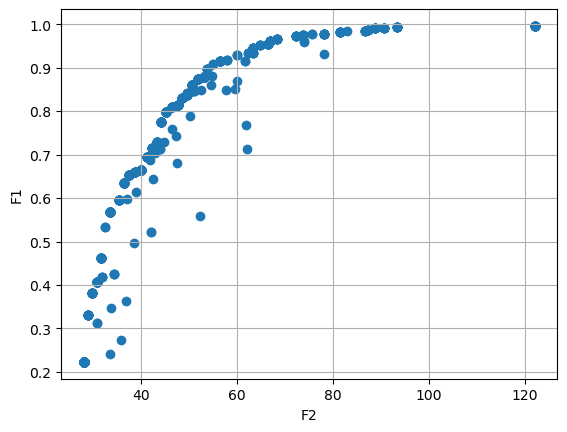

GENERATION :- 8
[[0.9546598388801856, 66.33929418243956], [0.6335265649435449, 36.3322243545348], [0.9144690356387617, 56.35614378104773], [0.6650198871125296, 39.94793809226745], [0.872755619595084, 51.810271324033806], [0.861086336243906, 50.61746900640462], [0.9915688396157225, 90.6684136917655], [0.7750085346471637, 44.14439755883826], [0.861086336243906, 50.61746900640462], [0.7156316376459592, 42.28593507209564], [0.6954115247666195, 41.224482917702375], [0.7280251031336793, 43.18524101442968], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.6335265649435449, 36.3322243545348], [0.872755619595084, 51.810271324033806], [0.9144690356387617, 56.35614378104773], [0.9144690356387617, 56.35614378104773], [0.7975430476584003, 45.20584971323153], [0.9901219044688296, 88.81232632026581], [0.46214720881348664, 31.5736645257426], [0.5684604166431829, 33.41230971339892], [0.8367564128562501, 49.55601685201135], [0.7750085346471637, 44.14439755883826], [0.7975

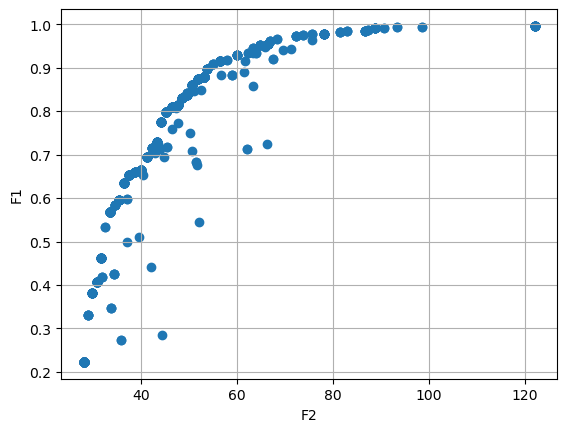

GENERATION :- 9
[[0.861086336243906, 50.61746900640462], [0.22304350493692385, 28.042298343160674], [0.8367564128562501, 49.55601685201135], [0.8367564128562501, 49.55601685201135], [0.46214720881348664, 31.5736645257426], [0.8783525206522887, 53.171730589744], [0.6335265649435449, 36.3322243545348], [0.9935598015154586, 98.57143566929432], [0.9144690356387617, 56.35614378104773], [0.9144690356387617, 56.35614378104773], [0.5684604166431829, 33.41230971339892], [0.6650198871125296, 39.94793809226745], [0.9785447227844742, 78.06780261747241], [0.8135350855701402, 47.760111296570905], [0.8783525206522887, 53.171730589744], [0.9144690356387617, 56.35614378104773], [0.7975430476584003, 45.20584971323153], [0.651947281596922, 37.393676508928074], [0.9289285116051367, 59.88017983344404], [0.8135350855701402, 47.760111296570905], [0.9785447227844742, 78.06780261747241], [0.9517510941712214, 64.76127510869237], [0.8135350855701402, 47.760111296570905], [0.6335265649435449, 36.3322243545348], [

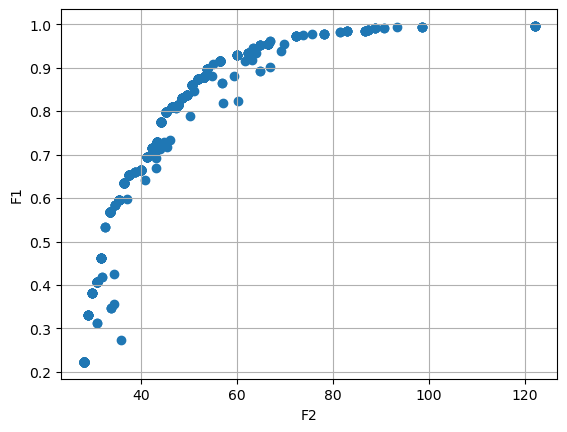

GENERATION :- 10
[[0.8783525206522887, 53.171730589744], [0.6335265649435449, 36.3322243545348], [0.7975430476584003, 45.20584971323153], [0.7280251031336793, 43.18524101442968], [0.7750085346471637, 44.14439755883826], [0.5951202111482938, 35.37306781012622], [0.6954115247666195, 41.224482917702375], [0.7860296326217604, 48.596860307602775], [0.8303368004579266, 48.390262904535255], [0.7750085346471637, 44.14439755883826], [0.40593982975145454, 30.698386750255004], [0.8783525206522887, 53.171730589744], [0.9854278015653265, 86.70829325363812], [0.5849892393367947, 34.473761867792184], [0.861086336243906, 50.61746900640462], [0.7156316376459592, 42.28593507209564], [0.9925769203344067, 93.33239019349256], [0.5684604166431829, 33.41230971339892], [0.5684604166431829, 33.41230971339892], [0.6650198871125296, 39.94793809226745], [0.6335265649435449, 36.3322243545348], [0.8367564128562501, 49.55601685201135], [0.8303368004579266, 48.390262904535255], [0.5684604166431829, 33.41230971339892]

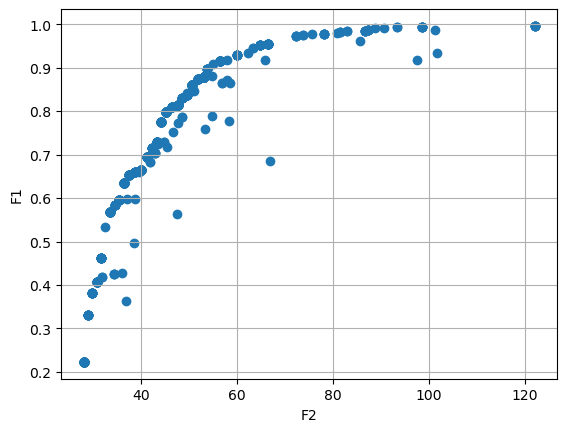

GENERATION :- 11
[[0.8783525206522887, 53.171730589744], [0.861086336243906, 50.61746900640462], [0.7975430476584003, 45.20584971323153], [0.861086336243906, 50.61746900640462], [0.7750085346471637, 44.14439755883826], [0.9144690356387617, 56.35614378104773], [0.7750085346471637, 44.14439755883826], [0.7280251031336793, 43.18524101442968], [0.6954115247666195, 41.224482917702375], [0.8135350855701402, 47.760111296570905], [0.8135350855701402, 47.760111296570905], [0.8783525206522887, 53.171730589744], [0.7280251031336793, 43.18524101442968], [0.7975430476584003, 45.20584971323153], [0.7750085346471637, 44.14439755883826], [0.9144690356387617, 56.35614378104773], [0.8367564128562501, 49.55601685201135], [0.6650198871125296, 39.94793809226745], [0.8135350855701402, 47.760111296570905], [0.9144690356387617, 56.35614378104773], [0.5684604166431829, 33.41230971339892], [0.8783525206522887, 53.171730589744], [0.9854278015653265, 86.70829325363812], [0.22304350493692385, 28.042298343160674], 

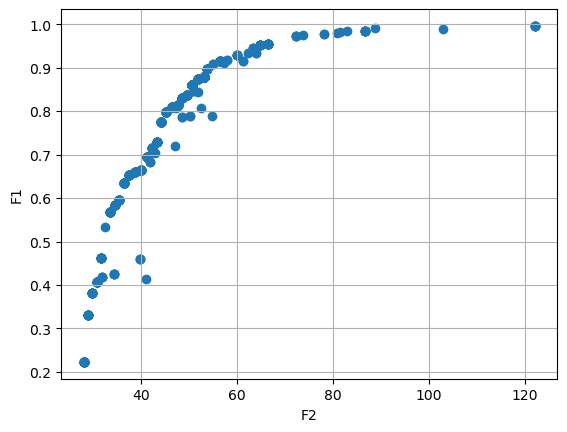

GENERATION :- 12
[[0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.7975430476584003, 45.20584971323153], [0.8783525206522887, 53.171730589744], [0.6650198871125296, 39.94793809226745], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.6650198871125296, 39.94793809226745], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.872755619595084, 51.810271324033806], [0.9144690356387617, 56.35614378104773], [0.872755619595084, 51.810271324033806], [0.40593982975145454, 30.698386750255004], [0.8783525206522887, 53.171730589744], [0.3813304927737578, 29.739230205846425], [0.8783525206522887, 53.171730589744], [0.8135350855701402, 47.760111296570905], [0.7975430476584003, 45.20584971323153], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 5

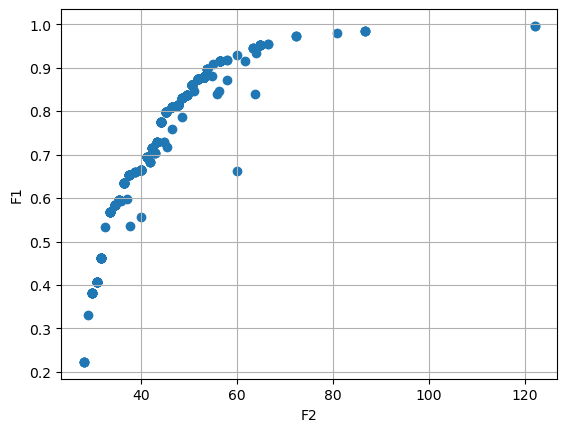

GENERATION :- 13
[[0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8135350855701402, 47.760111296570905], [0.861086336243906, 50.61746900640462], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], [0.8135350855701402, 47.760111296570905], [0.8783525206522887, 53.171730589744], [0.8783525206522887, 53.171730589744], 

In [116]:
#Main Function

population_size = 1000
number_of_variables = 4
variable_upper_bound = [] 
variable_lower_bound = []
for i in range(number_of_variables):
    variable_upper_bound.append(10)
    variable_lower_bound.append(1)
    
# print(variable_lower_bound)
# print(variable_upper_bound)

threshold = population_size*0.8

print(f'Threshold = {threshold}')

population = Generate_population_2(population_size, number_of_variables, variable_upper_bound, variable_lower_bound)

for i in range(100):
    print(f"GENERATION :- {i+1}")
    counter = 0
    first_counter = 0
    function_values = Function_values_2(population)
    print(function_values)
    
    first_value = function_values[0] # Get the first element of the first sublist
    first_f1_point = first_value[0]
    
    for sublist in function_values:
        if sublist == first_value:
                first_counter += 1
        for value in sublist:
            if value == first_f1_point:
                counter += 1 # Found different value
    
    if counter >= threshold or first_counter >= threshold:
        print(f"Convergence reached after {i+1} generations as there are {threshold} same values")
        break
    
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation_2(function_values)
    #print(pareto_optimal_front_values)
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    #print(crowding_distance_calculation_values)
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                population_size, population)
    population = final_selected_values
    offspring_population = Crossover4(population, lows=variable_lower_bound, highs=variable_upper_bound)
    offspring_population = Mutation3(offspring_population,  lows=variable_lower_bound, highs=variable_upper_bound)
    population = New_generations_2(population, offspring_population)
    #print(population)
    x = []
    y = []
    for i in function_values:
        x.append(i[0])
        y.append(i[1])
    #plt.figure(figsize=(8, 6))
    #plt.xlim(50, 300)  # Limit x-axis from 0 to 6
    #plt.ylim(0.9, 0.99)  # Limit y-axis from 0 to 6

    plt.scatter(y,x)
    plt.ylabel("F1")
    plt.xlabel("F2")
    plt.grid()
    plt.show()

Threshold = 800.0
r: [0.65098194 0.7117881  0.6977113  0.70694535]
GENERATION :- 1
[[0.6959349643688691, 95.34007740793432], [0.3210774879475478, 68.16913557644628], [0.5761383171060628, 42.12902038621202], [0.7013930753740149, 68.20756208594949], [0.8945771905889304, 102.41936918684962], [0.6419099736584859, 80.54116908092192], [0.6946657413111637, 79.69416220931859], [0.6302680854010289, 44.55594929482554], [0.9235388941640175, 51.03063919479541], [0.8269374313143107, 59.702548411824054], [0.9832427377083361, 64.96516985085309], [0.9440074193678107, 75.99129051972008], [0.6862887299298717, 42.057854091583735], [0.9871519001886904, 83.43096142791251], [0.4961987518329898, 64.01441163773453], [0.6935628171904741, 74.17659539764828], [0.9057645384100054, 77.083652361183], [0.45383477370053416, 87.69725225200776], [0.7772209959277712, 43.663407463488014], [0.9521906584054249, 75.5256989182731], [0.44440874153802934, 37.59987781606279], [0.9055663059194414, 84.63804867181136], [0.63263352

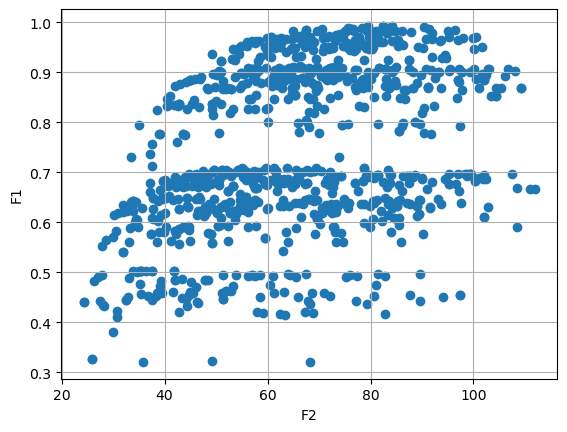

GENERATION :- 2
[[0.4397112088220612, 46.44436419498935], [0.8101919322683442, 47.71221930232637], [0.9775897936328416, 67.38375734125724], [0.8782125437118679, 68.61165093984303], [0.6224741665074555, 53.55872423538282], [0.8646646035415314, 43.404447942245795], [0.6626968254523875, 36.08637076527869], [0.9893335748726503, 83.41619112702777], [0.9511085285327117, 70.87125800771531], [0.9863638239473234, 70.59221371431806], [0.9542468015634276, 78.8377828188962], [0.6472441629524668, 37.68080580371054], [0.5791646878243037, 48.43981859271637], [0.6059244719712035, 37.77151505573157], [0.9828450622883691, 84.80891907855654], [0.8802019711284395, 44.2661747603618], [0.6797343177934826, 41.22275588634865], [0.9465139359320929, 53.20532050507427], [0.9490194422261438, 61.51408615141012], [0.9407702988807508, 59.46140811138504], [0.45159521582780143, 34.77441024311938], [0.6486072264921885, 39.4447151978368], [0.44792769995450243, 32.1226727530845], [0.9928629670789284, 89.936990034977], [0

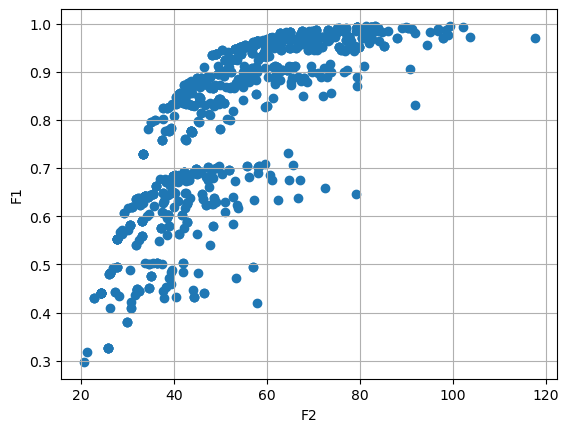

GENERATION :- 3
[[0.4820352450373194, 26.315858852826203], [0.9897971462237939, 75.02102602270779], [0.9704068835190295, 60.7338069273942], [0.9371590582076844, 50.15445201785667], [0.989940836679467, 75.53884694684186], [0.4296928133169326, 22.864618022209118], [0.9844017894280324, 67.52070576315727], [0.8005253092062944, 35.864605284785846], [0.6471399965670969, 36.52349838355246], [0.5535353941528173, 27.871797934569447], [0.9844017894280324, 67.52070576315727], [0.9897971462237939, 75.02102602270779], [0.9704068835190295, 60.7338069273942], [0.9844017894280324, 67.52070576315727], [0.9465139359320929, 53.20532050507427], [0.440783847535648, 24.346517372643714], [0.7784182156688203, 38.664239742720824], [0.440783847535648, 24.346517372643714], [0.989676624586524, 76.98457285007352], [0.8251191381360378, 38.539788598519216], [0.9270712730945015, 52.81638608758225], [0.953755615439431, 54.85857392310875], [0.9087415737733668, 46.4807846321229], [0.8005253092062944, 35.864605284785846]

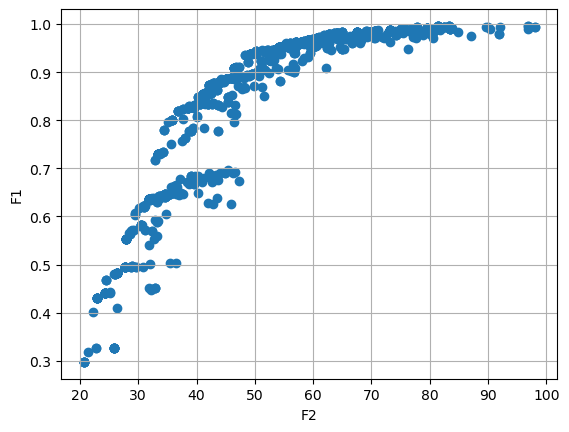

GENERATION :- 4
[[0.8869363047020518, 45.919428178396274], [0.9366600350008911, 49.155967945856275], [0.8893326992062669, 46.13846954146571], [0.440783847535648, 24.346517372643714], [0.9441771008248419, 50.27358124716428], [0.7803824349902952, 34.38270593435125], [0.9815098214221327, 64.09037752676792], [0.9832427377083361, 64.96516985085309], [0.945776797895854, 53.37794753210724], [0.8236649068077021, 37.66499627443405], [0.881802375627694, 44.10788619873108], [0.9441771008248419, 50.27358124716428], [0.9614098800320418, 55.97618722441675], [0.9852926473735153, 70.2265328123379], [0.9561953250647686, 56.49940578597329], [0.8564024359987352, 42.43763132579686], [0.4296928133169326, 22.864618022209118], [0.9812939078147305, 63.60677787585003], [0.8188541701955877, 36.88653518048474], [0.9844017894280324, 67.52070576315727], [0.8236649068077021, 37.66499627443405], [0.9495551337381049, 54.385814941315566], [0.8094457109446955, 40.16231112907094], [0.7299378120377973, 33.43529434986766]

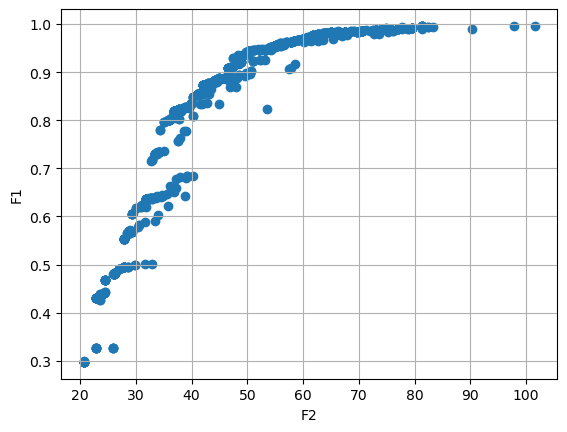

GENERATION :- 5
[[0.43820938433363193, 23.5680562786944], [0.4405213338790702, 24.357131925290947], [0.7336518119790948, 33.69782119826562], [0.7299378120377973, 33.43529434986766], [0.639386197838907, 32.657816362073724], [0.6990295279108127, 48.29876799784935], [0.9823429501040585, 64.38854486751573], [0.9823429501040585, 64.38854486751573], [0.9875265548199226, 73.14774962662223], [0.9087415737733668, 46.4807846321229], [0.9281184988605673, 52.501882248588984], [0.491589250293359, 27.01929710931148], [0.48058573909391583, 25.997367213612584], [0.4296928133169326, 22.864618022209118], [0.4820352450373194, 26.315858852826203], [0.9781947810985611, 61.851420228702196], [0.9704068835190295, 60.7338069273942], [0.9875265548199226, 73.14774962662223], [0.9087415737733668, 46.4807846321229], [0.494477318145469, 27.797758203260795], [0.9782110657050483, 61.8633045653216], [0.9414825503137347, 58.058623613660814], [0.440783847535648, 24.346517372643714], [0.4993257301427491, 29.7901638286539

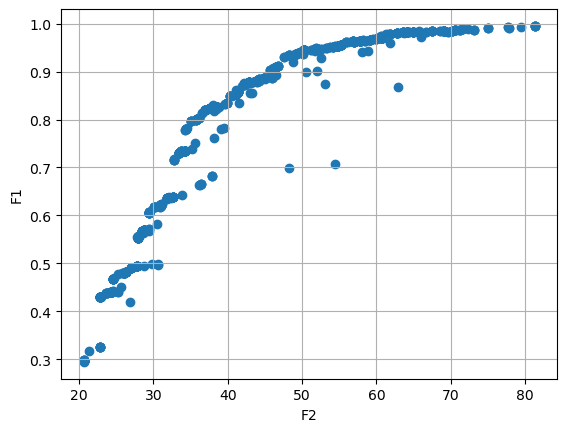

GENERATION :- 6
[[0.9087415737733668, 46.4807846321229], [0.9441771008248419, 50.27358124716428], [0.6214236268860809, 30.857425372425517], [0.7342261684811652, 34.21375544381697], [0.7182297171858918, 32.85825176823102], [0.8157906875944693, 36.630014174888586], [0.6214236268860809, 30.857425372425517], [0.48058573909391583, 25.997367213612584], [0.8005253092062944, 35.864605284785846], [0.781045106264407, 39.26877055899457], [0.81414714190101, 36.53846407330465], [0.48054501954959744, 25.79955473162717], [0.9616321275083226, 55.92177153123617], [0.440783847535648, 24.346517372643714], [0.8005253092062944, 35.864605284785846], [0.5702180331445053, 29.211553060390067], [0.8847109413461598, 44.21699276258409], [0.6069277958933084, 29.45851710540186], [0.48058573909391583, 25.997367213612584], [0.2976381054338587, 20.685220533013066], [0.440783847535648, 24.346517372643714], [0.9875076481327327, 71.19288395605484], [0.9799381578340385, 62.73809688940676], [0.9366600350008911, 49.15596794

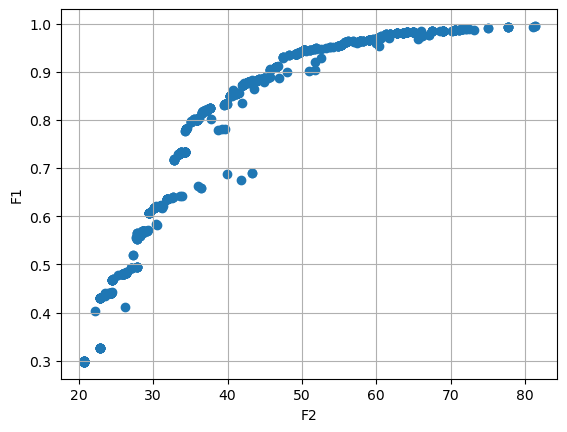

GENERATION :- 7
[[0.9850692312896812, 69.03701075929172], [0.440783847535648, 24.346517372643714], [0.9616056061736838, 55.65417319809454], [0.9441771008248419, 50.27358124716428], [0.9782110657050483, 61.8633045653216], [0.6214236268860809, 30.857425372425517], [0.5931048522838455, 33.12720429105603], [0.555616292322213, 27.724676181022048], [0.9087415737733668, 46.4807846321229], [0.440783847535648, 24.346517372643714], [0.7294859573205322, 33.391674889036366], [0.4787209164538582, 25.295203136907368], [0.48058573909391583, 25.997367213612584], [0.9366600350008911, 49.155967945856275], [0.7299378120377973, 33.43529434986766], [0.9295481588860822, 47.502714527821794], [0.440783847535648, 24.346517372643714], [0.4820352450373194, 26.315858852826203], [0.48058573909391583, 25.997367213612584], [0.9645792360577363, 56.13981808746389], [0.9087415737733668, 46.4807846321229], [0.9645792360577363, 56.13981808746389], [0.9295481588860822, 47.502714527821794], [0.2976381054338587, 20.68522053

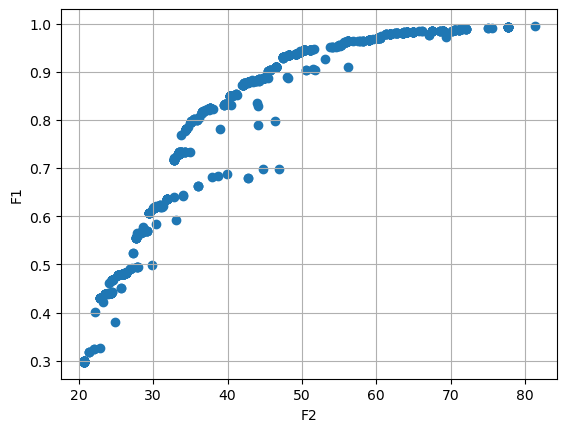

GENERATION :- 8
[[0.48058573909391583, 25.997367213612584], [0.9386624949338827, 49.49512015321497], [0.4684932068763278, 24.51546786317799], [0.2976381054338587, 20.685220533013066], [0.6069277958933084, 29.45851710540186], [0.9892511539528988, 72.06767628014], [0.8732401466874766, 42.115480573337905], [0.7773081248019206, 34.28048963295425], [0.3248358170364264, 22.033669201418398], [0.9813157401541933, 63.62261223563172], [0.48058573909391583, 25.997367213612584], [0.9772033022374712, 61.06502850022669], [0.8757506996321999, 42.2153518974441], [0.9849393884912084, 68.91754617880132], [0.4684932068763278, 24.51546786317799], [0.5218099593573065, 27.106441809365165], [0.8487078090381078, 40.3150895836897], [0.47777880706219955, 25.21890611966327], [0.2976381054338587, 20.685220533013066], [0.7784182156688203, 38.664239742720824], [0.8757506996321999, 42.2153518974441], [0.4684932068763278, 24.51546786317799], [0.8732401466874766, 42.115480573337905], [0.8774892345114527, 42.6022110190

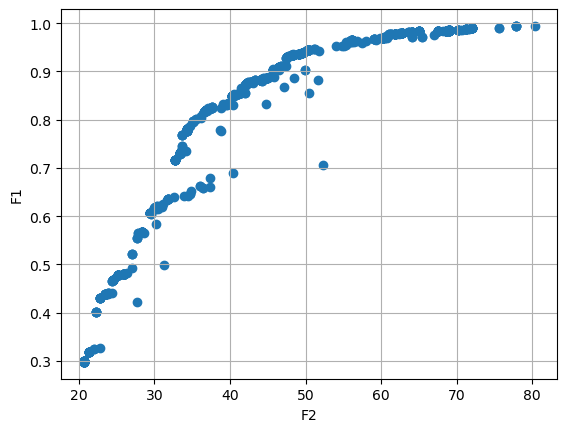

GENERATION :- 9
[[0.9520746687355631, 53.98378159902359], [0.48058573909391583, 25.997367213612584], [0.9692127447572844, 60.25554564654715], [0.8869688356241526, 44.88204420413], [0.9631073086287422, 56.85097954850191], [0.48058573909391583, 25.997367213612584], [0.2976381054338587, 20.685220533013066], [0.9781947810985611, 61.851420228702196], [0.9660317599916814, 57.03115255266998], [0.8732401466874766, 42.115480573337905], [0.9884240233157179, 71.28785239397685], [0.9335312167069852, 48.102989648085426], [0.7978510100510819, 35.180254541322896], [0.8871571714581847, 43.224467044804925], [0.5704101572735747, 29.35986543516274], [0.7299378120377973, 33.43529434986766], [0.8487078090381078, 40.3150895836897], [0.9441771008248419, 50.27358124716428], [0.935009218404908, 48.28117562177111], [0.9441771008248419, 50.27358124716428], [0.9832427377083361, 64.96516985085309], [0.8771372210444984, 42.39353787112979], [0.9457925428203581, 53.389831868726645], [0.9354479074334383, 48.3589343604

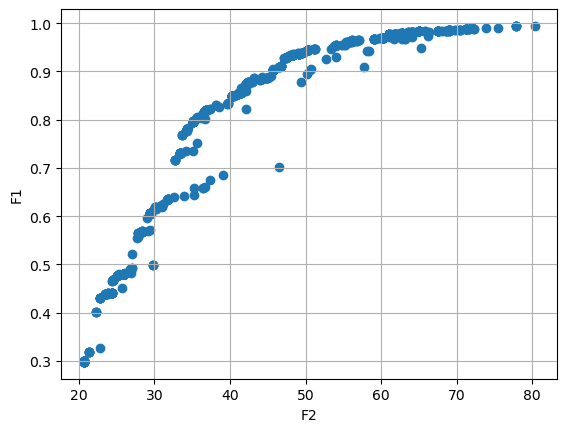

GENERATION :- 10
[[0.9944665858287712, 80.33334015721175], [0.8192308633429951, 36.80211754882438], [0.9892511539528988, 72.06767628014], [0.8062242999168663, 36.25777801645268], [0.9087415737733668, 46.4807846321229], [0.7972299067385864, 35.146608585130025], [0.6400765590295375, 32.617018191244654], [0.4684932068763278, 24.51546786317799], [0.6184788746702036, 30.133154811152316], [0.9660317599916814, 57.03115255266998], [0.9781947810985611, 61.851420228702196], [0.48058573909391583, 25.997367213612584], [0.9441620970718332, 50.26927815861389], [0.6400765590295375, 32.617018191244654], [0.29914222353524966, 20.711996573276235], [0.8732401466874766, 42.115480573337905], [0.5688356619635652, 28.41633067448452], [0.9441771008248419, 50.27358124716428], [0.47777880706219955, 25.21890611966327], [0.4993257301427491, 29.790163828653963], [0.4684932068763278, 24.51546786317799], [0.48058573909391583, 25.997367213612584], [0.9460323062644335, 51.226491165999896], [0.4778057040244229, 25.2230

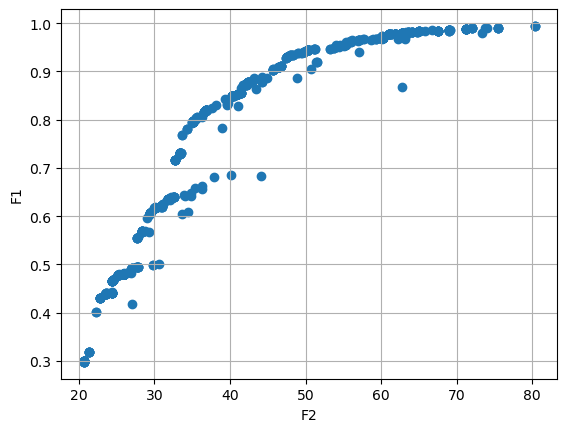

GENERATION :- 11
[[0.8732401466874766, 42.115480573337905], [0.9815261612161229, 64.10226186338733], [0.4778057040244229, 25.223044363349665], [0.978618803200801, 61.981814590449815], [0.48058573909391583, 25.997367213612584], [0.8732401466874766, 42.115480573337905], [0.8771372210444984, 42.39353787112979], [0.6057873218158177, 29.375526021990922], [0.7958497228336168, 35.08614419083653], [0.48058573909391583, 25.997367213612584], [0.8718241078225322, 41.780130464221806], [0.8732401466874766, 42.115480573337905], [0.8217315208824254, 37.44394658232632], [0.5688356619635652, 28.41633067448452], [0.4820352450373194, 26.315858852826203], [0.4674457175237722, 24.43644485616204], [0.46616350011580765, 24.377267960827016], [0.6123146274597319, 29.977815038830123], [0.48058573909391583, 25.997367213612584], [0.6400765590295375, 32.617018191244654], [0.9444248796036063, 50.3492682401822], [0.4684932068763278, 24.51546786317799], [0.9295481588860822, 47.502714527821794], [0.9087415737733668, 4

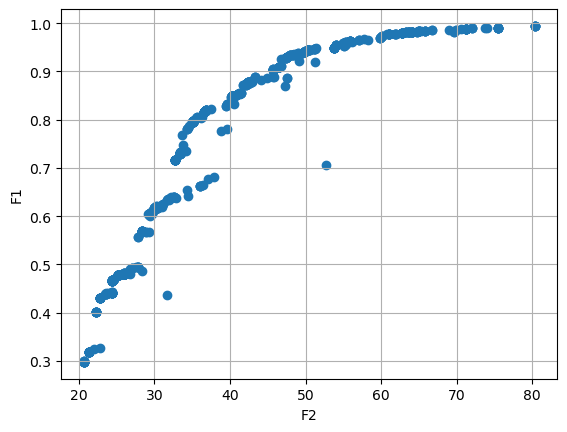

GENERATION :- 12
[[0.8732401466874766, 42.115480573337905], [0.8783564407799608, 42.889638578736836], [0.7958497228336168, 35.08614419083653], [0.8487078090381078, 40.3150895836897], [0.7157515179139339, 32.731856093382376], [0.7978510100510819, 35.180254541322896], [0.8487078090381078, 40.3150895836897], [0.8760215058767281, 42.248655845175925], [0.47882602897294585, 25.279139721653795], [0.8192308633429951, 36.80211754882438], [0.9444248796036063, 50.3492682401822], [0.9289727390166207, 47.4590950669905], [0.7978861975052572, 45.45982016932926], [0.8487078090381078, 40.3150895836897], [0.48058573909391583, 25.997367213612584], [0.9832591063512429, 64.97705418747249], [0.7299378120377973, 33.43529434986766], [0.9441771008248419, 50.27358124716428], [0.47777880706219955, 25.21890611966327], [0.6400765590295375, 32.617018191244654], [0.9295481588860822, 47.502714527821794], [0.48058573909391583, 25.997367213612584], [0.3185226539608223, 21.330230944933117], [0.4778057040244229, 25.22304

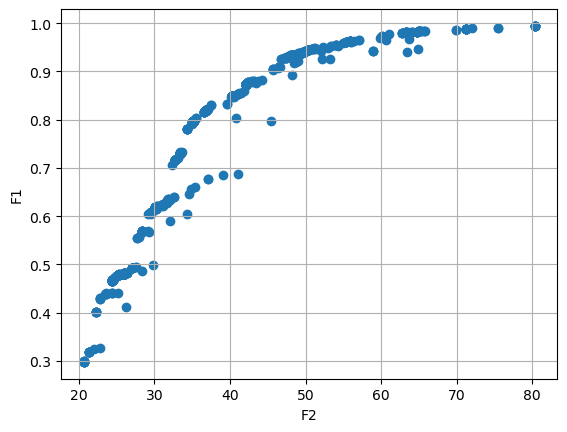

GENERATION :- 13
[[0.8711201303156496, 41.776340622079715], [0.46616350011580765, 24.377267960827016], [0.9331670994783376, 47.937730460642186], [0.8487078090381078, 40.3150895836897], [0.9832591063512429, 64.97705418747249], [0.7958497228336168, 35.08614419083653], [0.8732401466874766, 42.115480573337905], [0.9338198902793302, 48.13629359581725], [0.490556673789571, 26.914356453320295], [0.7299378120377973, 33.43529434986766], [0.9832591063512429, 64.97705418747249], [0.47777880706219955, 25.21890611966327], [0.9826288695050421, 64.72112361976944], [0.9441771008248419, 50.27358124716428], [0.7972299067385864, 35.146608585130025], [0.4802438508185703, 25.829040465300224], [0.8732401466874766, 42.115480573337905], [0.42868205967897777, 22.820073671274933], [0.7157515179139339, 32.731856093382376], [0.7299378120377973, 33.43529434986766], [0.7157515179139339, 32.731856093382376], [0.9751679610370643, 63.06787020173496], [0.9826288695050421, 64.72112361976944], [0.8732401466874766, 42.115

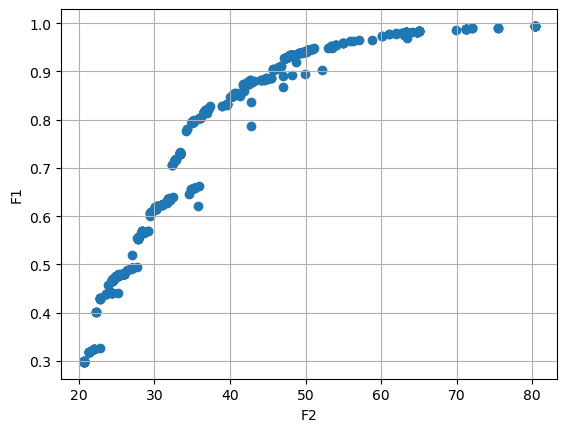

GENERATION :- 14
[[0.7101729935272704, 32.31265196797443], [0.9331670994783376, 47.937730460642186], [0.617794110357229, 30.0789642784762], [0.4296928133169326, 22.864618022209118], [0.6189705301447518, 30.453268612951245], [0.3249845414098979, 22.068230640245524], [0.9444248796036063, 50.3492682401822], [0.6192837013113701, 30.187186377287382], [0.994400404621078, 80.50106146489117], [0.6072137790527, 29.479609877115706], [0.7958497228336168, 35.08614419083653], [0.47777880706219955, 25.21890611966327], [0.47914998210100995, 25.29649139223157], [0.47777880706219955, 25.21890611966327], [0.4762288546484073, 25.081631107415188], [0.8157906875944693, 36.630014174888586], [0.8771372210444984, 42.39353787112979], [0.47777880706219955, 25.21890611966327], [0.4674457175237722, 24.43644485616204], [0.4778057040244229, 25.223044363349665], [0.6215923083591856, 30.356833550010776], [0.4773305396859465, 25.154042774795766], [0.7958497228336168, 35.08614419083653], [0.47777880706219955, 25.218906

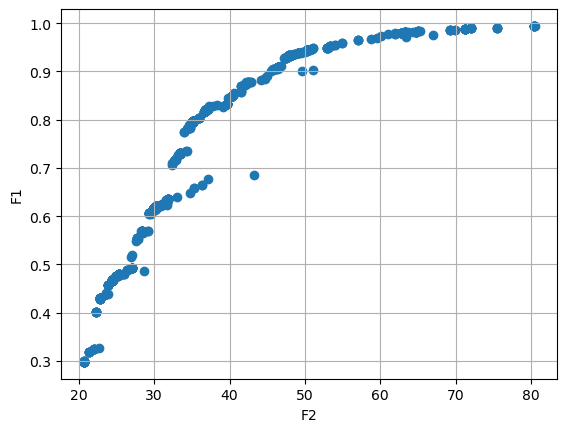

GENERATION :- 15
[[0.7294859573205322, 33.391674889036366], [0.47781377353034643, 25.224291794170142], [0.6178045853231747, 30.00469914190402], [0.9347013220481272, 48.19755617096053], [0.49033675565414436, 26.79546977417186], [0.9087415737733668, 46.4807846321229], [0.9875076481327327, 71.19288395605484], [0.8869829305146141, 44.88634729268039], [0.706543700152637, 32.312624375414096], [0.7972299067385864, 35.146608585130025], [0.9331670994783376, 47.937730460642186], [0.4773305396859465, 25.154042774795766], [0.2976381054338587, 20.685220533013066], [0.6192837013113701, 30.187186377287382], [0.7958497228336168, 35.08614419083653], [0.6192488401739257, 30.18304813360099], [0.619019827199869, 30.153704918844795], [0.42868205967897777, 22.820073671274933], [0.6090318582961931, 29.55109078828319], [0.29914222353524966, 20.711996573276235], [0.7324451241540758, 33.3915573489613], [0.7299378120377973, 33.43529434986766], [0.47964517923323646, 25.369898990737294], [0.9875076481327327, 71.19

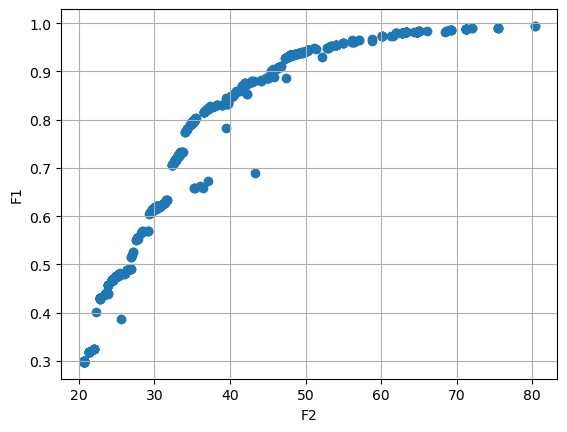

GENERATION :- 16
[[0.7799564164615159, 34.329919727052165], [0.7907403932291718, 34.79731992197575], [0.6192488401739257, 30.18304813360099], [0.798615264327816, 35.22732183583523], [0.6192837013113701, 30.187186377287382], [0.4578285021779944, 23.84992207765442], [0.8487078090381078, 40.3150895836897], [0.9389102829025352, 49.12762899352626], [0.9331670994783376, 47.937730460642186], [0.42701738357823465, 22.792984829922506], [0.6190122191902195, 30.11376979764794], [0.4778057040244229, 25.223044363349665], [0.5579441707647892, 27.86625648671942], [0.9799569195840463, 62.81486697155447], [0.9441771008248419, 50.27358124716428], [0.9529163934448842, 53.328090638436606], [0.8157950938120856, 36.53689315659208], [0.9450865210901593, 50.61092236262235], [0.6137625036131406, 29.742356493863777], [0.7972299067385864, 35.146608585130025], [0.3248358170364264, 22.033669201418398], [0.8231154868244736, 37.09954110715181], [0.9799569195840463, 62.81486697155447], [0.7930145549549661, 34.9276252

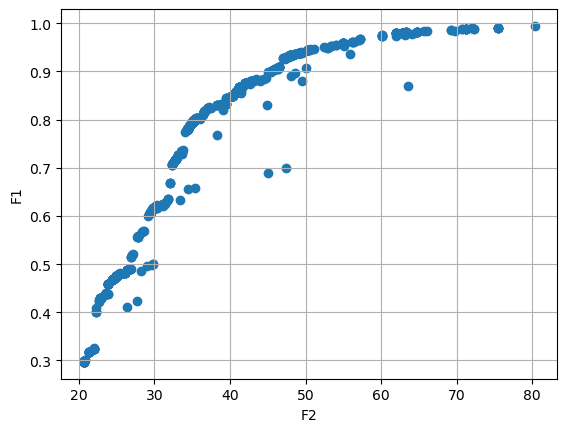

GENERATION :- 17
[[0.555616292322213, 27.724676181022048], [0.3247835415353311, 22.022002978470653], [0.7928548492577117, 34.90769587061229], [0.8957804575251688, 50.05173509961632], [0.8007426066867446, 35.364013462371105], [0.7929152949561027, 34.91904916596109], [0.7803824349902952, 34.38270593435125], [0.961104420219025, 56.2509645444963], [0.4778057040244229, 25.223044363349665], [0.9884075686907124, 71.27596805735745], [0.46900004113532107, 24.514140726871148], [0.8487078090381078, 40.3150895836897], [0.931178233236971, 47.83814574746654], [0.617794110357229, 30.0789642784762], [0.7187531894117797, 33.00330034682872], [0.4778057040244229, 25.223044363349665], [0.45773379590236873, 23.845816197418976], [0.9598533610809472, 54.96227713393253], [0.4773305396859465, 25.154042774795766], [0.4578285021779944, 23.84992207765442], [0.4578285021779944, 23.84992207765442], [0.8726995832681294, 42.07186111250661], [0.3018759681204612, 20.764753324239535], [0.48009061538358455, 25.4423279795

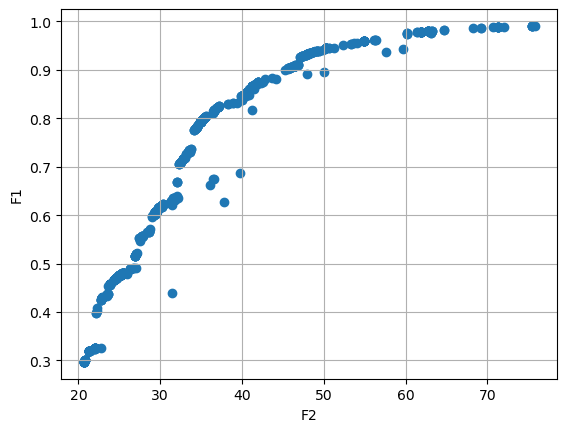

GENERATION :- 18
[[0.6292397518309331, 31.404477656682843], [0.4674457175237722, 24.43644485616204], [0.7157515179139339, 32.731856093382376], [0.4759003265848, 24.98280657957217], [0.6065625687592737, 29.401453236024757], [0.7299378120377973, 33.43529434986766], [0.8696379444238229, 41.56316487545719], [0.9550586858410004, 53.79063675301283], [0.6191491850813374, 30.171381910653245], [0.4578285021779944, 23.84992207765442], [0.4773305396859465, 25.154042774795766], [0.7977821048786163, 35.19561372046819], [0.9598533610809472, 54.96227713393253], [0.9906724766018734, 75.79474244827486], [0.9441771008248419, 50.27358124716428], [0.9331670994783376, 47.937730460642186], [0.4296928133169326, 22.864618022209118], [0.4296928133169326, 22.864618022209118], [0.780942097370688, 34.414110800597015], [0.46616350011580765, 24.377267960827016], [0.675949727128069, 36.65780391103385], [0.4296928133169326, 22.864618022209118], [0.4672626281128521, 24.4218123117612], [0.45773379590236873, 23.84581619

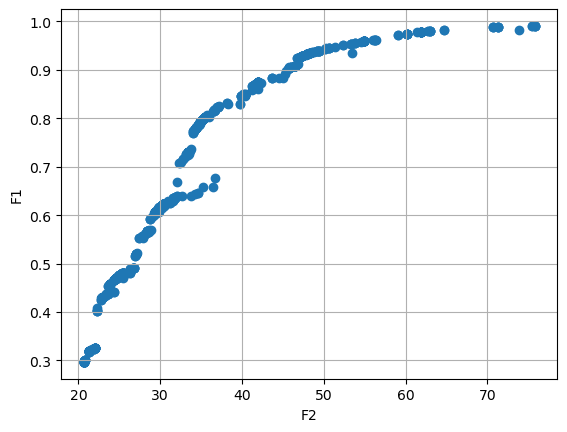

GENERATION :- 19
[[0.901980967925268, 45.624250667389916], [0.2976381054338587, 20.685220533013066], [0.9598533610809472, 54.96227713393253], [0.9025863036679297, 45.63746019330608], [0.8222694362469726, 36.969954352605065], [0.6220252393103931, 30.31290855511901], [0.6137625036131406, 29.742356493863777], [0.5665164748572065, 28.41379232830748], [0.6194169424291676, 30.199702246447657], [0.9550586858410004, 53.79063675301283], [0.7201519580276574, 33.00972536491695], [0.519186244804142, 27.079665769101997], [0.3185226539608223, 21.330230944933117], [0.6079908514827138, 29.50553709114955], [0.60739483048924, 29.43078988579409], [0.4777480019230497, 25.21420328708424], [0.9772153557729745, 61.40395619546371], [0.9826288695050421, 64.72112361976944], [0.7299378120377973, 33.43529434986766], [0.7201519580276574, 33.00972536491695], [0.7999946727962409, 35.29875568370731], [0.4296928133169326, 22.864618022209118], [0.4379381187899164, 23.524436817863105], [0.45773379590236873, 23.845816197

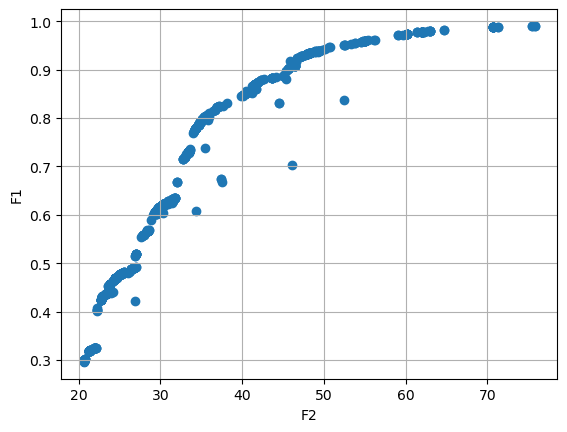

GENERATION :- 20
[[0.4578285021779944, 23.84992207765442], [0.48009061538358455, 25.44232797959556], [0.7299378120377973, 33.43529434986766], [0.4296928133169326, 22.864618022209118], [0.8696379444238229, 41.56316487545719], [0.7288829330890384, 33.33825611109079], [0.2976381054338587, 20.685220533013066], [0.2976381054338587, 20.685220533013066], [0.46900004113532107, 24.514140726871148], [0.9598533610809472, 54.96227713393253], [0.6352991514067093, 31.77193750792098], [0.46841922379260575, 24.469335189690796], [0.2976381054338587, 20.685220533013066], [0.2976381054338587, 20.685220533013066], [0.9397021001286525, 49.36615827026832], [0.4296928133169326, 22.864618022209118], [0.9333599072498875, 47.943579620271564], [0.47775492372537276, 25.14157325306498], [0.4578285021779944, 23.84992207765442], [0.8735880159376723, 41.81621838235638], [0.4778057040244229, 25.223044363349665], [0.6044753793635478, 29.297891569504607], [0.3248358170364264, 22.033669201418398], [0.7157515179139339, 32

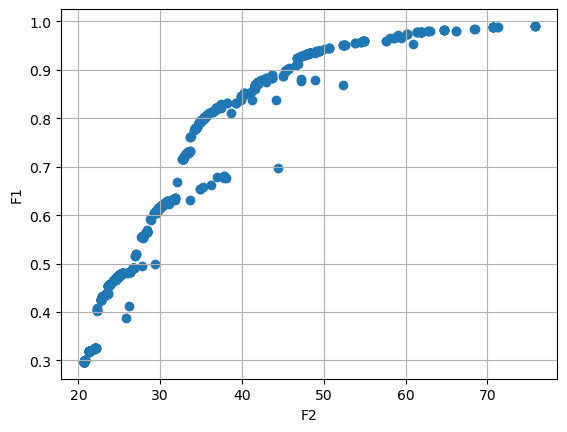

GENERATION :- 21
[[0.4759003265848, 24.98280657957217], [0.2982174519109313, 20.695361214779123], [0.7299912328820805, 33.44068002437453], [0.9811502421879585, 63.572066407365334], [0.9331670994783376, 47.937730460642186], [0.9331670994783376, 47.937730460642186], [0.4674785997616414, 24.437833410691674], [0.4631179342842049, 24.18066773640112], [0.47707352471230563, 25.077149734197558], [0.4759003265848, 24.98280657957217], [0.31941033753584147, 21.388430033706022], [0.2976381054338587, 20.685220533013066], [0.3185226539608223, 21.330230944933117], [0.2976381054338587, 20.685220533013066], [0.42453565005252103, 22.72034050945706], [0.7836254972256361, 34.511053899713104], [0.9334834121086041, 47.967153502249694], [0.3248358170364264, 22.033669201418398], [0.9331670994783376, 47.937730460642186], [0.9623837469490968, 58.05298871683975], [0.9591117990767406, 54.761380064459395], [0.9273086005283234, 47.1840343831355], [0.7803824349902952, 34.38270593435125], [0.5909178805613673, 28.6312

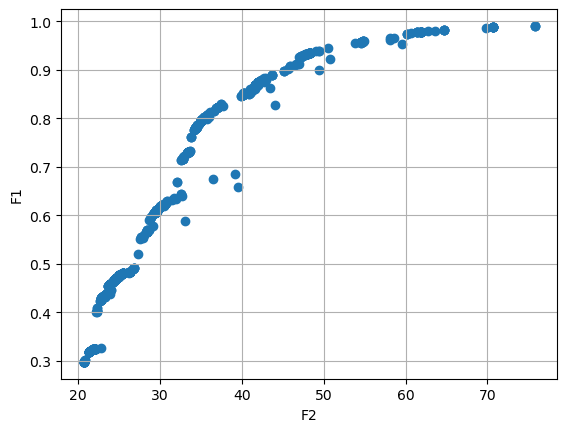

GENERATION :- 22
[[0.9780949618864965, 61.64849980590463], [0.5606532111996316, 28.254328078420485], [0.4296928133169326, 22.864618022209118], [0.6153651324322885, 29.842864738385103], [0.46841922379260575, 24.469335189690796], [0.7799564164615159, 34.329919727052165], [0.4759003265848, 24.98280657957217], [0.7950632933836528, 34.963809883742215], [0.45773379590236873, 23.845816197418976], [0.8974361374751549, 45.19257265748435], [0.9881289072828142, 70.72103311179215], [0.4690927538024207, 24.541395077211828], [0.4759003265848, 24.98280657957217], [0.4690927538024207, 24.541395077211828], [0.582521120509783, 28.23680606408503], [0.47707352471230563, 25.077149734197558], [0.4684932068763278, 24.51546786317799], [0.4759003265848, 24.98280657957217], [0.4079243562992954, 22.30646594750552], [0.46973639382721305, 24.57073172698116], [0.8502981427264688, 40.10619342835815], [0.4759003265848, 24.98280657957217], [0.4368929208069775, 23.38226271567062], [0.46973639382721305, 24.5707317269811

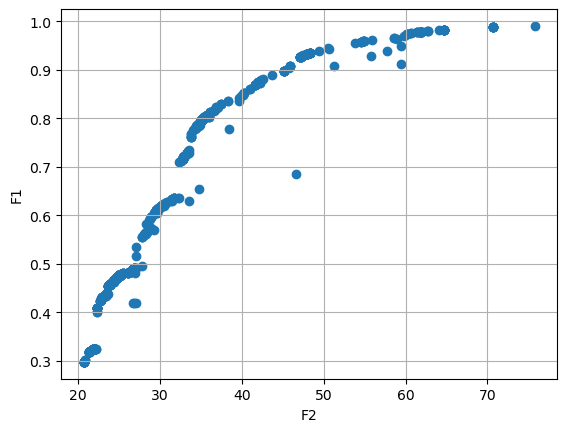

GENERATION :- 23
[[0.42978171784261254, 22.86872390244456], [0.3232830634185733, 21.761498604197676], [0.8245806372003117, 37.142645461978724], [0.9826288695050421, 64.72112361976944], [0.8004545876530745, 35.27762323415131], [0.7299378120377973, 33.43529434986766], [0.6177987143097624, 30.00309770144459], [0.43634093728171897, 23.319636443754767], [0.45790406661491234, 23.84983831660769], [0.9788823682401196, 61.93399385828781], [0.31941033753584147, 21.388430033706022], [0.4352914579002254, 23.271401428724964], [0.9788823682401196, 61.93399385828781], [0.4759003265848, 24.98280657957217], [0.7950632933836528, 34.963809883742215], [0.7624601786764785, 33.71305426859224], [0.9577003137475055, 54.499731019356304], [0.43570709958438736, 23.2555259198217], [0.7624601786764785, 33.71305426859224], [0.8461152045069998, 39.87247099449357], [0.7624601786764785, 33.71305426859224], [0.3177640051532123, 21.28515135255406], [0.7799564164615159, 34.329919727052165], [0.9881289072828142, 70.721033

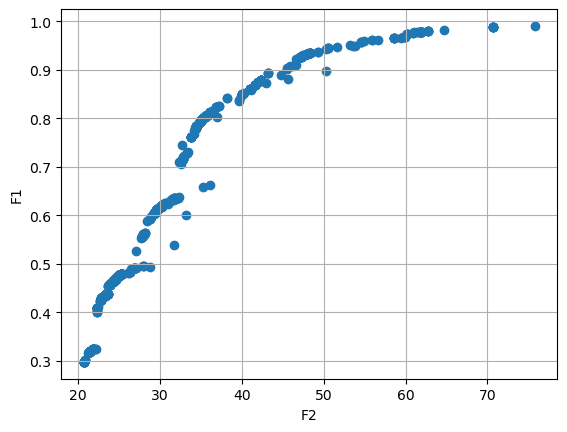

GENERATION :- 24
[[0.43570709958438736, 23.2555259198217], [0.795551974288267, 34.98871722697092], [0.4750573631471719, 24.90992528223285], [0.943850626924483, 50.27962031583134], [0.7624601786764785, 33.71305426859224], [0.46973639382721305, 24.57073172698116], [0.45773379590236873, 23.845816197418976], [0.4717954905659831, 24.741243107917406], [0.45773379590236873, 23.845816197418976], [0.6022162500686833, 29.13823821058233], [0.3018759681204612, 20.764753324239535], [0.6225042812311516, 30.35143946704038], [0.9788823682401196, 61.93399385828781], [0.9667607946683212, 58.608190602476576], [0.45773379590236873, 23.845816197418976], [0.8494878573934549, 40.02670632638284], [0.9089805589414136, 46.26469198433314], [0.32345077475664863, 21.785249366478766], [0.46777345759645833, 24.459985571192494], [0.41060574450039966, 22.361532261186696], [0.6065625687592737, 29.401453236024757], [0.6155338004664588, 29.847657388722777], [0.4236313620733789, 22.68286024166641], [0.31941033753584147, 2

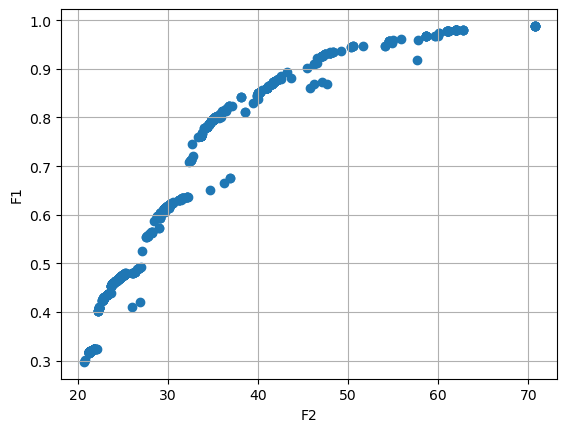

GENERATION :- 25
[[0.47574164301360355, 24.970486284723638], [0.6216109147181973, 30.27901135657922], [0.7667770346635601, 33.79789280569922], [0.4697343162757761, 24.56507058361102], [0.48305741316202183, 26.30899502269647], [0.47029837268135016, 24.664299184878363], [0.9881289072828142, 70.72103311179215], [0.6214756722561766, 30.27660167548945], [0.3193678811725585, 21.385494808736286], [0.47574164301360355, 24.970486284723638], [0.3177640051532123, 21.28515135255406], [0.6193077969877299, 30.131466480475904], [0.46835741007230197, 24.484804077101817], [0.4079243562992954, 22.30646594750552], [0.9089805589414136, 46.26469198433314], [0.9269149862046108, 47.05221777787807], [0.46871909436543013, 24.493097274494843], [0.4262610181524305, 22.78480603867895], [0.45773379590236873, 23.845816197418976], [0.4079243562992954, 22.30646594750552], [0.4661160910195692, 24.370392367953425], [0.47610531729924355, 25.014831954709674], [0.43761994132943355, 23.351876903815196], [0.4759003265848, 2

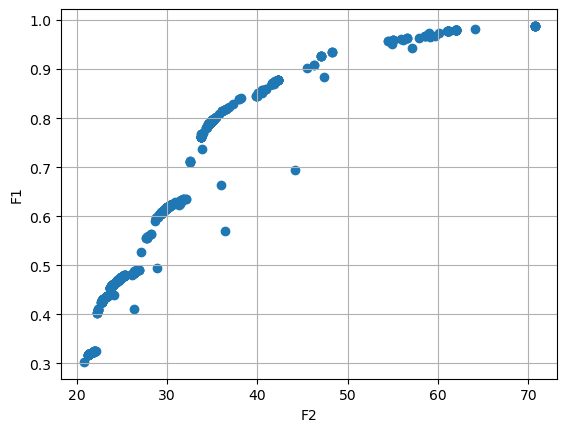

GENERATION :- 26
[[0.6034279827061574, 29.16973998958145], [0.42877170459285135, 22.823874289244653], [0.32345077475664863, 21.785249366478766], [0.4787809837162136, 25.225868904522518], [0.6116400547831228, 29.58008992798298], [0.6089763713941637, 29.416835478399047], [0.87851797143753, 42.292355742618255], [0.6337988273242388, 31.487513389267125], [0.6769905085581039, 38.06139917597248], [0.31947626070238644, 21.393020278678485], [0.5601644670203058, 27.895834421211198], [0.31941033753584147, 21.388430033706022], [0.32359975112557543, 21.80723983478393], [0.6299120214301546, 31.27089038080861], [0.4661160910195692, 24.370392367953425], [0.87851797143753, 42.292355742618255], [0.46666633241542155, 24.37844501048031], [0.7895852130494669, 34.70415263120223], [0.6214756722561766, 30.27660167548945], [0.977223172520425, 61.05206114430476], [0.4680748592981978, 24.458509098612232], [0.8455149839413469, 39.846598291226286], [0.47780797414267595, 25.136539227571213], [0.48740464846051945, 2

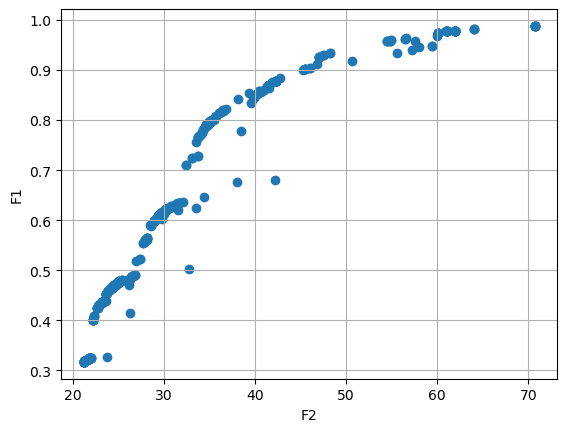

GENERATION :- 27
[[0.8662492194855848, 41.34413499959628], [0.6165042903046187, 29.907630737595092], [0.795551974288267, 34.98871722697092], [0.48858868558518215, 26.564417387221404], [0.6050888299160717, 29.244651142683672], [0.31777406397480684, 21.28572428488588], [0.46664470747970255, 24.413797270688924], [0.4650298513900687, 24.322825087269788], [0.31941033753584147, 21.388430033706022], [0.6125352232717426, 29.653419746485262], [0.6172328512331204, 29.95842967154791], [0.4787809837162136, 25.225868904522518], [0.45875061119025795, 23.891235501573785], [0.5962967670975503, 28.78623002663922], [0.7703224296531334, 33.963700214065], [0.46900004113532107, 24.514140726871148], [0.3237473060416902, 21.829917396375446], [0.3229809235995487, 21.7211388425457], [0.56615065173209, 29.02863023469229], [0.32345077475664863, 21.785249366478766], [0.8579107652867738, 40.8003882034169], [0.6089763713941637, 29.416835478399047], [0.3185226539608223, 21.330230944933117], [0.6159440744575078, 29.8

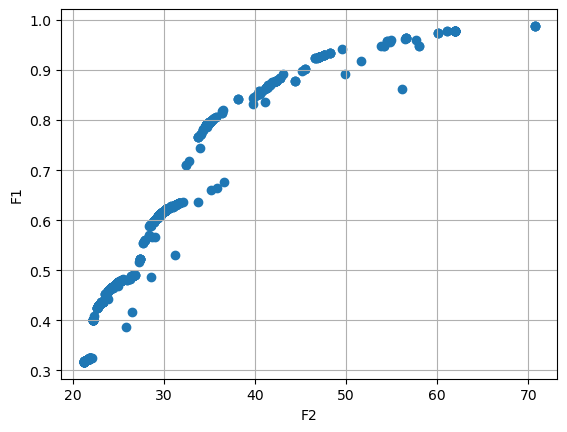

GENERATION :- 28
[[0.6140383179444031, 29.751831022203646], [0.9661130109310972, 59.17237835963581], [0.3237473060416902, 21.829917396375446], [0.9788823682401196, 61.93399385828781], [0.4793866550906778, 25.28849517643837], [0.46409523928296187, 24.193170615815024], [0.6116400547831228, 29.58008992798298], [0.795551974288267, 34.98871722697092], [0.47994487434556, 25.374927800029663], [0.4661160910195692, 24.370392367953425], [0.47574164301360355, 24.970486284723638], [0.4692492196373731, 24.55371537206036], [0.43570709958438736, 23.2555259198217], [0.4750505710518229, 24.90637576079057], [0.7950423341907752, 35.000535920256624], [0.4015191801394671, 22.219607610289067], [0.4790673405873068, 25.25459797789858], [0.47969861790205093, 25.31234968301559], [0.9654506564947033, 59.23906635739571], [0.4677588029882114, 24.458876863067978], [0.6347825745767812, 31.69918047186688], [0.4015191801394671, 22.219607610289067], [0.45773379590236873, 23.845816197418976], [0.4553339897925631, 23.730

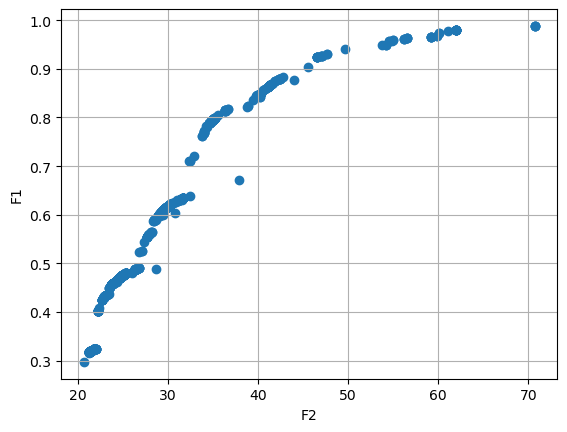

GENERATION :- 29
[[0.3237473060416902, 21.829917396375446], [0.46871909436543013, 24.493097274494843], [0.9046092081633864, 45.596758189754], [0.47602618206794256, 24.9992153580997], [0.32345077475664863, 21.785249366478766], [0.6161694434519188, 29.88492542340724], [0.617562977151541, 29.9815373146106], [0.6131463534270607, 29.68772049827058], [0.6155338004664588, 29.847657388722777], [0.47471133809419497, 24.892851832237323], [0.45875061119025795, 23.891235501573785], [0.8662492194855848, 41.34413499959628], [0.46900004113532107, 24.514140726871148], [0.7674181974742318, 33.95319507114186], [0.46409523928296187, 24.193170615815024], [0.7971496025443536, 35.0915606291317], [0.32345077475664863, 21.785249366478766], [0.47474958810820866, 24.890144522332537], [0.48090825969054535, 25.48594232399223], [0.47173138025040157, 24.72925006799738], [0.47707352471230563, 25.077149734197558], [0.32425663103895275, 21.916166658446635], [0.6190801863849923, 30.08723430637309], [0.45897166068278555

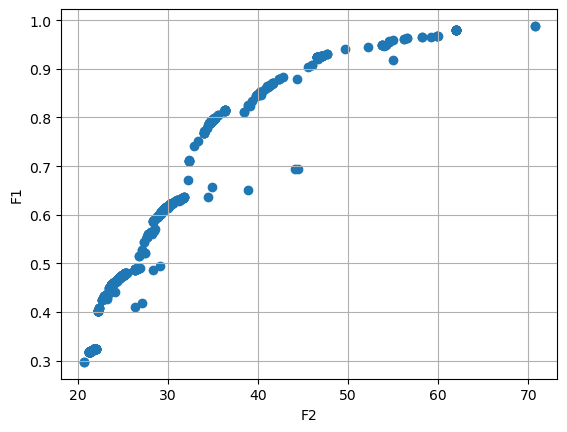

GENERATION :- 30
[[0.4787809837162136, 25.225868904522518], [0.3237473060416902, 21.829917396375446], [0.48820049275328714, 26.43602437498282], [0.32271247401928044, 21.687615123993563], [0.43223631601651835, 22.954091183589355], [0.32425663103895275, 21.916166658446635], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.3238599490596834, 21.84787563839462], [0.3179929569450147, 21.29835057420933], [0.4781970106784907, 25.171497000312133], [0.3237473060416902, 21.829917396375446], [0.3177640051532123, 21.28515135255406], [0.8145017477716904, 36.37427436709449], [0.46409523928296187, 24.193170615815024], [0.6214756722561766, 30.27660167548945], [0.3237473060416902, 21.829917396375446], [0.47707352471230563, 25.077149734197558], [0.4781970106784907, 25.171497000312133], [0.32345077475664863, 21.785249366478766], [0.4877165880732574, 26.387516666359385], [0.6214756722561766, 30.27660167548945], [0.4654037694978835, 24.36346089088048], [0.474320747649

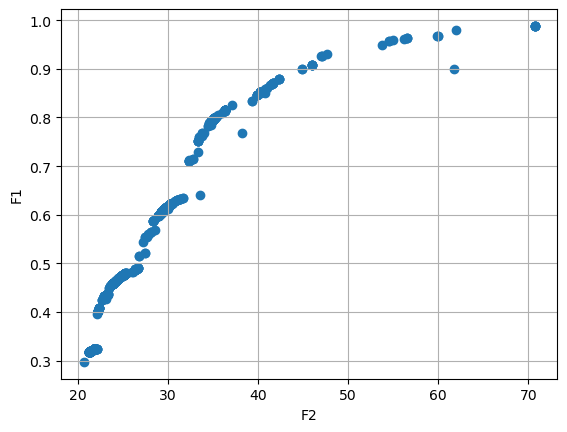

GENERATION :- 31
[[0.46871909436543013, 24.493097274494843], [0.46871909436543013, 24.493097274494843], [0.47963394700351103, 25.32403420004334], [0.45773379590236873, 23.845816197418976], [0.9621988625585256, 56.219987771332676], [0.4351647253377572, 23.20605521862623], [0.6144055716521278, 29.78056009557971], [0.4787809837162136, 25.225868904522518], [0.3238599490596834, 21.84787563839462], [0.3237473060416902, 21.829917396375446], [0.3177640051532123, 21.28515135255406], [0.3237473060416902, 21.829917396375446], [0.4787809837162136, 25.225868904522518], [0.8579092168982771, 40.740128522046], [0.4589484318323945, 23.901080061222146], [0.46871909436543013, 24.493097274494843], [0.7979088463406804, 35.112529054067174], [0.6312755050379258, 31.291481520264156], [0.32371627935662667, 21.82507129159437], [0.9078692234196383, 45.97326225276856], [0.47780797414267595, 25.136539227571213], [0.4776238785601478, 25.119928857448418], [0.48820049275328714, 26.43602437498282], [0.4785030573910007

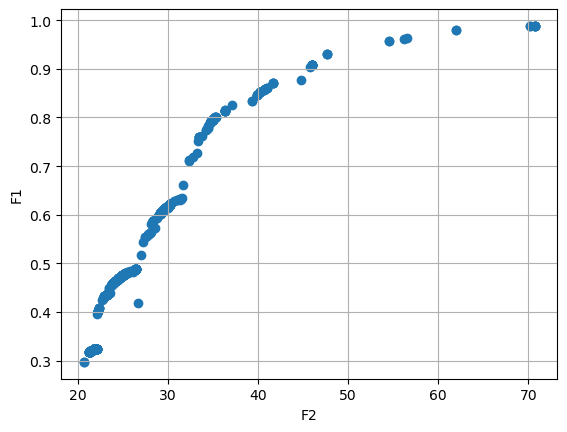

GENERATION :- 32
[[0.46871909436543013, 24.493097274494843], [0.3177640051532123, 21.28515135255406], [0.3238599490596834, 21.84787563839462], [0.7983149096003616, 35.149896983536834], [0.6027960394251067, 29.292269202868546], [0.3237473060416902, 21.829917396375446], [0.4907561600587974, 26.82418923334667], [0.46871909436543013, 24.493097274494843], [0.4787809837162136, 25.225868904522518], [0.9056817003313232, 49.78131440750333], [0.6311520608205297, 31.043141005588446], [0.46871909436543013, 24.493097274494843], [0.6326826235636698, 31.392858014104128], [0.6102508288481765, 29.500646957788405], [0.6311520608205297, 31.043141005588446], [0.5633587316896156, 27.966512145651585], [0.4654272087877537, 24.30166570711101], [0.6323044449630233, 31.364128940728065], [0.3237473060416902, 21.829917396375446], [0.45773379590236873, 23.845816197418976], [0.4768261589755872, 25.05339897191647], [0.478314157674881, 25.19087991976185], [0.4781970106784907, 25.171497000312133], [0.6466255959017367,

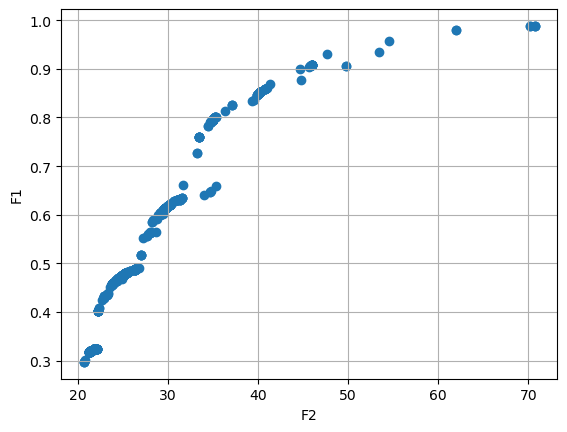

GENERATION :- 33
[[0.3193185008144042, 21.382101334506814], [0.47780797414267595, 25.136539227571213], [0.47521450227886874, 24.944832136973023], [0.4082114411600286, 22.314092953451425], [0.5633587316896156, 27.966512145651585], [0.4351511713513785, 23.204874608914373], [0.3177640051532123, 21.28515135255406], [0.47780797414267595, 25.136539227571213], [0.4796645920177684, 25.309076024056086], [0.46871909436543013, 24.493097274494843], [0.32345077475664863, 21.785249366478766], [0.4835417195533005, 25.74078288834149], [0.3238599490596834, 21.84787563839462], [0.4787809837162136, 25.225868904522518], [0.6174996660309362, 29.98111458810233], [0.31947626070238644, 21.393020278678485], [0.4015191801394671, 22.219607610289067], [0.47780797414267595, 25.136539227571213], [0.47780797414267595, 25.136539227571213], [0.43075090015089934, 22.873354720902682], [0.3193185008144042, 21.382101334506814], [0.7756149031988443, 34.0831875359856], [0.30218333592765473, 20.771054964938564], [0.457733795

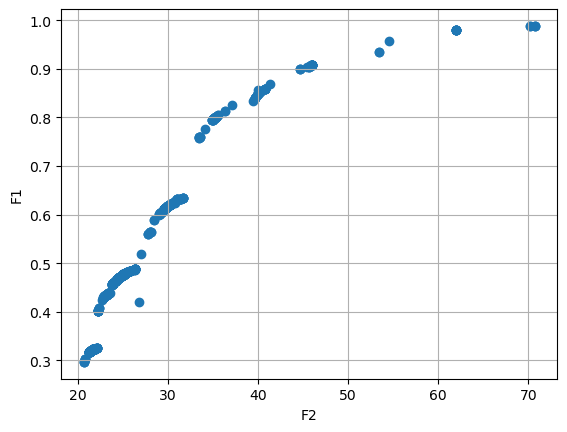

GENERATION :- 34
[[0.7939083683146216, 34.89969935980915], [0.46871909436543013, 24.493097274494843], [0.3237473060416902, 21.829917396375446], [0.47602618206794256, 24.9992153580997], [0.46871909436543013, 24.493097274494843], [0.3238599490596834, 21.84787563839462], [0.4748867461141897, 24.910423777309372], [0.46871909436543013, 24.493097274494843], [0.46973639382721305, 24.57073172698116], [0.6038319005638234, 29.1555289655935], [0.32345077475664863, 21.785249366478766], [0.3238599490596834, 21.84787563839462], [0.32345077475664863, 21.785249366478766], [0.48952453611810226, 26.641657937795117], [0.3238599490596834, 21.84787563839462], [0.32345077475664863, 21.785249366478766], [0.4736277737366333, 24.79521758975212], [0.46871909436543013, 24.493097274494843], [0.4736392842424059, 24.796168379348746], [0.3174495607175937, 21.267551831558162], [0.43292506408344, 22.973698177084906], [0.43075090015089934, 22.873354720902682], [0.32271247401928044, 21.687615123993563], [0.4687190943654

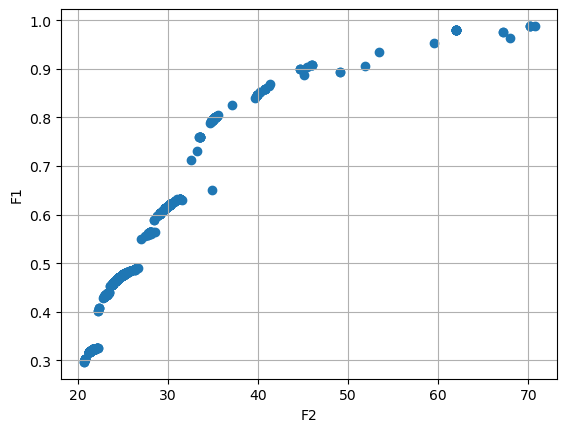

GENERATION :- 35
[[0.4778122507686258, 25.13965966030646], [0.4796645920177684, 25.309076024056086], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.4836281081968281, 25.749081110868232], [0.7979088463406804, 35.112529054067174], [0.32345077475664863, 21.785249366478766], [0.3237473060416902, 21.829917396375446], [0.3193185008144042, 21.382101334506814], [0.32345077475664863, 21.785249366478766], [0.32425663103895275, 21.916166658446635], [0.46871909436543013, 24.493097274494843], [0.4787809837162136, 25.225868904522518], [0.3229809235995487, 21.7211388425457], [0.6145496686824611, 29.805353582672936], [0.45773379590236873, 23.845816197418976], [0.47305741715326993, 24.750474555400505], [0.4778200324228781, 25.143469624102824], [0.43075090015089934, 22.873354720902682], [0.43075090015089934, 22.873354720902682], [0.3193678811725585, 21.385494808736286], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.3225

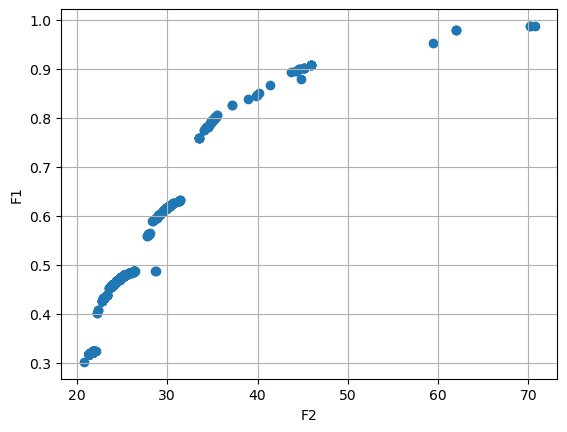

GENERATION :- 36
[[0.31947626070238644, 21.393020278678485], [0.4796645920177684, 25.309076024056086], [0.5562474989127355, 27.566757587909102], [0.3238599490596834, 21.84787563839462], [0.4335953576514269, 23.008939837156177], [0.4787809837162136, 25.225868904522518], [0.46350207967460927, 24.167243401781185], [0.7928266590258614, 34.89995690807286], [0.8465288268873721, 39.61767318885208], [0.7941239875737215, 34.91050506285712], [0.3193678811725585, 21.385494808736286], [0.6110684169945354, 29.539730166331], [0.46350207967460927, 24.167243401781185], [0.48423991131972466, 25.811707382784082], [0.32345077475664863, 21.785249366478766], [0.4870081210633531, 26.323406142426318], [0.32345077475664863, 21.785249366478766], [0.43075090015089934, 22.873354720902682], [0.4589484318323945, 23.901080061222146], [0.9003061708498152, 44.627897022948346], [0.3193185008144042, 21.382101334506814], [0.4772407634118693, 25.09280465184068], [0.31947626070238644, 21.393020278678485], [0.6247564449200

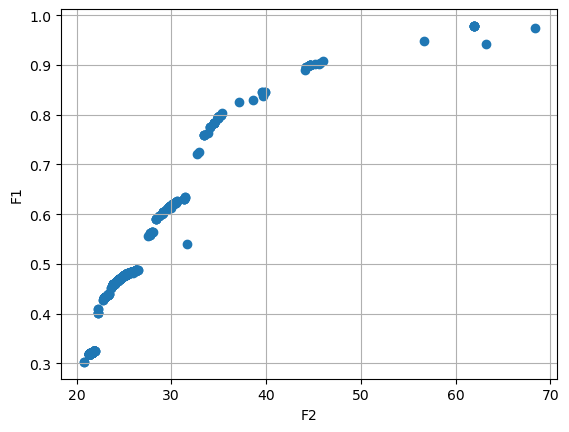

GENERATION :- 37
[[0.4589484318323945, 23.901080061222146], [0.32345077475664863, 21.785249366478766], [0.4736277737366333, 24.79521758975212], [0.32345077475664863, 21.785249366478766], [0.31911432781936205, 21.368297980416106], [0.32345077475664863, 21.785249366478766], [0.3193678811725585, 21.385494808736286], [0.4835417195533005, 25.74078288834149], [0.4589484318323945, 23.901080061222146], [0.4378227908632842, 23.309342210894318], [0.32345077475664863, 21.785249366478766], [0.3193678811725585, 21.385494808736286], [0.4787809837162136, 25.225868904522518], [0.45773379590236873, 23.845816197418976], [0.3231135944133008, 21.738496774251523], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.31947626070238644, 21.393020278678485], [0.47439120336745205, 24.86215694348091], [0.32271247401928044, 21.687615123993563], [0.6012408655839818, 29.019788230561353], [0.6154564624684575, 29.85070037634732], [0.32345077475664863, 21.785249366478766], [0.31936

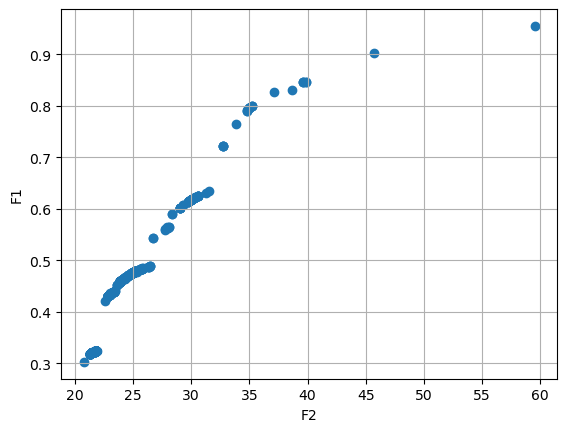

GENERATION :- 38
[[0.32345077475664863, 21.785249366478766], [0.4589484318323945, 23.901080061222146], [0.43075090015089934, 22.873354720902682], [0.43075090015089934, 22.873354720902682], [0.3237762346783036, 21.834474253017834], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.4589484318323945, 23.901080061222146], [0.43075090015089934, 22.873354720902682], [0.43075090015089934, 22.873354720902682], [0.3193678811725585, 21.385494808736286], [0.3235309887409236, 21.796980958348996], [0.3193678811725585, 21.385494808736286], [0.4589484318323945, 23.901080061222146], [0.32345077475664863, 21.785249366478766], [0.3193678811725585, 21.385494808736286], [0.46541799015231544, 24.27232934897384], [0.4589484318323945, 23.901080061222146], [0.6190901984292431, 30.09092327139642], [0.3177640051532123, 21.28515135255406], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.4782

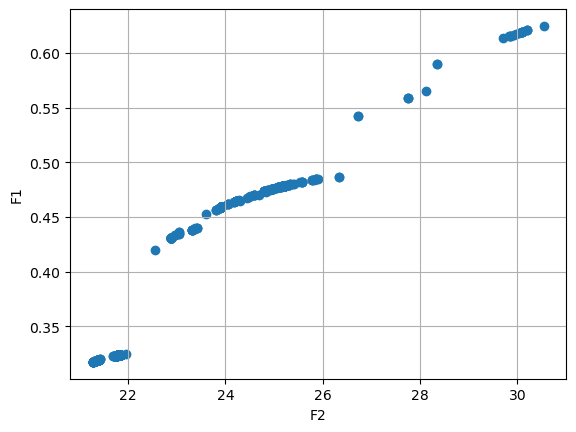

GENERATION :- 39
[[0.32345077475664863, 21.785249366478766], [0.3177640051532123, 21.28515135255406], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.3229809235995487, 21.7211388425457], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766], [0.32345077475664863, 21.785249366478766]

In [118]:
#Main Function

population_size = 1000
number_of_variables = 4
variable_upper_bound = [] 
variable_lower_bound = []
for i in range(number_of_variables):
    variable_upper_bound.append(10)
    variable_lower_bound.append(1)
    
# print(variable_lower_bound)
# print(variable_upper_bound)

threshold = population_size*0.8

print(f'Threshold = {threshold}')

population = Generate_population_2(population_size, number_of_variables, variable_upper_bound, variable_lower_bound)

for i in range(100):
    print(f"GENERATION :- {i+1}")
    counter = 0
    first_counter = 0
    function_values = Function_values_2(population)
    print(function_values)
    
    first_value = function_values[0] # Get the first element of the first sublist
    first_f1_point = first_value[0]
    
    for sublist in function_values:
        if sublist == first_value:
                first_counter += 1
        for value in sublist:
            if value == first_f1_point:
                counter += 1 # Found different value
    
    if counter >= threshold or first_counter >= threshold:
        print(f"Convergence reached after {i+1} generations as there are {threshold} same values")
        break
    
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation_2(function_values)
    #print(pareto_optimal_front_values)
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    #print(crowding_distance_calculation_values)
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                population_size, population)
    population = final_selected_values
    offspring_population = Crossover4(population, lows=variable_lower_bound, highs=variable_upper_bound)
    offspring_population = Mutation(offspring_population,  lows=variable_lower_bound, highs=variable_upper_bound)
    population = New_generations_2(population, offspring_population)
    #print(population)
    x = []
    y = []
    for i in function_values:
        x.append(i[0])
        y.append(i[1])
    #plt.figure(figsize=(8, 6))
    #plt.xlim(50, 300)  # Limit x-axis from 0 to 6
    #plt.ylim(0.9, 0.99)  # Limit y-axis from 0 to 6

    plt.scatter(y,x)
    plt.ylabel("F1")
    plt.xlabel("F2")
    plt.grid()
    plt.show()

Threshold = 800.0
r: [0.97467409 0.68160627 0.70623893 0.96490262]
GENERATION :- 1
[[0.8417310173324316, 135.36460719590914], [0.9419064549822458, 206.68454732458855], [0.84700862198681, 272.9990513102127], [0.9627895082522666, 166.2493784423963], [0.8080368707760188, 262.7590190312932], [0.9773968102026688, 252.39215450833294], [0.7451902449454233, 97.84718824423163], [0.8689128009164707, 107.12037828641452], [0.7459654083594951, 111.26607658475444], [0.6934578477400012, 185.71798372040251], [0.8066815090047565, 125.25903443312237], [0.8302473333267114, 121.98385038955409], [0.750338149658109, 295.5410219943178], [0.9712817979605389, 262.7444596939262], [0.9779277631445481, 231.6517738678732], [0.9540274297467969, 107.24907458448529], [0.8113023482750644, 97.11110935249047], [0.8467864115596863, 147.44671488662098], [0.7016737961482522, 68.89287967898746], [0.9988633629121162, 218.97746264063983], [0.9635992636247372, 178.6421441454411], [0.9870468056518624, 206.6691149773586], [0.991

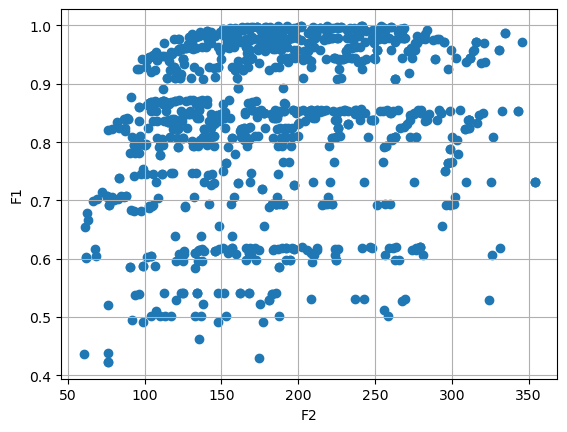

GENERATION :- 2
[[0.7670701834744696, 132.14461416410214], [0.8402560087009593, 119.42968638792163], [0.9942989189349583, 152.8946598088957], [0.97592014808599, 263.3284458272292], [0.9613835796219152, 126.8369317560922], [0.9766499276963754, 119.44220987900269], [0.870593914192898, 112.37846779663948], [0.9485353427812064, 114.44442164528641], [0.870871450207005, 114.31637377012461], [0.9918506295531287, 156.17706980448827], [0.6034361969666554, 61.786296044779625], [0.7008704340573423, 111.04486486759629], [0.9932429268931564, 153.25827109805394], [0.9888540436897957, 168.00909416304432], [0.6034361969666554, 61.786296044779625], [0.978390560249129, 163.7202250858819], [0.9978544668712501, 187.1889831819628], [0.9852600700279355, 282.85300498787956], [0.9807681880397425, 158.46675153070117], [0.7067922022179501, 86.40846160272805], [0.6034361969666554, 61.786296044779625], [0.9936422120112174, 208.56530081397426], [0.9789208374998268, 149.80474538519226], [0.8913587676745723, 91.0123

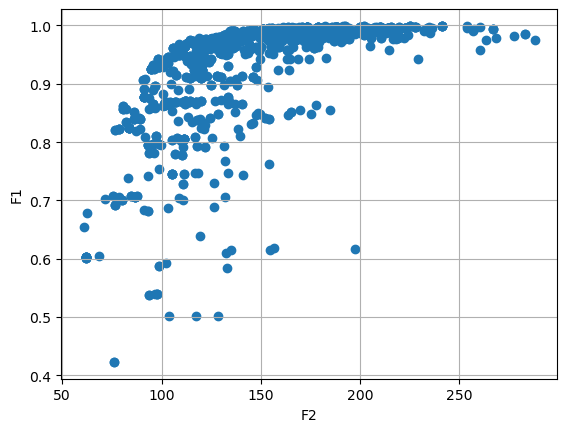

GENERATION :- 3
[[0.9833789847171678, 129.8055967369513], [0.9464086638775608, 101.93699031587387], [0.9884024604034878, 133.6614414798561], [0.9261498879089715, 96.1305707012413], [0.9641287261763074, 108.72766620130429], [0.994803762267633, 161.09165155789415], [0.9982288116378242, 178.97433625901624], [0.9774172858298295, 122.83155214321832], [0.9926935800480715, 140.57165779614593], [0.8238648573749833, 83.36931464295112], [0.9831942493286989, 127.77089833878755], [0.9936329379804365, 151.22904062703378], [0.9926348306594509, 165.11948433630357], [0.9242627608492751, 97.34800365419284], [0.9947607214780197, 153.92728531287625], [0.9183566591652841, 103.5796452433733], [0.7787178975308482, 93.41493234445059], [0.9943395027220664, 168.2689453180622], [0.7069946460478276, 75.48148970967445], [0.9926593694580456, 155.73537119667108], [0.9952718104756543, 169.91712590879126], [0.9961064514804593, 175.24786990750982], [0.9670879692216507, 116.76531902920416], [0.9950118941190019, 154.017

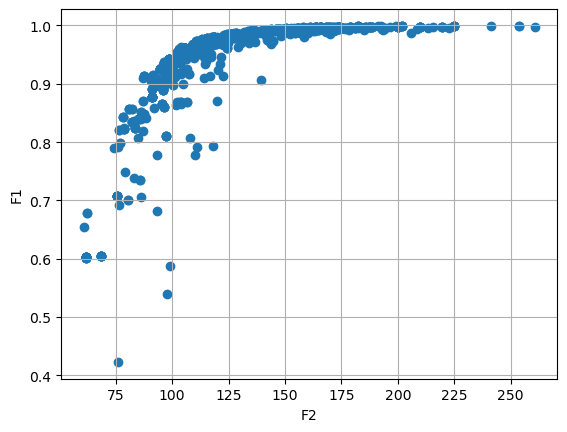

GENERATION :- 4
[[0.9572062659994145, 103.7481450509515], [0.9870979776619108, 133.4299694430456], [0.9247727941316457, 96.16366937326328], [0.9131791666090625, 87.38132673859594], [0.9891042802627973, 131.15821581286974], [0.8567325216202367, 80.72650588124966], [0.9722164140950714, 109.57710467804566], [0.9966216051624601, 156.14882084752747], [0.985013949314386, 124.62327118880623], [0.9914301170502062, 136.09893658989344], [0.9968325117705105, 163.4999902354967], [0.9360716853870384, 97.33897649641347], [0.9980683654383773, 170.10122984840854], [0.9870979776619108, 133.4299694430456], [0.9665241536340244, 105.96530214708181], [0.970708131132692, 109.01556197435228], [0.9968325117705105, 163.4999902354967], [0.6548378706606417, 60.912182808735864], [0.9131791666090625, 87.38132673859594], [0.9968325117705105, 163.4999902354967], [0.9967890835694834, 156.33750315486043], [0.9389245644401067, 98.24537205888481], [0.9979367358486336, 169.37023084444652], [0.9967833430316329, 157.944410

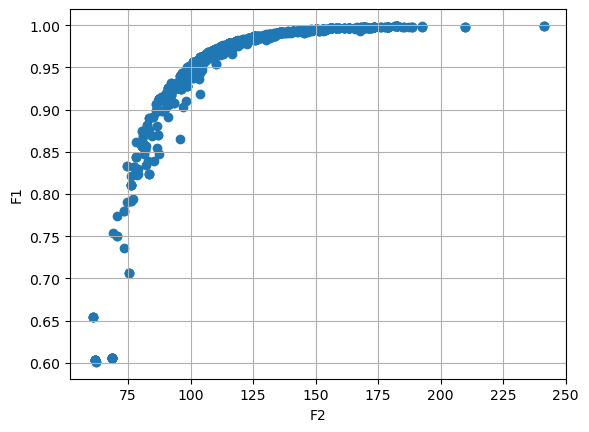

GENERATION :- 5
[[0.9921132703400821, 136.24700213322927], [0.9735024555604168, 111.3651319867475], [0.9986812393073555, 182.54192611950037], [0.9588899849491114, 102.80688507147468], [0.9860564445347768, 124.86724436962854], [0.8274604915742632, 73.86319922919085], [0.9601419703016041, 102.63360292074009], [0.9810199348133769, 118.34196367366678], [0.9937579299792625, 145.61079312013158], [0.9986812393073555, 182.54192611950037], [0.9907023607950552, 134.06856690017486], [0.9966216051624601, 156.14882084752747], [0.9650480270851798, 108.22492382578066], [0.9131791666090625, 87.38132673859594], [0.9865287494591152, 124.8822115024665], [0.9966216051624601, 156.14882084752747], [0.8567325216202367, 80.72650588124966], [0.9869298043306586, 125.35013768076954], [0.6548378706606417, 60.912182808735864], [0.9588899849491114, 102.80688507147468], [0.9131791666090625, 87.38132673859594], [0.9941654246492408, 143.67667079378754], [0.9840762320399451, 122.42674123700876], [0.9272628835248153, 92

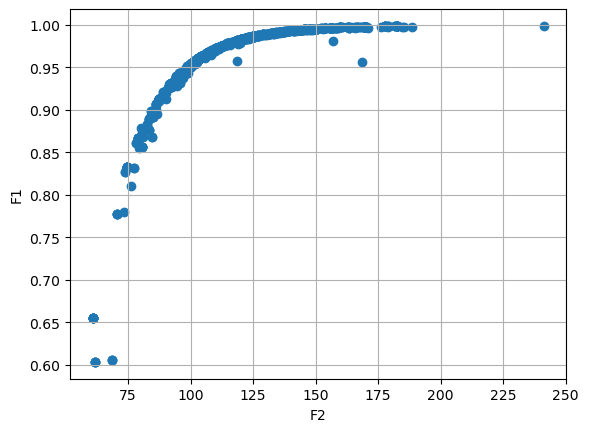

GENERATION :- 6
[[0.9932280896462777, 139.84173380144009], [0.8896341009327323, 83.44256471630612], [0.8615546389738321, 78.20687138063724], [0.9909476544955067, 133.05422016296737], [0.9980683654383773, 170.10122984840854], [0.9115555750878114, 86.73017483904991], [0.9982931536054723, 177.82458299995704], [0.977746107084695, 114.22493669060977], [0.9973213879209016, 162.13454968445103], [0.9635125045318553, 104.19549975540755], [0.9927736417901234, 137.9297096539932], [0.9978016797104977, 166.7043446205085], [0.9861055856401393, 124.1517917043532], [0.9873665227005575, 125.85243920357705], [0.9950810629386763, 146.82924685232496], [0.9880983968287439, 127.30297010046016], [0.9855783728851182, 123.09375829374069], [0.9943452273808848, 143.51640754895925], [0.9801172215955305, 116.57210864302988], [0.9859637272863245, 123.7820871033316], [0.9585939882197589, 101.57135074150685], [0.9976107764390085, 182.54836213706633], [0.9859637272863245, 123.7820871033316], [0.9687787244021159, 108.0

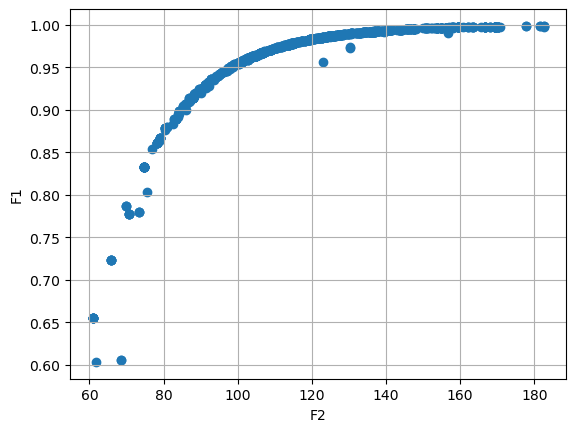

GENERATION :- 7
[[0.9756168181053, 112.20353788899072], [0.9846098577817016, 121.83731777680029], [0.6548378706606417, 60.912182808735864], [0.9261967287556796, 90.18949304694029], [0.9588549359455835, 101.69146174785187], [0.9833670792753478, 120.29114118569558], [0.9826741038887071, 119.19906704171248], [0.9533609180046757, 99.09690180635022], [0.9826741038887071, 119.19906704171248], [0.9979367358486336, 169.37023084444652], [0.9979367358486336, 169.37023084444652], [0.9919638444867417, 135.68601855036843], [0.9524226885741949, 99.01369464007908], [0.9949466443019997, 145.78030543373603], [0.9973213879209016, 162.13454968445103], [0.9457021319770663, 96.34439463849347], [0.8327603078971778, 74.70868305059435], [0.9982931536054723, 177.82458299995704], [0.9982931536054723, 177.82458299995704], [0.9979367358486336, 169.37023084444652], [0.9885300859034004, 127.95691557902907], [0.9980683654383773, 170.10122984840854], [0.9693711201199343, 107.60962472825105], [0.9935637363088559, 140.

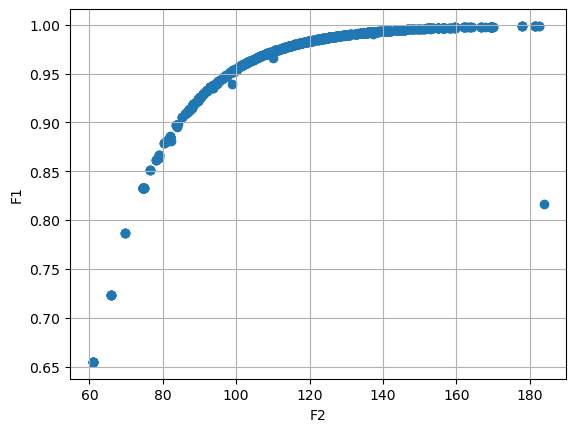

GENERATION :- 8
[[0.9916435272320651, 134.67008548618588], [0.9758076437457598, 112.39144571575613], [0.9706828609512219, 108.44949332376093], [0.9752453280409501, 111.89791250866512], [0.9850804082408648, 122.67551070601147], [0.9324459040768802, 91.93503815274312], [0.965898765241775, 105.33684725228795], [0.9753265033737333, 111.97379786656504], [0.9841155179667305, 121.15860633288264], [0.9734376896652109, 110.56503080315423], [0.9909476544955067, 133.05422016296737], [0.9764431341265942, 112.98859440283127], [0.9757778181693038, 112.3104245051626], [0.8327603078971778, 74.70868305059435], [0.9835595130158764, 120.3093629801393], [0.9915289632552402, 134.54789041582006], [0.9753998422818159, 112.02754430062974], [0.9938817117046915, 141.49441717453766], [0.9826741038887071, 119.19906704171248], [0.9864148579469589, 124.43416075481937], [0.9677048914928043, 106.45289866462619], [0.9918278799261319, 135.266600718765], [0.8808074417646279, 80.76984498352371], [0.9960066891547578, 151.

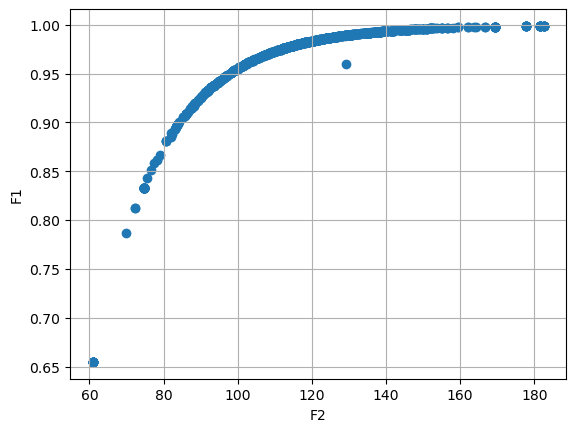

GENERATION :- 9
[[0.9870111392353287, 125.41471743067939], [0.8327603078971778, 74.70868305059435], [0.9944780802404387, 144.11583756285626], [0.8327603078971778, 74.70868305059435], [0.9814481640223479, 117.86411319128254], [0.840736494203694, 75.3342023195241], [0.8327603078971778, 74.70868305059435], [0.9986859961024726, 181.5243016131181], [0.9730962925200805, 110.18607710645296], [0.9599994583077329, 102.39159540161786], [0.9180623405076169, 88.2062354048706], [0.9694119157050908, 107.59917320812662], [0.9180623405076169, 88.2062354048706], [0.9455549127514474, 162.84357012677606], [0.9907911207677158, 132.61117979558998], [0.9785306120577405, 114.78773067295009], [0.8327603078971778, 74.70868305059435], [0.9809113204225542, 117.25664651586774], [0.9732114884715203, 110.234340497615], [0.9805701183340974, 116.89861125506334], [0.9752906718457806, 111.94018837417073], [0.9764761477059598, 113.02686454989583], [0.9942078764177196, 142.87205993316752], [0.994568240315281, 144.2929010

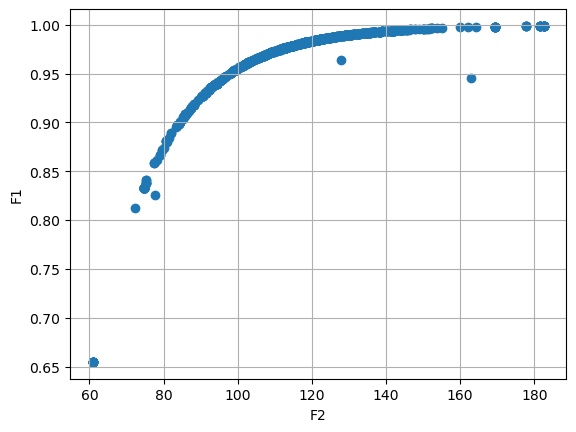

GENERATION :- 10
[[0.947873951972629, 96.93306498980647], [0.9748822561164141, 111.5615488646178], [0.9000312038139383, 84.4099379184027], [0.9833265953297022, 120.23004961841279], [0.9694186886552456, 107.53404557079675], [0.9918244541290477, 135.11975988427506], [0.9848618346903799, 122.14716061278497], [0.9888598892001059, 128.5169883164284], [0.9284121116170667, 90.85068126855208], [0.9804572012101241, 116.71220656363622], [0.9826163397198286, 119.15626282170103], [0.9683169182615351, 106.95467468383875], [0.9510461065279663, 98.25240800379679], [0.9838469532500379, 120.74333475801122], [0.9568590025263002, 100.68661916438077], [0.8327603078971778, 74.70868305059435], [0.9638198105168426, 104.20434609075349], [0.9749626825772609, 111.60807581372592], [0.9787773350042152, 114.99825901348417], [0.993315092456334, 139.55054011389146], [0.9907129890355105, 132.44082545663275], [0.9000312038139383, 84.4099379184027], [0.9862043247064601, 124.01397204917556], [0.9887810690681011, 128.338

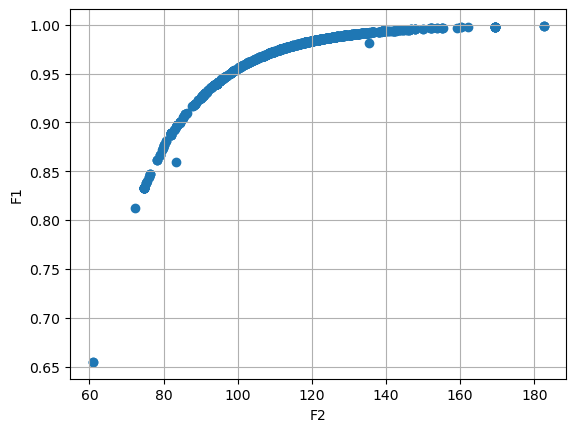

GENERATION :- 11
[[0.9717854678021224, 109.19356720560053], [0.9801220749162489, 116.35363888633916], [0.9808545225297675, 117.1374844278427], [0.9818699926998492, 118.25986869901746], [0.9831033356989349, 119.74033353095643], [0.9841049253436717, 121.00377330875841], [0.9456173834320619, 96.24600373545587], [0.9804646734048381, 116.75113953889107], [0.960432765074871, 102.37228619860824], [0.9778423250405933, 114.1086359433014], [0.9884163404919019, 127.68489273476197], [0.9820858107216478, 118.5265816215525], [0.9770964438919915, 113.44629571162561], [0.9856803964743546, 123.17198924800222], [0.9859637272863245, 123.7820871033316], [0.9871013253135311, 125.43859869454127], [0.9868945897723057, 125.05137025825461], [0.947873951972629, 96.93306498980647], [0.979320242243134, 115.52593536262897], [0.9912216081556731, 133.66289290168328], [0.9820858107216478, 118.5265816215525], [0.9883405418607536, 127.52943693186002], [0.978167756598646, 114.45497549120024], [0.9580588780670293, 101.23

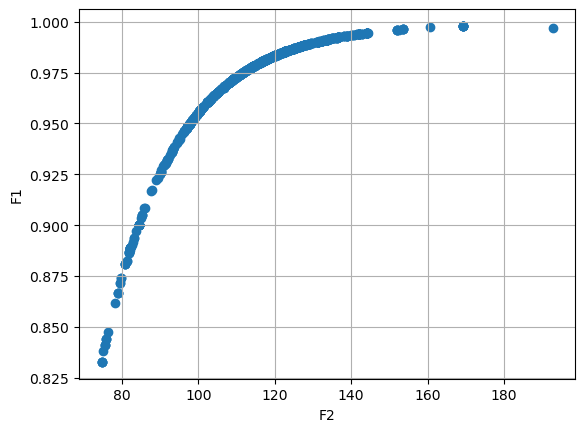

GENERATION :- 12
[[0.9893331315322276, 129.4313289156164], [0.8869952439461092, 81.95105293053075], [0.9781513394202853, 114.42734754011312], [0.9821702491653455, 118.64298887779174], [0.9677149800284706, 106.50355341023482], [0.9776872705507221, 113.97846611504423], [0.980321935076727, 116.58047424778245], [0.9894697598235297, 129.6929156479992], [0.9922895758938556, 136.48148236686603], [0.9891621367897909, 129.0642494711439], [0.9497946467712113, 97.6942043354498], [0.9957815553207796, 150.49350109090003], [0.9769925547832164, 113.44547019041767], [0.9944780802404387, 144.11583756285626], [0.96293514900921, 103.6617213235435], [0.9886275054308962, 128.10900978646248], [0.9862469394934557, 124.02448159768178], [0.9781513394202853, 114.42734754011312], [0.8889149978187175, 82.129058711172], [0.9321767232442258, 91.83141705534905], [0.9824699893723919, 118.96206547179375], [0.9807138156987636, 116.99166771259169], [0.9745242820639642, 111.28634799884699], [0.9944780802404387, 144.11583

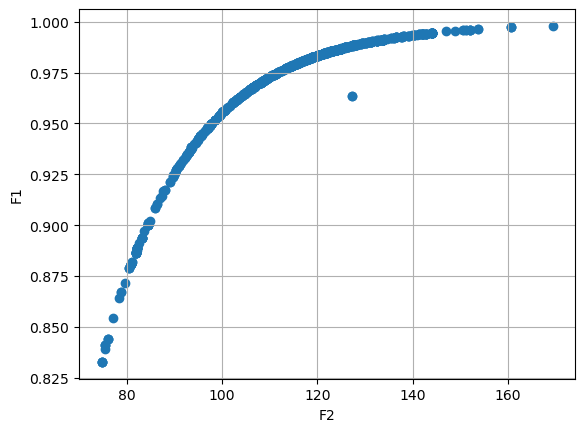

GENERATION :- 13
[[0.9909617065933795, 132.96992934784316], [0.9726029159539472, 109.77980036374238], [0.9883586748021435, 127.56724361896367], [0.9950319056807017, 146.6307164860019], [0.9556563311849762, 100.11367464315782], [0.970901030045235, 108.5498901052358], [0.9862784142513366, 124.08956227179684], [0.9778423250405933, 114.1086359433014], [0.9421041551686662, 94.95733449530243], [0.9000312038139383, 84.4099379184027], [0.9912216081556731, 133.66289290168328], [0.9850280568404955, 122.25496050130378], [0.9880040351963782, 126.91021286464382], [0.9740812034121185, 110.96380244074496], [0.8439528521545551, 75.9552751019427], [0.978894504732954, 115.10774448515534], [0.9781513394202853, 114.42734754011312], [0.9890372564472836, 128.87910839560382], [0.9671242181838845, 106.1775451064835], [0.9723203629852731, 124.88235308046887], [0.9677149800284706, 106.50355341023482], [0.970901030045235, 108.5498901052358], [0.9848751353448562, 122.05635556046732], [0.9899032272074544, 130.6382

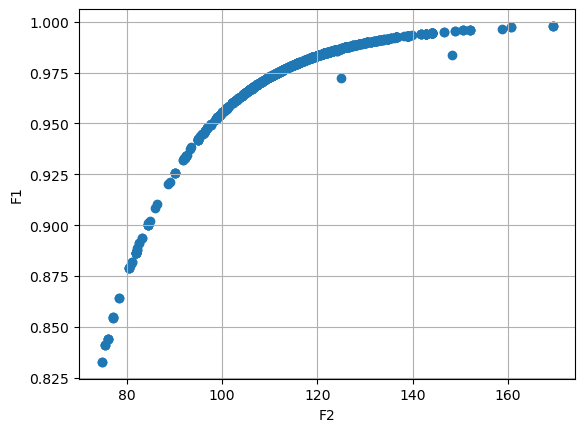

GENERATION :- 14
[[0.9824773041644976, 118.96800740496649], [0.886241186494447, 81.87902364194267], [0.9795792805599832, 115.79307573566038], [0.9476757193363676, 96.87440483590103], [0.9820858107216478, 118.5265816215525], [0.9739738071215, 110.84545806402653], [0.9765970225320489, 112.99452304155295], [0.9408459519555153, 94.45838129217199], [0.9798278746599803, 116.05043973635497], [0.9880040351963782, 126.91021286464382], [0.9650804353519788, 104.96589994228022], [0.9772196512582452, 113.57185894196687], [0.9802599679689352, 116.48825791847077], [0.933193893499279, 92.11479858605448], [0.9546638094896877, 99.78063877149458], [0.9538115951931484, 99.28968059807414], [0.9816298554821364, 117.98136399574466], [0.9866828735046395, 124.71864833439136], [0.9828220094711123, 119.37238465870249], [0.9813518434353854, 117.67004217631647], [0.9813326511728131, 117.64429074152852], [0.9880040351963782, 126.91021286464382], [0.9725458206117905, 109.74043345413426], [0.9944780802404387, 144.115

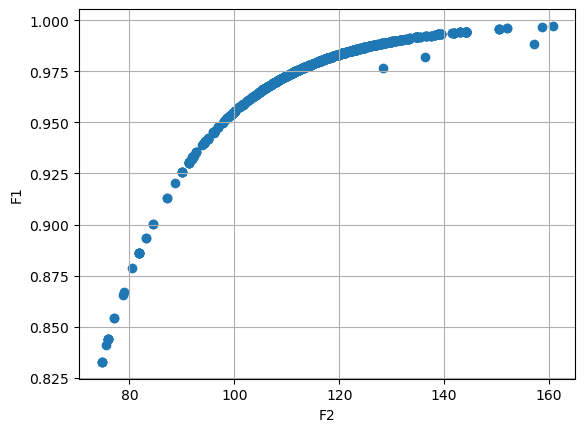

GENERATION :- 15
[[0.973076862008752, 110.12447818346922], [0.9798123932286678, 116.03229559574501], [0.9932368332014895, 139.48757808957373], [0.9818254072926696, 118.20807843311925], [0.9823863375057057, 118.86329927922839], [0.9887225616297943, 128.25906073907177], [0.9813326511728131, 117.64429074152852], [0.9832151732477371, 119.90087296411352], [0.9910604269946997, 133.3177642188054], [0.984660356571698, 121.73783907559823], [0.9457792829537923, 96.23877838328677], [0.9798250845285297, 116.0348939063404], [0.933193893499279, 92.11479858605448], [0.9888210103920089, 128.55172064188244], [0.9556311125211466, 100.10860405833839], [0.9873297034779899, 125.75961526140287], [0.9610439266028334, 102.7363354233406], [0.9866426746922337, 144.39284067228013], [0.984147371589295, 121.05233573083524], [0.9748050917896206, 111.48591465053869], [0.9625827346469062, 103.49031394568301], [0.9737074871208667, 110.65966916126993], [0.9867802985640179, 124.90053210160053], [0.975781044268486, 112.3

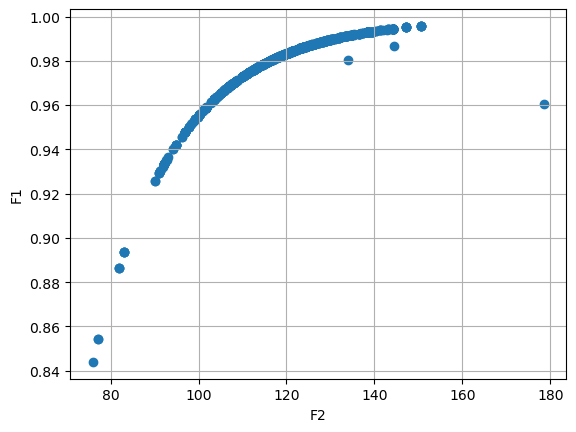

GENERATION :- 16
[[0.9796457559297903, 115.92732137155764], [0.9935629904970743, 140.78439949085765], [0.9838382063655389, 120.64780456379539], [0.933193893499279, 92.11479858605448], [0.9780389440295985, 114.30266390205931], [0.9818524110400966, 118.24138195356544], [0.9707466386709821, 108.44921101177255], [0.9399519921312465, 94.2078790672471], [0.9813326511728131, 117.64429074152852], [0.973076862008752, 110.12447818346922], [0.973076862008752, 110.12447818346922], [0.9873297034779899, 125.75961526140287], [0.9886210821282376, 128.09514395109113], [0.9887637049522477, 128.29926452444323], [0.987273606392134, 125.66534707301227], [0.9671461068983277, 106.10074200842591], [0.9687571502349502, 107.1235159248599], [0.9822150515896368, 118.64641415012768], [0.973076862008752, 110.12447818346922], [0.9809259303813334, 117.20885552344627], [0.886241186494447, 81.87902364194267], [0.9944780802404387, 144.11583756285626], [0.9813326511728131, 117.64429074152852], [0.9831214370560708, 119.74

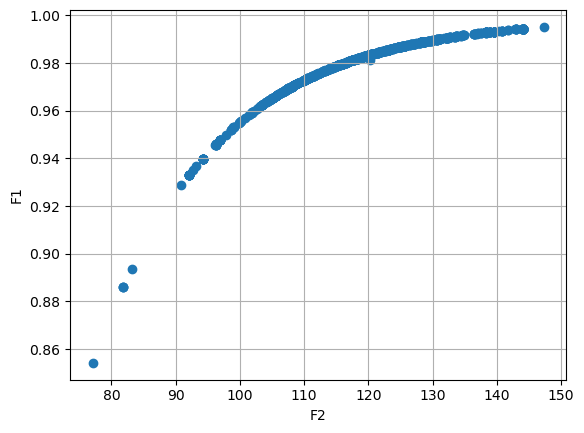

GENERATION :- 17
[[0.9795792805599832, 115.79307573566038], [0.9877850155530139, 126.66351170803087], [0.984415539247674, 121.39707739153235], [0.9852519803112746, 122.59888219955283], [0.9822150515896368, 118.64641415012768], [0.9942320137810711, 142.97562765413875], [0.9798387568651149, 116.05250067406095], [0.9742520185697163, 111.04670908703909], [0.9694795075681716, 107.65170537508376], [0.9878815150749706, 126.69301201846346], [0.9731098087361074, 110.16283446562099], [0.9744071331714697, 111.2283792617734], [0.9655651835813552, 105.18054100105016], [0.9846442826305772, 121.71818346351732], [0.9665357833380155, 105.75607353321189], [0.9530457846015228, 99.04934159938864], [0.9731704737264143, 110.20932739000268], [0.9856429899028483, 123.1250422414609], [0.9592140309196442, 101.88639875732997], [0.9856803964743546, 123.17198924800222], [0.9849104904686291, 122.08434197681089], [0.9930573917016946, 138.99486421857526], [0.9813326511728131, 117.64429074152852], [0.9871991549233439,

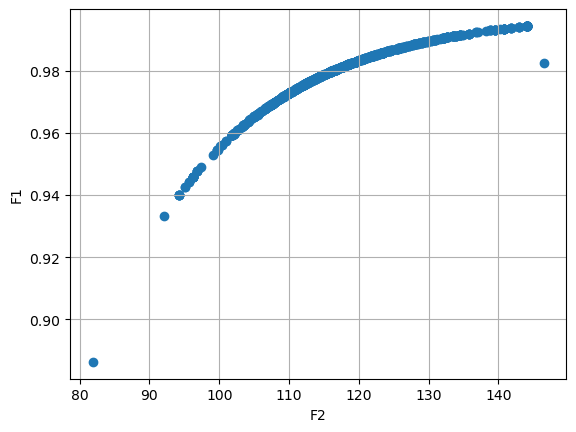

GENERATION :- 18
[[0.9932368332014895, 139.48757808957373], [0.9873390346303677, 125.87341717760614], [0.9816434455795296, 118.00484746016312], [0.9755926094754643, 112.13282091273446], [0.9944780802404387, 144.11583756285626], [0.9736200376725435, 110.55544019802771], [0.9700575313738607, 108.0335287437822], [0.9763383166226225, 112.76177737322196], [0.9545240255867803, 99.65616207651686], [0.986117265959539, 123.83523730814464], [0.9757177767630222, 112.23629840645123], [0.979490703503358, 115.70963788304877], [0.9867139058991411, 124.77081678309384], [0.9746134044922762, 111.33635663172171], [0.9944780802404387, 144.11583756285626], [0.9896797431828984, 130.18852929884417], [0.9874044487369732, 125.90121658809252], [0.9820982270318716, 118.51462681401233], [0.9931524219873054, 139.2589407555013], [0.9777883012407184, 114.0723383174279], [0.9765380749640442, 112.94758930069233], [0.9759882893419556, 112.46669232879461], [0.9829454759677156, 119.53898239032137], [0.9761933581149332, 1

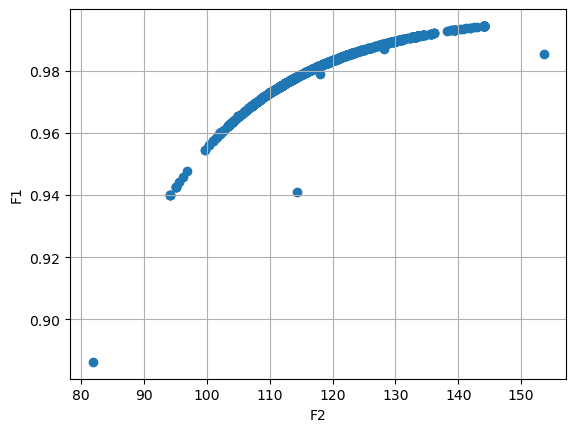

GENERATION :- 19
[[0.9849674495343904, 122.17460754035403], [0.9797632453877516, 115.98603345473386], [0.9720731770461936, 109.39076235888183], [0.9812750098820104, 117.58219729612526], [0.972588965332773, 109.78146067330985], [0.9865680473877197, 124.5317295219763], [0.9829454759677156, 119.53898239032137], [0.9848252747678594, 121.97573885395848], [0.9746134044922762, 111.33635663172171], [0.973076862008752, 110.12447818346922], [0.9797764580132321, 115.9956876598178], [0.9772493141663519, 113.58685384762285], [0.9816968770665424, 118.06020391919499], [0.9757177767630222, 112.23629840645123], [0.973076862008752, 110.12447818346922], [0.9794855759190394, 115.69296295365996], [0.9833828235336689, 120.07300060612548], [0.9797632453877516, 115.98603345473386], [0.986825093071427, 124.96092838562802], [0.9905039734310664, 132.02594182021784], [0.9904533820989885, 131.9162982067109], [0.9759882893419556, 112.46669232879461], [0.976611421376206, 113.00794200080695], [0.9838515260490046, 120

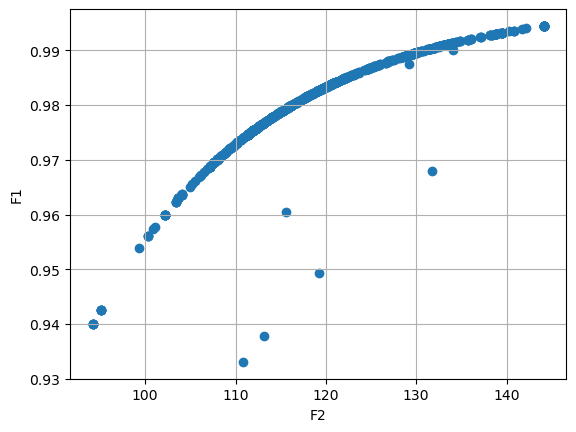

GENERATION :- 20
[[0.9894240006009366, 129.69564804799487], [0.9671616824395818, 106.12009358303493], [0.9838515260490046, 120.66302415630852], [0.9801690589569884, 116.40275379526655], [0.9795668639629873, 115.79327404327243], [0.9830297848014501, 119.62803149156343], [0.965092765449748, 104.91070439142855], [0.9903388885897147, 131.64807240900694], [0.9759882893419556, 112.46669232879461], [0.9747250456443917, 111.43097714684316], [0.9866814541674773, 124.7293489656974], [0.9765380749640442, 112.94758930069233], [0.9911496692420285, 133.5095116849895], [0.9860082478743781, 123.68949348999553], [0.985054024310032, 122.31599040514007], [0.9770278357940084, 113.37521178582384], [0.9867414649137601, 124.81796328644774], [0.9912766001820826, 133.84946331888244], [0.9894240006009366, 129.69564804799487], [0.9688103624215334, 107.16322965114546], [0.979777412481275, 115.99389624562764], [0.9838122344686081, 120.60923198139685], [0.9829691395996545, 119.55633063685833], [0.982802707055842, 1

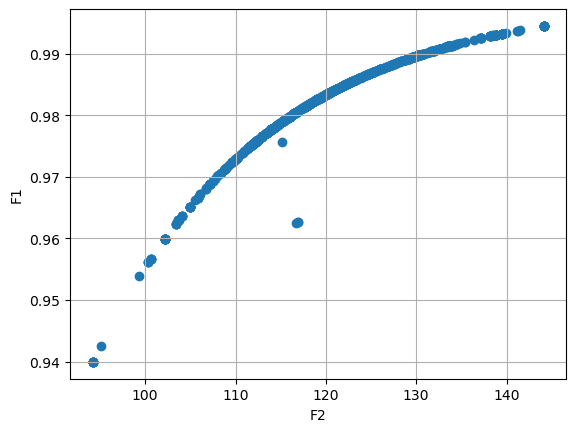

GENERATION :- 21
[[0.9907647341384751, 132.5993326898612], [0.9765855905446762, 112.98469269846194], [0.9779976835299689, 114.25977888218799], [0.9853489780743063, 122.70583225696075], [0.9944780802404387, 144.11583756285626], [0.9783694110336865, 114.6078839531845], [0.9838122344686081, 120.60923198139685], [0.9871989521745075, 125.57525833283634], [0.9761801187903684, 112.66574685017557], [0.9922136226309946, 136.3555706674419], [0.9848050884324452, 121.94039400919074], [0.9836886877476247, 120.4673119578168], [0.9910993048567316, 133.42318124441022], [0.9399519921312465, 94.2078790672471], [0.9798932349159993, 116.11311987980042], [0.9884571894372376, 127.79597560926916], [0.9561292134912003, 100.3669681291737], [0.9790668097805538, 115.27889203390157], [0.9671616824395818, 106.12009358303493], [0.9912078120567045, 133.65705110629946], [0.9930459494400238, 138.85537844400727], [0.9895772523438559, 129.9988586727617], [0.9833828235336689, 120.07300060612548], [0.9676763539287081, 106

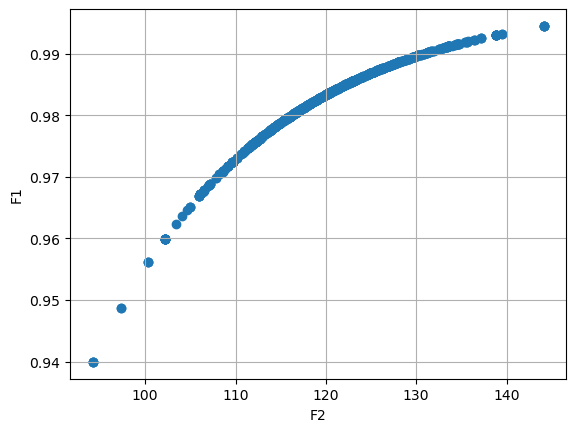

GENERATION :- 22
[[0.9908856851282548, 132.91495267643512], [0.9824493603379295, 118.93569890025225], [0.9883375026579299, 127.58223356844928], [0.9794993974417493, 115.72160037593659], [0.9880322865008918, 127.02267360181968], [0.9872943200650018, 125.73645256937712], [0.9849542367185682, 122.16842011644746], [0.9853555071672978, 122.73072135814334], [0.9930459494400238, 138.85537844400727], [0.9812379722815544, 117.5502565486999], [0.9849542367185682, 122.16842011644746], [0.972562201533215, 109.77305171246992], [0.9782529918710162, 114.49917865990766], [0.989486086490341, 129.810511938538], [0.9830138950358467, 119.61147808005555], [0.9833828235336689, 120.07300060612548], [0.9809849267202483, 117.27358675418733], [0.9804162905289358, 116.65818823434462], [0.9852619868958049, 122.58784978280494], [0.9855581068996655, 123.0222911811307], [0.9846103394030497, 121.71041113709113], [0.9746426033258766, 111.34978433811054], [0.9899458367089378, 130.7650482771414], [0.9796653436863269, 11

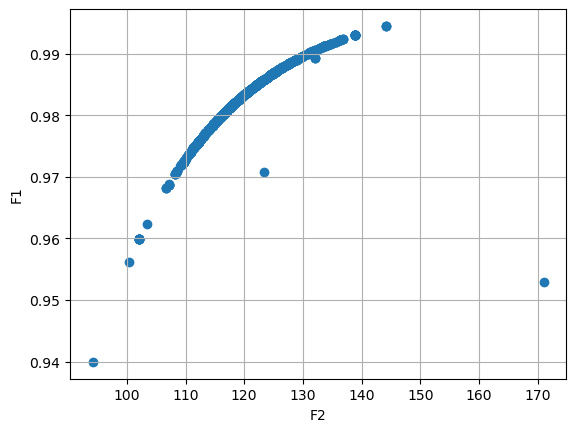

GENERATION :- 23
[[0.9832691005559993, 119.92798491968732], [0.9930459494400238, 138.85537844400727], [0.9776179475120113, 113.9121847211157], [0.9848165958659306, 121.97457475302312], [0.9894240006009366, 129.69564804799487], [0.989390578656934, 129.609683366655], [0.9802772494486542, 116.52093139712625], [0.9843383160243816, 121.32832308634833], [0.9777027603045646, 114.02909258130005], [0.9836472733163704, 120.4124900305977], [0.9811772555593595, 117.47972774012348], [0.9746354205408251, 111.34248504298283], [0.9796653436863269, 115.88013537086584], [0.9836102864048836, 120.37478770133325], [0.982797900295743, 119.35049513199908], [0.9868201181079393, 124.95367832253899], [0.9761801187903684, 112.66574685017557], [0.9826943821345687, 119.23362312929294], [0.9815436177351643, 117.89120694753781], [0.9822756607277995, 118.72996633530192], [0.986413990520213, 124.3108964983964], [0.9797941064604176, 116.01365626747061], [0.9807825795318568, 117.0510630434672], [0.9850787679566141, 122.

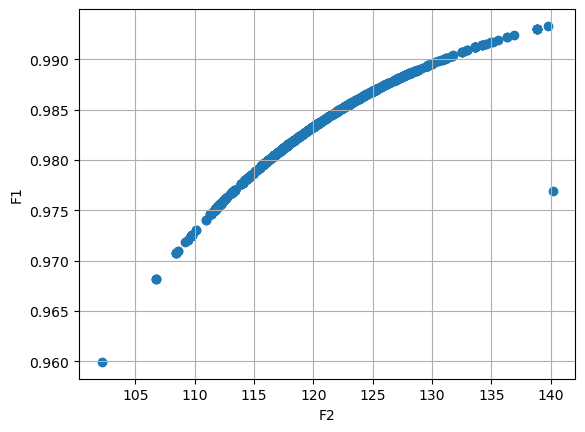

GENERATION :- 24
[[0.9851744695094602, 122.46863822466591], [0.980121986956072, 116.35346417749673], [0.984787521772326, 121.92768206944497], [0.99013236085221, 131.17506732707028], [0.985112257781462, 122.40558395761853], [0.986012485359695, 123.72013089719955], [0.978005875139554, 114.26828771228708], [0.9897120593531643, 130.27123291581597], [0.974532456192722, 126.94029527507104], [0.9855670397607383, 123.04084059055157], [0.9822793752680037, 118.73542770025554], [0.9825423768206768, 119.04723963269817], [0.9908856851282548, 132.91495267643512], [0.9805344298103383, 116.78904780959894], [0.9831711796891563, 119.81790029090125], [0.9741393298134002, 110.95056655117894], [0.984921891299408, 122.1042142304248], [0.9833828235336689, 120.07300060612548], [0.978005875139554, 114.26828771228708], [0.9833828235336689, 120.07300060612548], [0.9854016462764746, 122.8042489907051], [0.9879779121742651, 126.9238039656864], [0.9849597402147859, 122.17542461103069], [0.9788868978375995, 115.1107

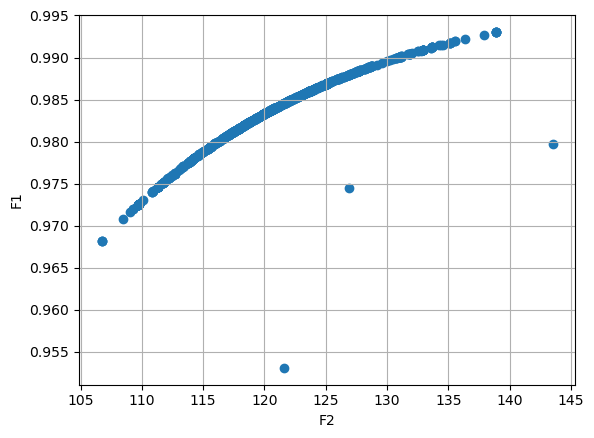

GENERATION :- 25
[[0.9833828235336689, 120.07300060612548], [0.989390578656934, 129.609683366655], [0.9801013349793049, 116.33521869347], [0.9861380948471747, 123.8935206450362], [0.9746426033258766, 111.34978433811054], [0.9874522891677612, 125.97643490821217], [0.9751643561622021, 111.7777727338849], [0.9820052148528342, 118.41094992831123], [0.9884549957853004, 127.78681252604324], [0.9821630112390767, 118.60044785797515], [0.9827691277720829, 119.32255785570975], [0.9886381752057127, 128.14341667015105], [0.9804882983371347, 116.7354861156935], [0.9832497838338347, 119.90964502910371], [0.9900629312705733, 131.0099176619133], [0.972562201533215, 109.77305171246992], [0.985693378131966, 123.22435640939786], [0.979142004927932, 115.36791642592989], [0.9836606048427722, 120.42707007390007], [0.9860674397210836, 123.7801249131061], [0.9900629312705733, 131.0099176619133], [0.9833828235336689, 120.07300060612548], [0.9831404384513159, 119.77381816321781], [0.9823782205708362, 118.855589

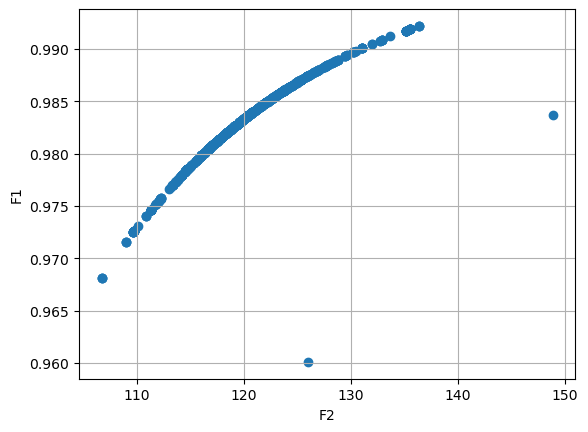

GENERATION :- 26
[[0.9830299419241088, 119.64181483829367], [0.9885183651806044, 127.91389903949066], [0.9833828235336689, 120.07300060612548], [0.9833828235336689, 120.07300060612548], [0.9806430940311609, 116.9041194891135], [0.9826529766033668, 119.17731381595749], [0.9819771596857719, 118.39040846765118], [0.984197984481655, 121.12367188274966], [0.9804882983371347, 116.7354861156935], [0.9833828235336689, 120.07300060612548], [0.9846632377417533, 121.76061299430805], [0.9827426646038375, 119.28912993955247], [0.9830612988342479, 119.6799146015355], [0.9793848707131262, 115.60117208438442], [0.9883224905354353, 127.55669386030178], [0.9756719727090091, 112.20626081989894], [0.984536896702261, 121.58107684868682], [0.9853432103814473, 122.704019928186], [0.9846442152765498, 121.7309995930101], [0.9819771596857719, 118.39040846765118], [0.9787306754118693, 114.9615407398646], [0.98109741810467, 117.39270457213891], [0.9819074944482047, 118.30767535969701], [0.9798955898584725, 116.12

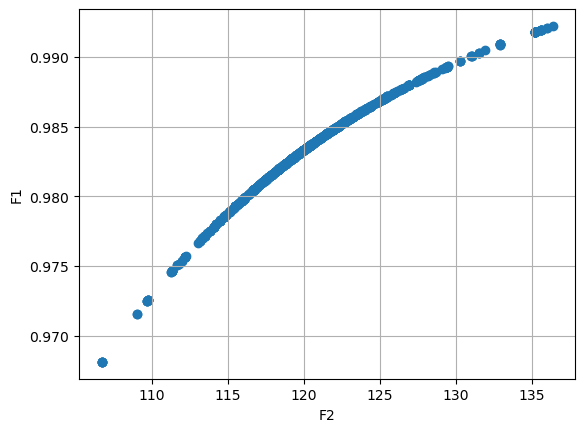

GENERATION :- 27
[[0.9840721203850297, 120.96133704712672], [0.9798274605943106, 116.04687727971162], [0.9808681277124076, 117.14439660563198], [0.9792213269342555, 115.44163141456269], [0.9837315066618847, 120.52157314202591], [0.9789507720852456, 115.16969871553661], [0.991850357099616, 135.3745431842654], [0.984787521772326, 121.92768206944497], [0.9819755090642652, 118.3822328230751], [0.9874640160644534, 126.03580982353117], [0.984974784530357, 122.18770404321548], [0.9811836287210649, 117.49244100400408], [0.984536896702261, 121.58107684868682], [0.9807997837529325, 117.06798610485174], [0.984536896702261, 121.58107684868682], [0.9917708639192204, 135.17901739038973], [0.987813927801602, 126.64587495429976], [0.9835455117326936, 120.28056787498839], [0.9804461400798565, 116.68791742136452], [0.984974784530357, 122.18770404321548], [0.9814432281360647, 117.77597861131808], [0.9878711552635381, 126.74112919629815], [0.9832775228183709, 119.94017244400102], [0.9681277786753628, 106.

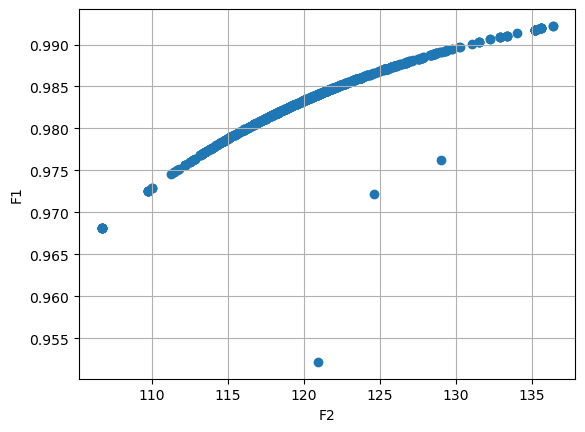

GENERATION :- 28
[[0.9819755090642652, 118.3822328230751], [0.9820656149850107, 118.48532133338536], [0.9802231012335746, 116.45675768751211], [0.9820409629454625, 118.458579871773], [0.9784970403570489, 114.73105671483272], [0.9794508308233448, 115.66858976692085], [0.9807979585783216, 117.07254081072358], [0.9917708639192204, 135.17901739038973], [0.9837859171218846, 120.58864746378237], [0.9825179208973159, 119.01872474116814], [0.9807635258085025, 117.03210198970677], [0.9784857670026331, 131.06538813410606], [0.984787521772326, 121.92768206944497], [0.9917708639192204, 135.17901739038973], [0.9681277786753628, 106.72507409676527], [0.9858640759539747, 123.46801950646787], [0.9864254154875213, 124.33929039794778], [0.9835407221501627, 120.27874826563965], [0.9878387594315069, 126.69431599240544], [0.9816391898447516, 117.99831285610804], [0.9822575630388364, 118.70957932946979], [0.9865250627954547, 124.49497367611468], [0.9823471519797097, 118.81722654079809], [0.9845144451928338,

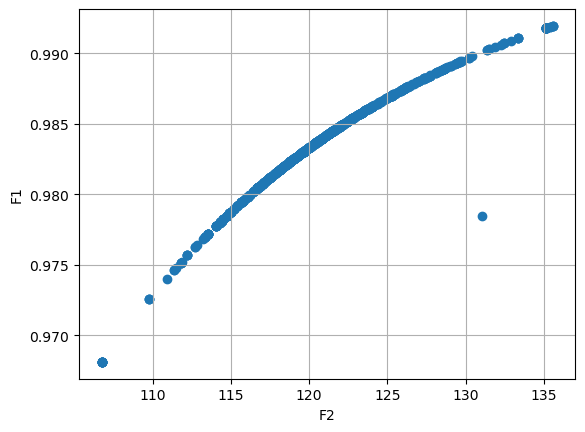

GENERATION :- 29
[[0.980493305111597, 116.74258260238784], [0.9820427488365298, 118.45830919535376], [0.9873367141262854, 125.81296407650058], [0.9858767214995888, 123.50010826714919], [0.9819002093920015, 118.29587017085547], [0.981517765707713, 117.86354797037639], [0.9836842166227123, 120.46077549898067], [0.9784970403570489, 114.73105671483272], [0.9836227363943654, 120.38066486447451], [0.9919288082361186, 135.57025543392996], [0.9792377756859857, 115.45655480438782], [0.9770069651213922, 113.36279225782329], [0.9835407221501627, 120.27874826563965], [0.9867836854532835, 124.91002001711043], [0.9820485139902108, 118.46625016119549], [0.9832970821728908, 119.96984542976708], [0.9840290738294354, 120.90621999060558], [0.9775830435904779, 130.30440825162336], [0.9835407221501627, 120.27874826563965], [0.9857161052416359, 123.25446391412768], [0.9825685004705759, 119.07890160777595], [0.9750096536502315, 111.6640046376414], [0.9834145897671143, 120.11590855729105], [0.9773530772203916

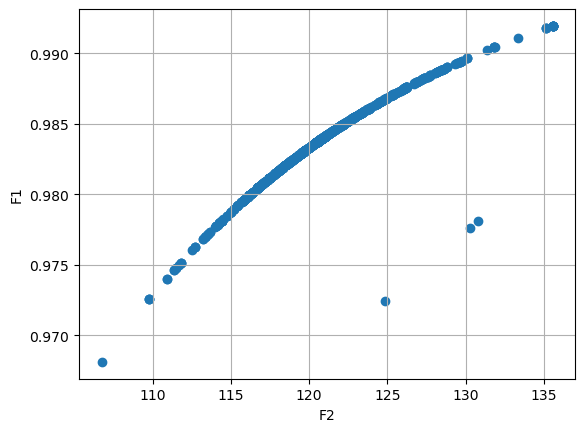

GENERATION :- 30
[[0.9827123202846066, 119.25202606373213], [0.984787521772326, 121.92768206944497], [0.9842506559370842, 121.20012583210749], [0.9844614498658072, 121.48615134429762], [0.9839077350145283, 120.74974774456166], [0.9805042458695862, 116.75711075362517], [0.9836927429963007, 120.47006830380568], [0.9807269407207335, 116.99409583136625], [0.9791622061580751, 115.37931587102332], [0.9807171611456781, 116.9839188881163], [0.9870570408280929, 125.35024324437826], [0.9837412805730315, 120.53228618974624], [0.9791490752867926, 115.3667224280019], [0.984787521772326, 121.92768206944497], [0.9818503641771001, 118.23811598564738], [0.987157686190599, 125.52933884827878], [0.9824343210407684, 118.93060640461306], [0.9827988520040161, 119.35385977146025], [0.9847207701989471, 121.83683709830106], [0.983133392613141, 119.76695936975165], [0.980493305111597, 116.74258260238784], [0.9853085336549153, 122.67234906533423], [0.9819755090642652, 118.3822328230751], [0.9886479237140892, 128

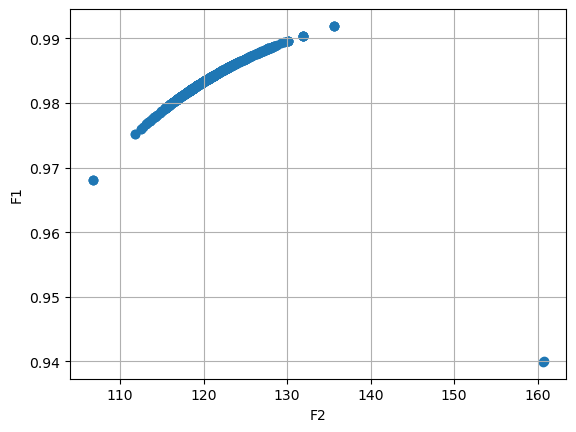

GENERATION :- 31
[[0.9870252773510846, 125.29864803793143], [0.9834547702439209, 120.16787424766383], [0.9823396024499355, 118.80831289415578], [0.9868497025093818, 125.00629303358784], [0.9825184320237983, 119.01758001404204], [0.9848283794726166, 121.98697349388829], [0.9841278956074162, 121.03762001444468], [0.9837593093267338, 120.56016479448755], [0.9822575630388364, 118.70957932946979], [0.9851930271197322, 122.50908511361091], [0.9824264601927235, 118.90916938588741], [0.9835279969697778, 120.26077875160743], [0.9822575630388364, 118.70957932946979], [0.9844395638266674, 121.45402574290398], [0.9864254154875213, 124.33929039794778], [0.9838356284768909, 120.65630990006099], [0.9831988149462049, 119.8490663496776], [0.9827037343236101, 119.24013929234593], [0.9836842166227123, 120.46077549898067], [0.980493305111597, 116.74258260238784], [0.9801672455835824, 116.4060363693049], [0.9821954174466649, 118.63710371516166], [0.9833689700300827, 120.0614341283912], [0.9868894708095969,

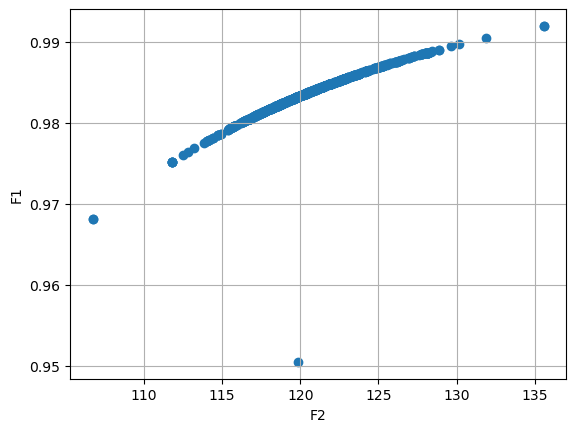

GENERATION :- 32
[[0.9856279050273953, 123.13181001386081], [0.9840051145870967, 120.87605963485137], [0.9853120693572753, 122.66598322695901], [0.9857316773851502, 123.29055328678331], [0.9822168652331023, 118.66450050249202], [0.987644663591372, 126.33804163602538], [0.98311572121795, 119.74375595145627], [0.9829347228523483, 119.52179090936772], [0.9820559313183329, 118.48054268739364], [0.9860205850324932, 123.7167272249095], [0.9836553278544887, 120.42432801782172], [0.9827061870759521, 119.24187419312864], [0.9850438030691809, 122.29197883731351], [0.9816266878927976, 117.98424126090546], [0.9839755157058838, 120.83790110047806], [0.9832195405441917, 119.87412636966872], [0.982305897962994, 118.76987586620112], [0.9857308752391475, 123.28083790548426], [0.9823396024499355, 118.80831289415578], [0.9839257814392715, 120.77712866360264], [0.9847986183300861, 121.94587935838226], [0.9827282424373305, 119.27047026606954], [0.9859092823158966, 123.55461424335981], [0.98311659052327, 11

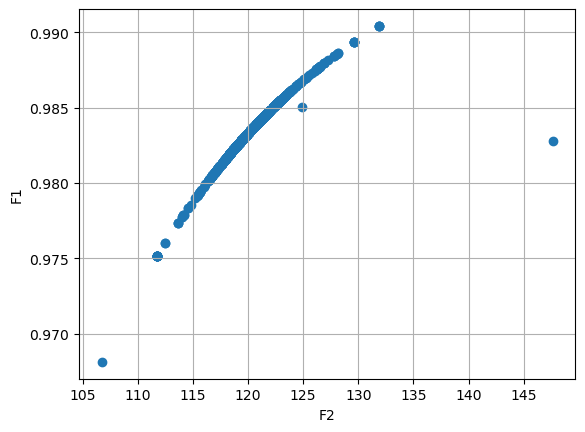

GENERATION :- 33
[[0.9830693421103321, 119.68833698713732], [0.9849094811232204, 122.09896004979748], [0.9820310765868511, 118.4464302843358], [0.9834680291057, 120.1820554891475], [0.9840234462374844, 120.90015862043339], [0.9841631309086222, 121.08647139725215], [0.9855956412663114, 123.08043091758626], [0.9867229442002748, 124.80671101336596], [0.9852151669628505, 122.5344287241959], [0.9850438030691809, 122.29197883731351], [0.9806354180939292, 116.8997196236341], [0.9855759483859969, 123.04969639672053], [0.9831868487638447, 119.82926098114638], [0.9830848079697185, 119.7072033068396], [0.9853646090314677, 122.74419362905023], [0.9791730409984253, 115.39261711561156], [0.9842857659308631, 121.24389613200135], [0.9819685030741861, 118.37610327803047], [0.9839085028281183, 120.75204102141224], [0.9846376667356767, 121.72067410765663], [0.9820440449567388, 118.46805132065268], [0.9847071377874757, 121.82167945292196], [0.9796796387506922, 115.90007889375438], [0.9829350279401726, 119

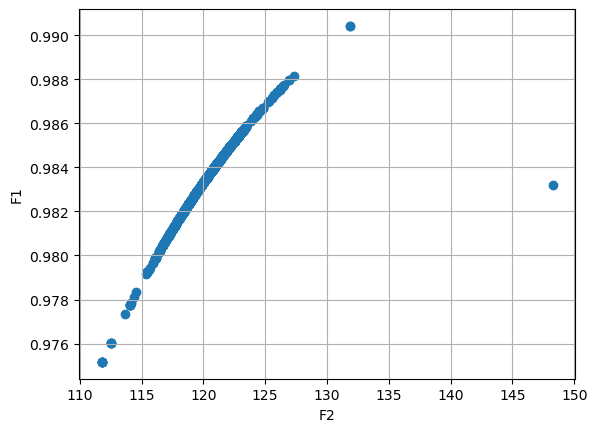

GENERATION :- 34
[[0.9841069202641348, 121.01337277775083], [0.9867229442002748, 124.80671101336596], [0.9853150509094565, 122.67615782618104], [0.9841659940846874, 121.09058657300825], [0.9792519970376115, 115.47217499089635], [0.9855956412663114, 123.08043091758626], [0.9839900241806168, 120.86258806994309], [0.9823944041265685, 118.87527922708664], [0.9828680605901103, 119.4410935866373], [0.9852151669628505, 122.5344287241959], [0.9843798462926244, 121.37576143461749], [0.9802835263955757, 116.52762223787654], [0.9831868487638447, 119.82926098114638], [0.9827722122437723, 119.32380693332935], [0.9844640392842345, 121.48770990562639], [0.9777634531340271, 114.04731137369566], [0.9838570355903381, 120.68479291523667], [0.9835559600971184, 120.29772374197304], [0.9824878030462112, 118.98410977619675], [0.9842602651255282, 121.21956023342446], [0.9841928320095603, 121.12533735045395], [0.9842091653753826, 121.14728336383855], [0.9842254803478607, 121.16811401452478], [0.977763453134027

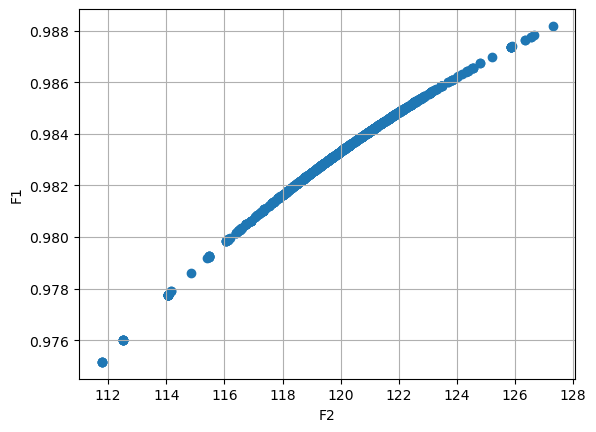

GENERATION :- 35
[[0.9846376667356767, 121.72067410765663], [0.9851809627426579, 122.48493025246188], [0.984520709948336, 121.56729719673106], [0.9836056935102695, 120.36247105629204], [0.9823921111667219, 118.87220486877764], [0.9820280023800398, 118.44333889007812], [0.98583575496861, 123.43800359620145], [0.9852151669628505, 122.5344287241959], [0.9845537646395182, 121.60970161195775], [0.9847580813238459, 121.88868406431658], [0.9848080349402961, 121.9619615168225], [0.9825620752682551, 119.07035027059982], [0.9813180349393388, 117.64201828072032], [0.9825828645492146, 119.09682952925314], [0.9834148007922089, 120.11788234659002], [0.9841631309086222, 121.08647139725215], [0.9840178289600671, 120.89526355389887], [0.9847375516739578, 121.86256103823905], [0.9820703601541201, 118.49165860095474], [0.9836094913236036, 120.3645496447633], [0.9834288275140934, 120.13590540740205], [0.9813180349393388, 117.64201828072032], [0.9823911126809967, 118.87089908902334], [0.9840757578901667, 1

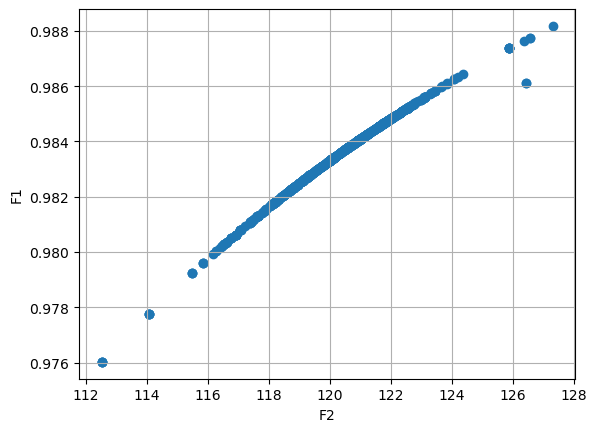

GENERATION :- 36
[[0.9846376667356767, 121.72067410765663], [0.9855956412663114, 123.08043091758626], [0.9846376667356767, 121.72067410765663], [0.9852151669628505, 122.5344287241959], [0.9830669344627113, 119.6841951751156], [0.9838996086915226, 120.74013277105693], [0.9841069202641348, 121.01337277775083], [0.9847432515947832, 121.86950621512119], [0.9838388188556408, 120.66151327979597], [0.9838254889497403, 120.64397945814233], [0.9833420554341568, 120.02722794139484], [0.9842656414663576, 121.22152414884025], [0.9836891004907066, 120.46634747270562], [0.9839571338628972, 120.81543399442242], [0.9852151669628505, 122.5344287241959], [0.9846376667356767, 121.72067410765663], [0.9850438030691809, 122.29197883731351], [0.9817424105183213, 118.11975009080483], [0.9843059162053127, 121.27680396259464], [0.9820402686461159, 118.45844194125073], [0.981304943715851, 117.62414506004671], [0.9825620752682551, 119.07035027059982], [0.9856271321552091, 123.13009397288766], [0.9852151669628505,

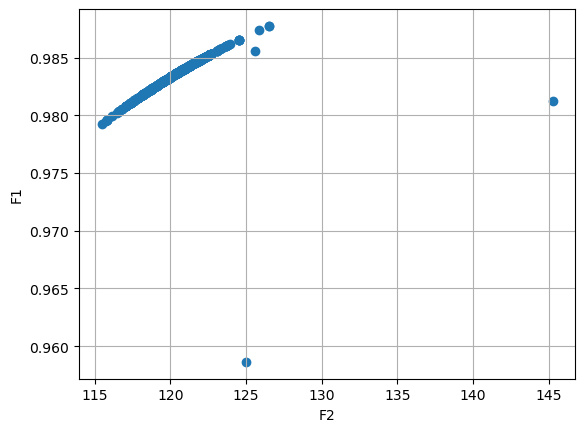

GENERATION :- 37
[[0.9846708499888167, 121.77100970488428], [0.9830120122588346, 119.61816470871241], [0.9847728935098676, 121.91049817490138], [0.9846376667356767, 121.72067410765663], [0.9825620752682551, 119.07035027059982], [0.9834962621281241, 120.22091537266982], [0.981774020805544, 118.15619619499215], [0.9839546956779622, 120.81240560983474], [0.982709386190094, 119.25352331749805], [0.9807846771261167, 117.05638939042629], [0.9848080349402961, 121.9619615168225], [0.9843684763093131, 121.36259339693041], [0.9848897370458862, 122.07040474325058], [0.9822012522848473, 118.64527499853725], [0.9851245728599638, 122.39999977587001], [0.9833653871380015, 120.05879854336428], [0.985039333808799, 122.28358074121189], [0.984844602136139, 122.01125493005097], [0.9833428226880194, 120.03043674026719], [0.9828744793816303, 119.44990958140156], [0.9847246463107071, 121.84304967795696], [0.9841963688303518, 121.12920211910978], [0.9842656414663576, 121.22152414884025], [0.9841166677404485, 

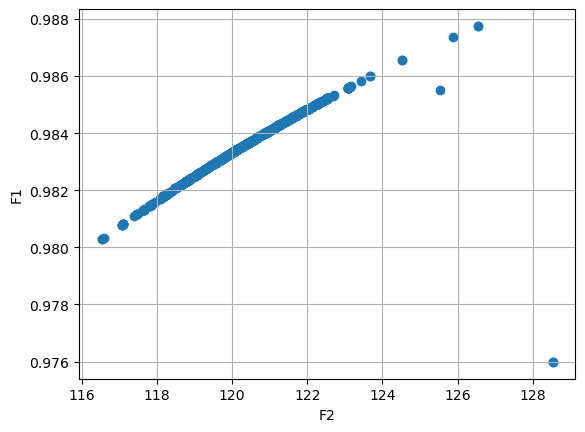

GENERATION :- 38
[[0.9836754638770677, 120.4525425132905], [0.9839478589056971, 120.80210413020785], [0.9837611084757761, 120.56208323675062], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9848859342790195, 122.0667901543988], [0.9846376667356767, 121.72067410765663], [0.9830697731352592, 119.69043020742217], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9827531560354689, 119.30517529433567], [0.9838505610382725, 120.67475044217164], [0.9846376667356767, 121.72067410765663], [0.9845049985032427, 121.54063337923571], [0.9825853091443348, 119.10153828461463], [0.9842713137531383, 121.23114530679041], [0.9831935778817142, 119.84062116043154], [0.9836114203042949, 120.37072577776759], [0.9844790186580262, 121.51165323919545], [0.9846376667356767, 121.72067410765663], [0.983775973310257, 120.57890043185137], [0.9852315307867132, 122.5570891373627], [0.9808098659166544, 117.08882331759327], [0.9845714756801549,

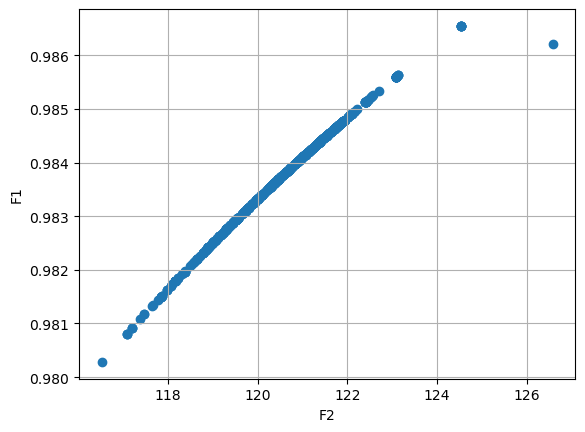

GENERATION :- 39
[[0.9836891004907066, 120.46634747270562], [0.9845714756801549, 121.63064273481376], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9840248929122, 120.90151566289907], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9844396372426492, 121.45210494026618], [0.9846376667356767, 121.72067410765663], [0.9823583287377999, 118.83359937310485], [0.9841066147806703, 121.00907168806214], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9848859342790195, 122.0667901543988], [0.9818395193986488, 118.22680296066406], [0.9846376667356767, 121.72067410765663], [0.9838249740609919, 120.64231371424704], [0.9841531765220617, 121.071426112126], [0.9842728901294024, 121.22896051835619], [0.9844479595425769, 1

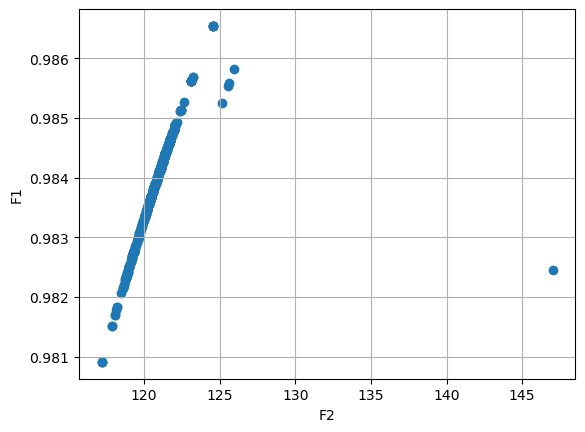

GENERATION :- 40
[[0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9844396372426492, 121.45210494026618], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9845431040105809, 121.59238282898531], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9856243200024207, 123.12287482786346], [0.9846376667356767, 121.72067410765663], [0.9835757924611506, 120.32310917259213], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9846376667356767, 121.72067410765663], [0.9851394038905774, 122.42118820749707], [0.9844151827067

In [119]:
#Main Function

population_size = 1000
number_of_variables = 4
variable_upper_bound = [] 
variable_lower_bound = []
for i in range(number_of_variables):
    variable_upper_bound.append(10)
    variable_lower_bound.append(1)
    
# print(variable_lower_bound)
# print(variable_upper_bound)

threshold = population_size*0.8

print(f'Threshold = {threshold}')

population = Generate_population_2(population_size, number_of_variables, variable_upper_bound, variable_lower_bound)

for i in range(100):
    print(f"GENERATION :- {i+1}")
    counter = 0
    first_counter = 0
    function_values = Function_values_2(population)
    print(function_values)
    
    first_value = function_values[0] # Get the first element of the first sublist
    first_f1_point = first_value[0]
    
    for sublist in function_values:
        if sublist == first_value:
                first_counter += 1
        for value in sublist:
            if value == first_f1_point:
                counter += 1 # Found different value
    
    if counter >= threshold or first_counter >= threshold:
        print(f"Convergence reached after {i+1} generations as there are {threshold} same values")
        break
    
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation_2(function_values)
    #print(pareto_optimal_front_values)
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    #print(crowding_distance_calculation_values)
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                population_size, population)
    population = final_selected_values
    offspring_population = Crossover5(population, lows=variable_lower_bound, highs=variable_upper_bound)
    offspring_population = Mutation3(offspring_population,  lows=variable_lower_bound, highs=variable_upper_bound)
    population = New_generations_2(population, offspring_population)
    #print(population)
    x = []
    y = []
    for i in function_values:
        x.append(i[0])
        y.append(i[1])
    #plt.figure(figsize=(8, 6))
    #plt.xlim(50, 300)  # Limit x-axis from 0 to 6
    #plt.ylim(0.9, 0.99)  # Limit y-axis from 0 to 6

    plt.scatter(y,x)
    plt.ylabel("F1")
    plt.xlabel("F2")
    plt.grid()
    plt.show()

Threshold = 800.0
r: [0.5065763  0.95588424 0.73255754 0.9943942 ]
GENERATION :- 1
[[0.7347270773478368, 54.75652863573812], [0.6411185488785546, 98.05312660499825], [0.8069269615401947, 64.925848366545], [0.6380801036582398, 70.72011668264415], [0.7001634227224669, 101.86594510617888], [0.9212777495890677, 100.93624955751218], [0.9832915337819875, 94.51719807385521], [0.6743881888476299, 85.93397257652543], [0.9142826821210681, 106.74391641442327], [0.9134231499850517, 113.32767082012286], [0.7511679423463072, 82.61439096611149], [0.9390626152882627, 76.22082588194587], [0.6751492082634987, 78.18163245863876], [0.5877982025394135, 45.75774973085076], [0.9889233358841675, 91.61315549117504], [0.907609629032669, 130.8745795406341], [0.7128062193423852, 64.93763603700312], [0.7158392441315485, 92.30020942351521], [0.8235960455322369, 84.53114028711246], [0.8210342810539123, 65.44642229681652], [0.6412192494727078, 117.44774984015717], [0.6411185488785546, 98.05312660499825], [0.668326447

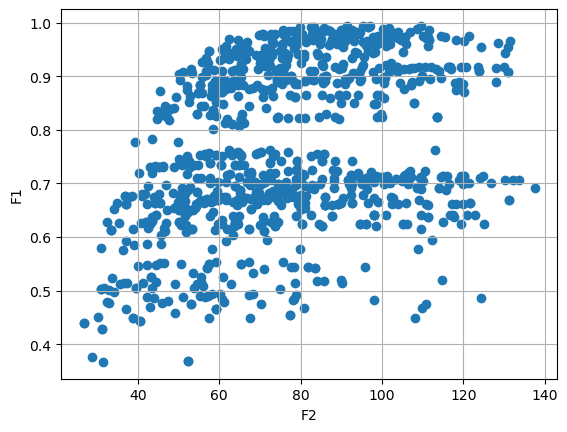

GENERATION :- 2
[[0.9817192272360978, 75.40891904139379], [0.9860383871524012, 74.54306158996627], [0.6955671702802285, 39.18036923561826], [0.8796187121651973, 47.30258846216569], [0.9718210126271589, 69.01998113688258], [0.868137374929195, 44.90891242465281], [0.9388298962642481, 68.94837092757405], [0.970176302062683, 84.816420074528], [0.9458076456105172, 60.56594273210201], [0.9838676924824795, 79.48163143303886], [0.8915623005229969, 59.92955212765544], [0.9847131935487554, 77.28175072309807], [0.5478383909243462, 42.147377085456974], [0.9426511093915012, 59.698004351418604], [0.9372629447979374, 58.50721871910722], [0.5134354520953811, 36.610234798495526], [0.9269859582582607, 55.81716511717073], [0.7507517145567778, 52.03693961849788], [0.9831921431716016, 84.3573456628302], [0.42830113227697286, 31.230430984396573], [0.9648852272646442, 66.14395288389926], [0.7505814129818257, 60.478997952924914], [0.978161821762933, 72.68765296915898], [0.9530199567810304, 69.12290406053647],

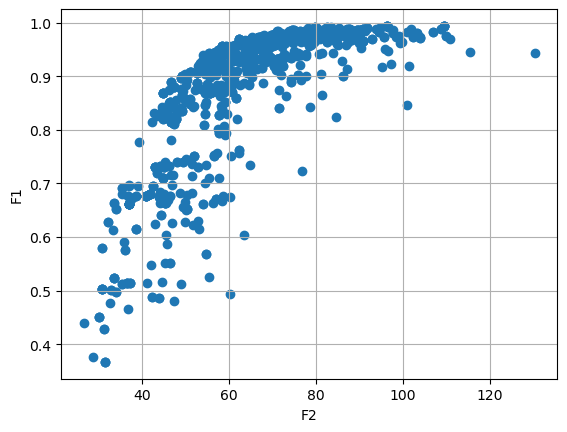

GENERATION :- 3
[[0.8851096518126708, 49.3459174251712], [0.9808952219913767, 71.75644345282673], [0.9302207355805296, 52.78550744637373], [0.6913167908364951, 35.47601715411045], [0.9860383871524012, 74.54306158996627], [0.5134354520953811, 36.610234798495526], [0.9907563059376047, 94.75231729707966], [0.8796187121651973, 47.30258846216569], [0.9754026739526457, 67.59161621140186], [0.8912856041157537, 47.63543546271838], [0.45158380080338867, 30.185078632469413], [0.9806927267612708, 70.39942932304355], [0.9160766550527847, 51.502386072056154], [0.9034907172426413, 50.442544611023905], [0.9342986833215646, 54.68802151778803], [0.9866656022688445, 76.24946208553584], [0.9714801072974003, 65.27505928876167], [0.8754770685796278, 46.56410638173793], [0.6154867681194014, 38.686412294828685], [0.9823233209074557, 73.44098498642627], [0.9879115943868577, 82.03114661453209], [0.9880499838473072, 79.5064400818212], [0.921408535470797, 53.22986683651816], [0.7319234617858048, 40.2920763751107

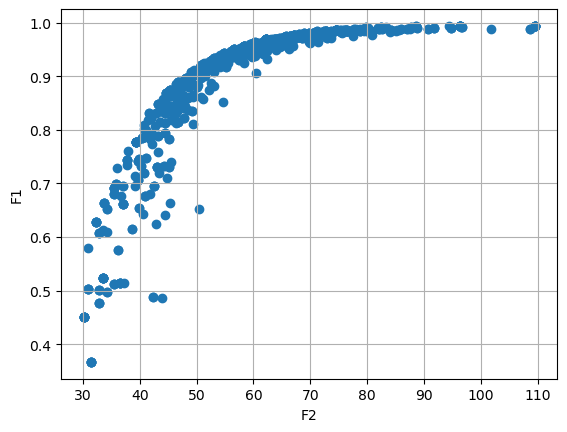

GENERATION :- 4
[[0.8730255939720666, 45.22496590336887], [0.8967628368638008, 48.37456911253966], [0.838865402642996, 42.684460777549205], [0.9686306903219697, 62.29152195335459], [0.9449568548788444, 55.32150226671824], [0.9835407779138755, 71.60289855049028], [0.9724929961814377, 65.43184314081414], [0.9240026643397153, 51.34382489498317], [0.8674475582865037, 45.77855436725432], [0.9263991216611464, 55.72623095281655], [0.9739338137855666, 65.28744995631853], [0.6644871739756553, 33.655217850877385], [0.9580399899525142, 59.114484979162484], [0.9489333920267284, 56.29212767267255], [0.9835705303461774, 71.11168022106193], [0.9088773018020243, 49.078659374559614], [0.9849962276076903, 72.83399344975953], [0.9896361496027904, 79.13089413549878], [0.9038148582304708, 48.91006860089036], [0.8912856041157537, 47.63543546271838], [0.9901484067883591, 79.56861697045336], [0.9770265285514486, 68.64480274756107], [0.9858854596233828, 75.45438407968076], [0.8997651422297548, 48.0664927180765

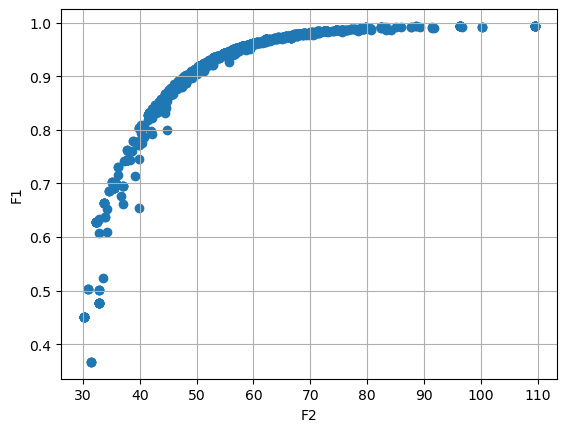

GENERATION :- 5
[[0.8671430813621951, 44.36649228680389], [0.920477695612899, 50.49262729058787], [0.9901484067883591, 79.56861697045336], [0.9691251954770144, 62.551916485572185], [0.8753109037765919, 45.534415168833334], [0.8746076139981728, 45.64697523182089], [0.8768044316741433, 45.2471683901003], [0.8578881996576551, 43.82010629387298], [0.9615381915026133, 59.7134316363999], [0.9197008355354709, 50.37765863984673], [0.9210026942514323, 50.64359755432256], [0.9896254628942338, 78.94637176193714], [0.9753335250536956, 66.34910096063426], [0.7966432155885684, 39.633659179218164], [0.9939332377009163, 96.31283417022789], [0.9171779971698598, 50.06903122348953], [0.9164587509890769, 49.97235680017193], [0.9502253880560476, 56.942184779569686], [0.9860383871524012, 74.54306158996627], [0.9659873888062875, 61.32733203384869], [0.986840330575506, 75.03091982932848], [0.9363709633233804, 53.319192697999384], [0.9431669549315445, 54.7985026830247], [0.8937230247142431, 47.14216344359238],

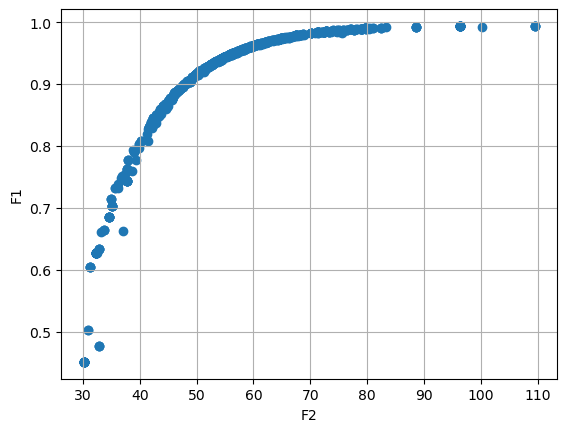

GENERATION :- 6
[[0.9631829041408712, 60.303910640985364], [0.8623689966668172, 43.818566975591736], [0.9092345975947117, 48.85297755990341], [0.9088773018020243, 49.078659374559614], [0.9747792932552627, 65.75074055674624], [0.9247566928318627, 51.20161262046484], [0.886729794828098, 46.19171951460101], [0.8285554132567758, 41.5850396174858], [0.8984508587066773, 47.587158467051545], [0.9356185722167334, 53.28134728544869], [0.9480127279822642, 55.80435064175154], [0.989903782366753, 79.25565648183579], [0.9667049088170069, 61.74135605797186], [0.9655709922999199, 61.157760383501994], [0.6644871739756553, 33.655217850877385], [0.984690582885419, 72.38339932532371], [0.9807895187920184, 68.81112023094062], [0.9574184516230863, 58.41553601810237], [0.9584230549448692, 58.71081318815561], [0.8931323441173077, 47.1390323244965], [0.9525604078490335, 57.038620292419466], [0.9101410834382728, 49.080955035638915], [0.9542724689889206, 57.528733258774395], [0.9401097778631441, 54.023636853129

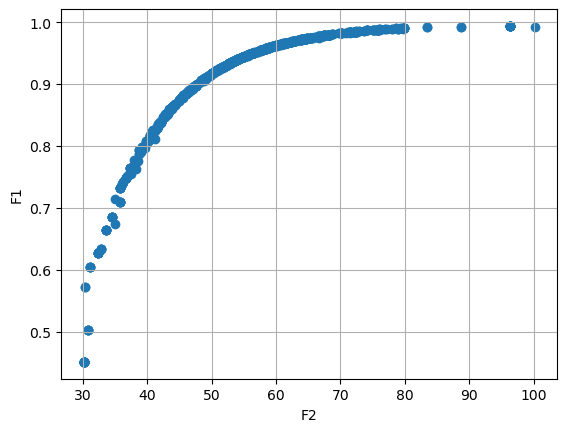

GENERATION :- 7
[[0.8242734788277055, 40.78154808812448], [0.9396258308158144, 53.93107056685649], [0.9578602156382017, 58.47568664121764], [0.8952652240559499, 47.14921900659555], [0.9514427955203186, 56.6790715727938], [0.9623485497812373, 59.9464172781948], [0.9468243145724898, 55.522868710292684], [0.9430510063063888, 54.6943157553268], [0.8845102059506206, 45.99213546406504], [0.9824862569780549, 70.07546528885499], [0.893262198649184, 46.85088906658552], [0.890707060405515, 46.636367285484425], [0.9619101573933515, 59.798892935197955], [0.9514427955203186, 56.6790715727938], [0.9444800853124378, 55.00929253498687], [0.948042606508381, 55.835313882929256], [0.84650427046031, 42.465524129618736], [0.9634931636995198, 60.323090688892584], [0.9778206108260987, 66.90534166888722], [0.45158380080338867, 30.185078632469413], [0.9216888790709916, 50.71080221818731], [0.909418084042017, 48.90476665727671], [0.9194498868719491, 50.37386364777868], [0.867269136546518, 44.20229889345951], [0

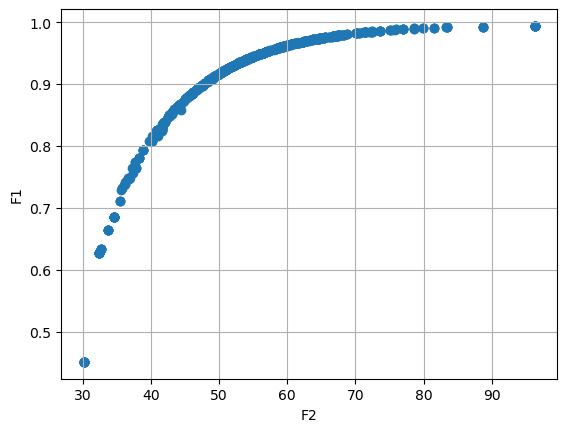

GENERATION :- 8
[[0.9877799950396294, 75.09363630748676], [0.9116361514706152, 49.18513739313912], [0.9466235765570181, 55.50230698244979], [0.9442208286056436, 54.92625854229434], [0.9050970899593098, 48.31276270775271], [0.9907324414946151, 79.57808600700932], [0.45158380080338867, 30.185078632469413], [0.944566542780014, 55.01990836611729], [0.9509715806688555, 56.57724183578611], [0.45158380080338867, 30.185078632469413], [0.9407721713395164, 54.214226124704055], [0.9550184444931041, 57.64723853097264], [0.9493062347036032, 56.126482193983506], [0.9473283633890007, 55.67027559757234], [0.9557293789300286, 57.845202594143245], [0.9350673078498473, 53.05962593368108], [0.9481981828226568, 55.849397996444175], [0.916026760068508, 49.87261391702424], [0.9343918716109442, 52.87664368921351], [0.967908096324489, 62.0233731278808], [0.7799838943275462, 38.23972073343575], [0.8744302801018454, 44.897747548999604], [0.9509715806688555, 56.57724183578611], [0.9677875982539674, 61.97851985486

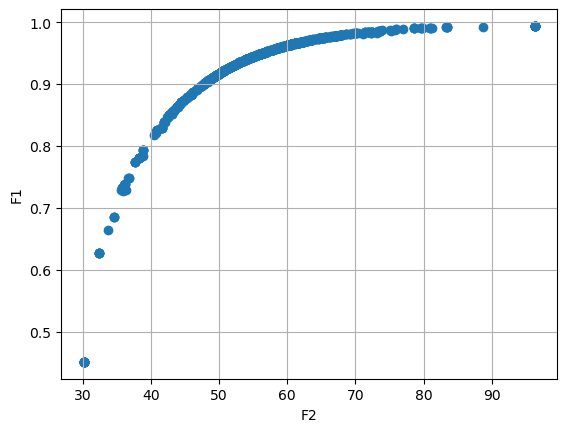

GENERATION :- 9
[[0.864765526350908, 43.985186382026896], [0.9686306903219697, 62.29152195335459], [0.8927129979939481, 46.78545392586434], [0.9583273665469622, 58.63132276311677], [0.9656281644932324, 61.10943469010212], [0.9740998783293822, 64.85265536662382], [0.9608172845563903, 59.408372696922655], [0.8543086646494295, 43.08491320852751], [0.9146553810442412, 49.63088327323683], [0.9082808209207135, 48.777236340671756], [0.9477821241968373, 55.75869419273353], [0.9914029398595803, 83.31780932090746], [0.8664232464447169, 44.174458974205294], [0.9686306903219697, 62.29152195335459], [0.9709028244586052, 63.337333993792356], [0.9452029641905516, 55.141105500350434], [0.9116330599090158, 49.1792056527933], [0.9783870563980785, 67.20989991312152], [0.9514451627809415, 56.67313221684848], [0.9661938907304543, 61.335643038977594], [0.9453946778597117, 55.2262210121048], [0.9686306903219697, 62.29152195335459], [0.944566901547326, 55.00109292953387], [0.9312813266298902, 52.3076651571268

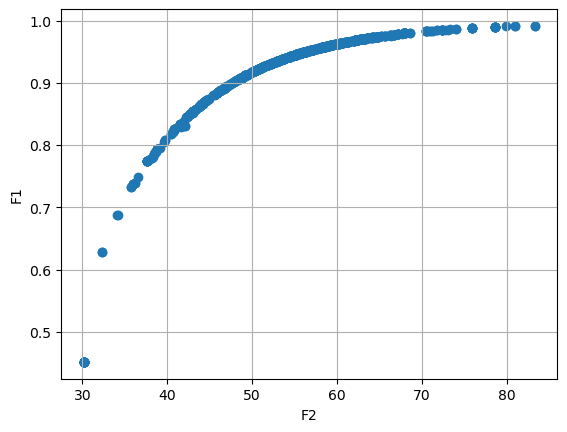

GENERATION :- 10
[[0.8076964327518796, 39.77903476538024], [0.864765526350908, 43.985186382026896], [0.9617059405557989, 59.70573990017046], [0.9700492074028094, 62.9352965548817], [0.9793593242277379, 67.94415568764344], [0.9119780567241578, 49.22046247498841], [0.9729678384791149, 64.29908901339014], [0.8625150387433285, 43.76586141470192], [0.8889357937110797, 46.386446645007545], [0.9357006245590181, 53.13150565792084], [0.9574781143566602, 58.367143239095654], [0.9627705443885025, 60.08659665439491], [0.9374899677236469, 53.49594825207369], [0.9359666372877316, 53.17889247930161], [0.8889357937110797, 46.386446645007545], [0.9253841223769065, 51.27517121746435], [0.9558898004954705, 57.918800535559924], [0.824296673946012, 40.76047036787371], [0.9403665988470326, 54.06965354708106], [0.9319871334890927, 52.42909294463654], [0.9182394168084611, 50.14098393673221], [0.9686605904676603, 62.31200739267827], [0.9188974574237, 50.306363313314506], [0.9677875982539674, 61.97851985486588]

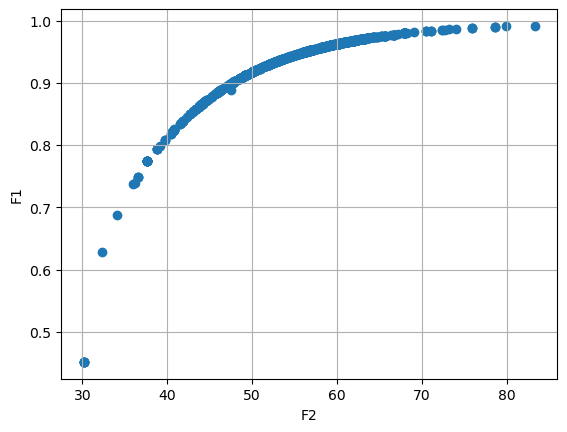

GENERATION :- 11
[[0.972923397648626, 64.25244132691901], [0.907522602419124, 48.618964425354946], [0.9622745982288367, 59.91196151705202], [0.9558898004954705, 57.918800535559924], [0.9357564823103774, 53.14483293394328], [0.9637598330691705, 60.41902166963084], [0.8645627011199588, 43.92719403409403], [0.9398016026624306, 53.95073528659212], [0.9345568385290027, 52.90391327286453], [0.8889357937110797, 46.386446645007545], [0.971443089453215, 63.544408903694205], [0.9531625652113593, 57.12543037291536], [0.9375964062705746, 53.5009905360614], [0.9468287402228172, 55.527672182739586], [0.9374067953942794, 53.46618912718889], [0.9316453296395689, 52.36037450828423], [0.9618340174023987, 59.7503406201145], [0.9483734696198094, 55.88868386542604], [0.9229696649298836, 50.87835658517132], [0.93143863166396, 52.32254933541093], [0.934207430205148, 52.84510517442628], [0.9305258762967373, 52.1567949554136], [0.9652185712335289, 60.993960581812296], [0.9545659087838638, 57.510444910911986], 

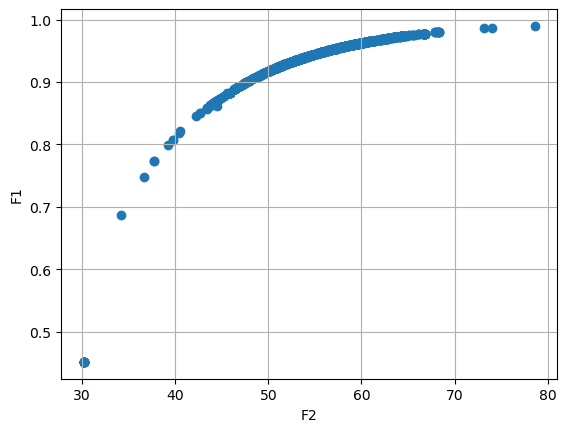

GENERATION :- 12
[[0.9508229770171428, 56.51260813010614], [0.9430428176860083, 54.64958204618736], [0.9451486688166116, 55.12415570689677], [0.9639907884990662, 60.50402813885605], [0.8909012365922555, 46.584720178865254], [0.93143863166396, 52.32254933541093], [0.8781169081406076, 45.2471968820981], [0.9535107166827638, 57.221668241826606], [0.9668293978439277, 61.570363257925024], [0.9757792256768977, 65.7295208298174], [0.9401620516136165, 54.0335971763204], [0.9264830045165765, 51.477409689698604], [0.9084966673046858, 48.75731579928493], [0.9316206210185171, 52.35804964852443], [0.972923397648626, 64.25244132691901], [0.9698776311235802, 62.84034447657272], [0.9218881344551005, 50.718352605717115], [0.958783384698215, 58.765885974906965], [0.9673685618646486, 61.7843989924642], [0.9280507318377956, 51.72209211732192], [0.8889357937110797, 46.386446645007545], [0.9590109802801186, 58.827908939700386], [0.9209530149905238, 50.55135226206572], [0.9648765112700343, 60.81950751089626]

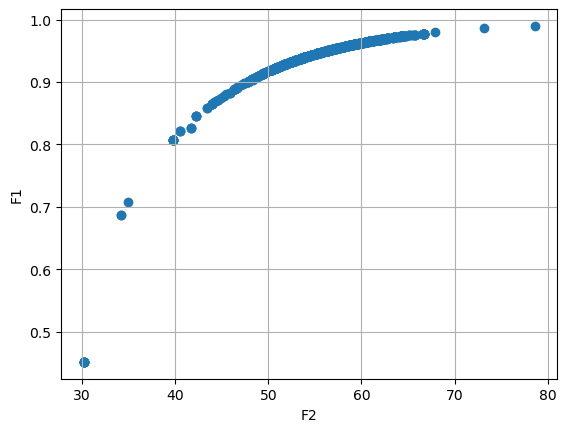

GENERATION :- 13
[[0.8579932892630312, 43.35199181597096], [0.949344816456064, 56.130936360650715], [0.9288325866088919, 51.85852028591798], [0.934207430205148, 52.84510517442628], [0.9482791548429461, 55.8660128537593], [0.9657191723803319, 61.14255161747031], [0.9533400722602029, 57.17203518905214], [0.9643479214464559, 60.62371986113296], [0.9260560886982975, 51.382927392519306], [0.9598698361064376, 59.10106692989442], [0.9349060829486084, 52.97337329626931], [0.9637598330691705, 60.41902166963084], [0.934207430205148, 52.84510517442628], [0.9187950670029918, 50.22389367782985], [0.9519486424258405, 56.79827494729749], [0.8889357937110797, 46.386446645007545], [0.971443089453215, 63.544408903694205], [0.9457385618636844, 55.26119112251767], [0.9198345391116562, 50.39841751460668], [0.9697764778327175, 62.78002975138156], [0.9325615735993128, 52.530586916422955], [0.9560989606038763, 57.95139568030504], [0.9430887388005593, 54.65654798677181], [0.9312428354780705, 52.28935692894131]

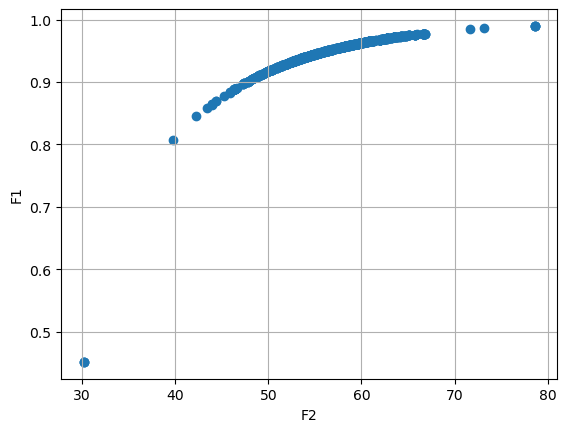

GENERATION :- 14
[[0.9423717911304654, 54.49928777147014], [0.9325615735993128, 52.530586916422955], [0.9394478430762663, 53.877754242831244], [0.9474068470001652, 55.65261821119208], [0.9604113584533518, 59.27270699273831], [0.9558580587864711, 57.8793365471212], [0.8889357937110797, 46.386446645007545], [0.9515685137148, 56.69760765372476], [0.9499709810823884, 56.28492456829446], [0.9299692610957581, 52.061355130159995], [0.9648765112700343, 60.81950751089626], [0.9613188416797996, 59.570948997483406], [0.9382817615751132, 53.638230579653616], [0.8782121885629152, 45.25778859339506], [0.9736139796156129, 64.5627690857865], [0.9244395838468594, 51.11901144145635], [0.9452610697048898, 55.151527514233806], [0.9490854023493708, 56.06582063013195], [0.9616848950217288, 59.698564952368315], [0.929522577676754, 51.98223883768944], [0.9504679113457004, 56.41165775723513], [0.9736139796156129, 64.5627690857865], [0.922891743167913, 50.86872536133923], [0.9547307191064361, 57.56392147559542]

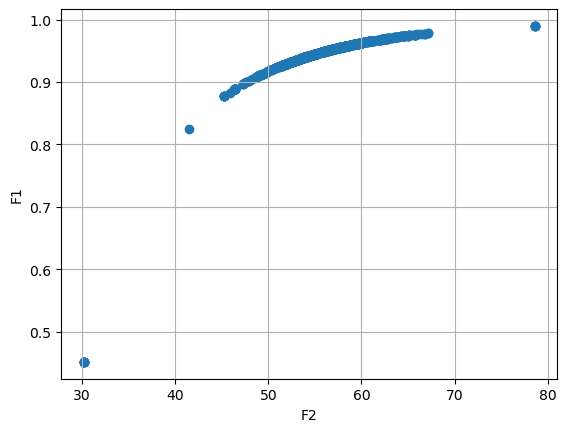

GENERATION :- 15
[[0.45158380080338867, 30.185078632469413], [0.9499996622436914, 56.29541580096373], [0.9765845370085855, 66.40506810988488], [0.9384748074420902, 53.678011339963035], [0.9536593616209859, 57.25970191798962], [0.9142169162273646, 49.54386051629605], [0.947759681936256, 55.73858406986271], [0.9414118952716293, 54.29242630926119], [0.9658823104813967, 61.19709808787525], [0.9600913359568359, 59.17761846851414], [0.9529769141327231, 57.07360576752475], [0.8889357937110797, 46.386446645007545], [0.951552210393948, 56.69309872933169], [0.8889357937110797, 46.386446645007545], [0.9256011849375577, 51.30846469976543], [0.9468569104461905, 55.52260641662575], [0.9254915194577066, 51.286276587848604], [0.9527708600724132, 57.019710046960675], [0.9546348615587325, 57.5378040543617], [0.9550111318345067, 57.63735775154482], [0.9515164127093708, 56.6869353028066], [0.956968385278741, 58.205599698665736], [0.940812901586366, 54.170105677642056], [0.9625881137045424, 60.002650403116

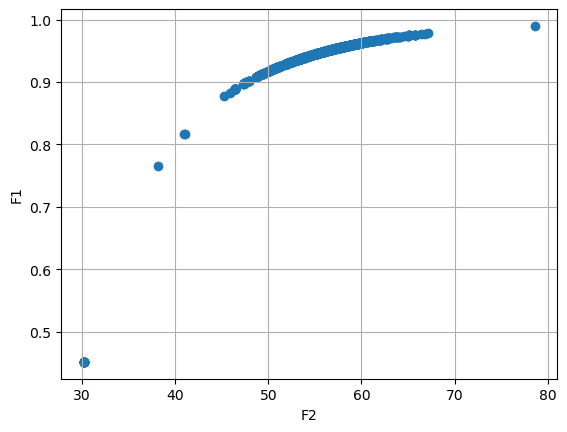

GENERATION :- 16
[[0.9595022020186631, 58.981894752696135], [0.951979696937117, 56.8051234797178], [0.9316219539031464, 52.35633290767397], [0.9447066440362337, 55.02199279227511], [0.9469066689778565, 55.5362954727095], [0.9382177641713961, 53.6272157980482], [0.9233291580674987, 50.932914601970815], [0.9537231783401168, 57.27972469267074], [0.9659606169714665, 61.22427167773999], [0.9387160606506643, 53.72728885681565], [0.9254915194577066, 51.286276587848604], [0.9468569104461905, 55.52260641662575], [0.9536149387568493, 57.24818335786863], [0.9330738827331424, 52.625621548365075], [0.9509319889193409, 56.53167033533455], [0.9492775526720292, 56.11173321484419], [0.9274758645008235, 51.621998201669086], [0.9428045447143111, 54.59422206819485], [0.959593373574953, 59.012554295897026], [0.9442551030056094, 54.91812365866184], [0.9454662086502339, 55.19508529278828], [0.9591103849427418, 58.86190979990809], [0.9464782718256266, 55.431218271751035], [0.9476701486129613, 55.7171724449002

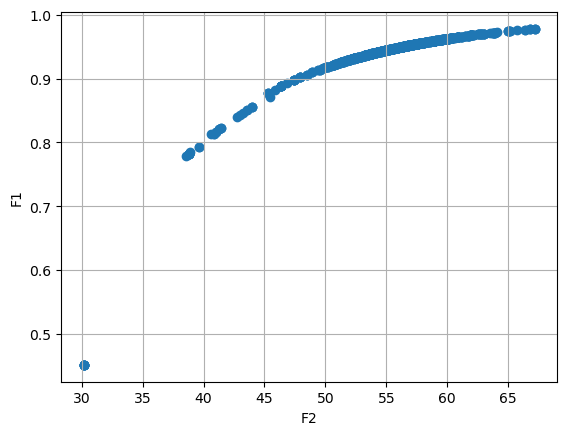

GENERATION :- 17
[[0.9284030997951469, 51.78353524289879], [0.9595022020186631, 58.981894752696135], [0.9284030997951469, 51.78353524289879], [0.9493357233659905, 56.12788094707547], [0.9487467197553077, 55.98359892553751], [0.9415264983222192, 54.316322572814855], [0.9355177613330272, 53.092700326646934], [0.9263966555151406, 51.43903633803892], [0.9565105106860896, 58.069705131295564], [0.9219624302785683, 50.71059848360838], [0.9501761171420002, 56.338592963913165], [0.9633194879442949, 60.26170725399531], [0.9725070300805176, 64.0860706007578], [0.9453059315667359, 55.15756851976104], [0.9671868739331466, 61.7049606304314], [0.9539211505691635, 57.33188497728278], [0.9468775654120873, 55.52536382441788], [0.9223019343258788, 50.772199490060814], [0.9432800928239318, 54.700861977320486], [0.9268520683789115, 51.51589440755179], [0.9448064351091744, 55.0429606980139], [0.9516335432000621, 56.71408803275783], [0.9375818531356109, 53.50068881424073], [0.9527708600724132, 57.01971004696

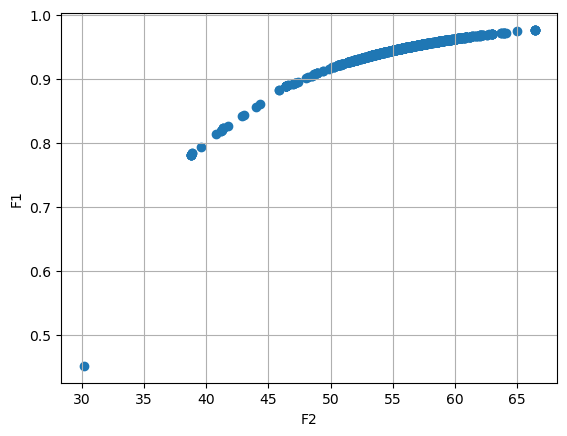

GENERATION :- 18
[[0.9355177613330272, 53.092700326646934], [0.9595022020186631, 58.981894752696135], [0.9501761171420002, 56.338592963913165], [0.9342139806154642, 52.8382528048155], [0.9459396914230707, 55.30889547693596], [0.9404456238564639, 54.08585999197433], [0.9536422404377767, 57.255653153122495], [0.9391686736008281, 53.83390807045562], [0.9638234230442696, 60.44330925439232], [0.9353263185061909, 53.05202448624979], [0.9381832589546059, 53.61965491213621], [0.9462374294362452, 55.37484616555913], [0.9501227607234131, 56.32513908321357], [0.9595022020186631, 58.981894752696135], [0.9591536246641664, 58.8714705376834], [0.9553141710425397, 57.724202578059376], [0.9321954729318732, 52.46137902282517], [0.94934273995927, 56.12903518805403], [0.9113364584000193, 49.13855631277402], [0.9445072794272865, 54.974386897275394], [0.9568163761453233, 58.16008535256215], [0.9355177613330272, 53.092700326646934], [0.9355177613330272, 53.092700326646934], [0.9583811579185169, 58.6341702480

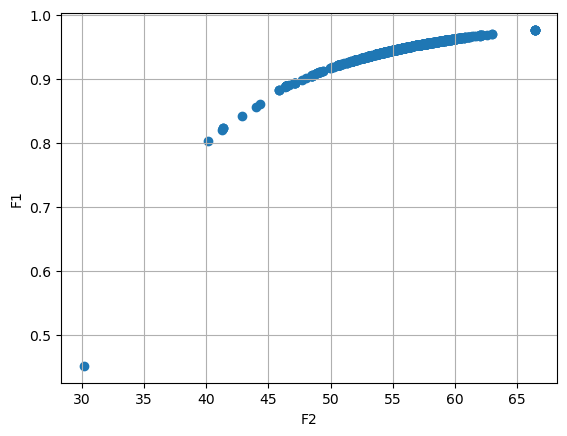

GENERATION :- 19
[[0.9560433658704722, 57.93184190644047], [0.9448211802219213, 55.046053712420886], [0.9422976794397714, 54.483089612471204], [0.9355177613330272, 53.092700326646934], [0.9316012355736788, 52.354750003322124], [0.9509674368215228, 56.54247448632485], [0.9409890572219775, 54.200753097589356], [0.9392678785000803, 53.85011177180489], [0.9534366105874309, 57.19747130293763], [0.9453059315667359, 55.15756851976104], [0.9355177613330272, 53.092700326646934], [0.9595022020186631, 58.981894752696135], [0.9358977172105977, 53.16364130724048], [0.9382107471998742, 53.62462793618918], [0.9327667460799961, 52.57501323716981], [0.9540435009052014, 57.36527479025348], [0.9410409266239889, 54.21302219084322], [0.9404024596333826, 54.078215089576176], [0.9355177613330272, 53.092700326646934], [0.9462374294362452, 55.37484616555913], [0.9595022020186631, 58.981894752696135], [0.9213859467297765, 50.62053105207413], [0.9330313313843872, 52.61594162190755], [0.9619544501298347, 59.78725

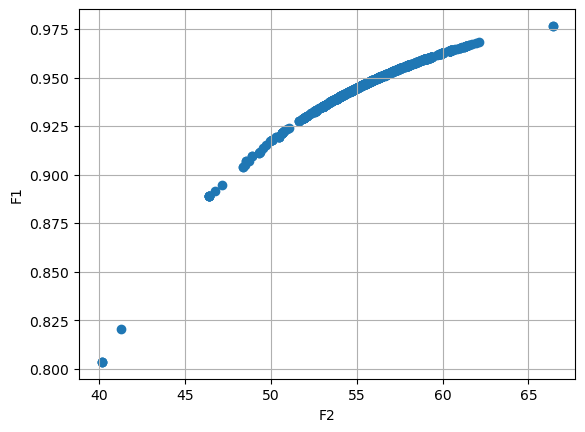

GENERATION :- 20
[[0.9384577659791546, 53.67308670943574], [0.8943969989229758, 47.14615045564358], [0.9497632065032804, 56.232811230472144], [0.9512724120700354, 56.62042899066854], [0.9595022020186631, 58.981894752696135], [0.9525798072199083, 56.96586068455285], [0.9355177613330272, 53.092700326646934], [0.940613402590033, 54.12213203954893], [0.9589147633721432, 58.800454423923824], [0.9470815499883882, 55.57663975910285], [0.9431126860828146, 54.663282420227475], [0.9370802224006586, 53.3976323130342], [0.9619559333545464, 59.785737634689696], [0.9354194813540265, 53.069132914036935], [0.9118590142634649, 49.39272397926871], [0.9536589664439528, 57.25825363384098], [0.8889357937110797, 46.386446645007545], [0.9391686736008281, 53.83390807045562], [0.9488778826292702, 56.012751107358575], [0.9488778826292702, 56.012751107358575], [0.9595022020186631, 58.981894752696135], [0.9410531333695981, 54.21725374594012], [0.9547307191064361, 57.56392147559542], [0.9639549756033243, 60.484938

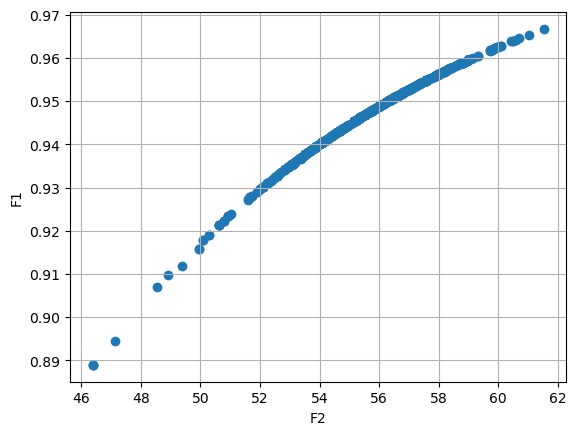

GENERATION :- 21
[[0.9595022020186631, 58.981894752696135], [0.9380625852163113, 53.59438529819893], [0.9355177613330272, 53.092700326646934], [0.9536454722299005, 57.254870474660336], [0.9394137644230471, 53.87042061506182], [0.8889357937110797, 46.386446645007545], [0.946120527604959, 55.34728887776238], [0.9532575477164782, 57.148490555171335], [0.9425785418826157, 54.54673198896837], [0.9551673535326628, 57.68153124963386], [0.9486631316143216, 55.95928555943844], [0.951908015450997, 56.7874635625748], [0.9419370665066531, 54.416461928778006], [0.947498507778432, 55.68133471665173], [0.9622710358514813, 59.89385045831524], [0.9529296827600272, 57.05922682566812], [0.9534234679553568, 57.19347984429942], [0.9595022020186631, 58.981894752696135], [0.9595022020186631, 58.981894752696135], [0.9355177613330272, 53.092700326646934], [0.9505661404103252, 56.43843783139319], [0.934161737689844, 52.83362514275627], [0.947427544068017, 55.66087860039235], [0.9589147633721432, 58.800454423923

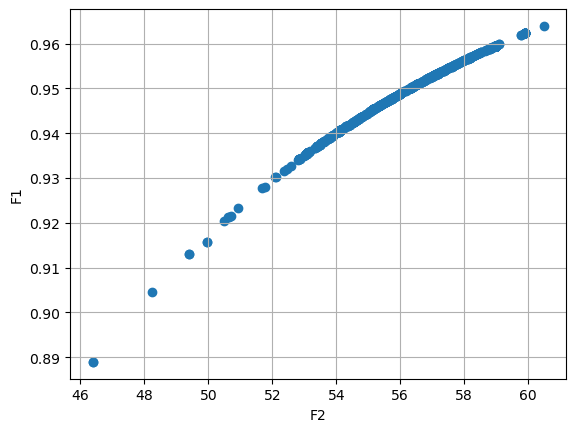

GENERATION :- 22
[[0.9560089196561201, 57.92256827491188], [0.9595022020186631, 58.981894752696135], [0.9488778826292702, 56.012751107358575], [0.9536454722299005, 57.254870474660336], [0.9534234679553568, 57.19347984429942], [0.9505209871629774, 56.42624562271003], [0.9595022020186631, 58.981894752696135], [0.9531182627778526, 57.11072819639932], [0.9486631316143216, 55.95928555943844], [0.9574009138653405, 58.33402547251538], [0.9488778826292702, 56.012751107358575], [0.9488778826292702, 56.012751107358575], [0.9574070604720827, 58.33752229017531], [0.9595022020186631, 58.981894752696135], [0.9403692536376621, 54.06920441793034], [0.9355177613330272, 53.092700326646934], [0.9564260611036687, 58.04380725119128], [0.9509163094913767, 56.52775468598044], [0.9557401587255409, 57.84587009284086], [0.945525711854023, 55.21034309952435], [0.9564260611036687, 58.04380725119128], [0.9595022020186631, 58.981894752696135], [0.947016814041791, 55.56030994240696], [0.9355177613330272, 53.09270032

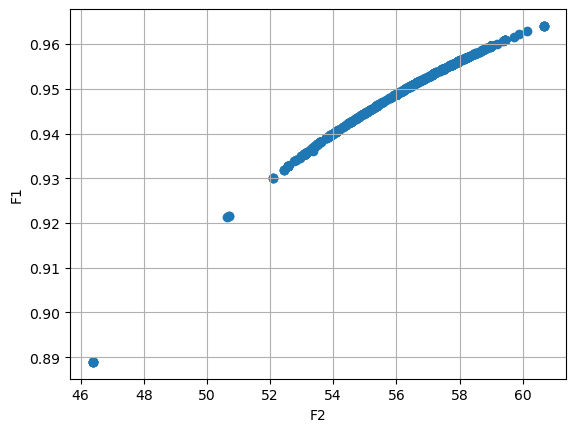

GENERATION :- 23
[[0.9512118303041531, 56.605401920019375], [0.9595022020186631, 58.981894752696135], [0.9522463608943549, 56.87687985434051], [0.9561155809130855, 57.953237678527145], [0.9425785418826157, 54.54673198896837], [0.9505209871629774, 56.42624562271003], [0.9595022020186631, 58.981894752696135], [0.9486339006969075, 55.952070852205], [0.9595022020186631, 58.981894752696135], [0.9508129177707038, 56.50094686338111], [0.9595022020186631, 58.981894752696135], [0.9453059315667359, 55.15756851976104], [0.9607483393330647, 59.383360972518545], [0.9428335865719384, 54.601525629535175], [0.950552267277106, 56.43450847464118], [0.956517534000017, 58.072583818396026], [0.940613402590033, 54.12213203954893], [0.9595022020186631, 58.981894752696135], [0.9521720786836553, 56.85726551718162], [0.9560984839712662, 57.94824201507253], [0.9504227891323911, 56.40029326352591], [0.9595022020186631, 58.981894752696135], [0.9426066329349879, 54.550480032160536], [0.9488778826292702, 56.01275110

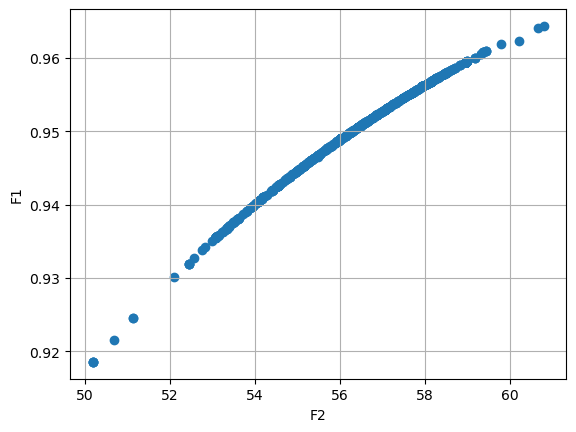

GENERATION :- 24
[[0.9525270925583852, 56.95114675666575], [0.950552267277106, 56.43450847464118], [0.9532139629192135, 57.13682886035339], [0.9430815651435145, 54.657677549326294], [0.9595022020186631, 58.981894752696135], [0.9595022020186631, 58.981894752696135], [0.9509458082187044, 56.5352092989341], [0.9579921508642506, 58.512275959122775], [0.9538621891265535, 57.314931364655536], [0.9543383585252563, 57.447029150750275], [0.9526828076267368, 56.99360478554574], [0.9484886300572345, 55.91612462790407], [0.9365477055742389, 53.29354063884677], [0.9485663639112969, 55.93461458810769], [0.9595022020186631, 58.981894752696135], [0.960911153292683, 59.43728016891444], [0.9488778826292702, 56.012751107358575], [0.9488778826292702, 56.012751107358575], [0.960911153292683, 59.43728016891444], [0.9595022020186631, 58.981894752696135], [0.9425785418826157, 54.54673198896837], [0.9526038221971992, 56.971920477246094], [0.9560984839712662, 57.94824201507253], [0.9572582903087188, 58.29053166

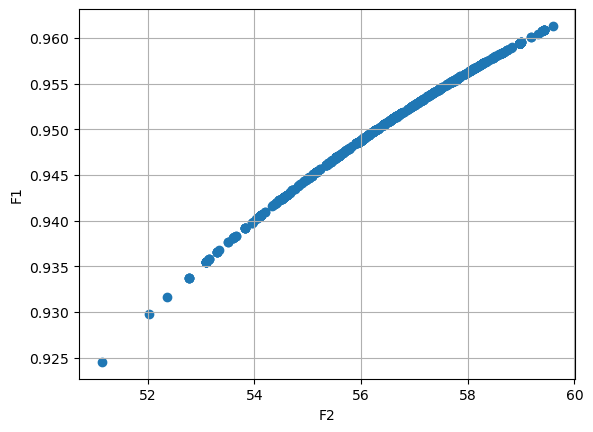

GENERATION :- 25
[[0.9479447368184638, 55.782767780694115], [0.9488778826292702, 56.012751107358575], [0.9488778826292702, 56.012751107358575], [0.9462011381200512, 55.36661303301459], [0.9595022020186631, 58.981894752696135], [0.9479447368184638, 55.782767780694115], [0.9512888544739841, 56.62450196906025], [0.9484312242294203, 55.90216860841639], [0.9538381931792018, 57.30806689112771], [0.9595022020186631, 58.981894752696135], [0.9583952035746778, 58.63586779461417], [0.9543108084250295, 57.4386413571717], [0.9595022020186631, 58.981894752696135], [0.9488778826292702, 56.012751107358575], [0.951364583020555, 56.64362894863281], [0.9583952035746778, 58.63586779461417], [0.9462137871226417, 55.37048357271638], [0.9532574751025116, 57.14863785006331], [0.9538381931792018, 57.30806689112771], [0.9382107471998742, 53.62462793618918], [0.9595022020186631, 58.981894752696135], [0.9569382576628123, 58.19480789634352], [0.9425785418826157, 54.54673198896837], [0.9376296970143012, 53.50913735

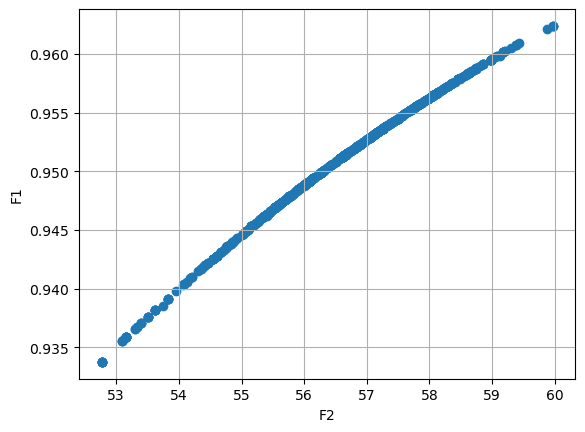

GENERATION :- 26
[[0.9487046318755973, 55.96943793326854], [0.9508097363993551, 56.50018387426563], [0.955128085043191, 57.669636484998826], [0.9556755690892976, 57.8256866141236], [0.9470816228938916, 55.57552546606533], [0.9538381931792018, 57.30806689112771], [0.9402690777389439, 54.05255374487213], [0.945997352200843, 55.31897149193619], [0.9575198441775196, 58.36944282404178], [0.9473086603764279, 55.62885217175888], [0.9526378169635041, 56.981333062604335], [0.94581824208605, 55.27822552016456], [0.9570178260492698, 58.21896939264211], [0.9521568650313612, 56.85261005033256], [0.9428335865719384, 54.601525629535175], [0.9396996694536747, 53.93355243993948], [0.9421141949300322, 54.444750374712186], [0.9497855287564712, 56.23927884582855], [0.9538912358812095, 57.32317449548725], [0.9552475097771417, 57.703561643212865], [0.9564883842805769, 58.06252050668708], [0.9476935217886342, 55.72321971268809], [0.9447192476667472, 55.0261422869077], [0.9538381931792018, 57.30806689112771],

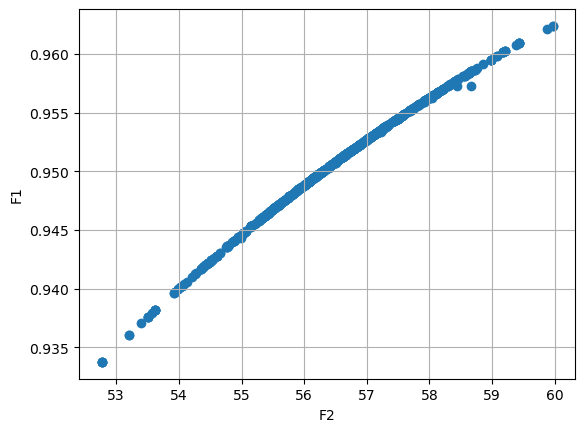

GENERATION :- 27
[[0.9540613681063476, 57.3696220979575], [0.9525449490035275, 56.95664911438845], [0.9500291062506031, 56.30054787594963], [0.951003027142429, 56.549888514355914], [0.9561850417268828, 57.97360639364591], [0.9536707038377367, 57.26153948040573], [0.951845979283965, 56.770887786738896], [0.9453059315667359, 55.15756851976104], [0.9548269849326426, 57.584109631832334], [0.944485458587621, 54.9699516949921], [0.9492006103305296, 56.092299987860194], [0.9592718126333359, 58.908978652910776], [0.9545871079625028, 57.51675756134662], [0.9553985721394098, 57.74608245547391], [0.9551801561842267, 57.684159320680834], [0.9500851358940954, 56.314488466259945], [0.9465838821576661, 55.45675881794713], [0.9553540747769231, 57.73388636557911], [0.9566328885701757, 58.10518370605084], [0.9494671772509676, 56.159055789679925], [0.9376296970143012, 53.5091373539981], [0.9488778826292702, 56.012751107358575], [0.9583952035746778, 58.63586779461417], [0.9458673169700985, 55.288659685031

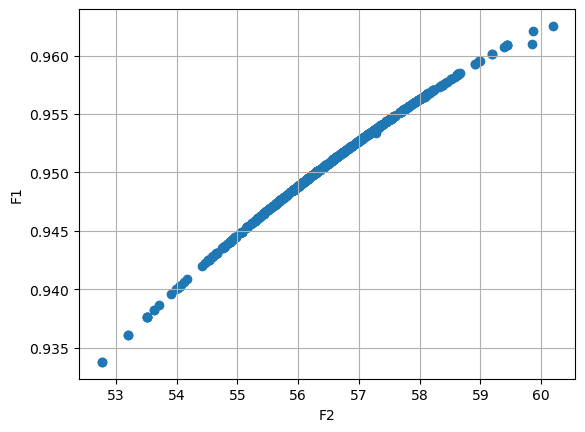

GENERATION :- 28
[[0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9561784420771705, 57.97197616233993], [0.9495704695436934, 56.1848881819743], [0.9553391715457255, 57.7292695977222], [0.9498848509949479, 56.26327949115862], [0.9376296970143012, 53.5091373539981], [0.9486932699337937, 55.96555772838968], [0.949258818661251, 56.10581179797407], [0.9533529498718835, 57.17454198738331], [0.9495154170535547, 56.17101091326357], [0.9583952035746778, 58.63586779461417], [0.9497702992891519, 56.23436988230173], [0.9512200018701775, 56.60652871478213], [0.9494126608483533, 56.14437543714866], [0.9555650392025768, 57.79424862124835], [0.9515503065843396, 56.692596655070574], [0.9497702992891519, 56.23436988230173], [0.9529380135739111, 57.06250909468861], [0.9525506511944146, 56.95752808289693], [0.9580001579082075, 58.51505646078683], [0.9510301307354947, 56.556625853670496], [0.949258818661251, 56.10581179797407], [0.9497777213853776, 56.23677931048319], [

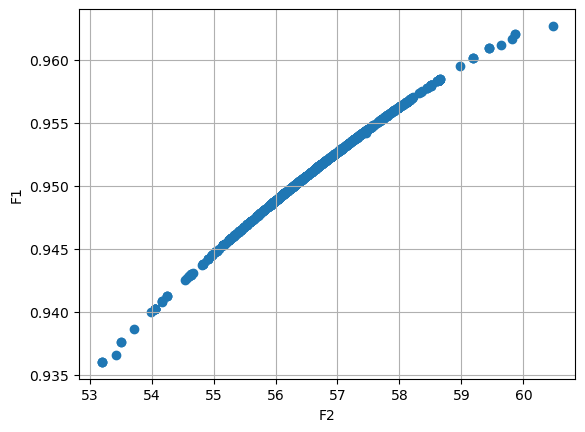

GENERATION :- 29
[[0.9499292161821894, 56.27440372766026], [0.9514069268479, 56.65553720947655], [0.9487000649968024, 55.96814746568704], [0.9500379545104374, 56.30235875687086], [0.9430048093085626, 54.64133249188079], [0.9547654230613473, 57.56689913752393], [0.9505150703481294, 56.42431119959219], [0.9541204468654597, 57.385666349814215], [0.955926940263822, 57.89837049507814], [0.9499013070302932, 56.2685635479664], [0.9525449490035275, 56.95664911438845], [0.9515330668722424, 56.68783940221975], [0.9561497701951103, 57.96348339456975], [0.9583952035746778, 58.63586779461417], [0.9562914324671022, 58.00474652867901], [0.9548456872341996, 57.589333226855985], [0.9583952035746778, 58.63586779461417], [0.9488778826292702, 56.012751107358575], [0.9564372308199791, 58.04741058642705], [0.9512738243052737, 56.620346831744214], [0.9583952035746778, 58.63586779461417], [0.9525449490035275, 56.95664911438845], [0.952728606695903, 57.00575307150671], [0.949717478438931, 56.22126373683638], [

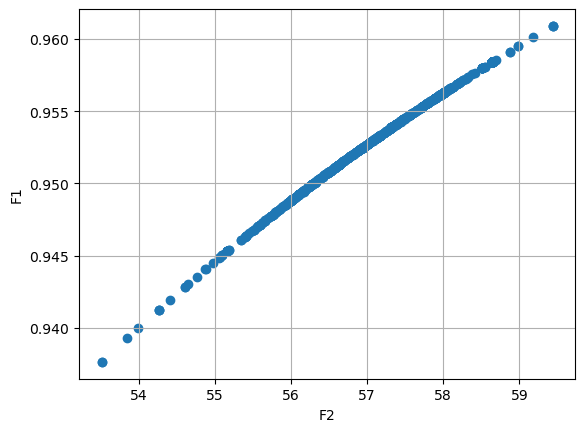

GENERATION :- 30
[[0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.955628418161461, 57.81247202275088], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.95214187493872, 56.84851095106929], [0.9583952035746778, 58.63586779461417], [0.9498262081116468, 56.24868513293035], [0.9583952035746778, 58.63586779461417], [0.953916609177087, 57.32951339440335], [0.9488778826292702, 56.012751107358575], [0.9583952035746778, 58.63586779461417], [0.9540856707349569, 57.37594987508844], [0.9576456400868929, 58.407216863879], [0.9553391715457255, 57.7292695977222], [0.9492624044705856, 56.10727978700366], [0.9481137196130627, 55.84017055542073], [0.9555650392025768, 57.79424862124835], [0.9583952035746778, 58.63586779461417], [0.9538783249169737, 57.3194151698908], [0.9583952035746778, 58.63586779461417], [0.954044737529416, 57.36509588835119], [0.958

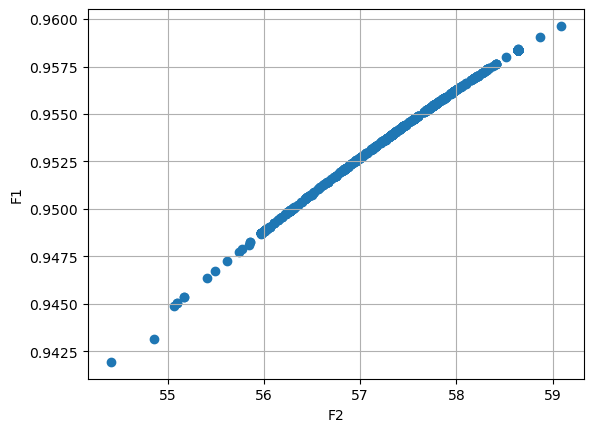

GENERATION :- 31
[[0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9578788174910857, 58.47787183997834], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9488778826292702, 56.012751107358575], [0.9564146791859959, 58.040637754635846], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9533181914165165, 57.16493148285049], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9488778826292702, 56.012751107358575], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.635867794614

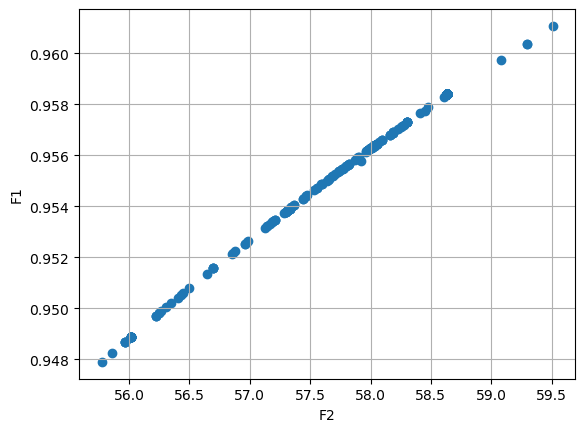

GENERATION :- 32
[[0.9565109364219387, 58.09143426708692], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417]

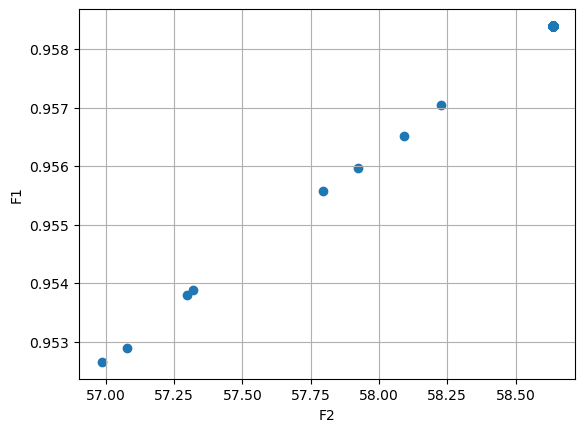

GENERATION :- 33
[[0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417], [0.9583952035746778, 58.63586779461417]

In [120]:
#Main Function

population_size = 1000
number_of_variables = 4
variable_upper_bound = [] 
variable_lower_bound = []
for i in range(number_of_variables):
    variable_upper_bound.append(10)
    variable_lower_bound.append(1)
    
# print(variable_lower_bound)
# print(variable_upper_bound)

threshold = population_size*0.8

print(f'Threshold = {threshold}')

population = Generate_population_2(population_size, number_of_variables, variable_upper_bound, variable_lower_bound)

for i in range(100):
    print(f"GENERATION :- {i+1}")
    counter = 0
    first_counter = 0
    function_values = Function_values_2(population)
    print(function_values)
    
    first_value = function_values[0] # Get the first element of the first sublist
    first_f1_point = first_value[0]
    
    for sublist in function_values:
        if sublist == first_value:
                first_counter += 1
        for value in sublist:
            if value == first_f1_point:
                counter += 1 # Found different value
    
    if counter >= threshold or first_counter >= threshold:
        print(f"Convergence reached after {i+1} generations as there are {threshold} same values")
        break
    
    pareto_optimal_front_values = Non_dominated_sorting_fitness_calculation_2(function_values)
    #print(pareto_optimal_front_values)
    crowding_distance_calculation_values = Crowding_distance_calculation(pareto_optimal_front_values)
    #print(crowding_distance_calculation_values)
    final_selected_values = Selection(function_values, pareto_optimal_front_values, crowding_distance_calculation_values, 
                                                population_size, population)
    population = final_selected_values
    offspring_population = Crossover5(population, lows=variable_lower_bound, highs=variable_upper_bound)
    offspring_population = Mutation(offspring_population,  lows=variable_lower_bound, highs=variable_upper_bound)
    population = New_generations_2(population, offspring_population)
    #print(population)
    x = []
    y = []
    for i in function_values:
        x.append(i[0])
        y.append(i[1])
    #plt.figure(figsize=(8, 6))
    #plt.xlim(50, 300)  # Limit x-axis from 0 to 6
    #plt.ylim(0.9, 0.99)  # Limit y-axis from 0 to 6

    plt.scatter(y,x)
    plt.ylabel("F1")
    plt.xlabel("F2")
    plt.grid()
    plt.show()